<center><h1>1-ab: Introduction to Neural Networks</h1></center>

<center><h2><a href="https://rdfia.github.io/">Course link</a></h2></center>


In [1]:
# !rm -rf data
# !mkdir data
# !wget -P data https://github.com/rdfia/rdfia.github.io/raw/master/data/2-ab.zip
# !unzip -j data/2-ab.zip -d data
# !rm utils-data.py
# !wget https://github.com/rdfia/rdfia.github.io/raw/master/code/2-ab/utils-data.py

In [2]:
import math
import torch
from torch.autograd import Variable
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import random

%run 'utils-data.py'

In [3]:
seed = 42
# Set seed for reproducibility
random.seed(seed)
np.random.seed(seed)

# Part 1 : Forward and backward passes "by hands"

In [4]:
def init_params(nx, nh, ny):
    """
    nx, nh, ny: integers
    out params: dictionnary
    """
    params = {}
    torch.manual_seed(seed)
    #####################
    ## Your code here  ##
    #####################
    # fill values for Wh, Wy, bh, by

    params["Wh"] = torch.randn(nh, nx) / math.sqrt(0.3)
    params["Wy"] = torch.randn(ny, nh) / math.sqrt(0.3)
    params["bh"] = torch.randn(1, nh) / math.sqrt(0.3)
    params["by"] = torch.randn(1, ny) / math.sqrt(0.3)

    ####################
    ##      END        #
    ####################
    return params

In [5]:
def forward(params, X):
    """
    params: dictionnary
    X: (n_batch, dimension)
    """
    bsize = X.size(0)
    nh = params["Wh"].size(0)
    ny = params["Wy"].size(0)
    outputs = {}

    #####################
    ## Your code here  ##
    #####################
    # fill values for X, htilde, h, ytilde, yhat

    outputs["X"] = X
    outputs["htilde"] = torch.mm(X, params["Wh"].t()) + params["bh"]
    outputs["h"] = torch.tanh(outputs["htilde"])
    outputs["ytilde"] = torch.mm(outputs["h"], params["Wy"].t()) + params["by"]
    outputs["yhat"] = torch.softmax(outputs["ytilde"], dim=1)

    ####################
    ##      END        #
    ####################

    return outputs["yhat"], outputs

In [6]:
def loss_accuracy(Yhat, Y):

    #####################
    ## Your code here  ##
    #####################

    L = -torch.mean(torch.sum(Y * torch.log(Yhat), dim=1))
    acc = torch.mean((torch.argmax(Yhat, dim=1) == torch.argmax(Y, dim=1)).float())*100

    ####################
    ##      END        #
    ####################

    return L, acc

In [7]:
def backward(params, outputs, Y):
    bsize = Y.shape[0]
    grads = {}

    #####################
    ## Your code here  ##
    #####################
    # fill values for Wy, Wh, by, bh
    
    delta_y = outputs["yhat"] - Y
    delta_h = torch.mm(delta_y , params["Wy"]) * (1 - outputs["h"] ** 2)
    grads["Wy"] = torch.mm(delta_y.t(), outputs["h"]) / bsize
    grads["Wh"] = torch.mm(delta_h.t(), outputs["X"]) / bsize
    grads["by"] = torch.mean(delta_y, dim=0, keepdim=True)
    grads["bh"] = torch.mean(delta_h, dim=0, keepdim=True)

    ####################
    ##      END        #
    ####################
    return grads

In [8]:
def sgd(params, grads, eta):

    #####################
    ## Your code here  ##
    #####################
    # update the params values

    params["Wh"] -= eta * grads["Wh"]
    params["Wy"] -= eta * grads["Wy"]
    params["bh"] -= eta * grads["bh"]
    params["by"] -= eta * grads["by"]

    ####################
    ##      END        #
    ####################
    return params

## Global learning procedure "by hands"

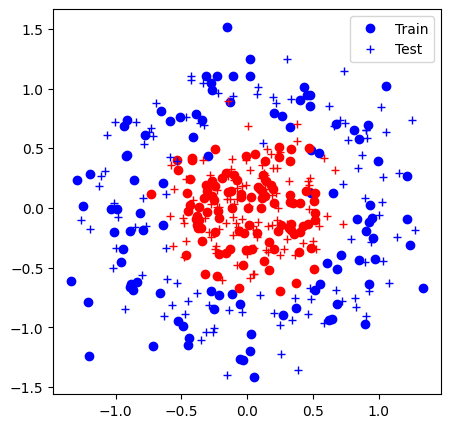

Iter 0: Acc train 65.5% (0.85), acc test 66.0% (0.80)


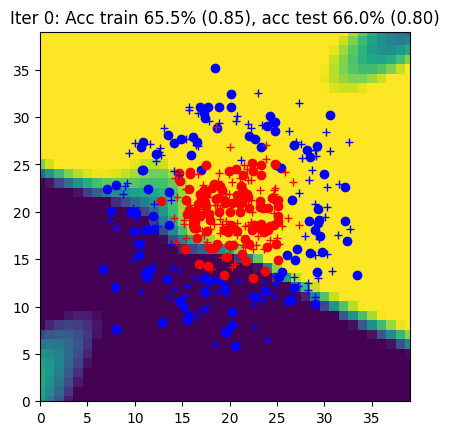

Iter 1: Acc train 68.0% (0.62), acc test 69.5% (0.57)


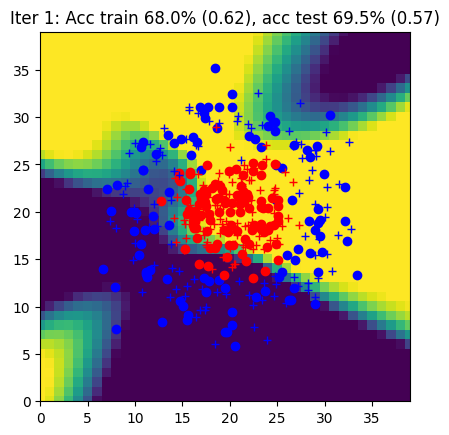

Iter 2: Acc train 72.0% (0.53), acc test 77.5% (0.49)


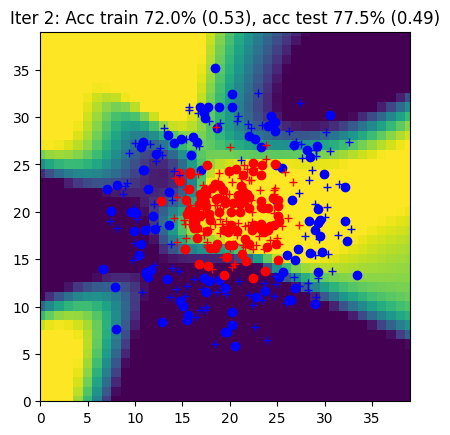

Iter 3: Acc train 76.5% (0.48), acc test 79.0% (0.44)


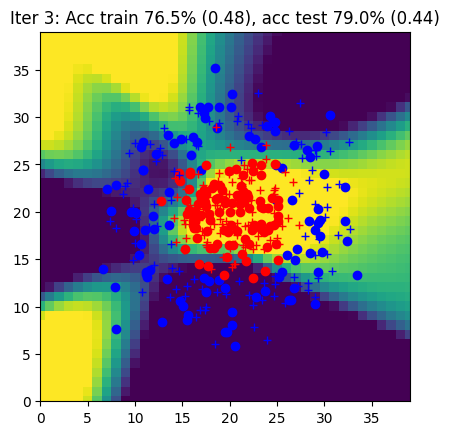

Iter 4: Acc train 81.5% (0.45), acc test 84.5% (0.42)


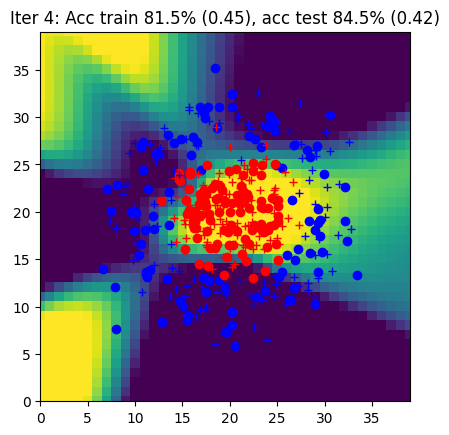

Iter 5: Acc train 81.5% (0.43), acc test 85.5% (0.40)


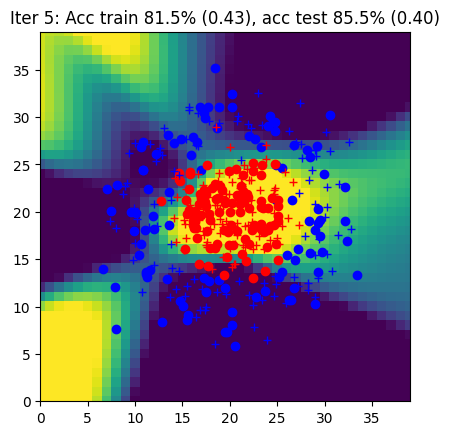

Iter 6: Acc train 83.0% (0.41), acc test 85.5% (0.38)


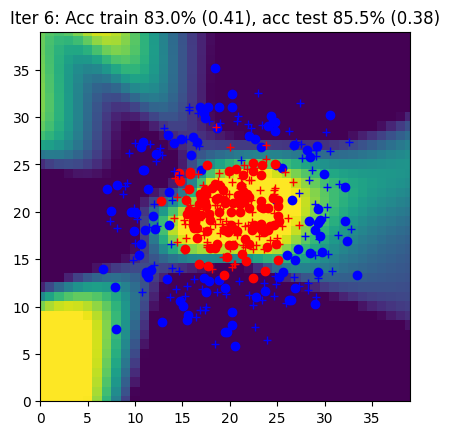

Iter 7: Acc train 84.5% (0.40), acc test 88.0% (0.37)


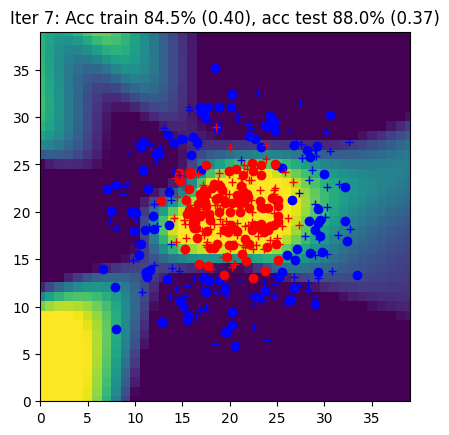

Iter 8: Acc train 85.0% (0.38), acc test 88.0% (0.36)


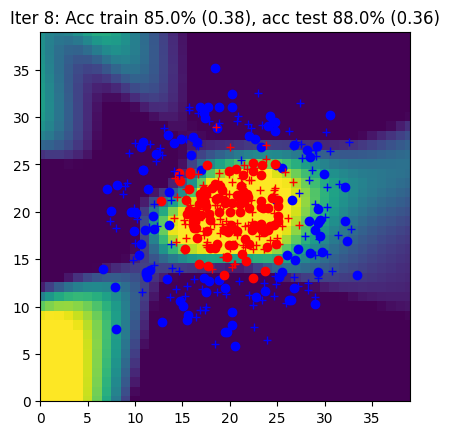

Iter 9: Acc train 87.5% (0.37), acc test 89.0% (0.35)


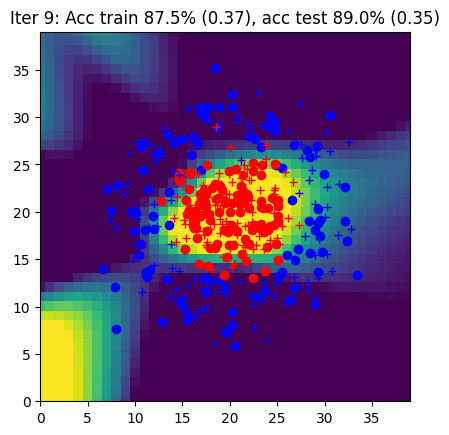

Iter 10: Acc train 89.5% (0.36), acc test 91.0% (0.34)


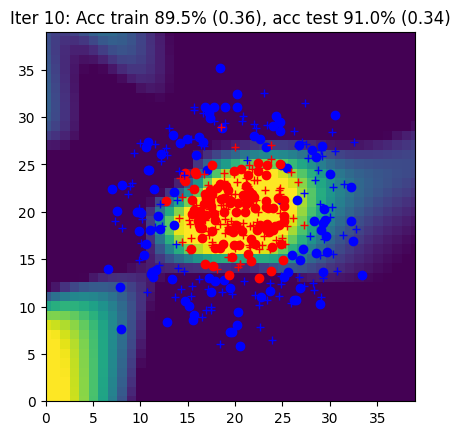

Iter 11: Acc train 88.0% (0.35), acc test 91.0% (0.33)


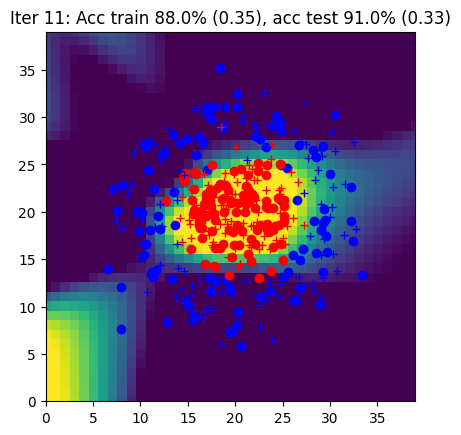

Iter 12: Acc train 88.5% (0.34), acc test 92.5% (0.32)


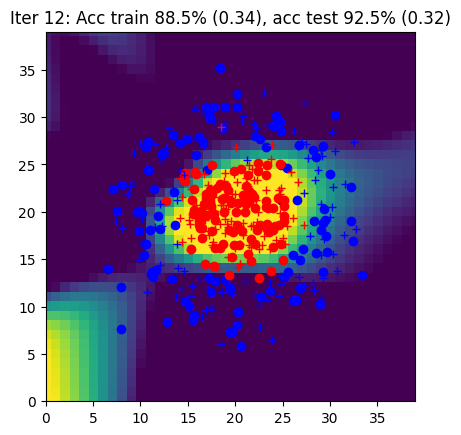

Iter 13: Acc train 89.0% (0.34), acc test 92.5% (0.31)


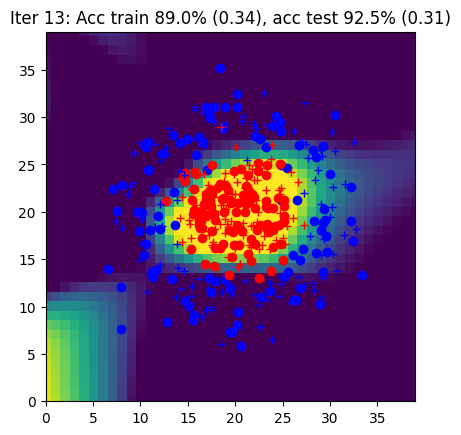

Iter 14: Acc train 90.0% (0.33), acc test 93.5% (0.31)


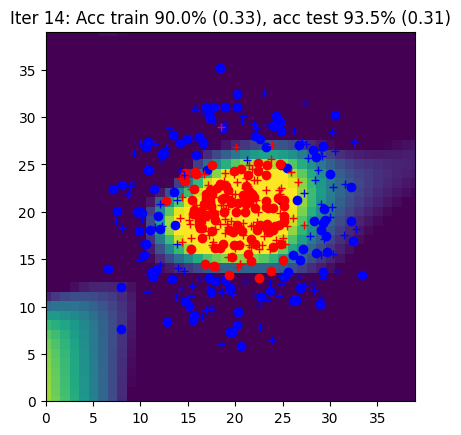

Iter 15: Acc train 90.5% (0.32), acc test 94.0% (0.30)


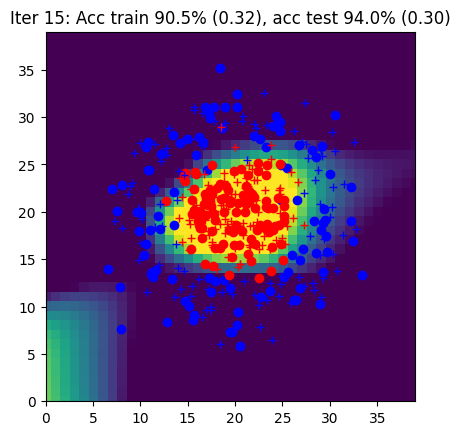

Iter 16: Acc train 90.5% (0.32), acc test 94.0% (0.30)


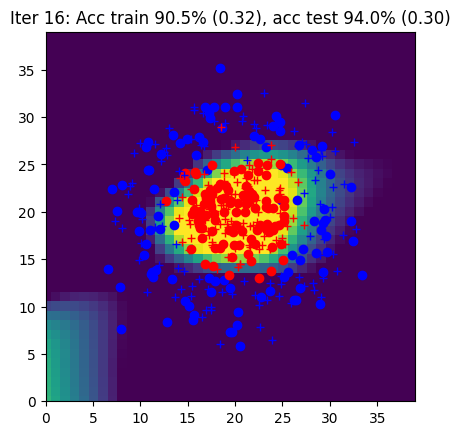

Iter 17: Acc train 90.5% (0.31), acc test 94.0% (0.29)


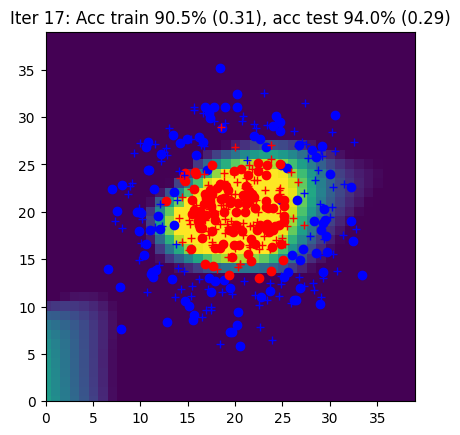

Iter 18: Acc train 90.5% (0.30), acc test 94.5% (0.29)


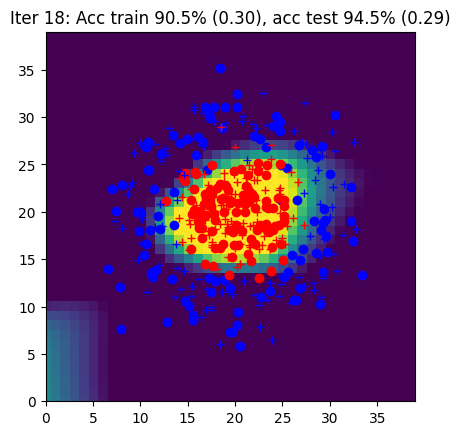

Iter 19: Acc train 90.5% (0.30), acc test 95.0% (0.28)


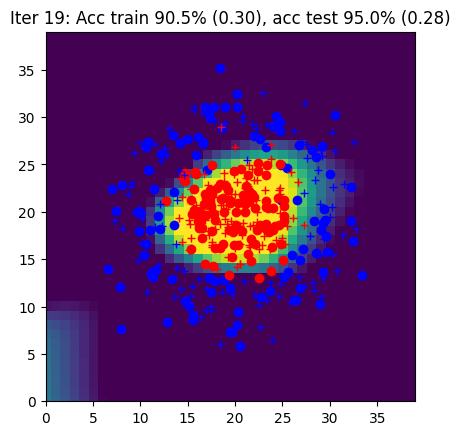

Iter 20: Acc train 90.5% (0.29), acc test 95.0% (0.28)


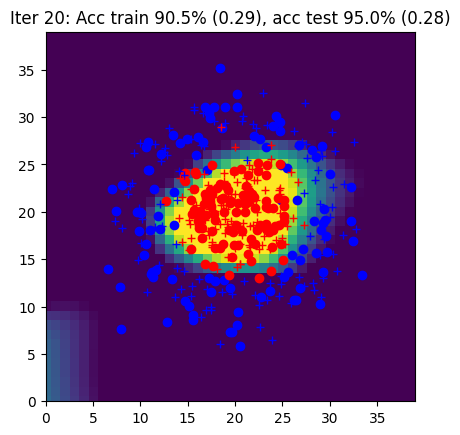

Iter 21: Acc train 91.0% (0.29), acc test 94.5% (0.27)


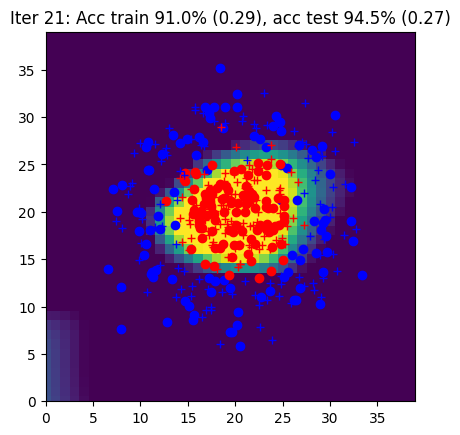

Iter 22: Acc train 91.5% (0.28), acc test 95.0% (0.27)


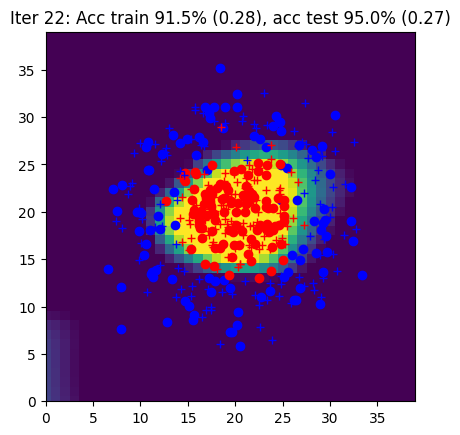

Iter 23: Acc train 91.0% (0.28), acc test 94.5% (0.27)


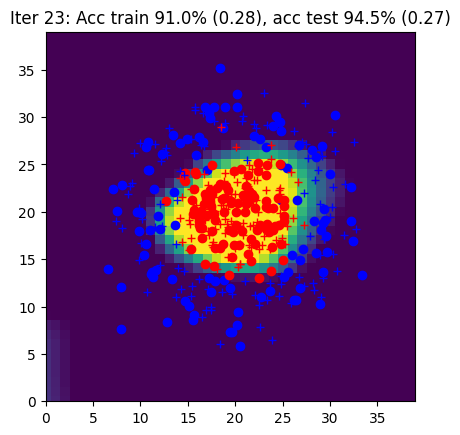

Iter 24: Acc train 92.5% (0.28), acc test 94.5% (0.26)


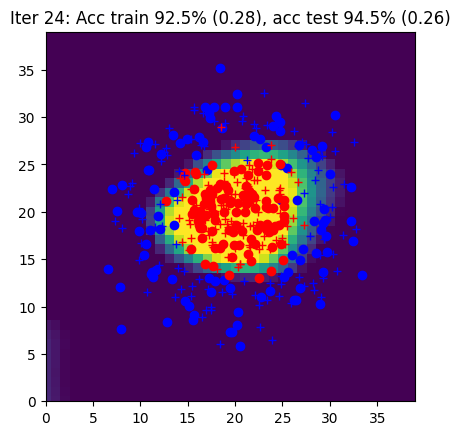

Iter 25: Acc train 91.5% (0.27), acc test 94.5% (0.26)


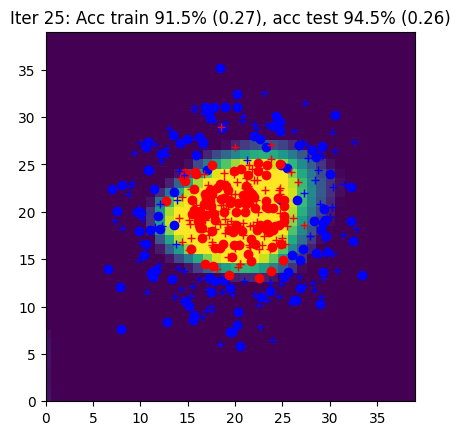

Iter 26: Acc train 92.5% (0.27), acc test 94.5% (0.26)


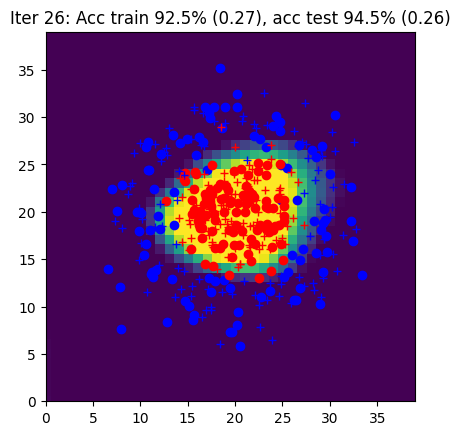

Iter 27: Acc train 93.0% (0.26), acc test 94.5% (0.25)


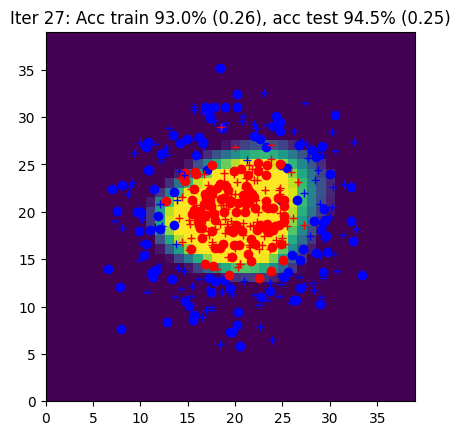

Iter 28: Acc train 92.0% (0.26), acc test 94.5% (0.25)


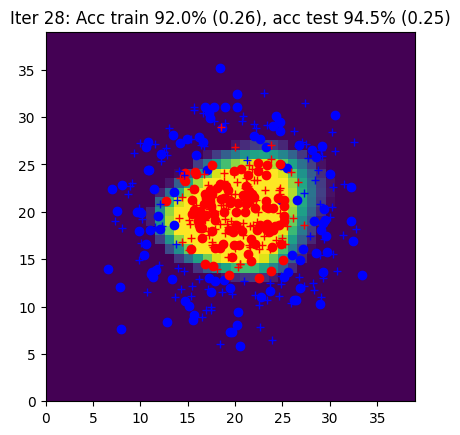

Iter 29: Acc train 92.0% (0.26), acc test 94.5% (0.25)


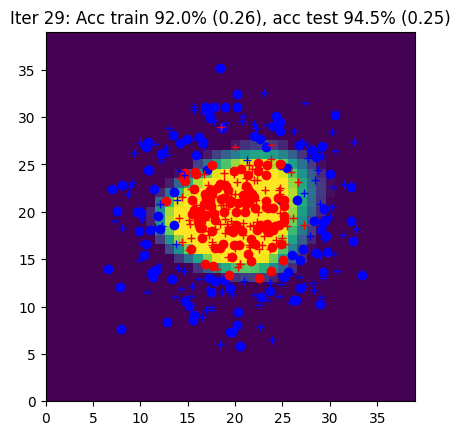

Iter 30: Acc train 93.0% (0.25), acc test 94.5% (0.24)


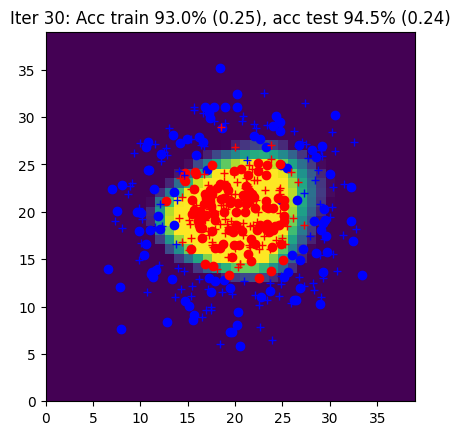

Iter 31: Acc train 93.5% (0.25), acc test 94.5% (0.24)


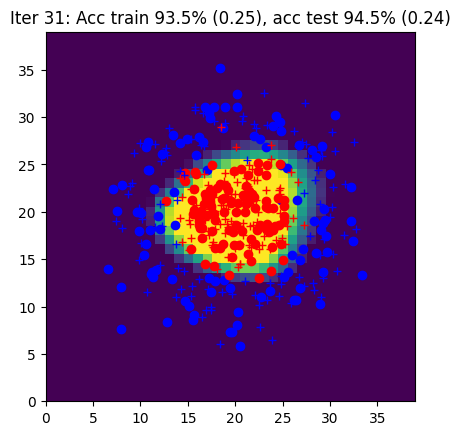

Iter 32: Acc train 93.5% (0.25), acc test 94.5% (0.24)


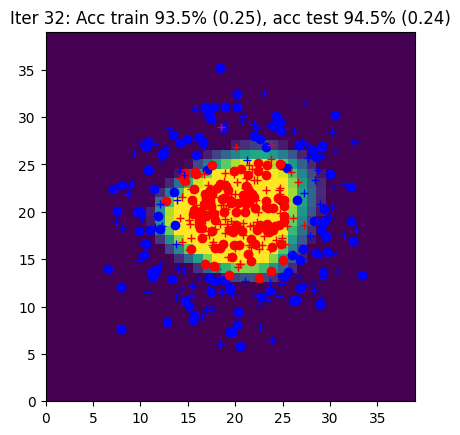

Iter 33: Acc train 94.0% (0.24), acc test 95.0% (0.24)


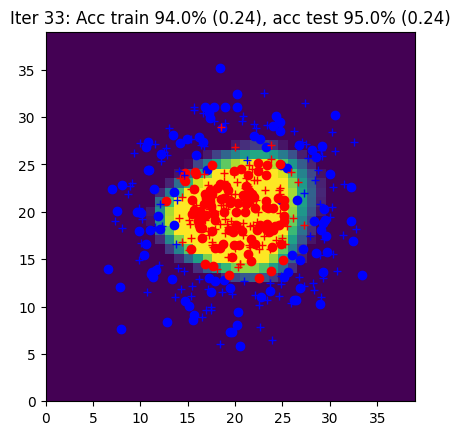

Iter 34: Acc train 94.0% (0.24), acc test 95.0% (0.23)


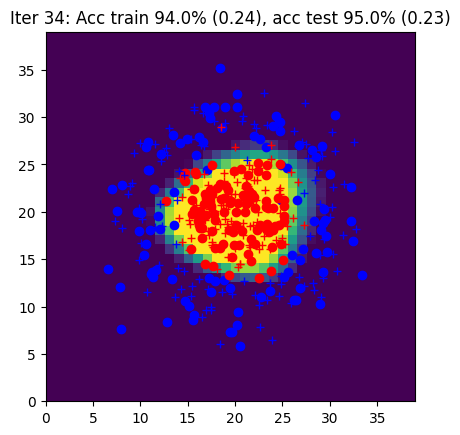

Iter 35: Acc train 94.0% (0.24), acc test 95.0% (0.23)


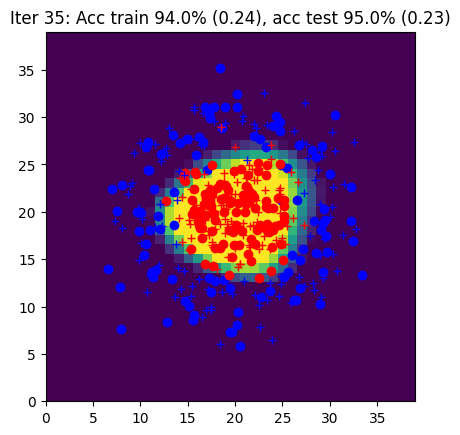

Iter 36: Acc train 94.5% (0.24), acc test 95.0% (0.23)


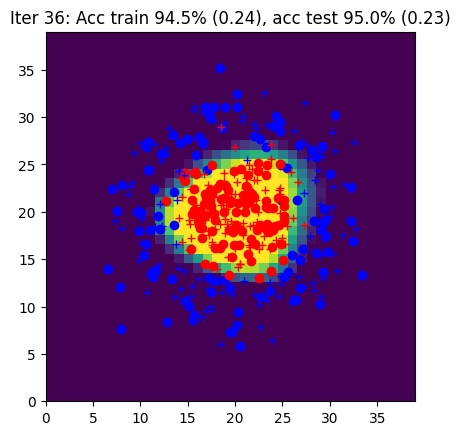

Iter 37: Acc train 94.0% (0.23), acc test 95.5% (0.23)


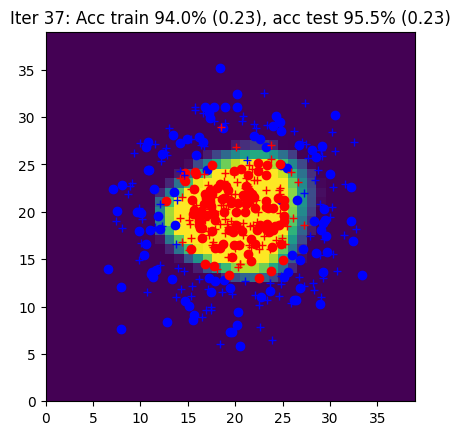

Iter 38: Acc train 94.0% (0.23), acc test 95.5% (0.23)


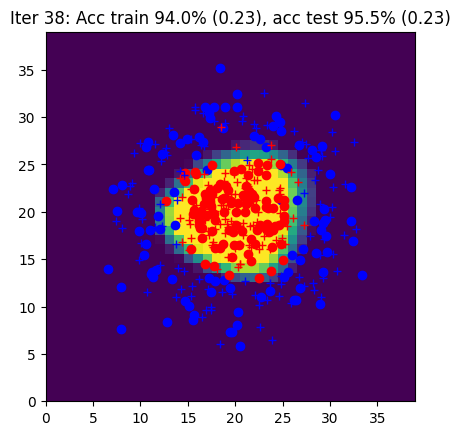

Iter 39: Acc train 94.5% (0.23), acc test 95.5% (0.22)


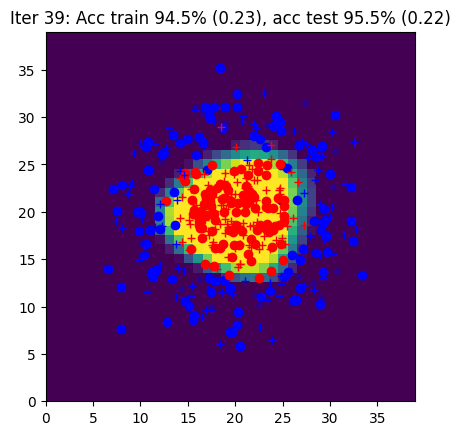

Iter 40: Acc train 94.5% (0.23), acc test 95.5% (0.22)


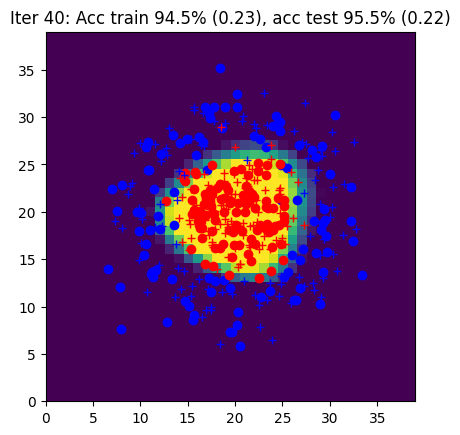

Iter 41: Acc train 94.5% (0.22), acc test 95.5% (0.22)


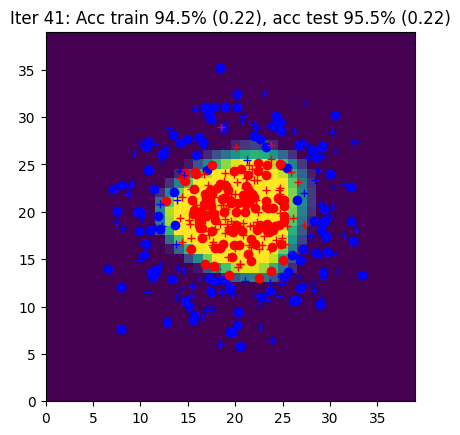

Iter 42: Acc train 93.5% (0.22), acc test 95.5% (0.22)


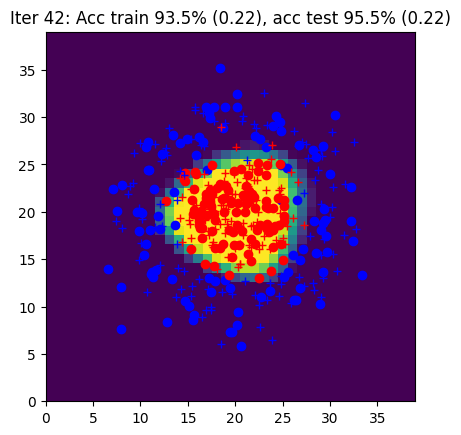

Iter 43: Acc train 94.5% (0.22), acc test 95.5% (0.22)


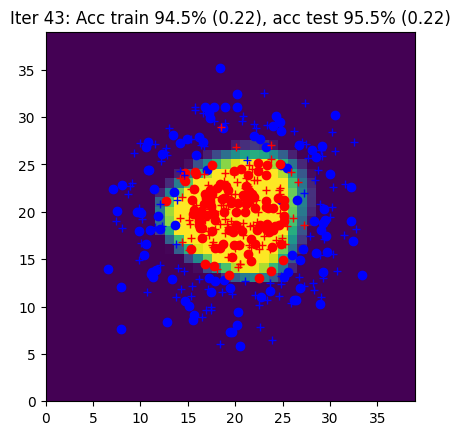

Iter 44: Acc train 95.0% (0.22), acc test 95.5% (0.21)


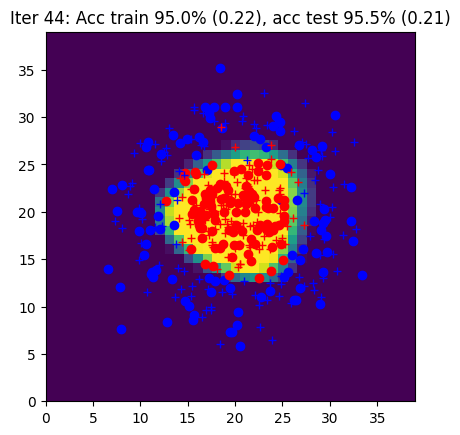

Iter 45: Acc train 95.0% (0.22), acc test 95.5% (0.21)


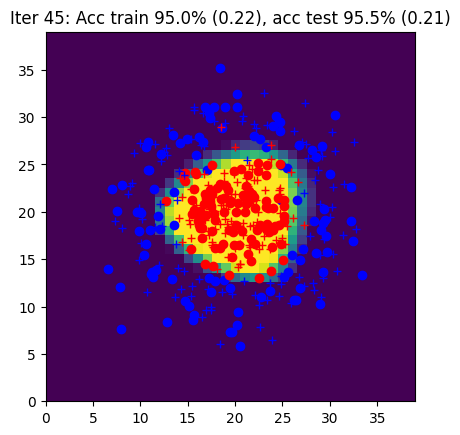

Iter 46: Acc train 95.0% (0.21), acc test 95.5% (0.21)


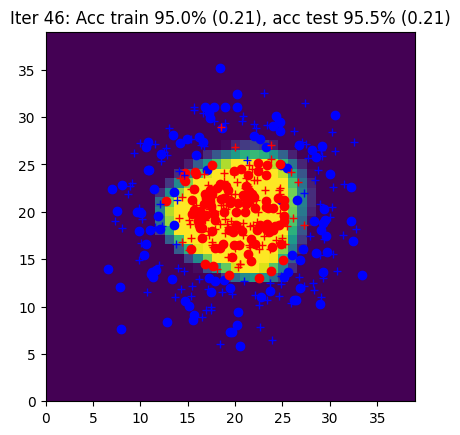

Iter 47: Acc train 95.0% (0.21), acc test 95.5% (0.21)


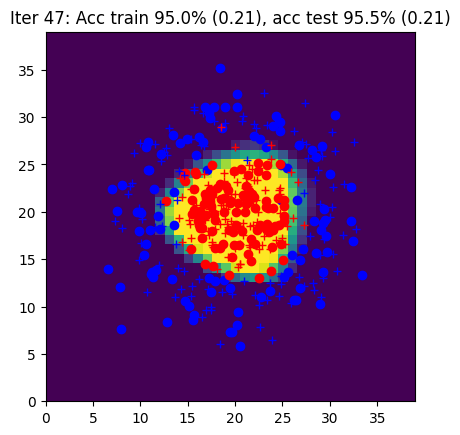

Iter 48: Acc train 95.0% (0.21), acc test 95.5% (0.21)


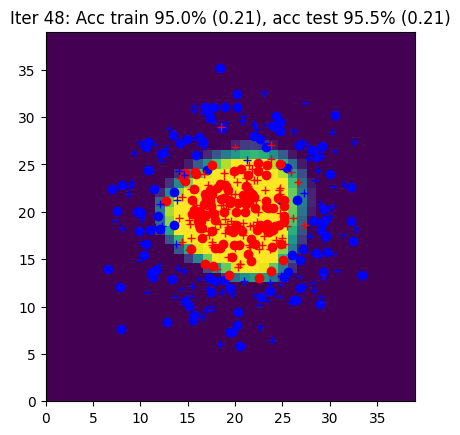

Iter 49: Acc train 95.0% (0.21), acc test 95.5% (0.21)


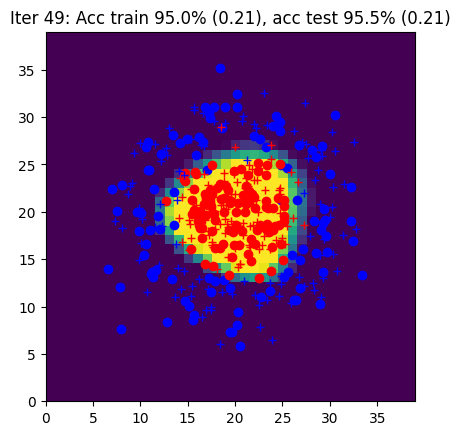

Iter 50: Acc train 95.0% (0.21), acc test 95.0% (0.21)


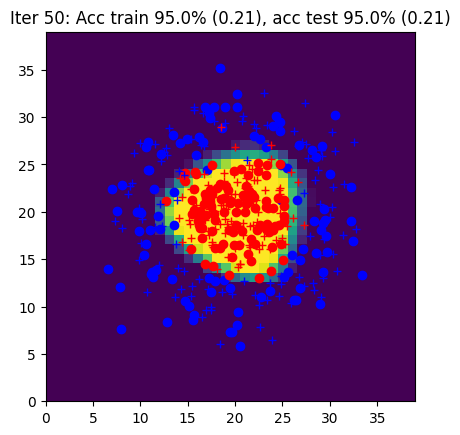

Iter 51: Acc train 95.0% (0.20), acc test 95.5% (0.20)


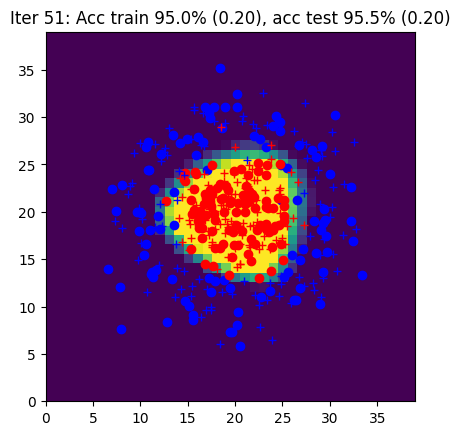

Iter 52: Acc train 95.0% (0.20), acc test 95.5% (0.20)


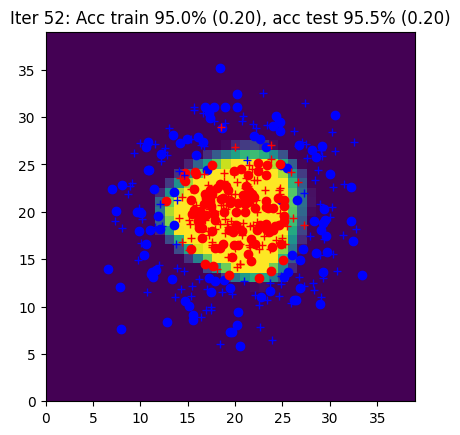

Iter 53: Acc train 95.5% (0.20), acc test 95.0% (0.20)


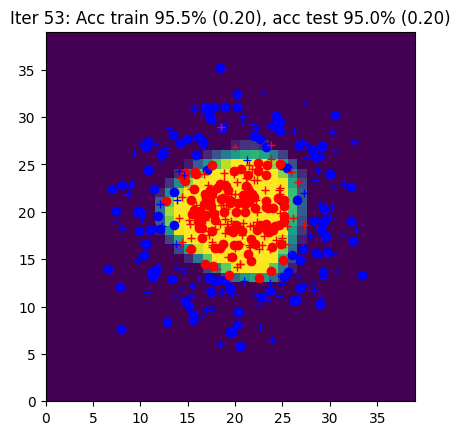

Iter 54: Acc train 96.0% (0.20), acc test 95.0% (0.20)


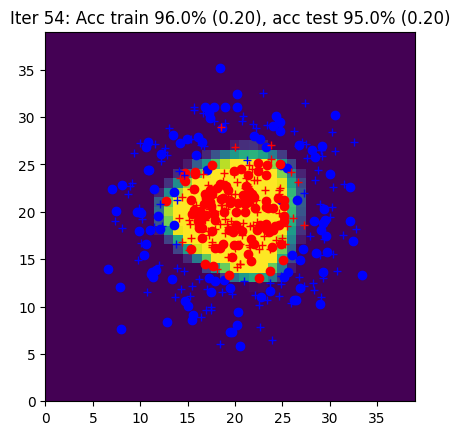

Iter 55: Acc train 95.0% (0.20), acc test 95.0% (0.20)


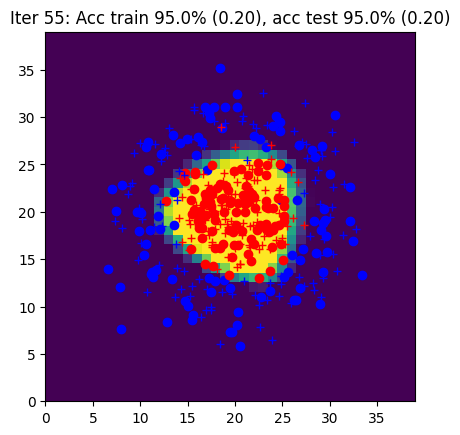

Iter 56: Acc train 96.0% (0.20), acc test 95.0% (0.20)


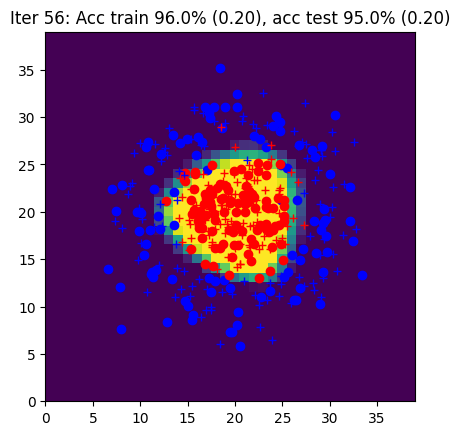

Iter 57: Acc train 96.0% (0.19), acc test 95.0% (0.20)


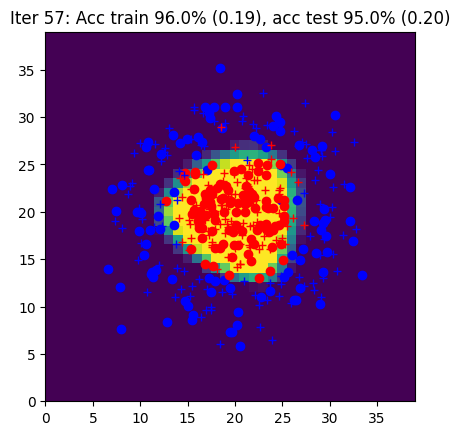

Iter 58: Acc train 96.0% (0.19), acc test 95.0% (0.20)


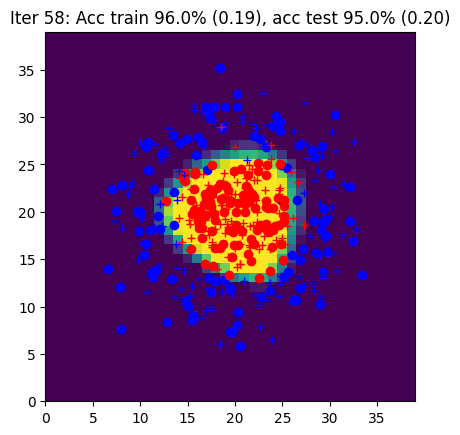

Iter 59: Acc train 96.0% (0.19), acc test 95.0% (0.20)


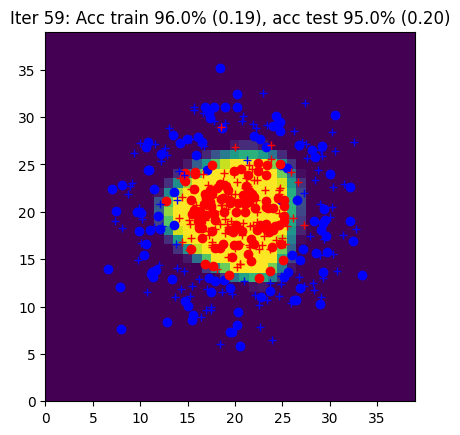

Iter 60: Acc train 96.0% (0.19), acc test 95.0% (0.20)


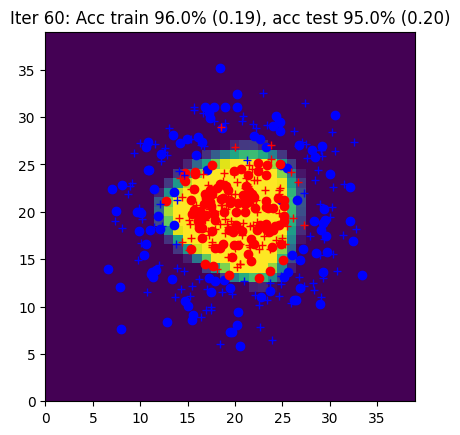

Iter 61: Acc train 96.0% (0.19), acc test 95.0% (0.20)


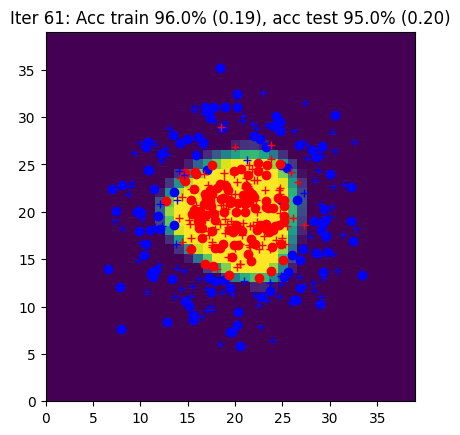

Iter 62: Acc train 96.0% (0.19), acc test 95.0% (0.19)


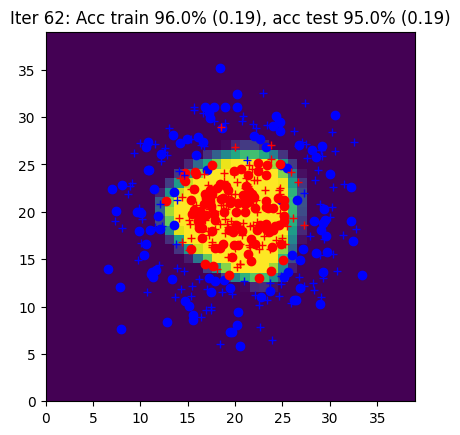

Iter 63: Acc train 96.0% (0.19), acc test 95.0% (0.19)


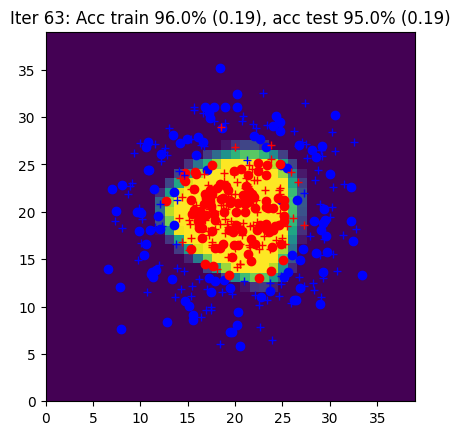

Iter 64: Acc train 96.5% (0.19), acc test 95.0% (0.19)


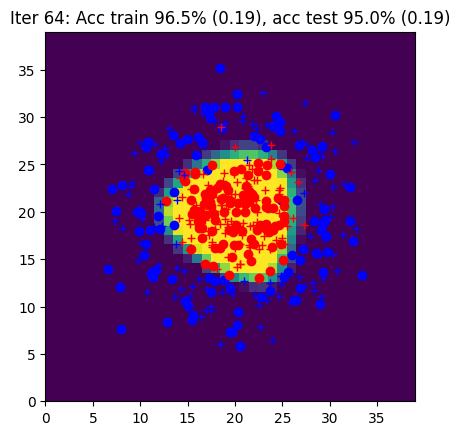

Iter 65: Acc train 96.0% (0.18), acc test 95.0% (0.19)


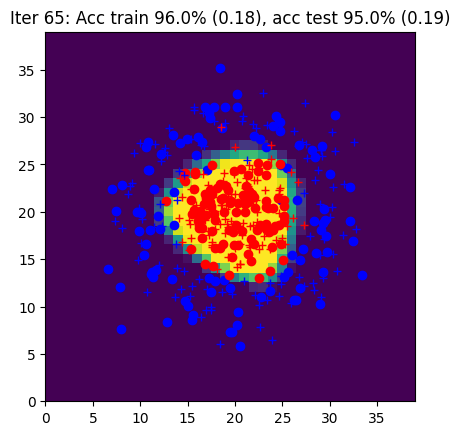

Iter 66: Acc train 96.0% (0.18), acc test 95.0% (0.19)


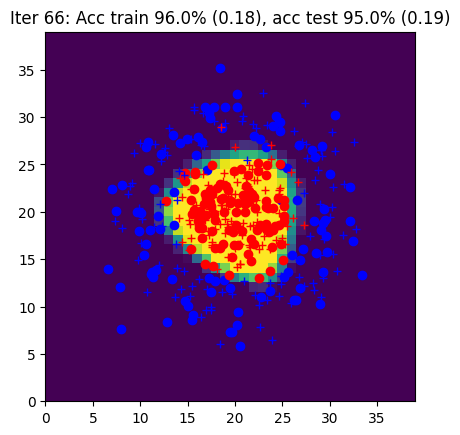

Iter 67: Acc train 96.0% (0.18), acc test 95.0% (0.19)


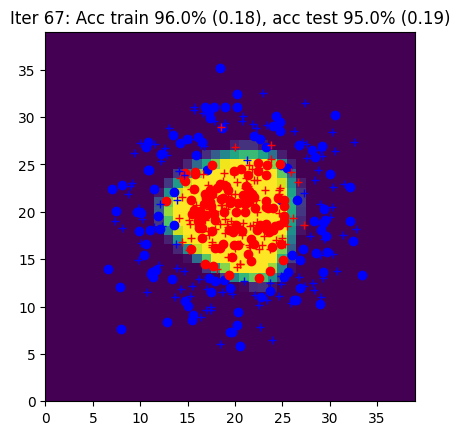

Iter 68: Acc train 96.5% (0.18), acc test 94.5% (0.19)


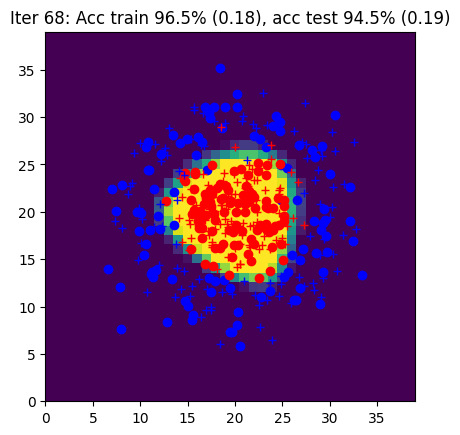

Iter 69: Acc train 96.5% (0.18), acc test 95.0% (0.19)


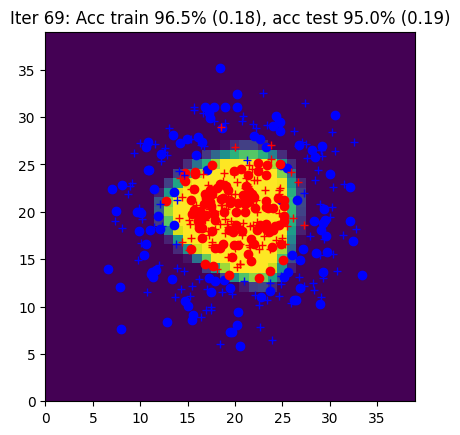

Iter 70: Acc train 96.0% (0.18), acc test 94.0% (0.19)


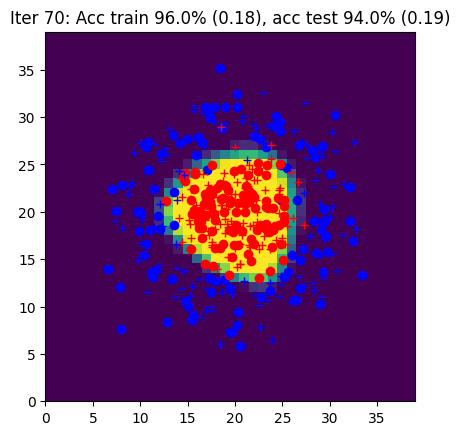

Iter 71: Acc train 96.5% (0.18), acc test 94.5% (0.19)


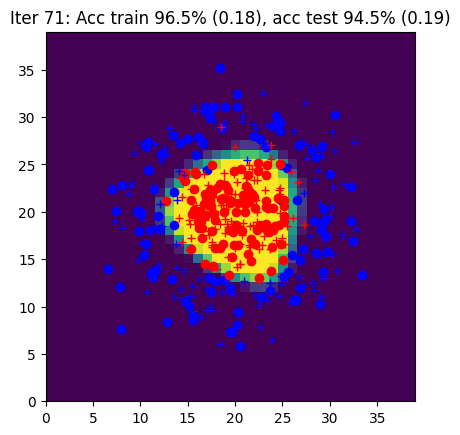

Iter 72: Acc train 96.0% (0.18), acc test 94.5% (0.19)


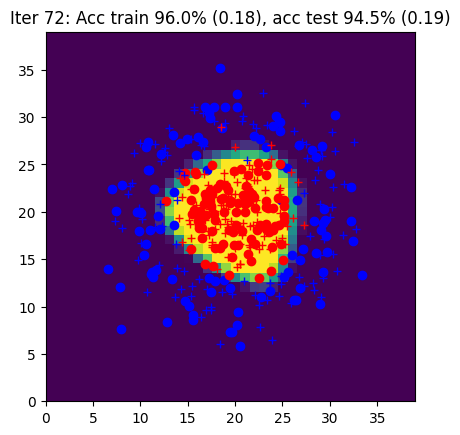

Iter 73: Acc train 96.5% (0.18), acc test 95.0% (0.19)


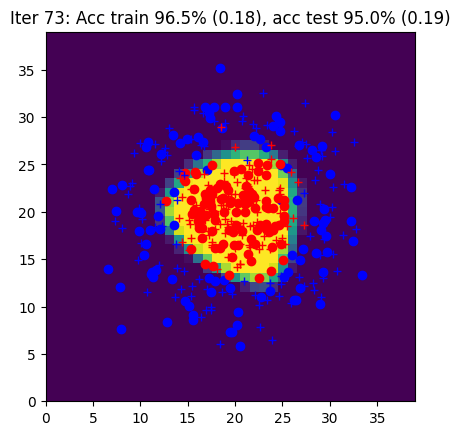

Iter 74: Acc train 95.5% (0.18), acc test 94.0% (0.19)


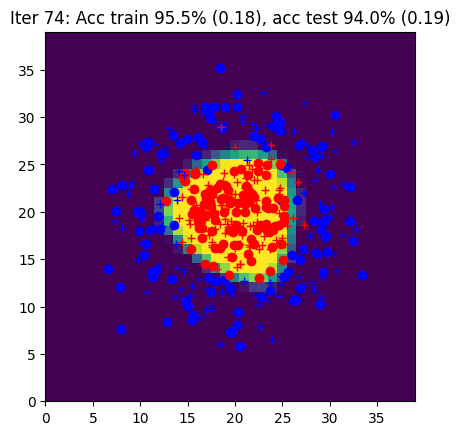

Iter 75: Acc train 96.5% (0.17), acc test 94.5% (0.19)


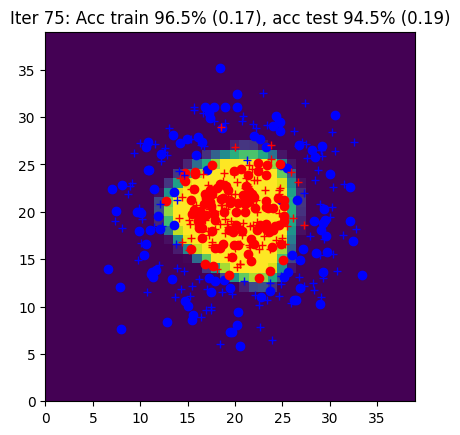

Iter 76: Acc train 96.5% (0.17), acc test 95.0% (0.18)


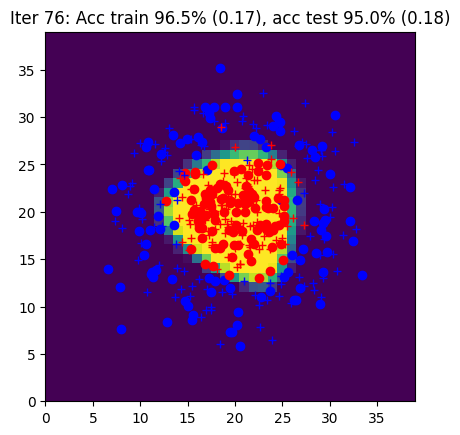

Iter 77: Acc train 96.5% (0.17), acc test 94.5% (0.18)


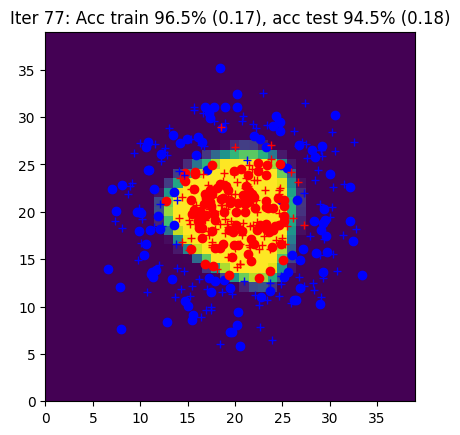

Iter 78: Acc train 96.5% (0.17), acc test 94.0% (0.18)


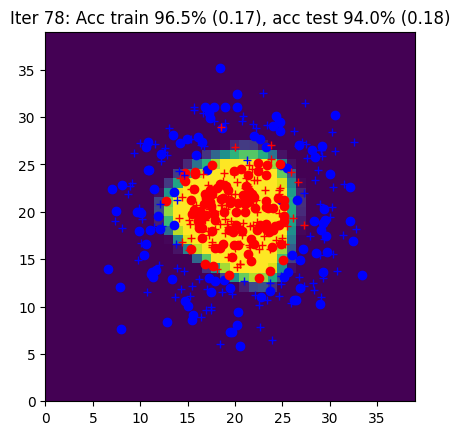

Iter 79: Acc train 96.0% (0.17), acc test 93.5% (0.18)


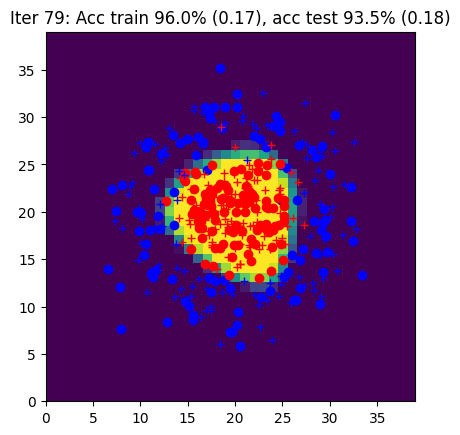

Iter 80: Acc train 96.5% (0.17), acc test 95.0% (0.18)


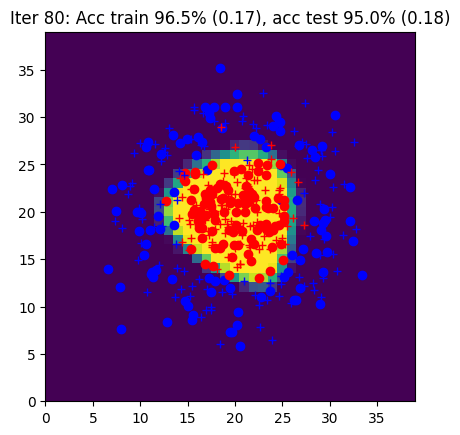

Iter 81: Acc train 96.5% (0.17), acc test 94.0% (0.18)


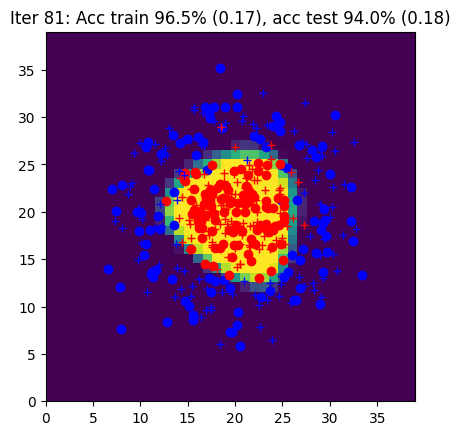

Iter 82: Acc train 96.5% (0.17), acc test 93.5% (0.18)


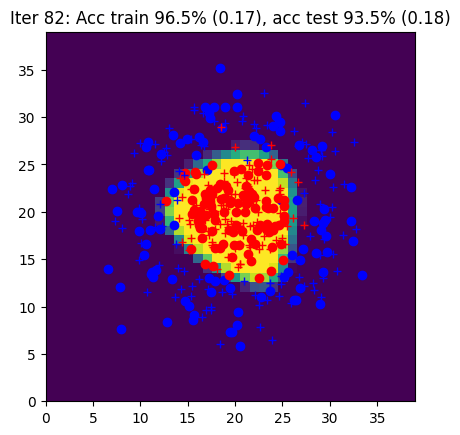

Iter 83: Acc train 96.5% (0.17), acc test 93.5% (0.18)


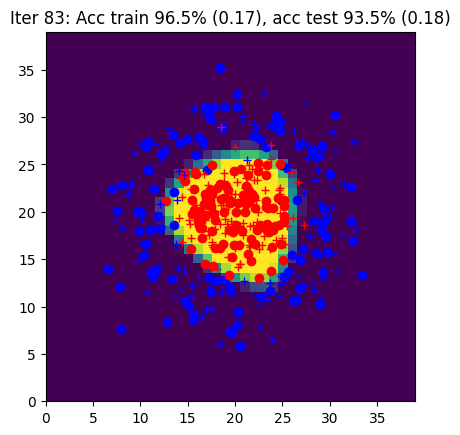

Iter 84: Acc train 96.5% (0.17), acc test 93.5% (0.18)


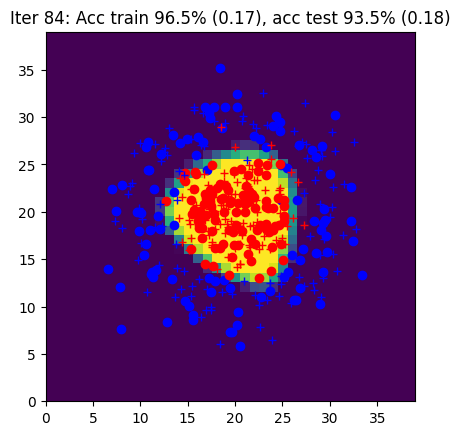

Iter 85: Acc train 96.5% (0.17), acc test 93.5% (0.18)


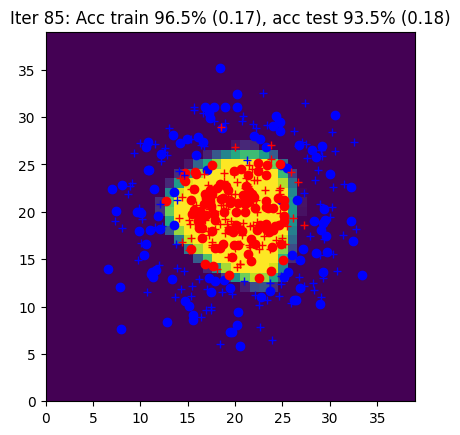

Iter 86: Acc train 96.5% (0.16), acc test 93.5% (0.18)


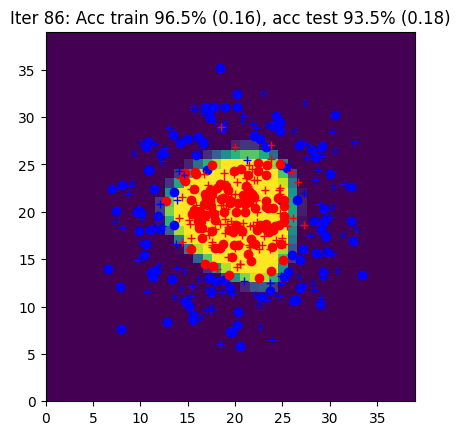

Iter 87: Acc train 96.5% (0.16), acc test 94.0% (0.18)


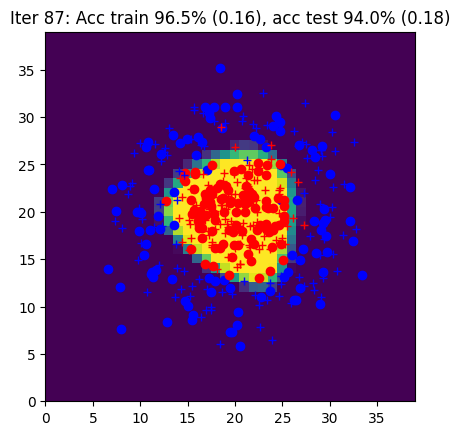

Iter 88: Acc train 96.5% (0.16), acc test 94.0% (0.18)


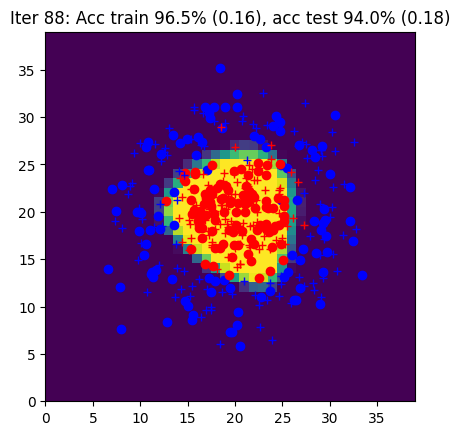

Iter 89: Acc train 96.5% (0.16), acc test 94.0% (0.18)


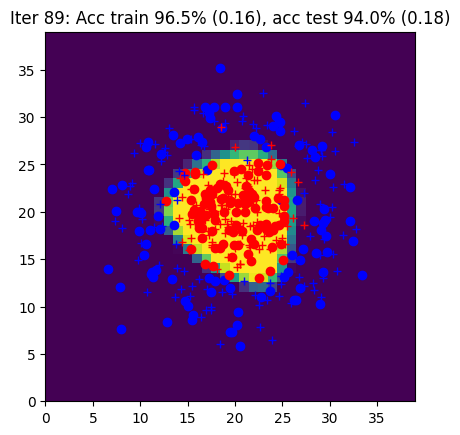

Iter 90: Acc train 96.5% (0.16), acc test 93.0% (0.18)


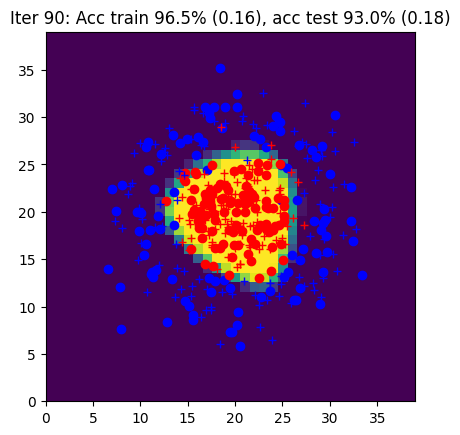

Iter 91: Acc train 96.5% (0.16), acc test 93.5% (0.18)


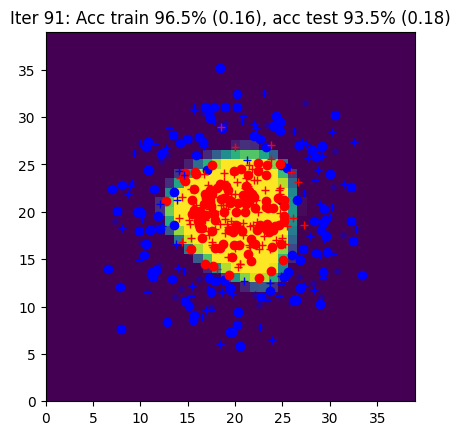

Iter 92: Acc train 96.5% (0.16), acc test 93.5% (0.18)


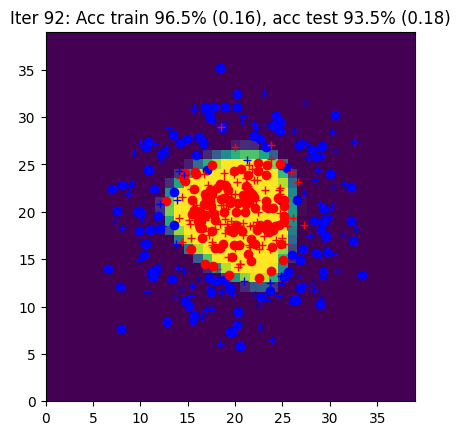

Iter 93: Acc train 96.5% (0.16), acc test 93.5% (0.18)


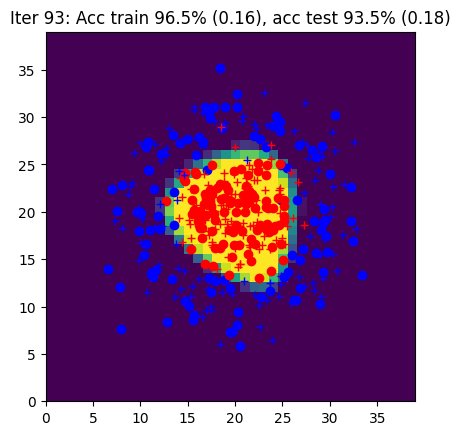

Iter 94: Acc train 96.5% (0.16), acc test 93.5% (0.18)


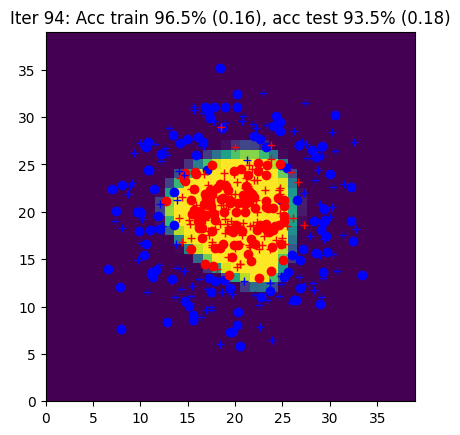

Iter 95: Acc train 96.5% (0.16), acc test 93.0% (0.18)


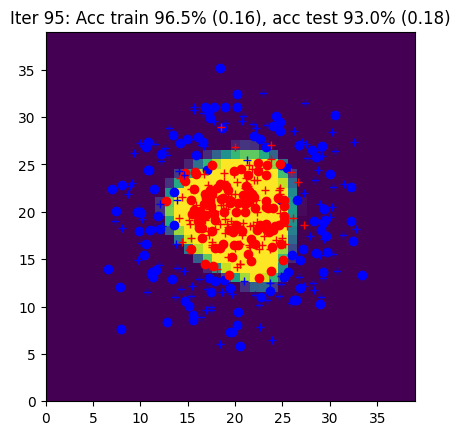

Iter 96: Acc train 96.5% (0.16), acc test 93.0% (0.18)


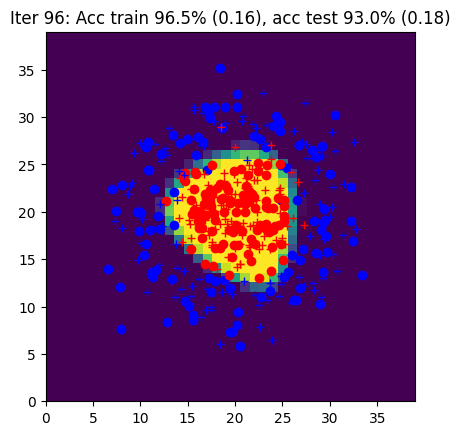

Iter 97: Acc train 96.5% (0.16), acc test 93.0% (0.18)


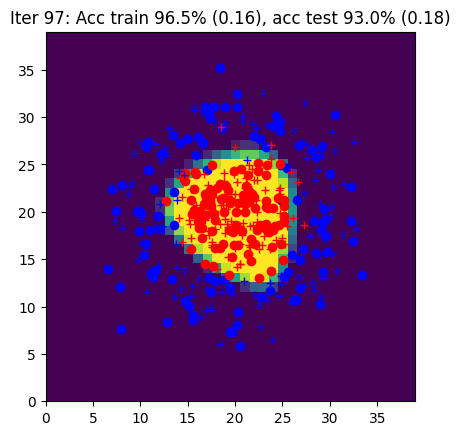

Iter 98: Acc train 96.5% (0.16), acc test 93.0% (0.18)


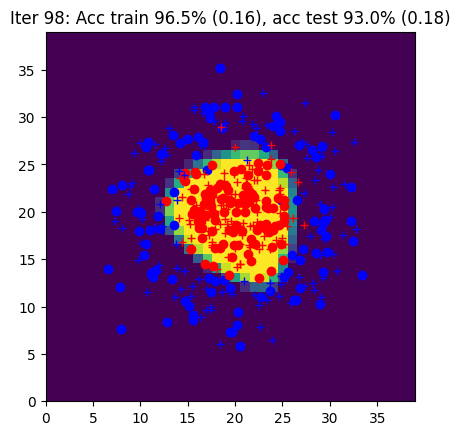

Iter 99: Acc train 96.5% (0.16), acc test 93.0% (0.18)


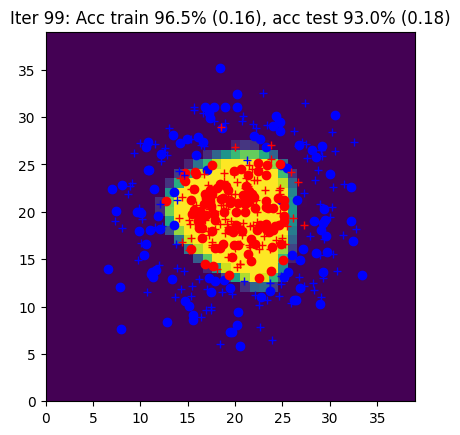

Iter 100: Acc train 96.5% (0.16), acc test 93.5% (0.18)


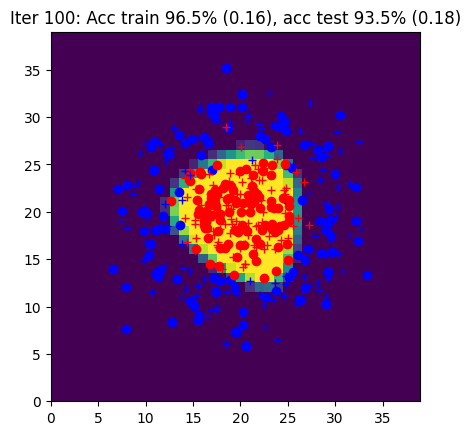

Iter 101: Acc train 96.5% (0.15), acc test 93.5% (0.18)


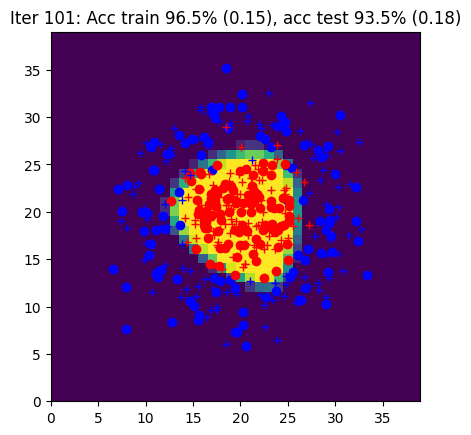

Iter 102: Acc train 96.5% (0.15), acc test 93.5% (0.17)


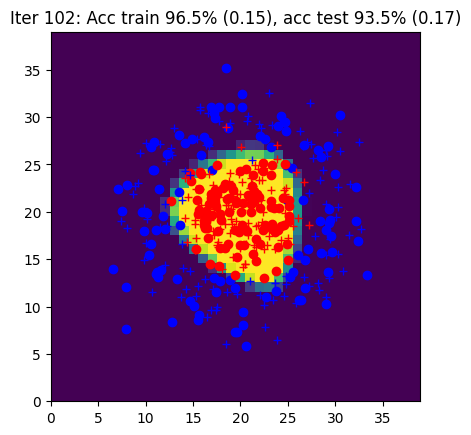

Iter 103: Acc train 96.5% (0.15), acc test 92.5% (0.17)


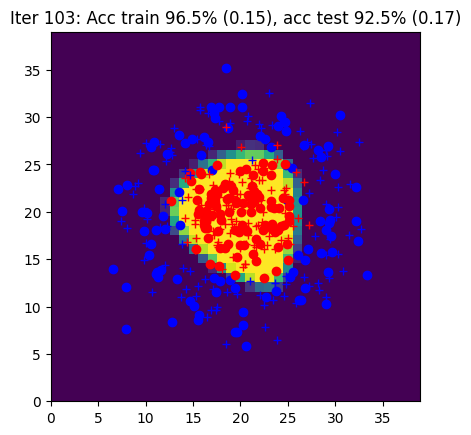

Iter 104: Acc train 96.5% (0.15), acc test 93.0% (0.17)


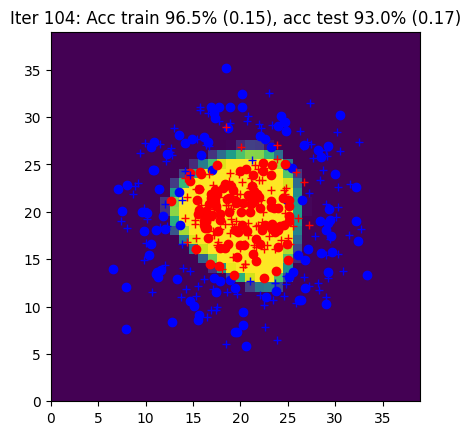

Iter 105: Acc train 96.5% (0.15), acc test 93.0% (0.17)


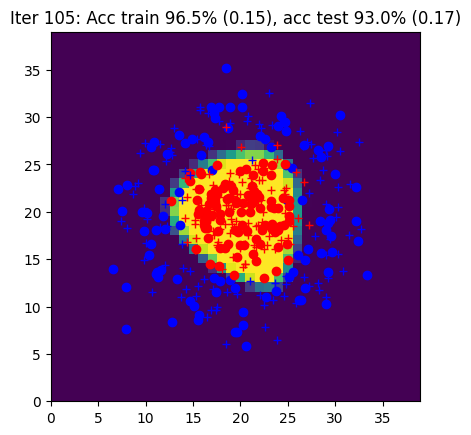

Iter 106: Acc train 96.5% (0.15), acc test 92.5% (0.17)


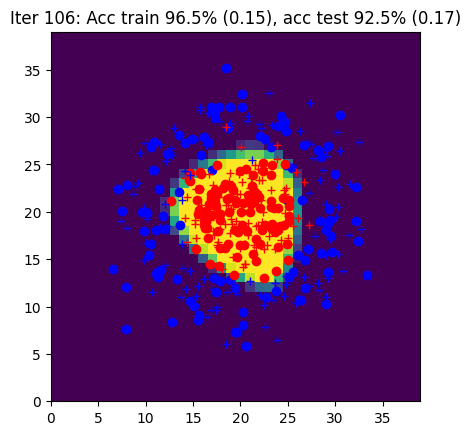

Iter 107: Acc train 96.0% (0.15), acc test 93.0% (0.17)


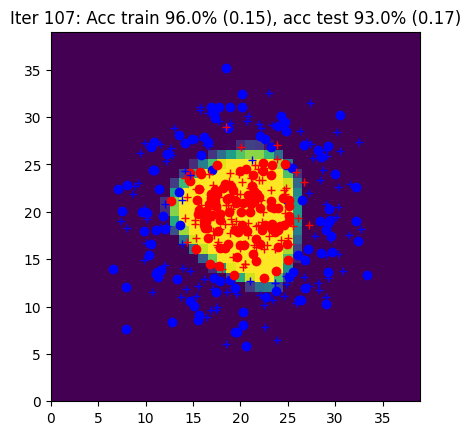

Iter 108: Acc train 96.5% (0.15), acc test 93.5% (0.17)


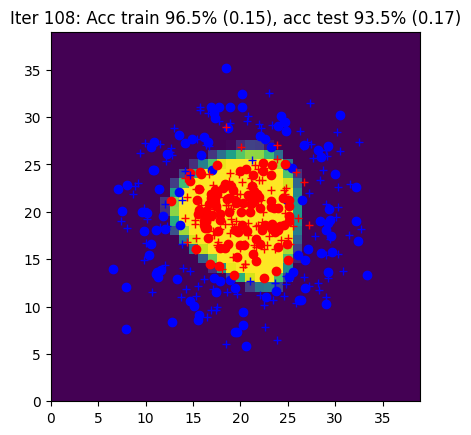

Iter 109: Acc train 96.5% (0.15), acc test 92.5% (0.17)


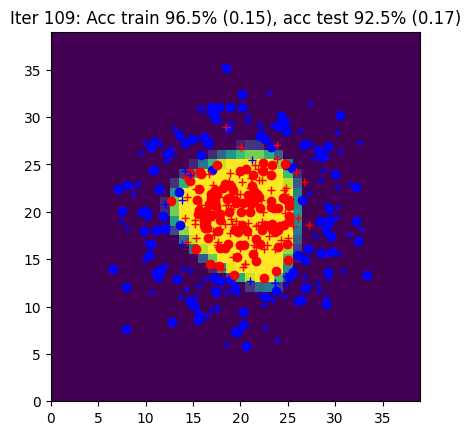

Iter 110: Acc train 96.5% (0.15), acc test 93.0% (0.17)


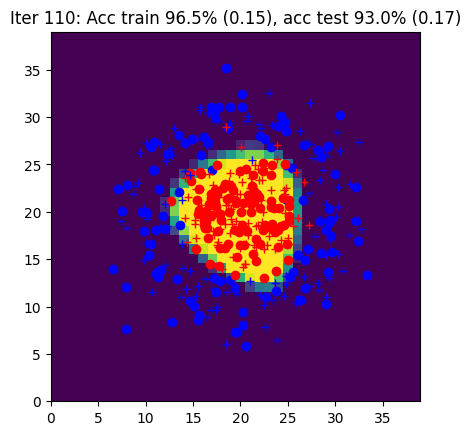

Iter 111: Acc train 96.5% (0.15), acc test 93.0% (0.17)


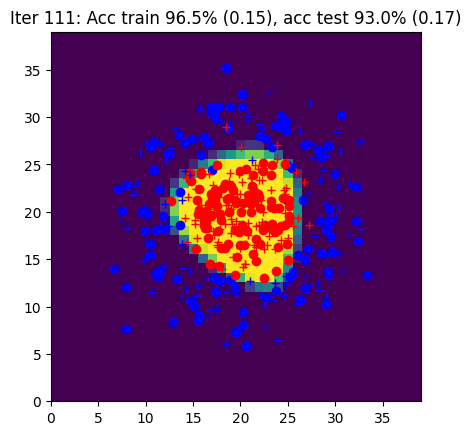

Iter 112: Acc train 96.5% (0.15), acc test 93.0% (0.17)


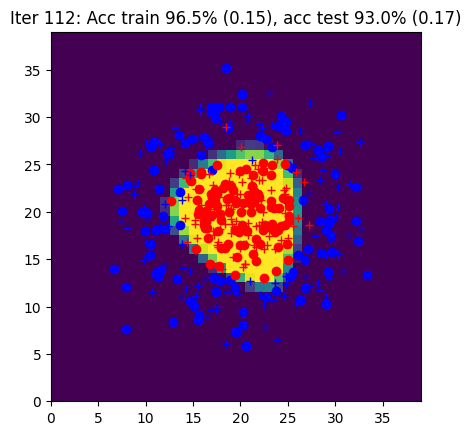

Iter 113: Acc train 96.5% (0.15), acc test 93.0% (0.17)


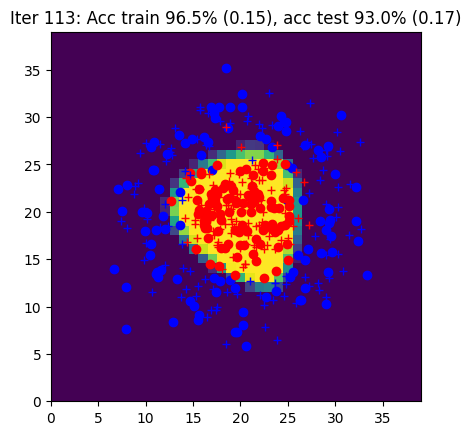

Iter 114: Acc train 96.5% (0.15), acc test 93.0% (0.17)


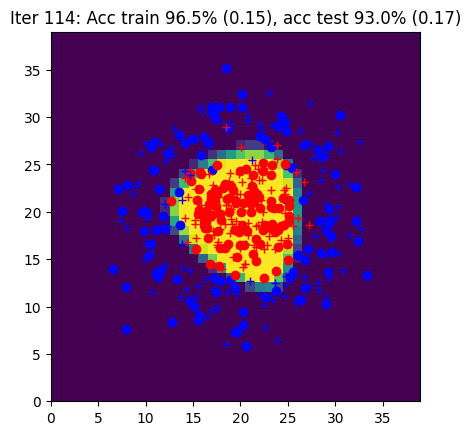

Iter 115: Acc train 96.5% (0.15), acc test 92.5% (0.17)


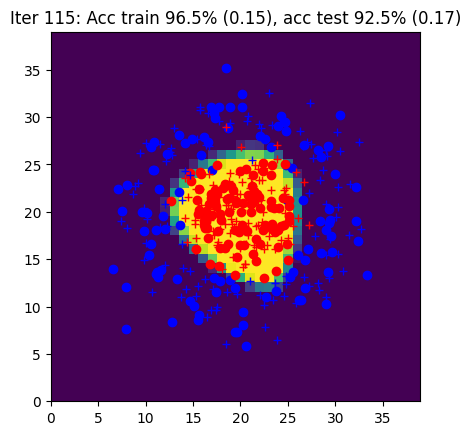

Iter 116: Acc train 96.5% (0.15), acc test 92.5% (0.17)


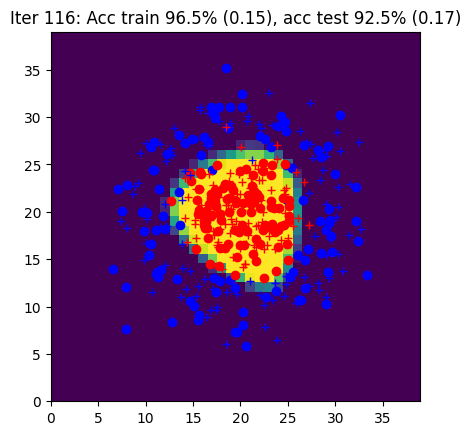

Iter 117: Acc train 96.5% (0.15), acc test 92.5% (0.17)


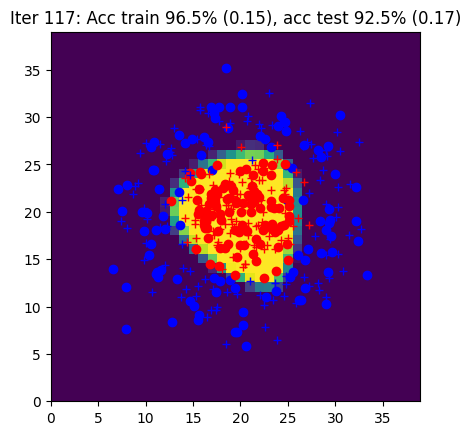

Iter 118: Acc train 96.5% (0.15), acc test 92.5% (0.17)


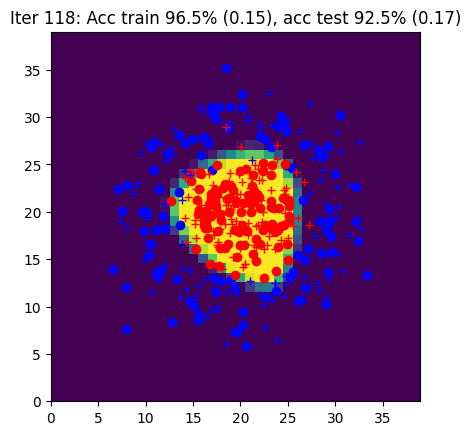

Iter 119: Acc train 96.5% (0.15), acc test 92.5% (0.17)


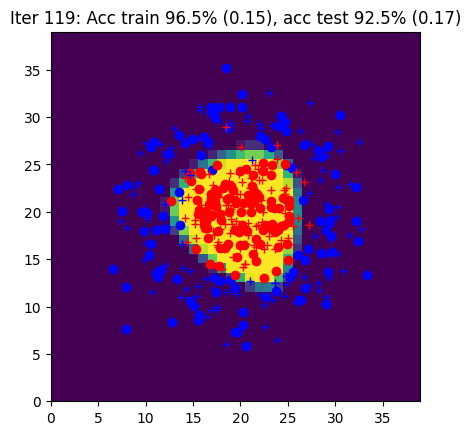

Iter 120: Acc train 96.5% (0.14), acc test 92.5% (0.17)


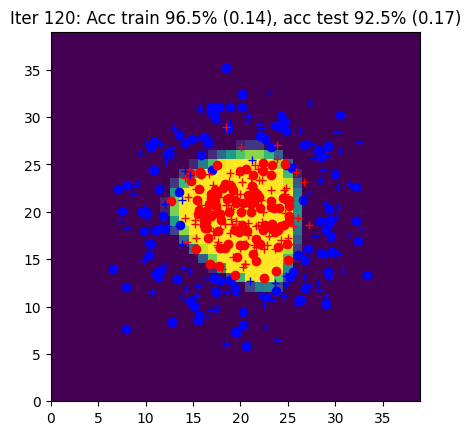

Iter 121: Acc train 96.5% (0.14), acc test 92.5% (0.17)


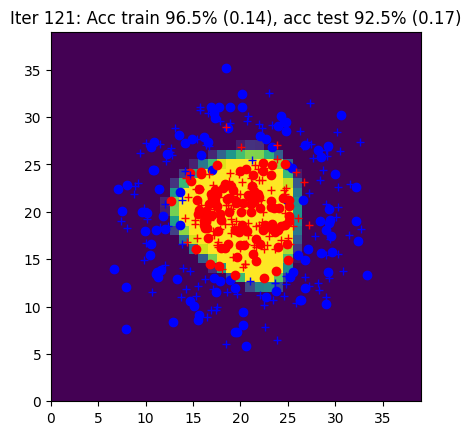

Iter 122: Acc train 96.5% (0.14), acc test 93.0% (0.17)


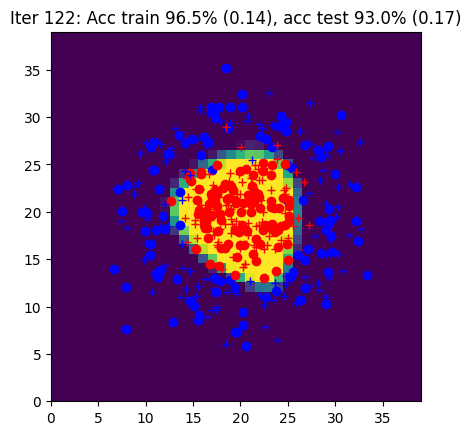

Iter 123: Acc train 96.5% (0.14), acc test 92.5% (0.17)


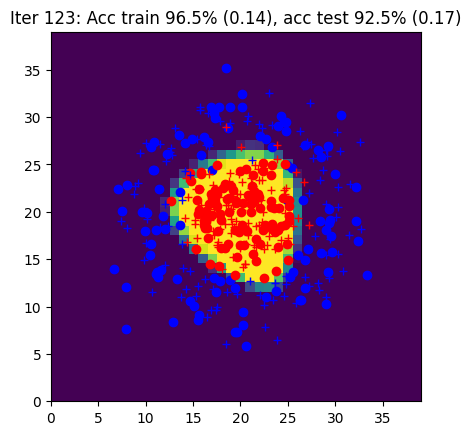

Iter 124: Acc train 96.5% (0.14), acc test 93.0% (0.17)


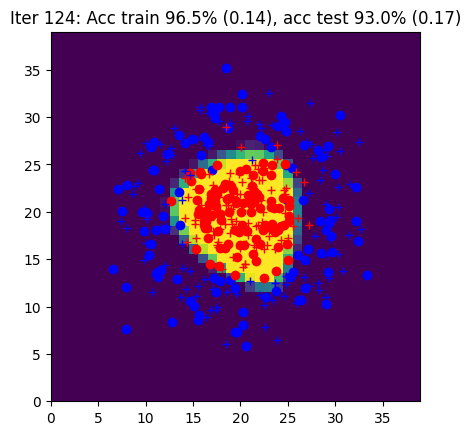

Iter 125: Acc train 96.5% (0.14), acc test 92.5% (0.17)


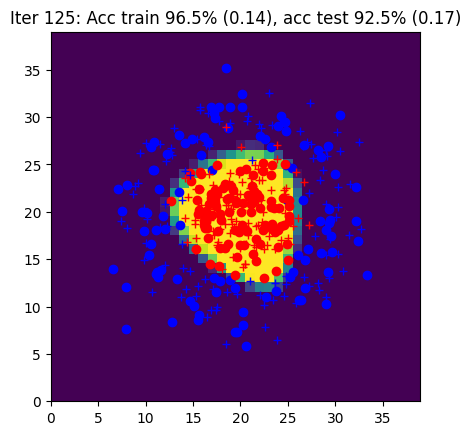

Iter 126: Acc train 96.5% (0.14), acc test 92.5% (0.17)


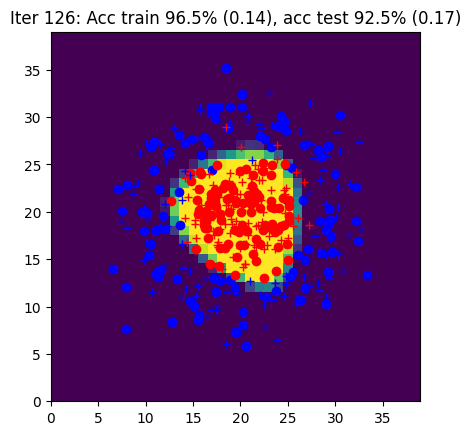

Iter 127: Acc train 96.5% (0.14), acc test 92.5% (0.17)


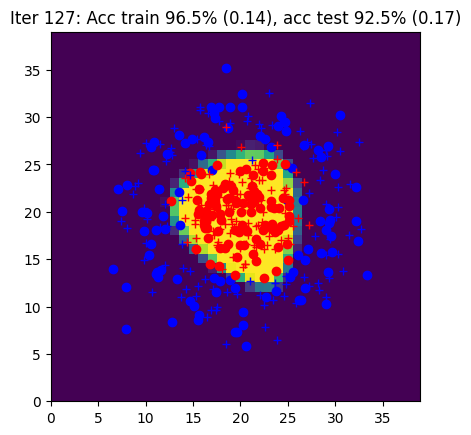

Iter 128: Acc train 96.5% (0.14), acc test 93.0% (0.17)


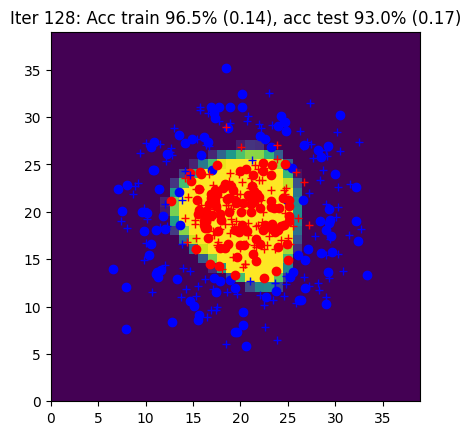

Iter 129: Acc train 96.5% (0.14), acc test 93.0% (0.17)


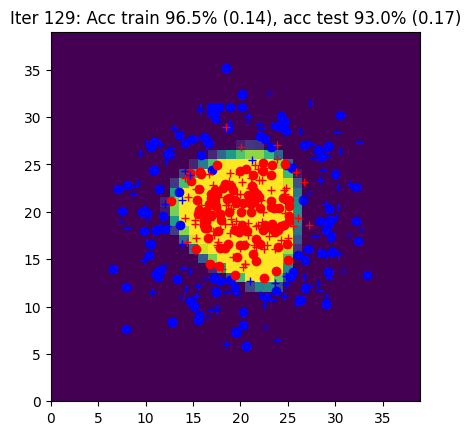

Iter 130: Acc train 96.5% (0.14), acc test 93.0% (0.17)


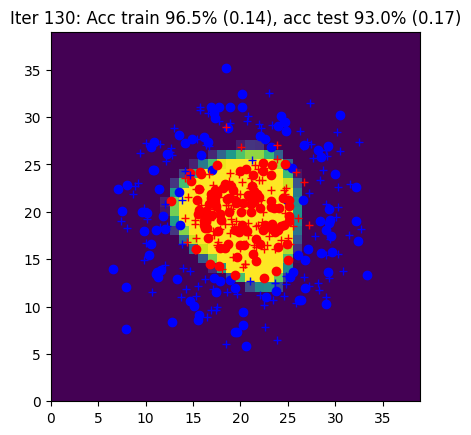

Iter 131: Acc train 96.5% (0.14), acc test 93.0% (0.17)


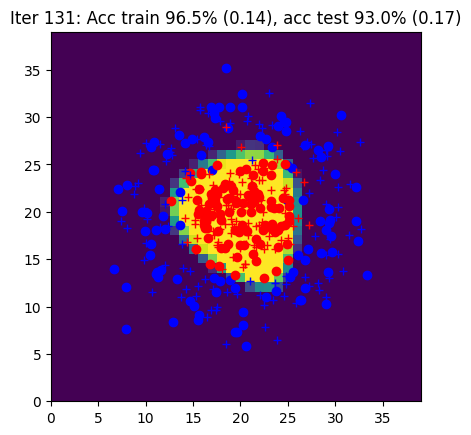

Iter 132: Acc train 96.5% (0.14), acc test 92.5% (0.17)


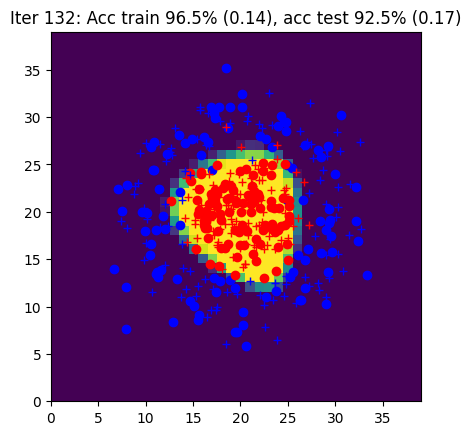

Iter 133: Acc train 96.5% (0.14), acc test 93.0% (0.17)


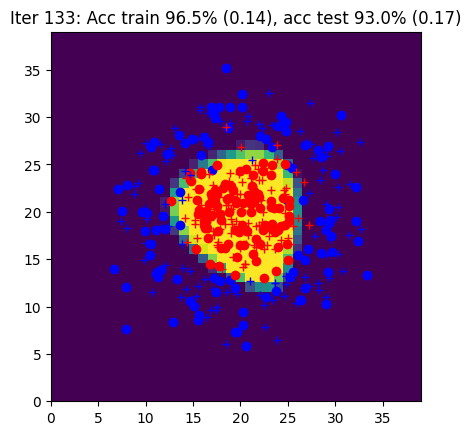

Iter 134: Acc train 96.5% (0.14), acc test 93.0% (0.17)


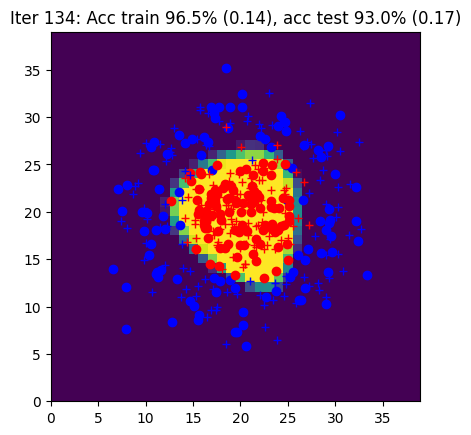

Iter 135: Acc train 96.5% (0.14), acc test 92.5% (0.17)


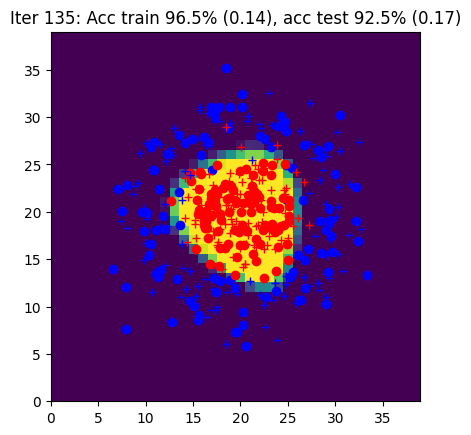

Iter 136: Acc train 96.5% (0.14), acc test 92.5% (0.17)


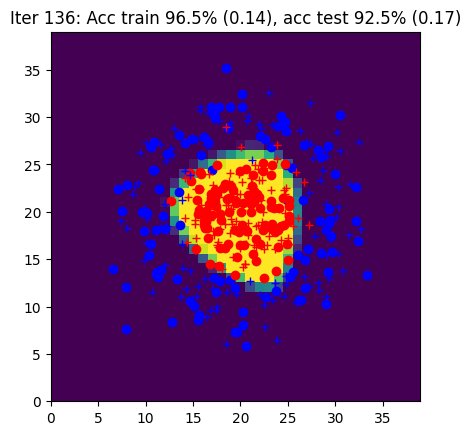

Iter 137: Acc train 96.5% (0.14), acc test 92.5% (0.17)


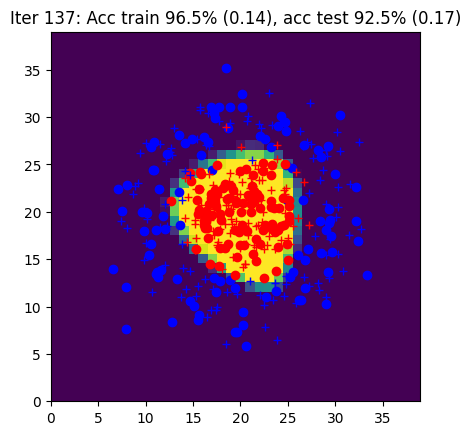

Iter 138: Acc train 96.5% (0.14), acc test 92.5% (0.17)


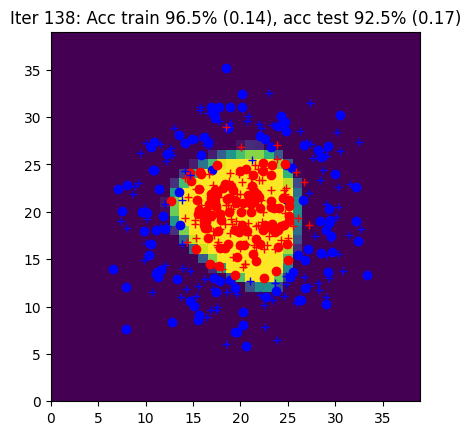

Iter 139: Acc train 96.5% (0.14), acc test 92.5% (0.17)


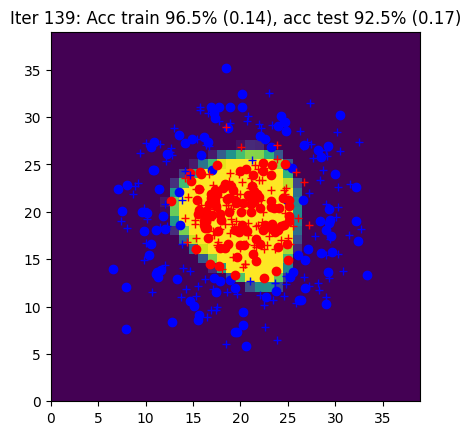

Iter 140: Acc train 96.5% (0.14), acc test 93.0% (0.17)


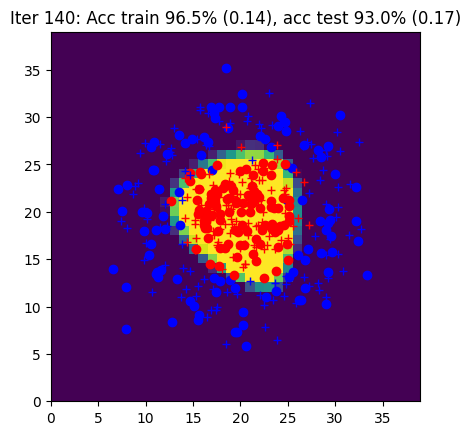

Iter 141: Acc train 97.0% (0.14), acc test 93.0% (0.17)


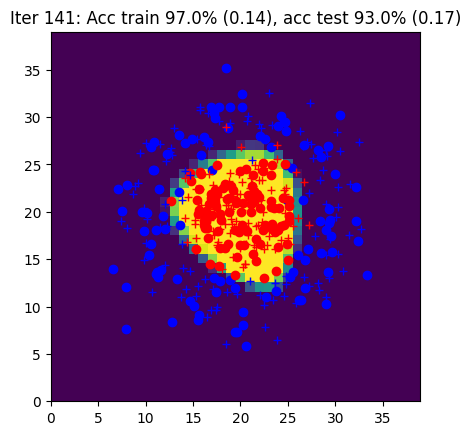

Iter 142: Acc train 96.5% (0.14), acc test 93.0% (0.17)


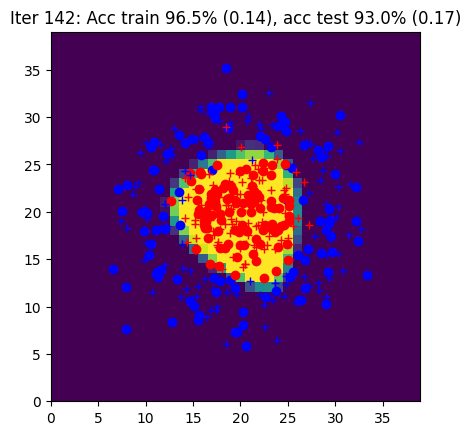

Iter 143: Acc train 97.0% (0.14), acc test 93.0% (0.17)


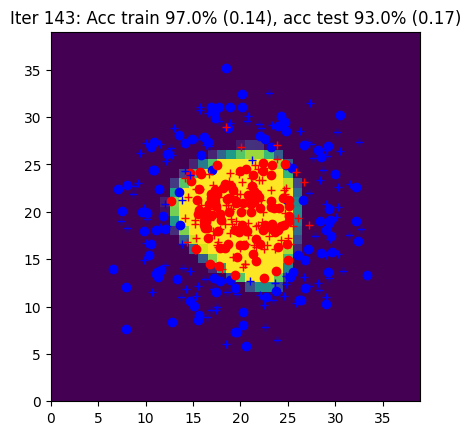

Iter 144: Acc train 97.0% (0.14), acc test 93.0% (0.17)


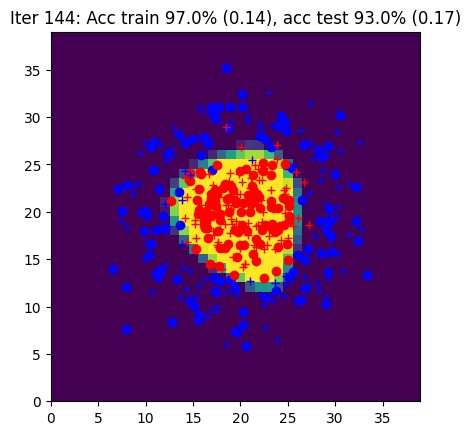

Iter 145: Acc train 96.5% (0.14), acc test 93.0% (0.17)


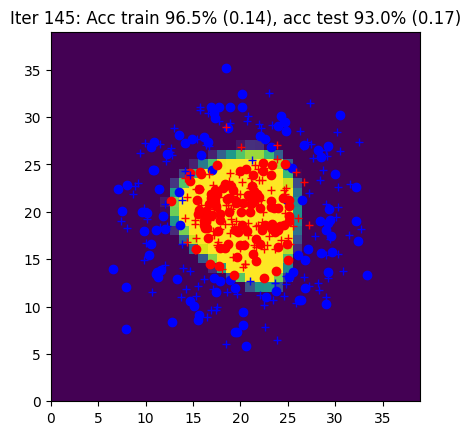

Iter 146: Acc train 97.0% (0.13), acc test 93.0% (0.16)


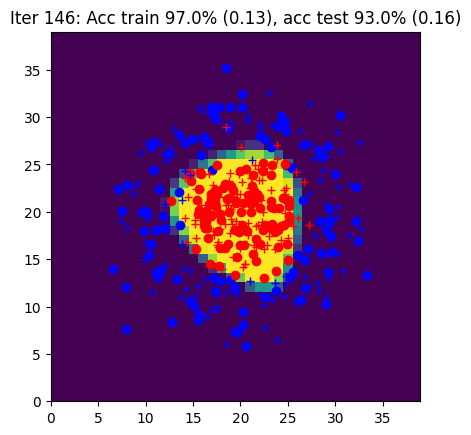

Iter 147: Acc train 96.5% (0.13), acc test 92.5% (0.17)


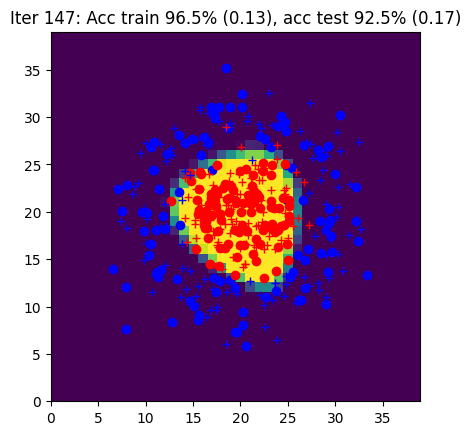

Iter 148: Acc train 96.5% (0.13), acc test 93.0% (0.17)


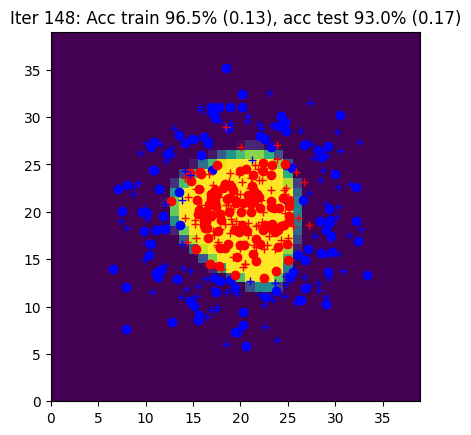

Iter 149: Acc train 96.5% (0.13), acc test 93.0% (0.17)


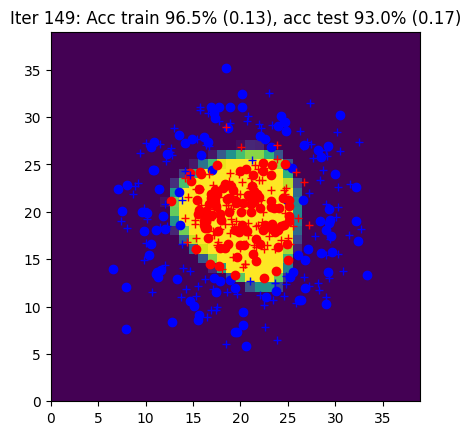

In [9]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

params = init_params(nx, nh, ny)

curves = [[], [], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code here  ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j + 1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # write the optimization algorithm on the batch (X,Y)
        # using the functions: forward, loss_accuracy, backward, sgd
        # forward propagation
        Yhat, outputs = forward(params, X)
        
        # calculate loss and accuracy
        L, acc = loss_accuracy(Yhat, Y)

        # backward propagation to compute gradients
        grads = backward(params, outputs, Y)

        # update parameters using SGD
        params = sgd(params, grads, eta)

    ####################
    ##      END        #
    ####################

    Yhat_train, _ = forward(params, data.Xtrain)
    Yhat_test, _ = forward(params, data.Xtest)
    Ltrain, acctrain = loss_accuracy(Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(Yhat_test, data.Ytest)
    Ygrid, _ = forward(params, data.Xgrid)

    title = "Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})".format(
        iteration, acctrain, Ltrain, acctest, Ltest
    )
    print(title)
    data.plot_data_with_grid(Ygrid, title)

    # Record the metrics
    curves[0].append(acctrain.item())
    curves[1].append(acctest.item())
    curves[2].append(Ltrain.item())
    curves[3].append(Ltest.item())

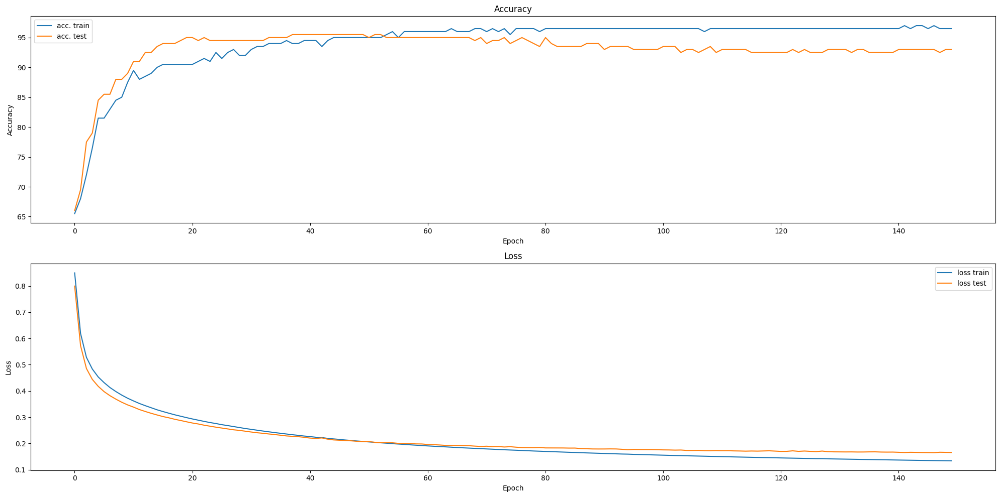

In [10]:
# Create subplots: 2 row, 1 columns
fig, axs = plt.subplots(2, 1, figsize=(20, 10))

# Plot accuracy curves on the first subplot
axs[0].plot(curves[0], label="acc. train")
axs[0].plot(curves[1], label="acc. test")
axs[0].set_title('Accuracy')
axs[0].set_xlabel('Epoch')
axs[0].set_ylabel('Accuracy')
axs[0].legend()

# Plot loss curves on the second subplot
axs[1].plot(curves[2], label="loss train")
axs[1].plot(curves[3], label="loss test")
axs[1].set_title('Loss')
axs[1].set_xlabel('Epoch')
axs[1].set_ylabel('Loss')
axs[1].legend()

# Show the plot
plt.tight_layout()
plt.show()

In [11]:
import os
import numpy as np
import matplotlib.pyplot as plt
import time
import csv

# Create directory if it doesn't exist
if not os.path.exists('hyperparameter_test'):
    os.makedirs('hyperparameter_test')

data = CirclesData()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]

# Set consistent axis limits
xlim = [0, 150]
ylim_acc = [0, 100]
ylim_loss = [0, 1]  # Adjust this value based on your loss range

batch_sizes = [1, 10, 50, 100, N]
learning_rates = [0.01, 0.05, 0.1, 0.5, 1, 5]

# Create or open CSV file to store results
csv_filename = 'hyperparameter_test/results.csv'
csv_file_exists = os.path.exists(csv_filename)

with open(csv_filename, mode='a', newline='') as csvfile:
    csvwriter = csv.writer(csvfile)

    # Write header only if the file is new
    if not csv_file_exists:
        csvwriter.writerow(['Batch Size', 'Learning Rate', 'Final Train Acc', 'Final Test Acc', 'Final Train Loss', 'Final Test Loss', 'Time Taken'])

    for Nbatch in batch_sizes:
        for eta in learning_rates:
            # Re-initialize parameters for each experiment
            params = init_params(nx, nh, ny)
            
            # Reset curves
            curves = [[], [], [], []]
            
            # Measure time taken for training
            start_time = time.time()
            
            # Training loop
            for iteration in range(150):
                # Permute data
                perm = np.random.permutation(N)
                Xtrain = data.Xtrain[perm, :]
                Ytrain = data.Ytrain[perm, :]
                
                for j in range(N // Nbatch):
                    indsBatch = range(j * Nbatch, (j + 1) * Nbatch)
                    X = Xtrain[indsBatch, :]
                    Y = Ytrain[indsBatch, :]
                    
                    # Forward pass
                    Yhat, outputs = forward(params, X)
                    
                    # Compute loss and accuracy
                    L, acc = loss_accuracy(Yhat, Y)
                    
                    # Backward pass
                    grads = backward(params, outputs, Y)
                    
                    # Update parameters
                    params = sgd(params, grads, eta)
                
                # Record metrics as before
                Yhat_train, _ = forward(params, data.Xtrain)
                Yhat_test, _ = forward(params, data.Xtest)
                Ltrain, acctrain = loss_accuracy(Yhat_train, data.Ytrain)
                Ltest, acctest = loss_accuracy(Yhat_test, data.Ytest)
                
                curves[0].append(acctrain.item())
                curves[1].append(acctest.item())
                curves[2].append(Ltrain.item())
                curves[3].append(Ltest.item())
            
            # Time taken for 150 iterations
            elapsed_time = time.time() - start_time
            
            # Plot the metrics for this experiment
            plt.figure(figsize=(15, 10))
            plt.suptitle(f'Batch Size: {Nbatch}, Learning Rate: {eta} - Time: {elapsed_time:.2f} seconds')
            
            # Accuracy plot
            plt.subplot(2, 1, 1)
            final_acctrain = curves[0][-1]
            final_acctest = curves[1][-1]
            plt.plot(curves[0], label=f'Training Accuracy ({final_acctrain:.2f}%)')
            plt.plot(curves[1], label=f'Testing Accuracy ({final_acctest:.2f}%)')
            plt.xlabel('Epoch')
            plt.ylabel('Accuracy (%)')
            plt.title('Accuracy over Epochs')
            plt.legend()
            plt.grid(True)
            plt.xlim(xlim)
            plt.ylim(ylim_acc)
            
            # Loss plot
            plt.subplot(2, 1, 2)
            final_Ltrain = curves[2][-1]
            final_Ltest = curves[3][-1]
            plt.plot(curves[2], label=f'Training Loss ({final_Ltrain:.4f})')
            plt.plot(curves[3], label=f'Testing Loss ({final_Ltest:.4f})')
            plt.xlabel('Epoch')
            plt.ylabel('Loss')
            plt.title('Loss over Epochs')
            plt.legend()
            plt.grid(True)
            plt.xlim(xlim)
            plt.ylim(ylim_loss)
            
            plt.tight_layout(rect=[0, 0.03, 1, 0.95])
            
            # Save the figure
            filename = f'hyperparameter_test/BatchSize_{Nbatch}_LR_{eta}.png'
            plt.savefig(filename)
            plt.close()
            
            # Write the final results to the CSV
            csvwriter.writerow([Nbatch, eta, final_acctrain, final_acctest, final_Ltrain, final_Ltest, elapsed_time])


# Part 2 : Simplification of the backward pass with `torch.autograd`



In [12]:
def init_params(nx, nh, ny):
    """
    nx, nh, ny: integers
    out params: dictionnary
    """
    params = {}

    #####################
    ## Your code here  ##
    #####################
    # fill values for Wh, Wy, bh, by
    # activaye autograd on the network weights

    params["Wh"] = torch.randn(nh, nx) / math.sqrt(0.3)
    params["Wy"] = torch.randn(ny, nh) / math.sqrt(0.3)
    params["bh"] = torch.randn(1, nh) / math.sqrt(0.3)
    params["by"] = torch.randn(1, ny) / math.sqrt(0.3)
    params["Wh"] = Variable(params["Wh"], requires_grad=True)
    params["Wy"] = Variable(params["Wy"], requires_grad=True)   
    params["bh"] = Variable(params["bh"], requires_grad=True)   
    params["by"] = Variable(params["by"], requires_grad=True)

    ####################
    ##      END        #
    ####################
    return params

The function `forward` remains unchanged from previous part.

The function `backward` is no longer used because of "autograd".

In [13]:
def sgd(params, eta):

    #####################
    ## Your code here  ##
    #####################
    # update the network weights
    # warning: use torch.no_grad()
    # and reset to zero the gradient accumulators

    with torch.no_grad():
        params["Wh"] -= eta * params["Wh"].grad
        params["Wy"] -= eta * params["Wy"].grad
        params["bh"] -= eta * params["bh"].grad
        params["by"] -= eta * params["by"].grad
        params["Wh"].grad.zero_()
        params["Wy"].grad.zero_()
        params["bh"].grad.zero_()
        params["by"].grad.zero_()
        
    ####################
    ##      END        #
    ####################
    return params

## Global learning procedure with autograd

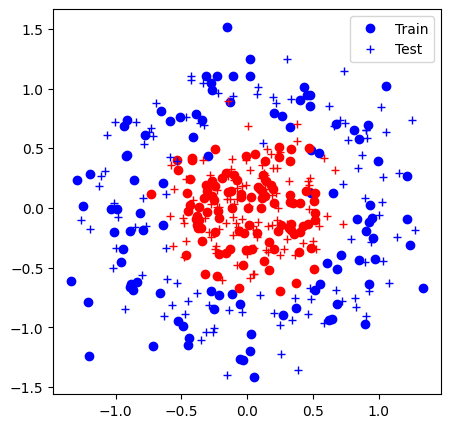

{'Wh': tensor([[-4.5818,  0.8910],
        [ 1.4325,  0.0523],
        [ 1.3258,  0.1664],
        [-0.7103,  0.9638],
        [ 1.8825, -1.2867],
        [ 1.8497, -0.6040],
        [ 1.9992,  0.6206],
        [ 1.3145,  0.7511],
        [-1.0467,  0.9254],
        [-0.8676, -0.8983]], requires_grad=True), 'Wy': tensor([[-0.2484,  2.9858,  1.1954,  1.0516,  1.9013, -0.7298, -4.1870,  0.9084,
         -0.7773, -2.4413],
        [-0.3530,  1.1916, -0.5592, -0.6028, -1.7907,  0.3555, -3.0189,  1.2441,
          2.6676, -0.5655]], requires_grad=True), 'bh': tensor([[ 3.8658, -3.1253,  0.3015,  2.8881,  0.8188,  0.0603,  2.6478, -1.2663,
          1.8197,  1.1193]], requires_grad=True), 'by': tensor([[ 1.4175, -0.5530]], requires_grad=True)}
Iter 0: Acc train 48.5% (1.18), acc test 47.5% (1.18)


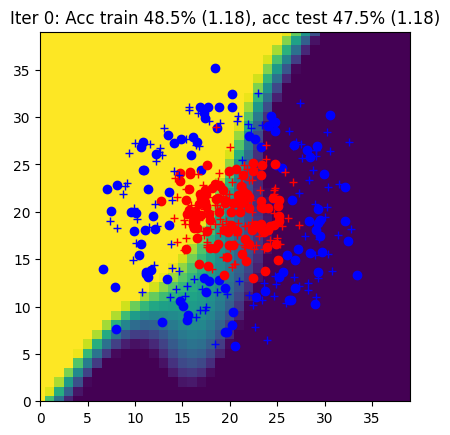

Iter 1: Acc train 55.0% (0.95), acc test 57.0% (0.96)


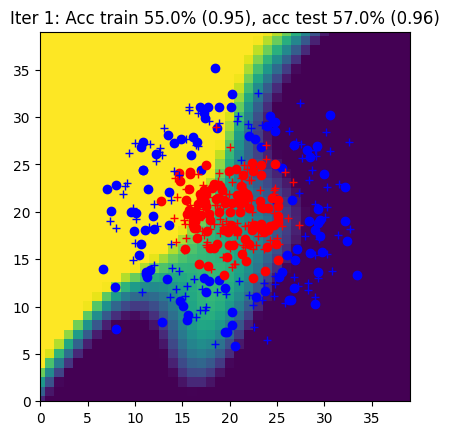

Iter 2: Acc train 69.0% (0.77), acc test 64.5% (0.80)


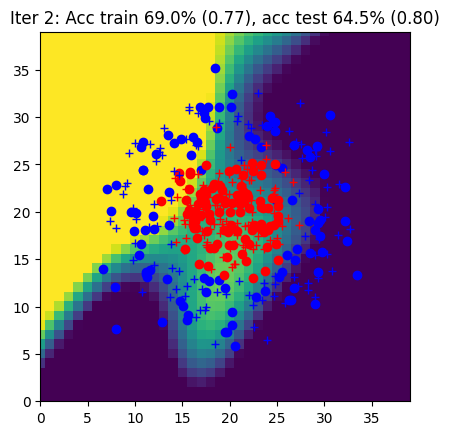

Iter 3: Acc train 76.0% (0.65), acc test 72.5% (0.68)


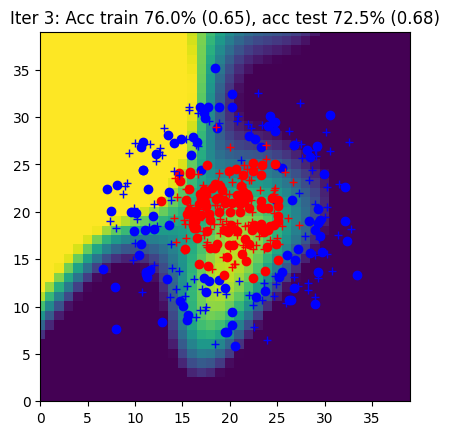

Iter 4: Acc train 84.0% (0.57), acc test 77.0% (0.59)


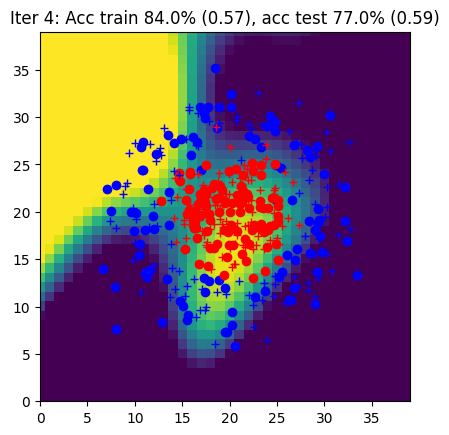

Iter 5: Acc train 87.0% (0.51), acc test 82.5% (0.53)


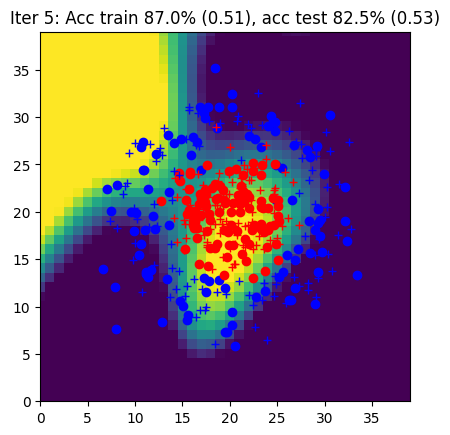

Iter 6: Acc train 87.0% (0.47), acc test 84.5% (0.48)


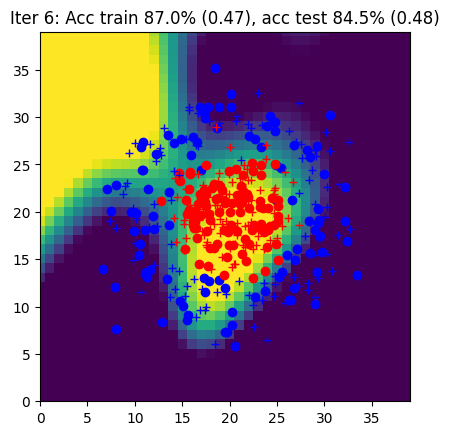

Iter 7: Acc train 90.0% (0.43), acc test 85.5% (0.44)


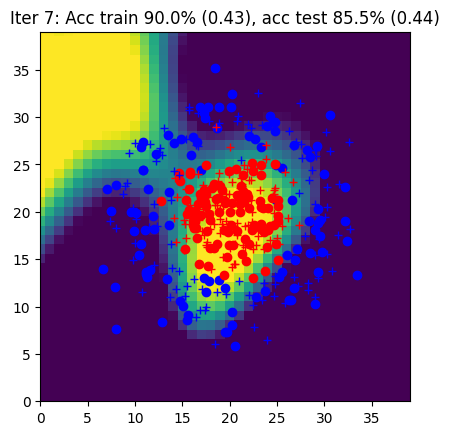

Iter 8: Acc train 92.0% (0.40), acc test 86.0% (0.42)


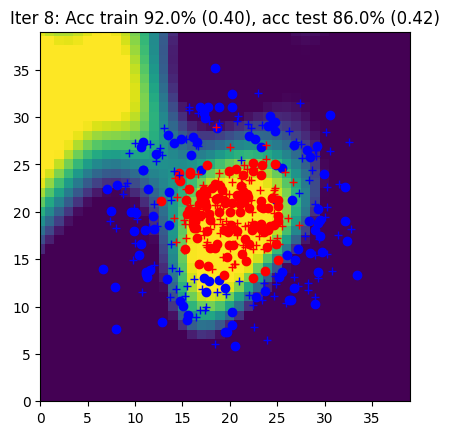

Iter 9: Acc train 93.0% (0.38), acc test 91.0% (0.39)


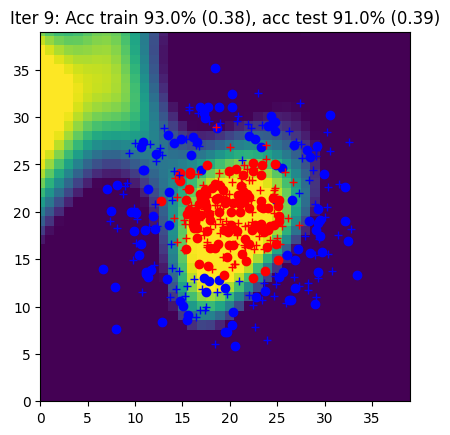

Iter 10: Acc train 93.0% (0.36), acc test 90.5% (0.37)


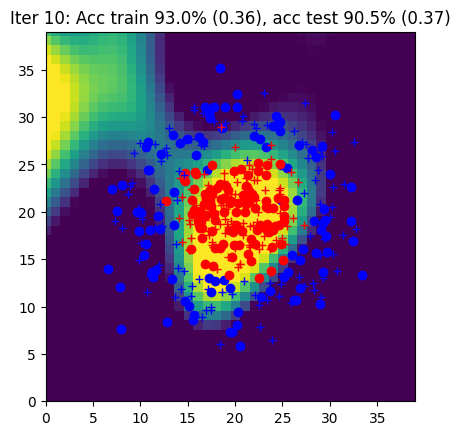

Iter 11: Acc train 93.0% (0.35), acc test 92.0% (0.36)


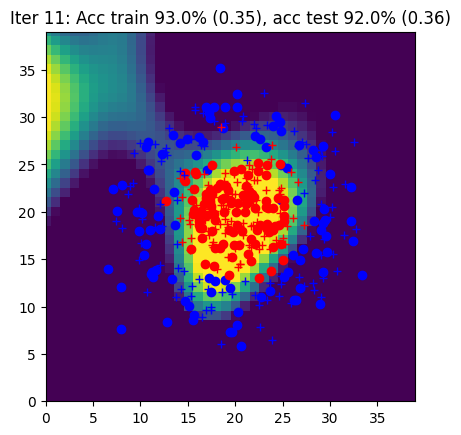

Iter 12: Acc train 93.0% (0.34), acc test 92.5% (0.34)


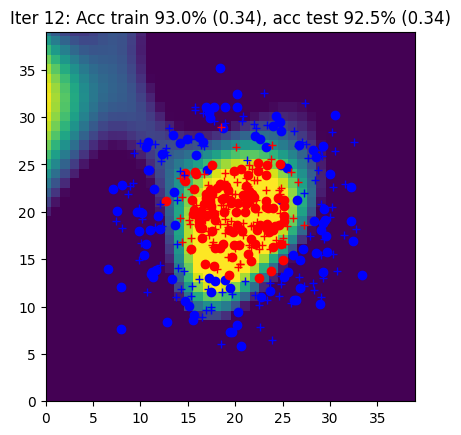

Iter 13: Acc train 92.5% (0.32), acc test 93.0% (0.33)


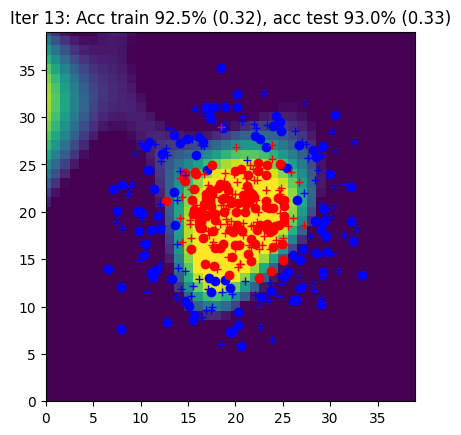

Iter 14: Acc train 92.5% (0.31), acc test 92.5% (0.32)


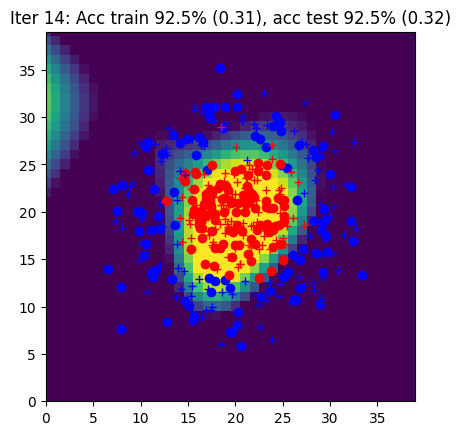

Iter 15: Acc train 93.0% (0.31), acc test 92.5% (0.31)


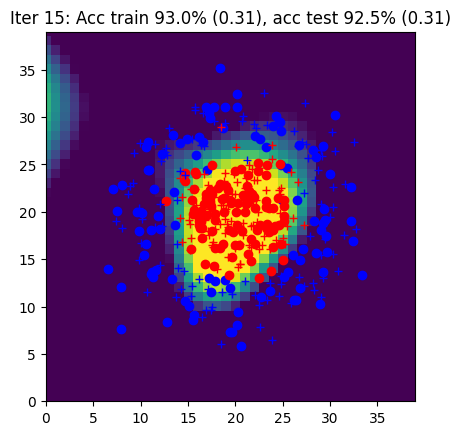

Iter 16: Acc train 92.5% (0.30), acc test 94.5% (0.30)


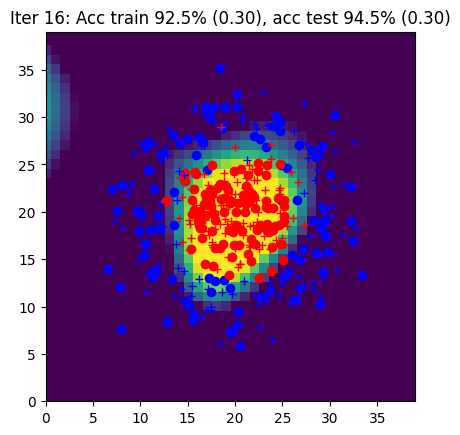

Iter 17: Acc train 92.5% (0.29), acc test 93.0% (0.29)


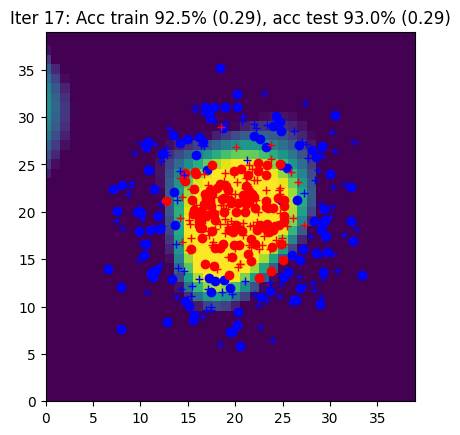

Iter 18: Acc train 93.0% (0.28), acc test 93.5% (0.29)


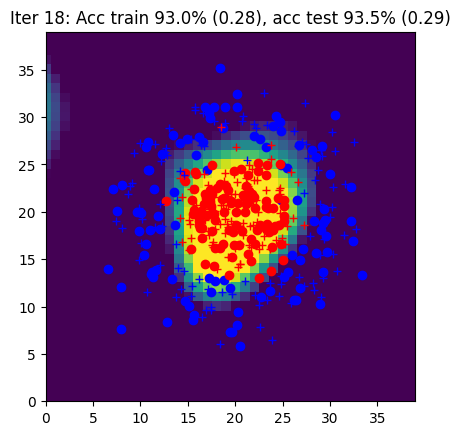

Iter 19: Acc train 93.0% (0.28), acc test 94.0% (0.28)


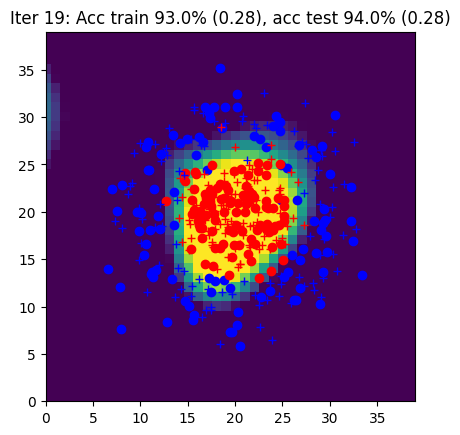

Iter 20: Acc train 93.0% (0.27), acc test 93.5% (0.28)


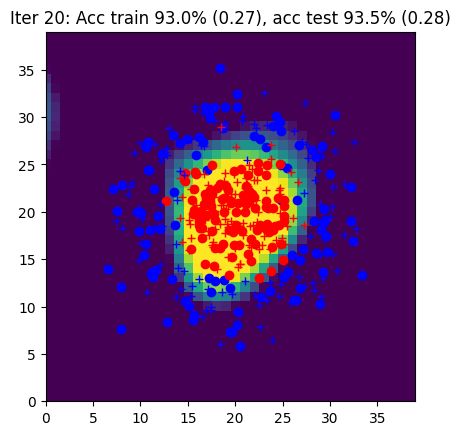

Iter 21: Acc train 91.5% (0.27), acc test 93.0% (0.27)


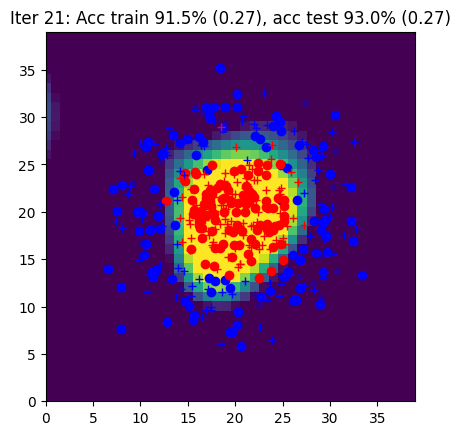

Iter 22: Acc train 93.0% (0.26), acc test 95.0% (0.27)


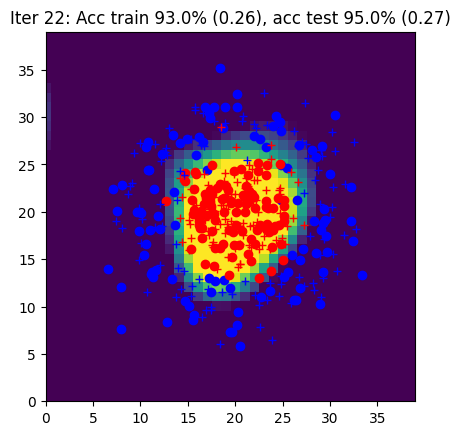

Iter 23: Acc train 93.5% (0.26), acc test 94.5% (0.26)


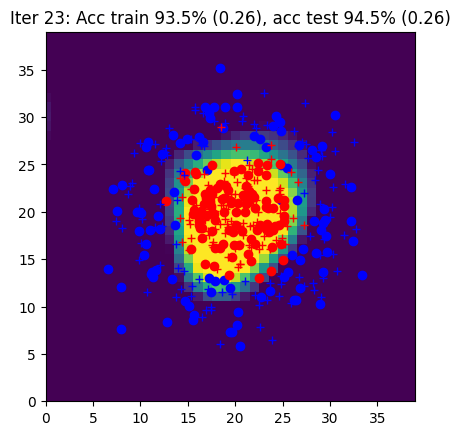

Iter 24: Acc train 93.5% (0.25), acc test 95.0% (0.26)


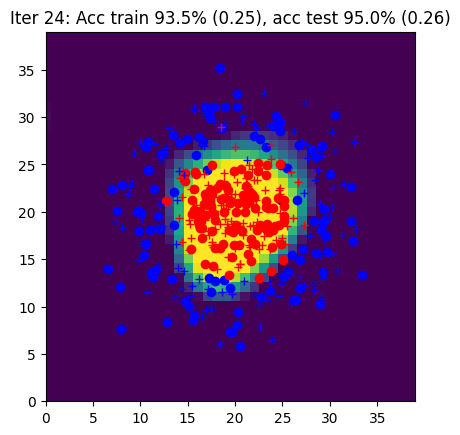

Iter 25: Acc train 93.5% (0.25), acc test 95.0% (0.25)


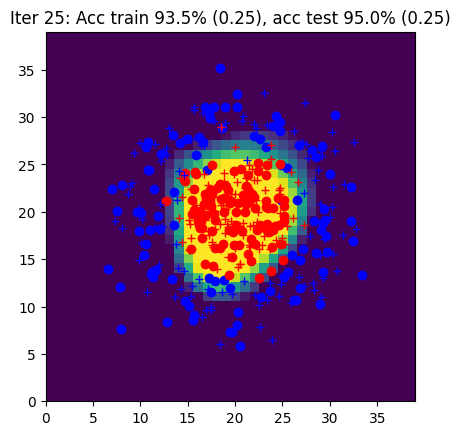

Iter 26: Acc train 93.5% (0.24), acc test 95.0% (0.25)


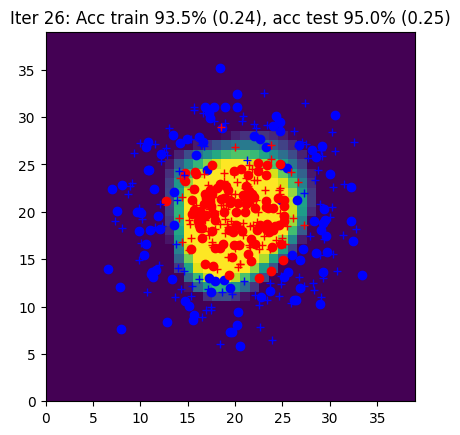

Iter 27: Acc train 93.5% (0.24), acc test 95.0% (0.24)


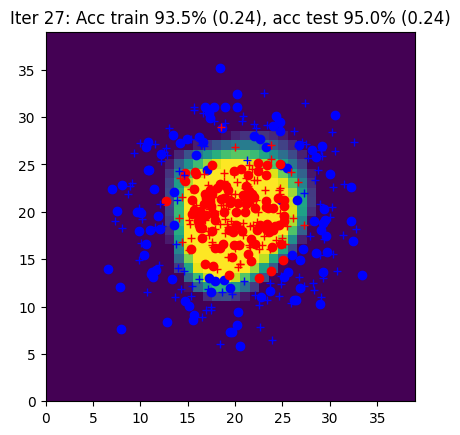

Iter 28: Acc train 93.5% (0.24), acc test 95.0% (0.24)


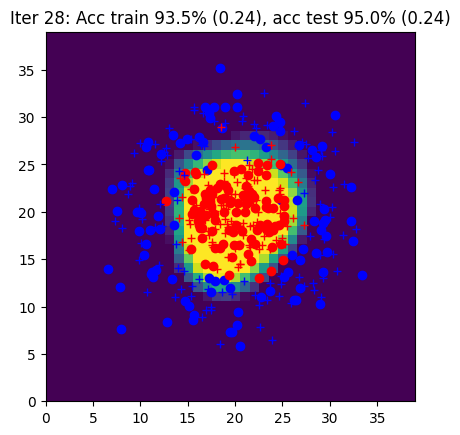

Iter 29: Acc train 94.5% (0.23), acc test 94.5% (0.24)


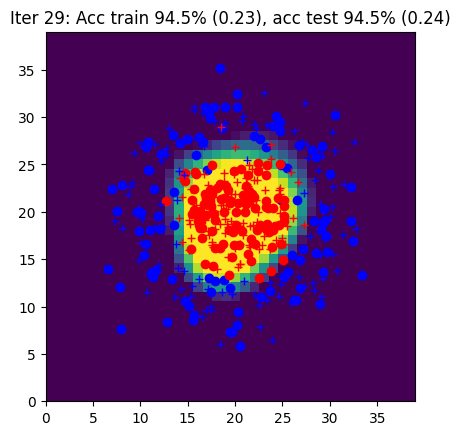

Iter 30: Acc train 94.0% (0.23), acc test 93.5% (0.23)


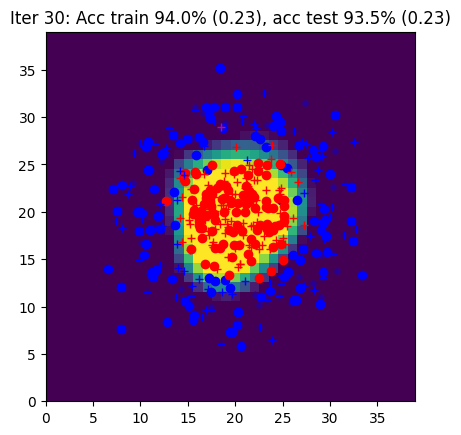

Iter 31: Acc train 94.5% (0.23), acc test 94.5% (0.23)


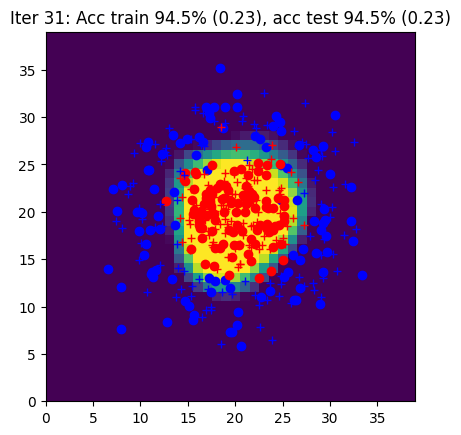

Iter 32: Acc train 94.5% (0.22), acc test 94.5% (0.23)


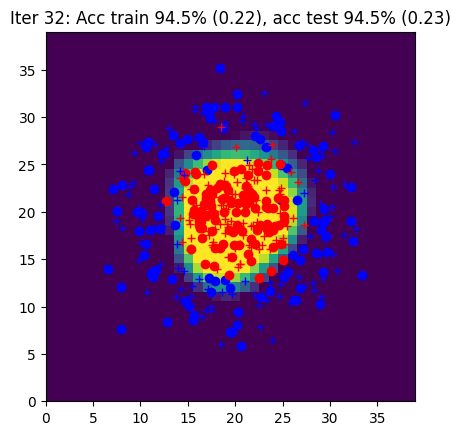

Iter 33: Acc train 94.5% (0.22), acc test 94.5% (0.23)


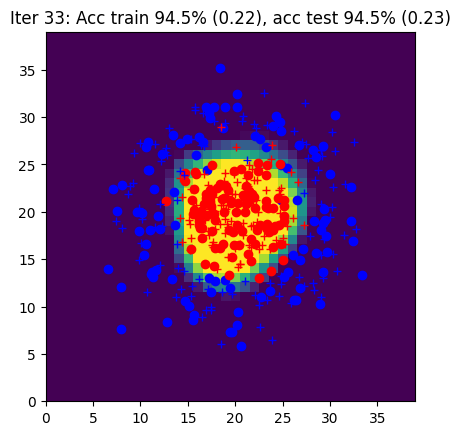

Iter 34: Acc train 94.5% (0.22), acc test 94.0% (0.22)


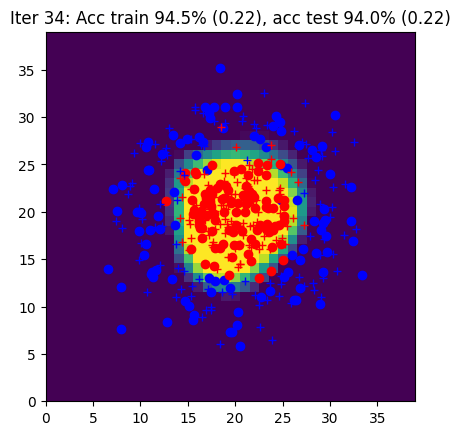

Iter 35: Acc train 94.5% (0.22), acc test 94.5% (0.22)


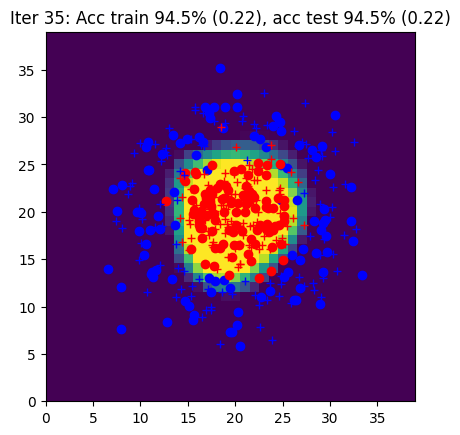

Iter 36: Acc train 94.5% (0.21), acc test 94.5% (0.22)


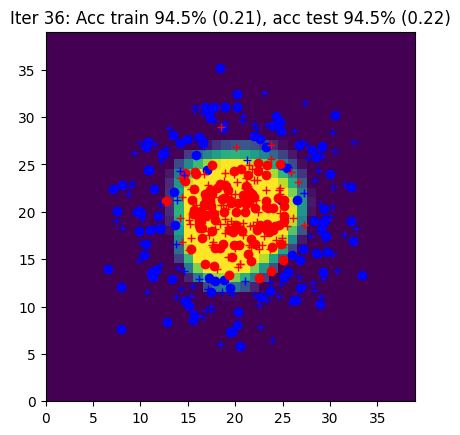

Iter 37: Acc train 94.0% (0.21), acc test 94.5% (0.22)


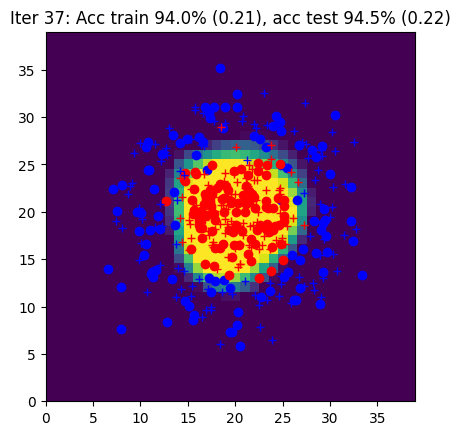

Iter 38: Acc train 94.0% (0.21), acc test 94.5% (0.21)


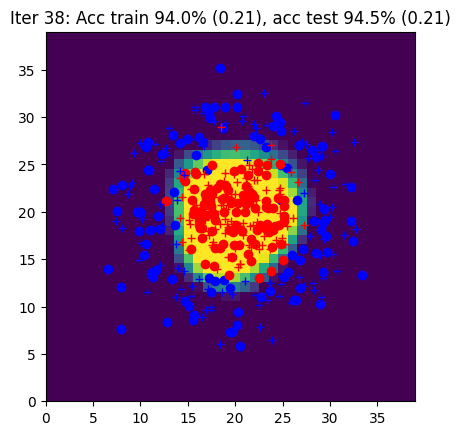

Iter 39: Acc train 94.5% (0.21), acc test 94.5% (0.21)


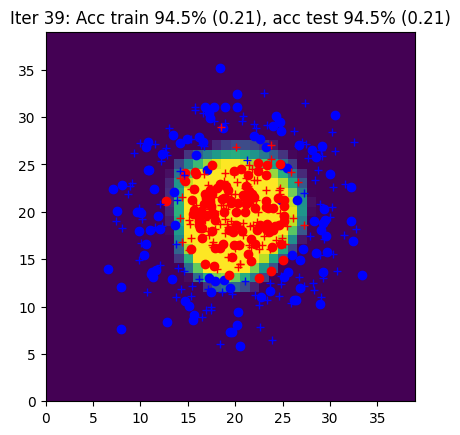

Iter 40: Acc train 94.5% (0.21), acc test 94.5% (0.21)


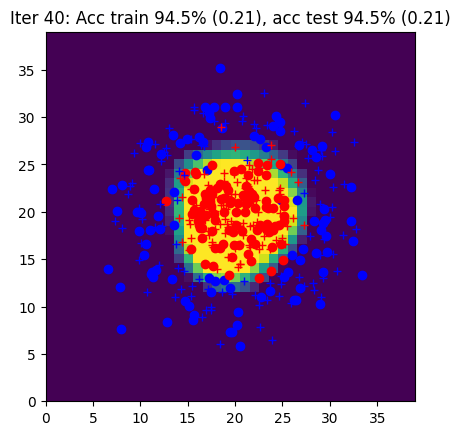

Iter 41: Acc train 94.5% (0.20), acc test 94.5% (0.21)


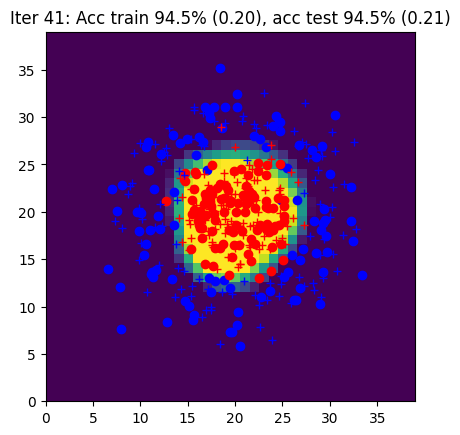

Iter 42: Acc train 94.5% (0.20), acc test 94.5% (0.21)


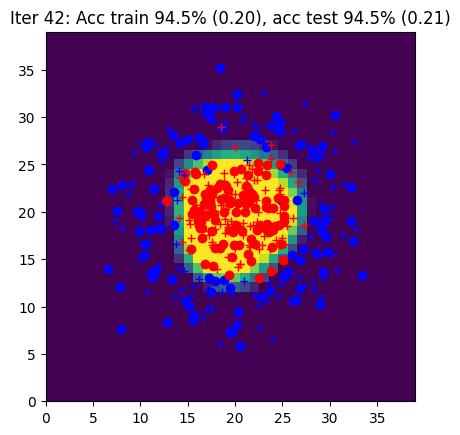

Iter 43: Acc train 94.5% (0.20), acc test 94.5% (0.21)


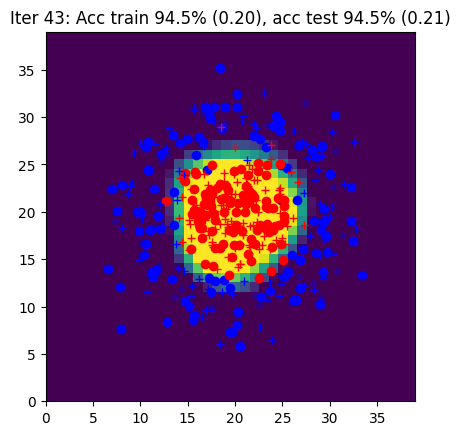

Iter 44: Acc train 94.5% (0.20), acc test 94.5% (0.20)


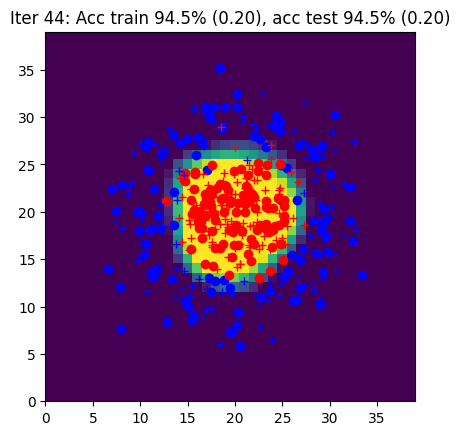

Iter 45: Acc train 94.5% (0.20), acc test 94.5% (0.20)


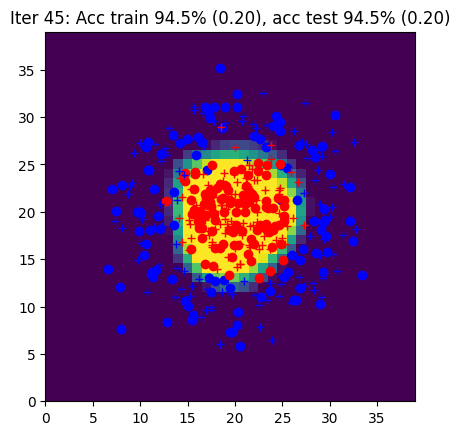

Iter 46: Acc train 94.5% (0.20), acc test 94.5% (0.20)


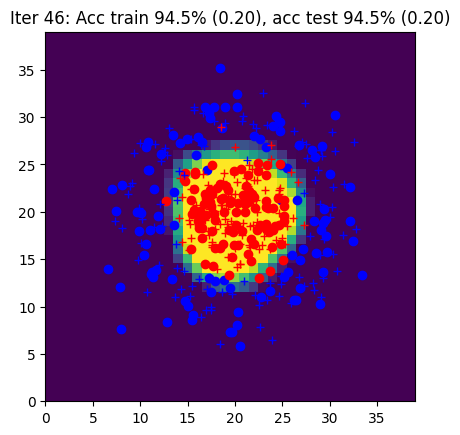

Iter 47: Acc train 95.0% (0.19), acc test 95.0% (0.20)


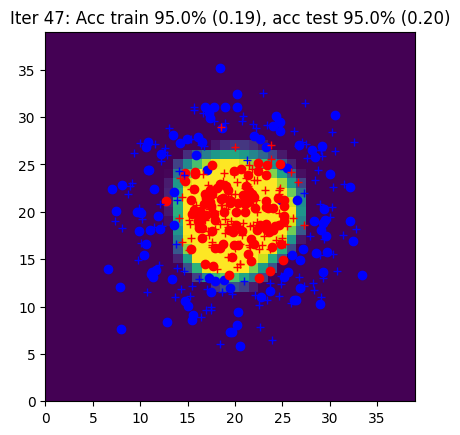

Iter 48: Acc train 94.5% (0.19), acc test 94.5% (0.20)


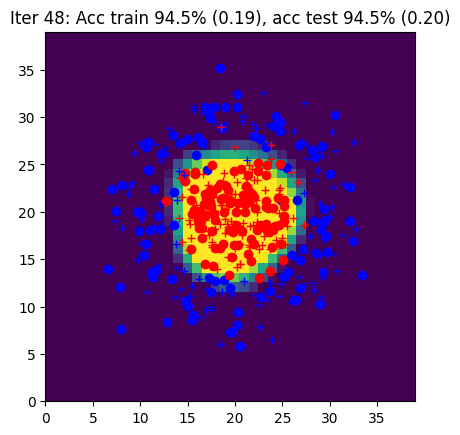

Iter 49: Acc train 94.5% (0.19), acc test 94.5% (0.20)


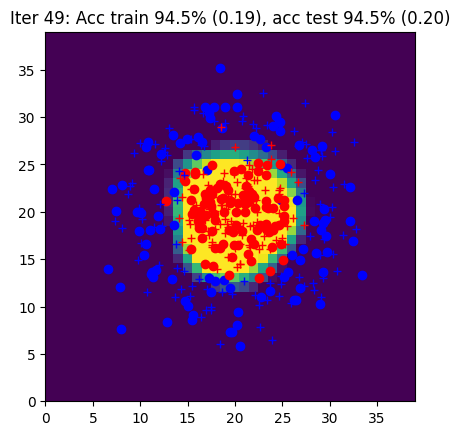

Iter 50: Acc train 94.5% (0.19), acc test 94.5% (0.20)


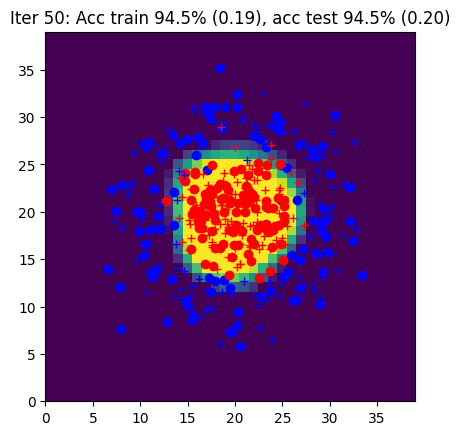

Iter 51: Acc train 95.0% (0.19), acc test 94.5% (0.20)


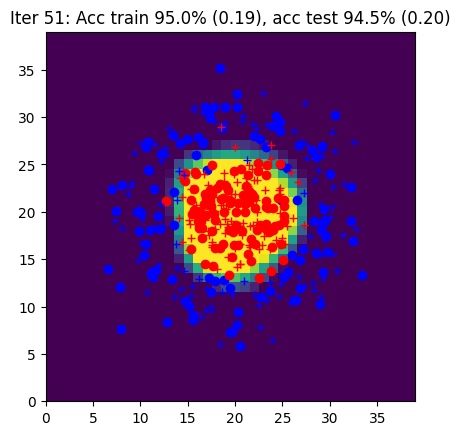

Iter 52: Acc train 95.5% (0.19), acc test 95.0% (0.20)


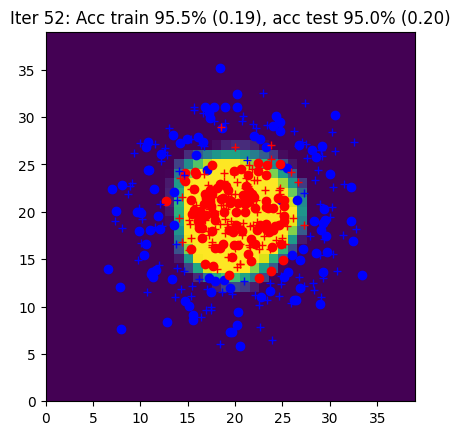

Iter 53: Acc train 95.5% (0.19), acc test 95.0% (0.19)


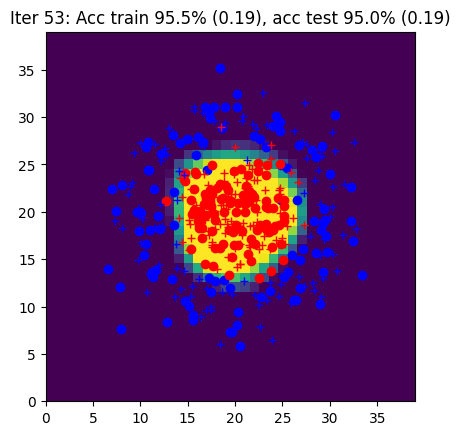

Iter 54: Acc train 95.0% (0.19), acc test 94.5% (0.19)


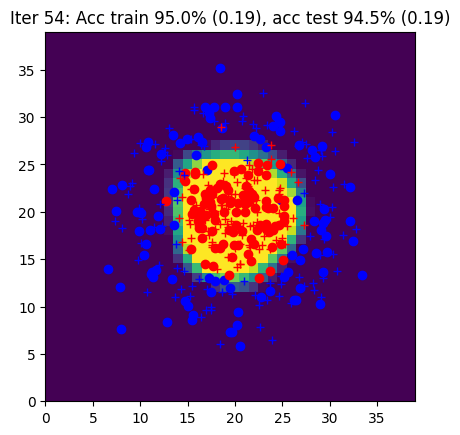

Iter 55: Acc train 95.5% (0.18), acc test 95.0% (0.19)


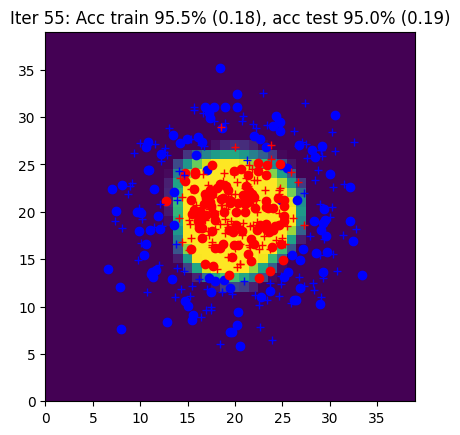

Iter 56: Acc train 95.5% (0.18), acc test 94.5% (0.19)


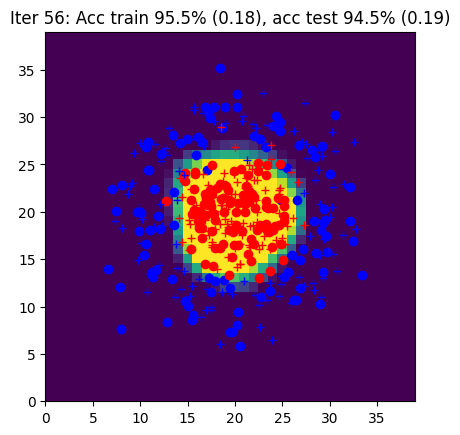

Iter 57: Acc train 95.5% (0.18), acc test 94.5% (0.19)


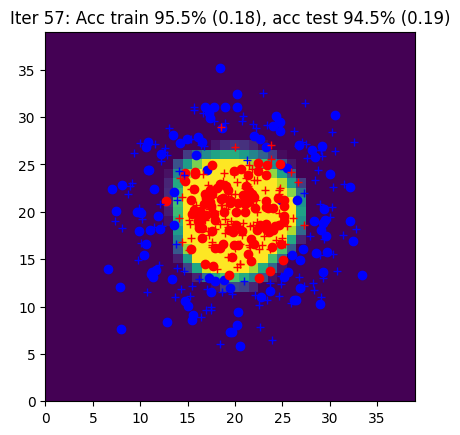

Iter 58: Acc train 95.5% (0.18), acc test 95.0% (0.19)


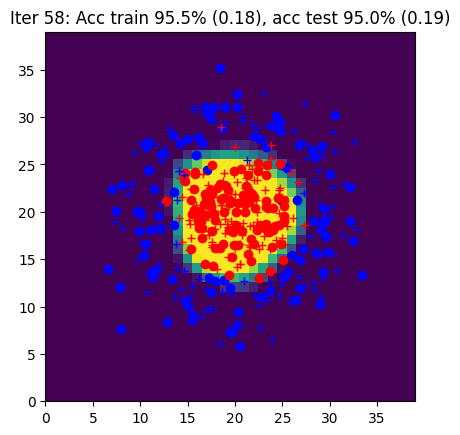

Iter 59: Acc train 95.5% (0.18), acc test 95.0% (0.19)


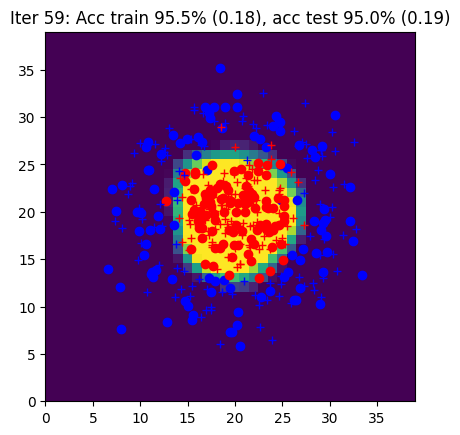

Iter 60: Acc train 95.5% (0.18), acc test 94.5% (0.19)


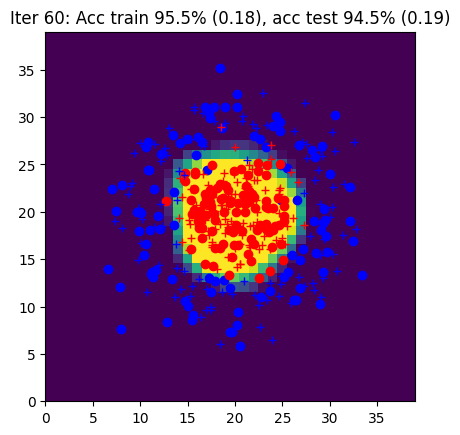

Iter 61: Acc train 95.5% (0.18), acc test 94.5% (0.19)


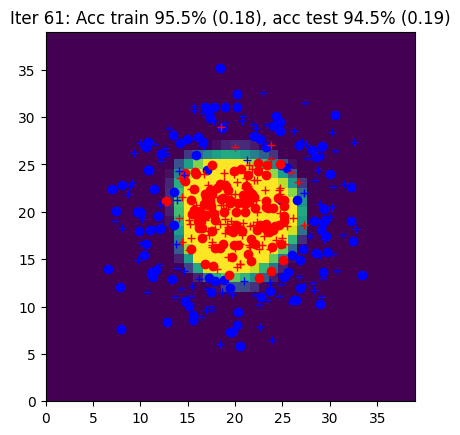

Iter 62: Acc train 95.5% (0.18), acc test 94.5% (0.18)


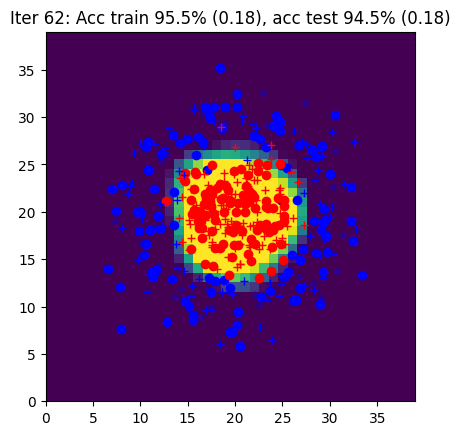

Iter 63: Acc train 95.5% (0.18), acc test 94.5% (0.18)


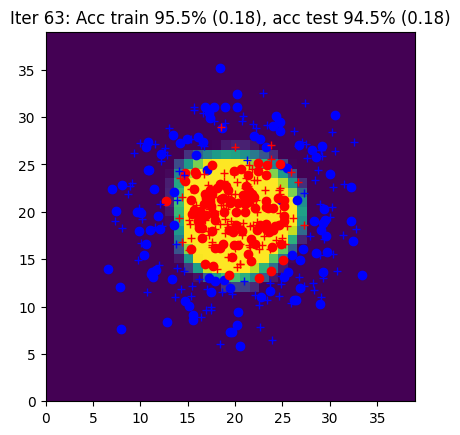

Iter 64: Acc train 95.5% (0.17), acc test 94.5% (0.18)


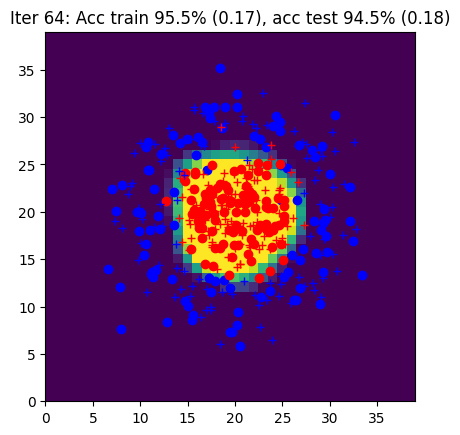

Iter 65: Acc train 95.5% (0.17), acc test 94.5% (0.18)


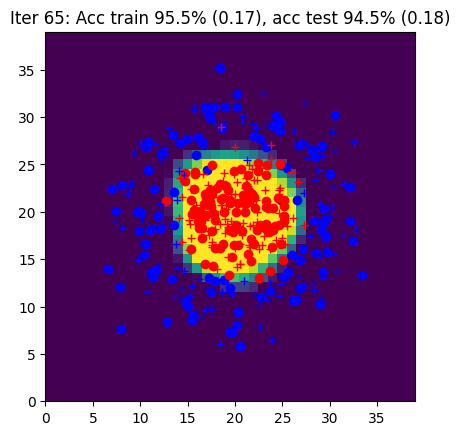

Iter 66: Acc train 96.0% (0.17), acc test 95.0% (0.18)


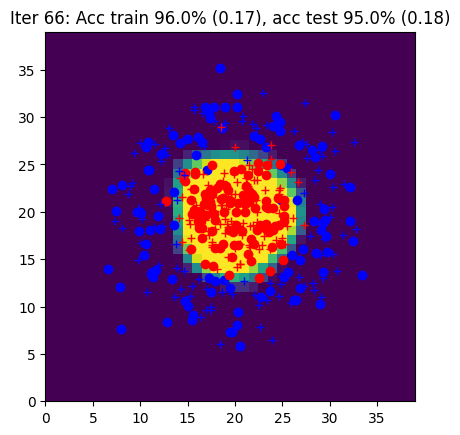

Iter 67: Acc train 95.5% (0.17), acc test 95.0% (0.18)


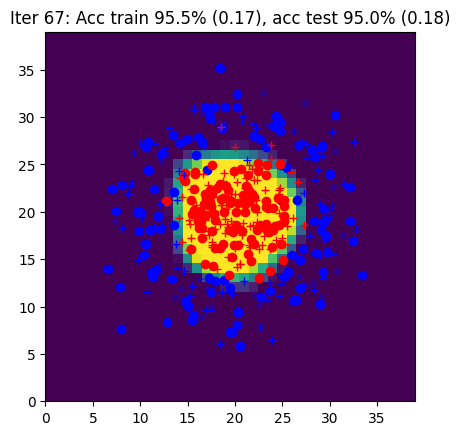

Iter 68: Acc train 96.0% (0.17), acc test 95.0% (0.18)


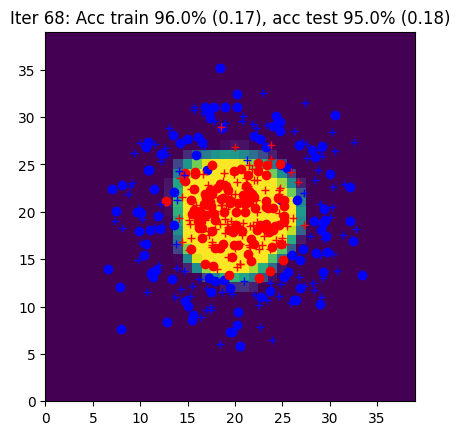

Iter 69: Acc train 96.0% (0.17), acc test 95.0% (0.18)


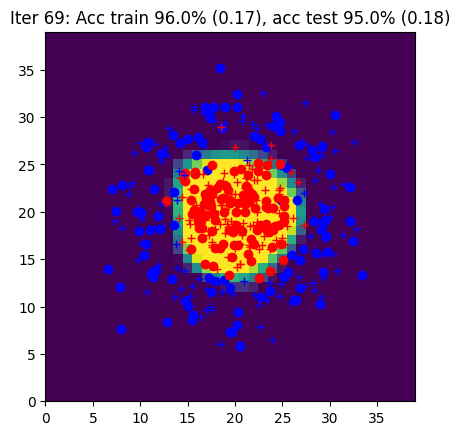

Iter 70: Acc train 95.5% (0.17), acc test 94.5% (0.18)


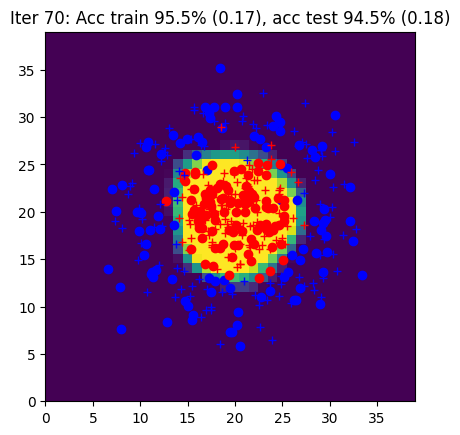

Iter 71: Acc train 95.5% (0.17), acc test 94.5% (0.18)


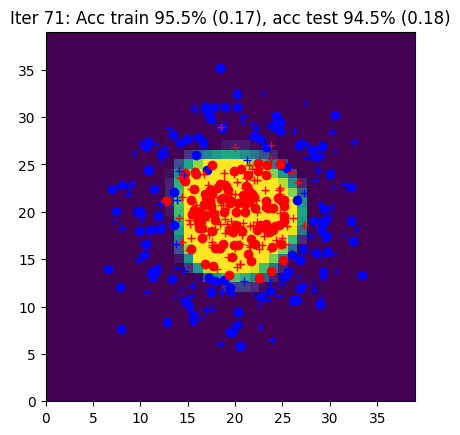

Iter 72: Acc train 95.5% (0.17), acc test 94.5% (0.18)


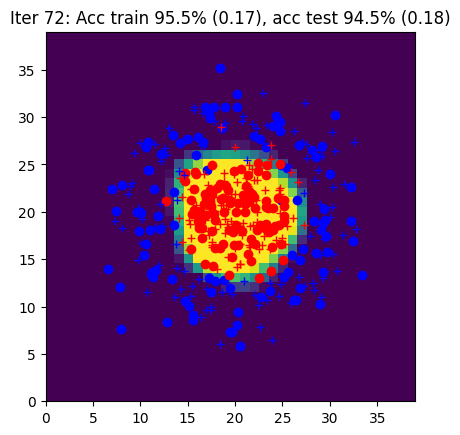

Iter 73: Acc train 95.5% (0.17), acc test 94.5% (0.18)


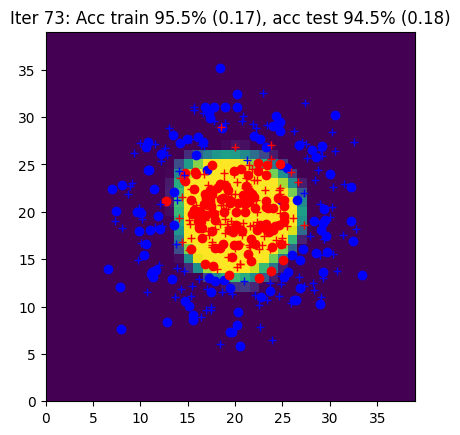

Iter 74: Acc train 96.0% (0.17), acc test 95.0% (0.18)


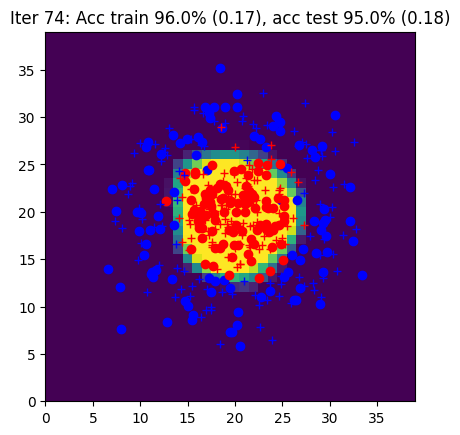

Iter 75: Acc train 96.0% (0.17), acc test 95.0% (0.18)


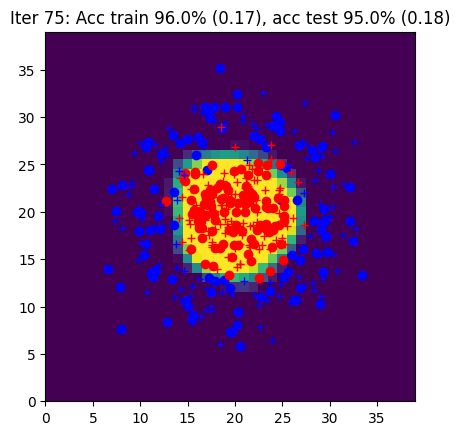

Iter 76: Acc train 95.5% (0.16), acc test 94.0% (0.18)


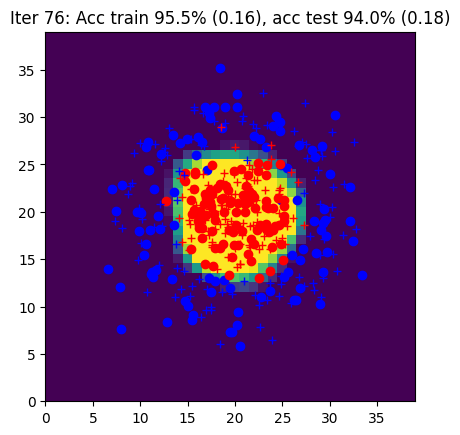

Iter 77: Acc train 95.5% (0.16), acc test 94.5% (0.18)


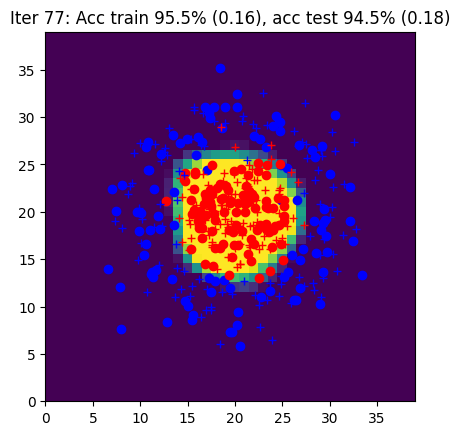

Iter 78: Acc train 96.0% (0.16), acc test 94.5% (0.18)


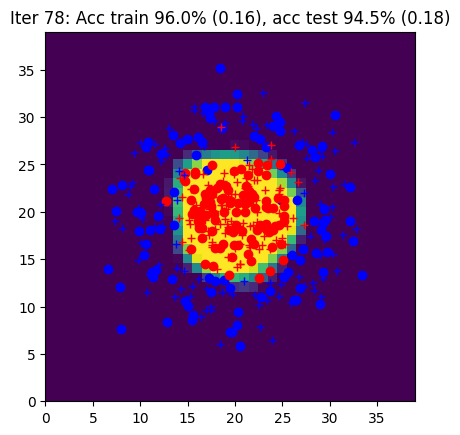

Iter 79: Acc train 96.0% (0.16), acc test 95.0% (0.18)


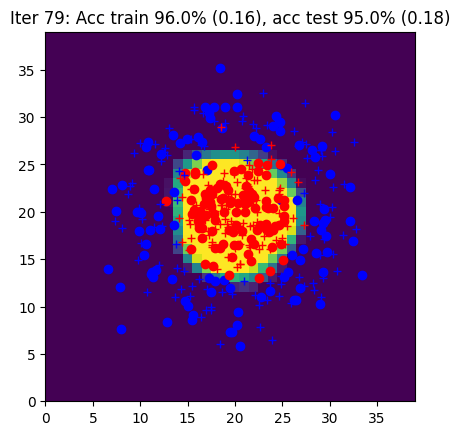

Iter 80: Acc train 96.0% (0.16), acc test 95.0% (0.17)


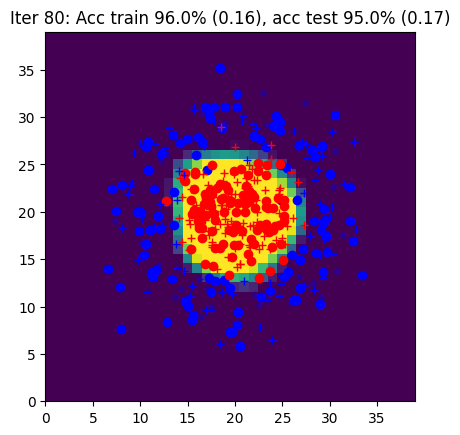

Iter 81: Acc train 96.0% (0.16), acc test 94.5% (0.17)


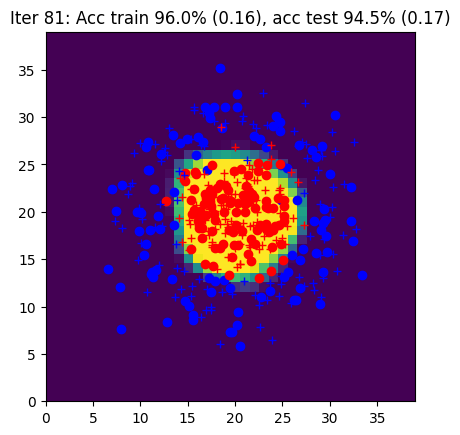

Iter 82: Acc train 96.0% (0.16), acc test 94.5% (0.17)


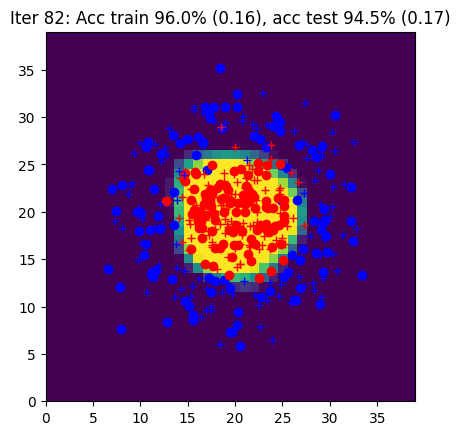

Iter 83: Acc train 96.0% (0.16), acc test 94.5% (0.17)


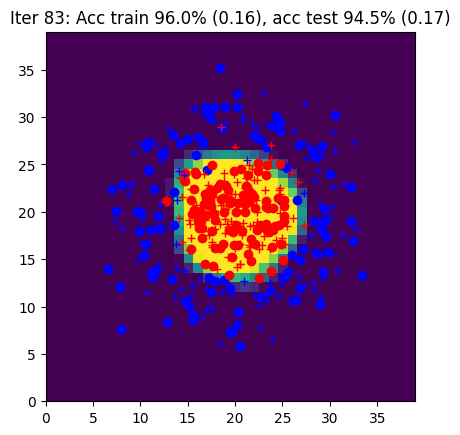

Iter 84: Acc train 96.0% (0.16), acc test 94.0% (0.17)


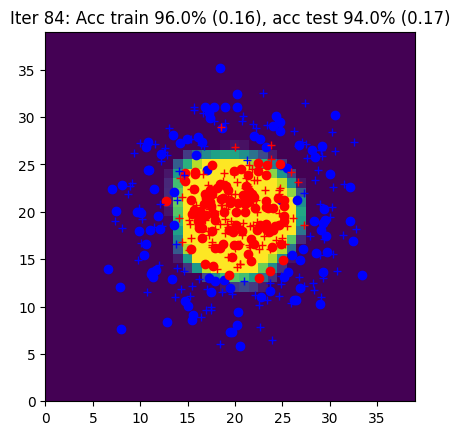

Iter 85: Acc train 96.0% (0.16), acc test 95.0% (0.17)


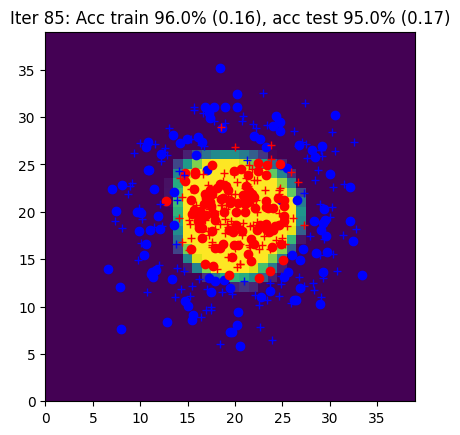

Iter 86: Acc train 96.0% (0.16), acc test 94.5% (0.17)


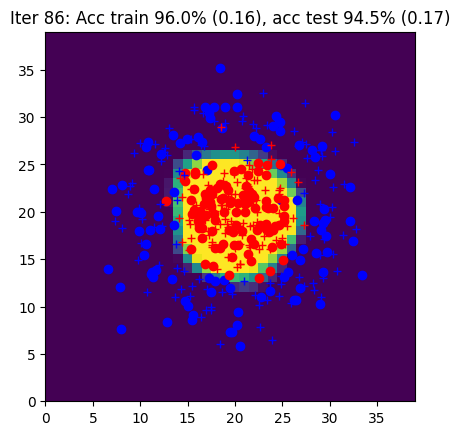

Iter 87: Acc train 95.5% (0.16), acc test 94.0% (0.17)


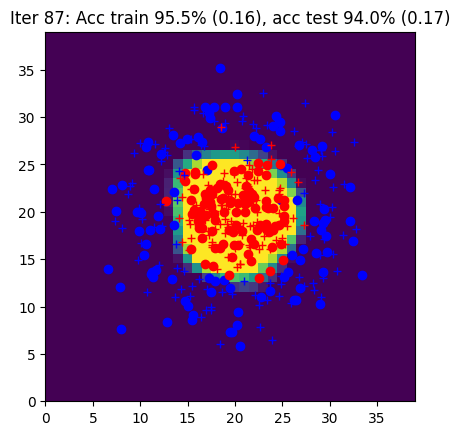

Iter 88: Acc train 96.0% (0.16), acc test 94.0% (0.17)


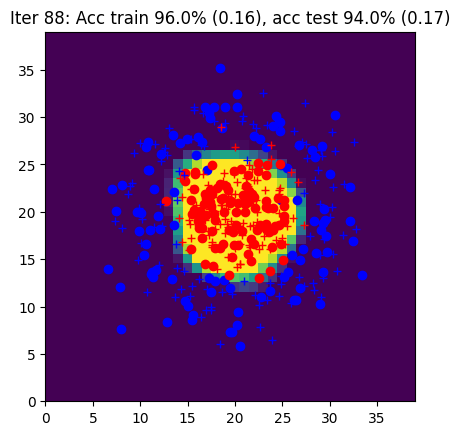

Iter 89: Acc train 96.0% (0.16), acc test 94.5% (0.17)


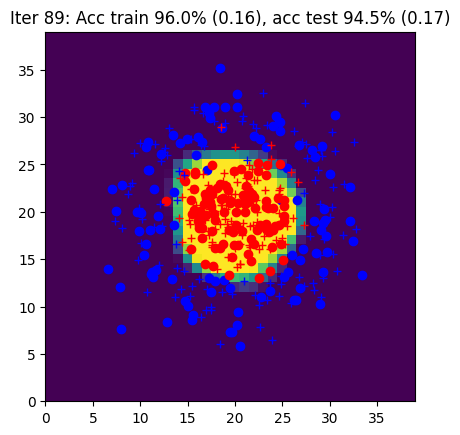

Iter 90: Acc train 95.5% (0.16), acc test 95.0% (0.17)


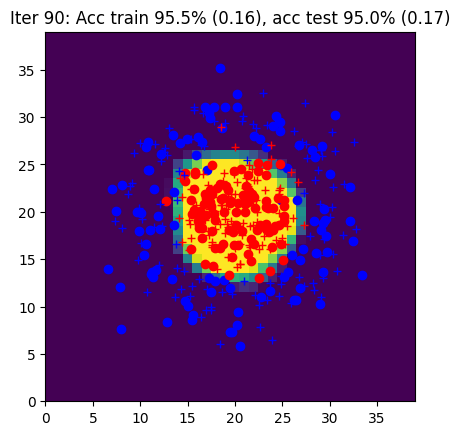

Iter 91: Acc train 96.0% (0.16), acc test 94.5% (0.17)


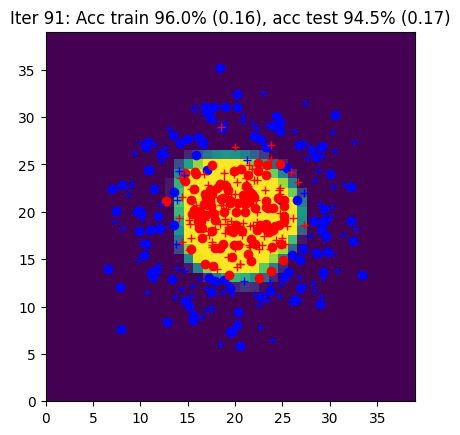

Iter 92: Acc train 96.5% (0.15), acc test 94.0% (0.17)


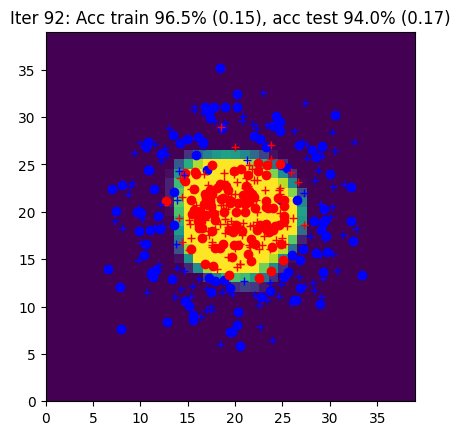

Iter 93: Acc train 96.0% (0.15), acc test 94.5% (0.17)


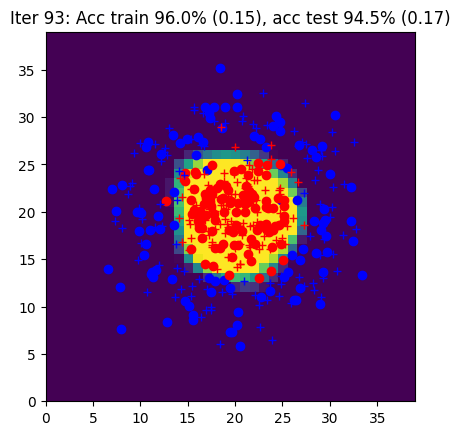

Iter 94: Acc train 96.0% (0.15), acc test 94.0% (0.17)


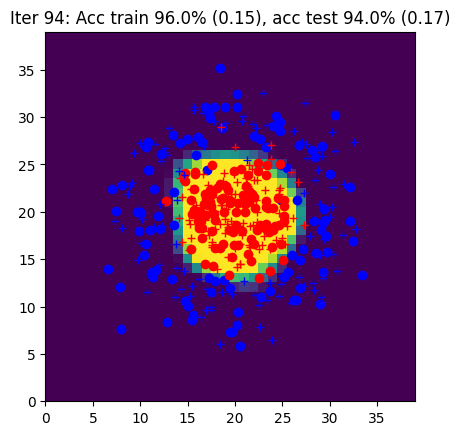

Iter 95: Acc train 95.5% (0.15), acc test 95.0% (0.17)


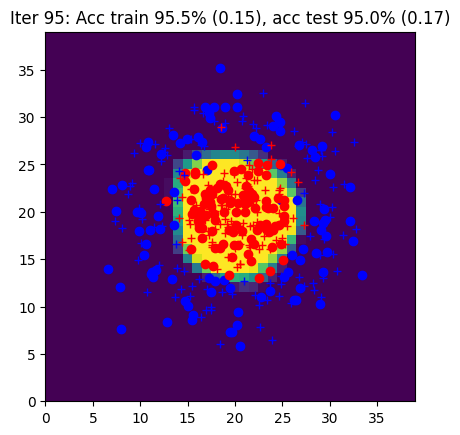

Iter 96: Acc train 96.0% (0.15), acc test 94.0% (0.17)


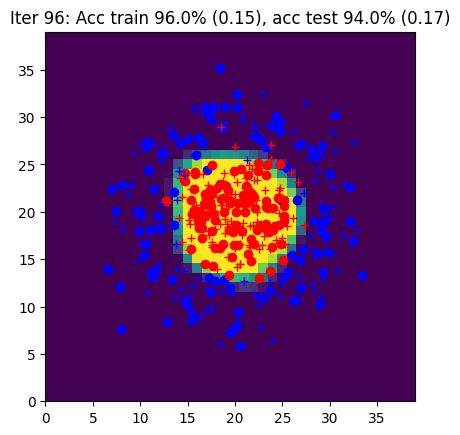

Iter 97: Acc train 96.0% (0.15), acc test 94.0% (0.17)


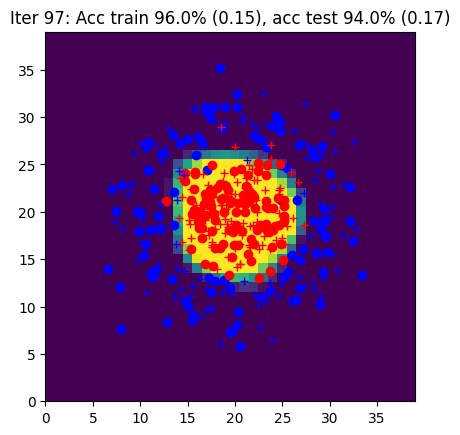

Iter 98: Acc train 96.5% (0.15), acc test 94.0% (0.17)


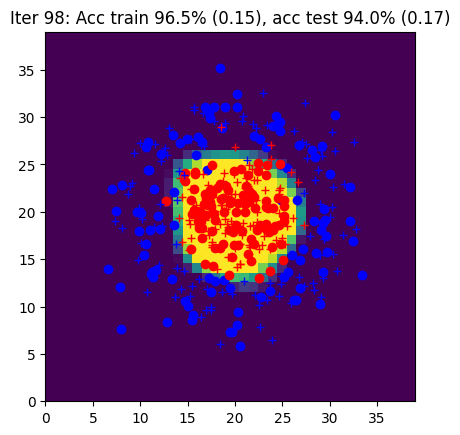

Iter 99: Acc train 96.5% (0.15), acc test 94.0% (0.17)


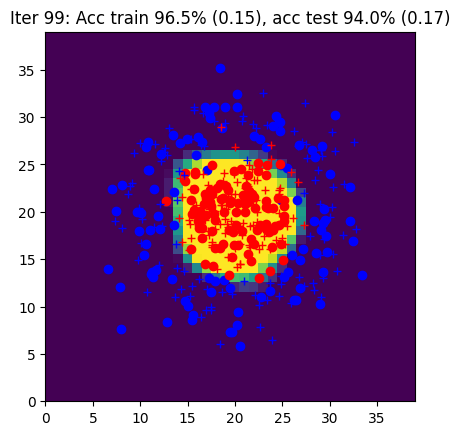

Iter 100: Acc train 96.5% (0.15), acc test 94.0% (0.17)


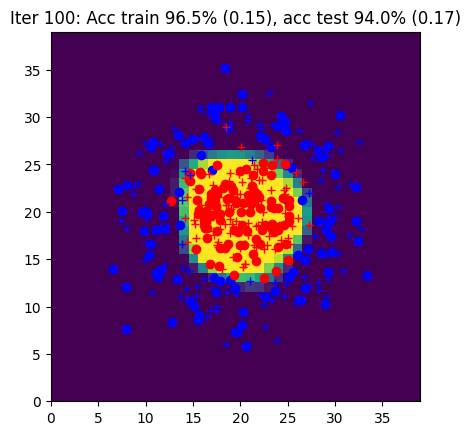

Iter 101: Acc train 95.5% (0.15), acc test 94.5% (0.17)


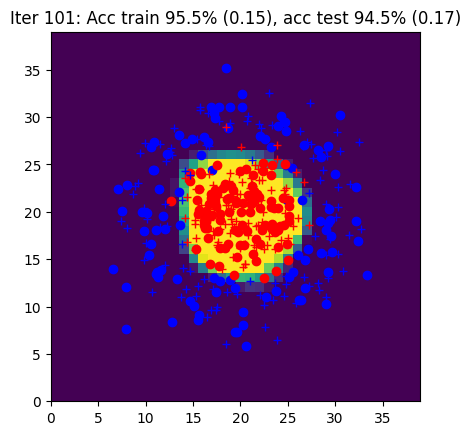

Iter 102: Acc train 96.5% (0.15), acc test 94.0% (0.17)


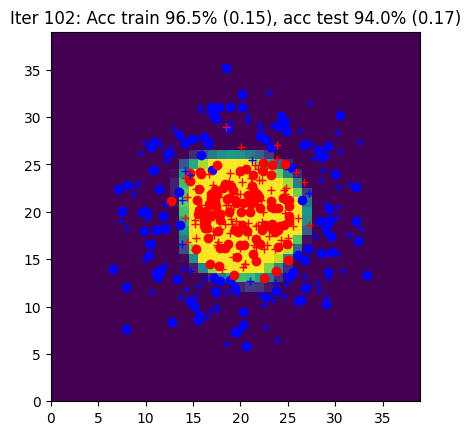

Iter 103: Acc train 95.5% (0.15), acc test 94.5% (0.17)


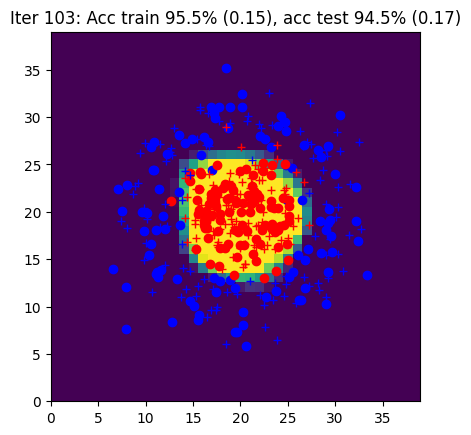

Iter 104: Acc train 96.0% (0.15), acc test 94.0% (0.17)


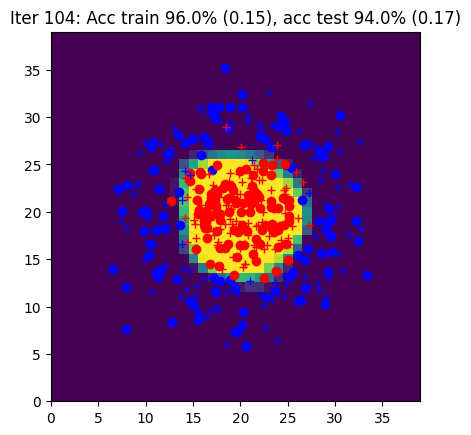

Iter 105: Acc train 96.0% (0.15), acc test 94.0% (0.17)


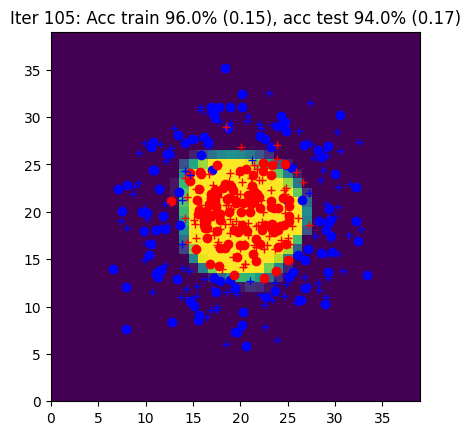

Iter 106: Acc train 96.5% (0.15), acc test 94.0% (0.17)


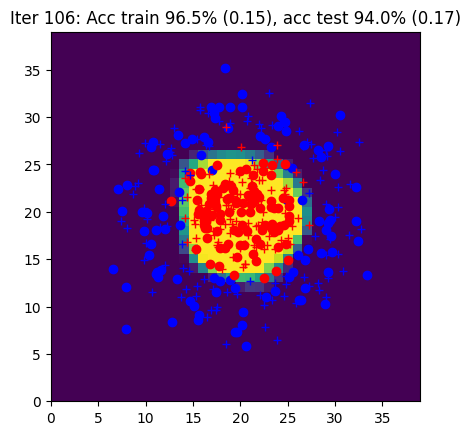

Iter 107: Acc train 95.5% (0.15), acc test 94.0% (0.17)


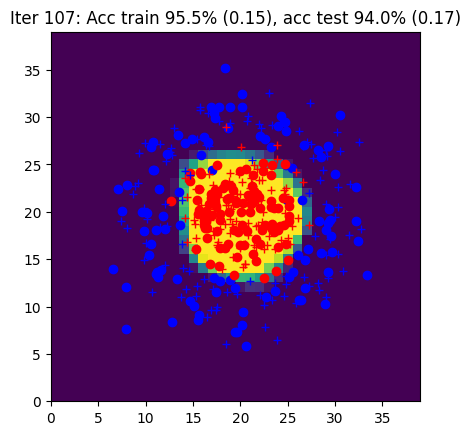

Iter 108: Acc train 95.5% (0.15), acc test 94.0% (0.17)


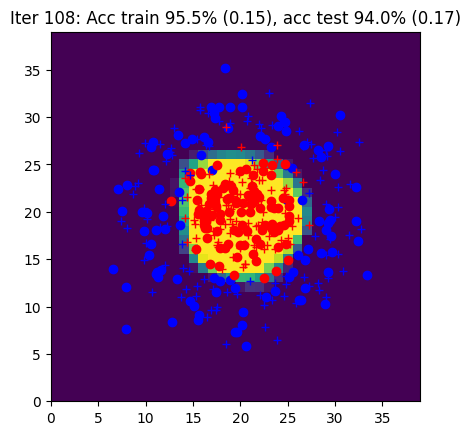

Iter 109: Acc train 96.5% (0.15), acc test 94.0% (0.16)


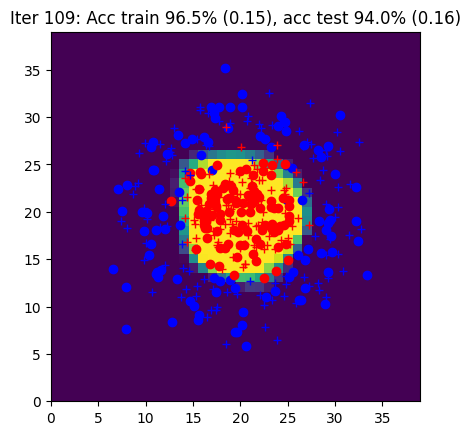

Iter 110: Acc train 96.5% (0.15), acc test 94.0% (0.16)


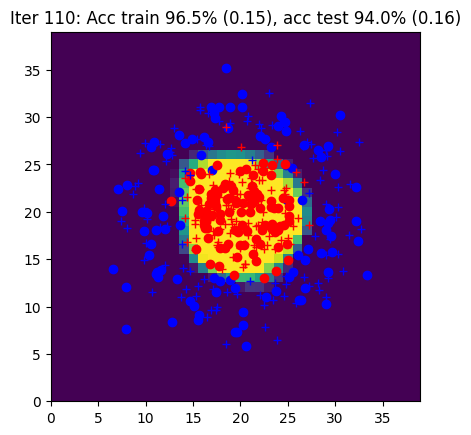

Iter 111: Acc train 96.5% (0.15), acc test 94.0% (0.16)


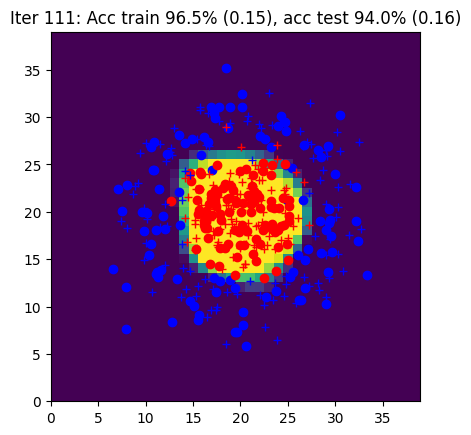

Iter 112: Acc train 96.5% (0.15), acc test 94.0% (0.16)


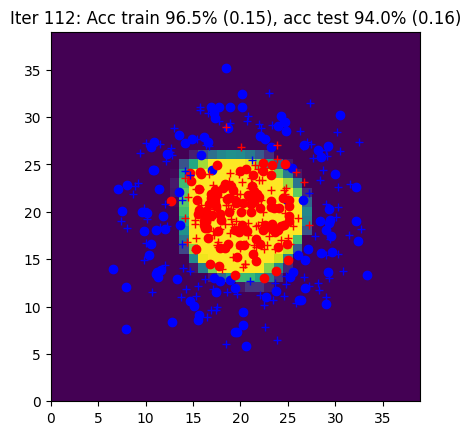

Iter 113: Acc train 96.5% (0.14), acc test 94.0% (0.16)


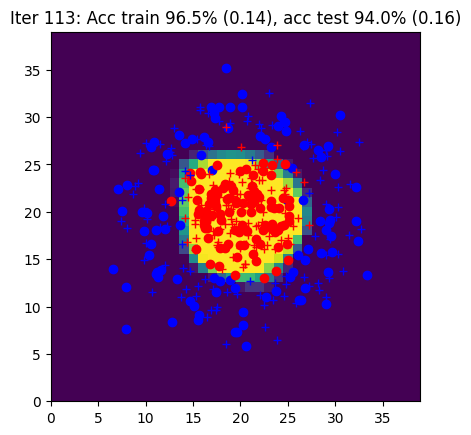

Iter 114: Acc train 97.0% (0.14), acc test 94.0% (0.16)


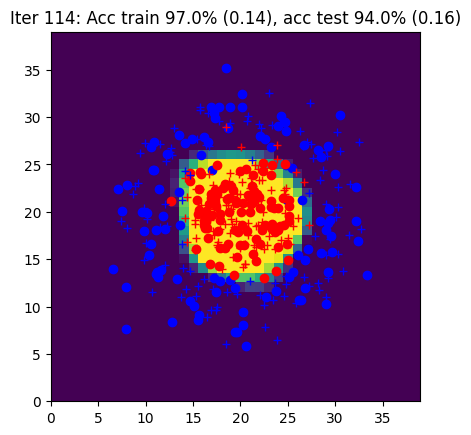

Iter 115: Acc train 96.0% (0.14), acc test 94.0% (0.16)


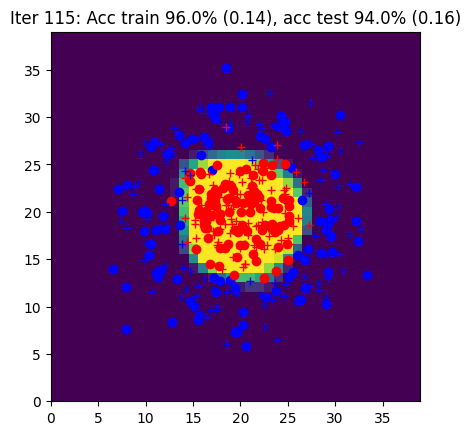

Iter 116: Acc train 97.0% (0.14), acc test 94.0% (0.16)


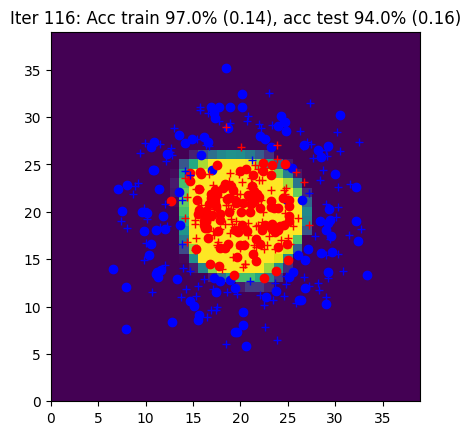

Iter 117: Acc train 96.5% (0.14), acc test 94.0% (0.16)


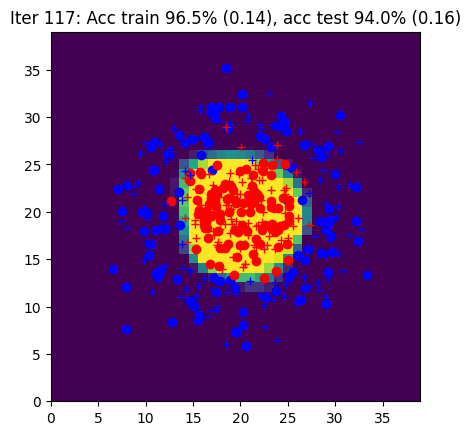

Iter 118: Acc train 96.5% (0.14), acc test 94.0% (0.16)


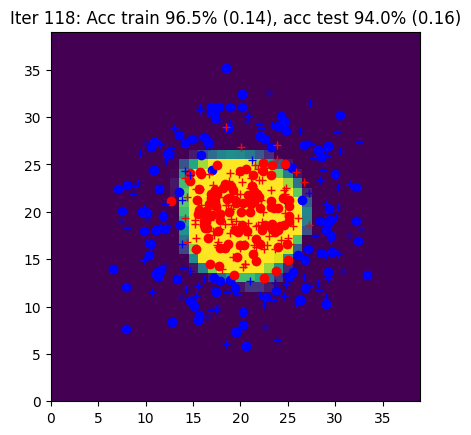

Iter 119: Acc train 96.0% (0.14), acc test 94.5% (0.16)


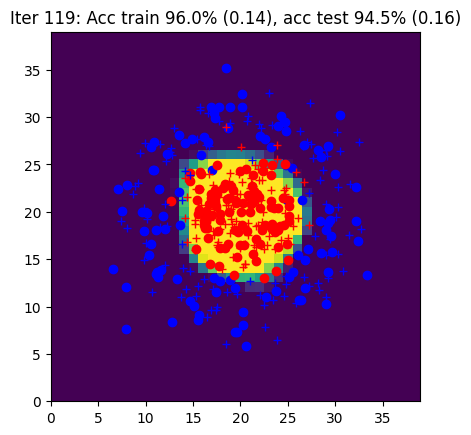

Iter 120: Acc train 96.0% (0.14), acc test 94.0% (0.16)


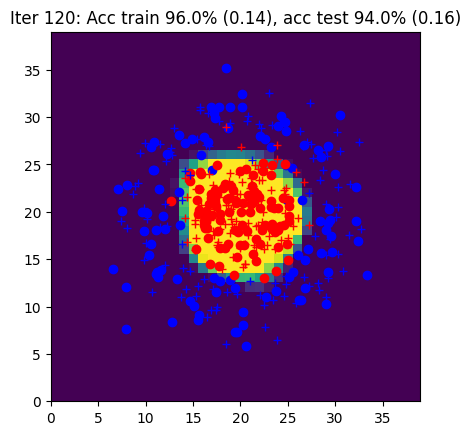

Iter 121: Acc train 96.0% (0.14), acc test 94.0% (0.16)


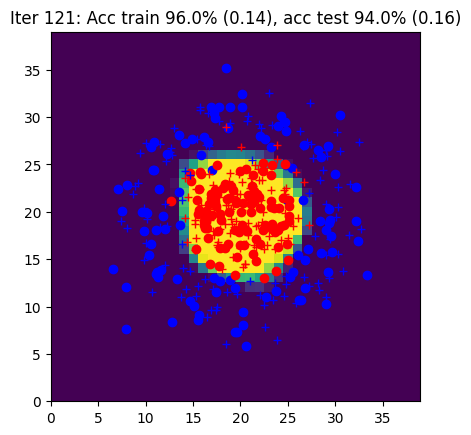

Iter 122: Acc train 97.0% (0.14), acc test 94.0% (0.16)


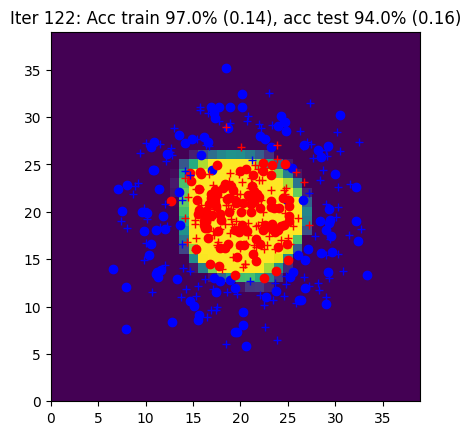

Iter 123: Acc train 97.0% (0.14), acc test 94.0% (0.16)


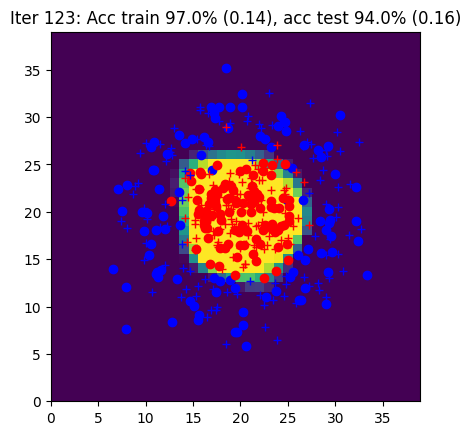

Iter 124: Acc train 96.5% (0.14), acc test 94.0% (0.16)


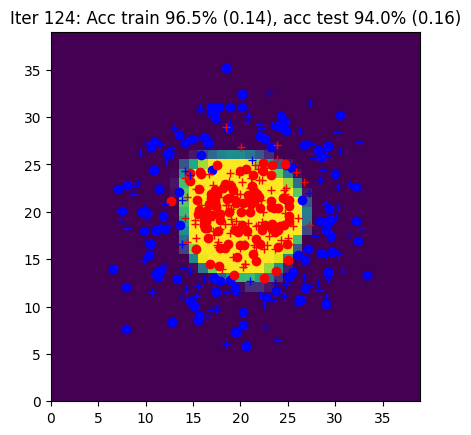

Iter 125: Acc train 97.0% (0.14), acc test 94.0% (0.16)


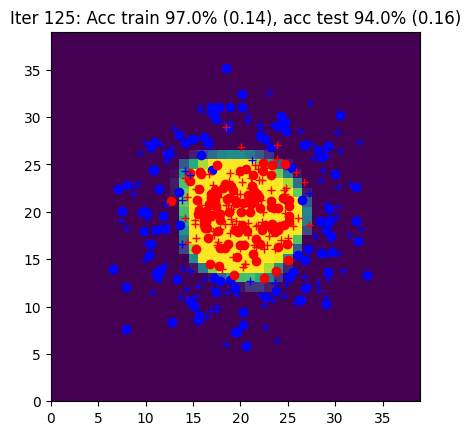

Iter 126: Acc train 97.0% (0.14), acc test 94.0% (0.16)


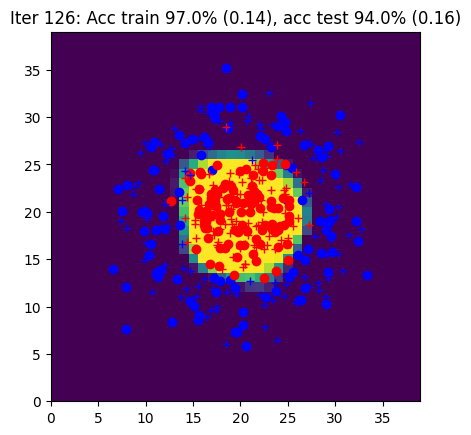

Iter 127: Acc train 97.0% (0.14), acc test 94.0% (0.16)


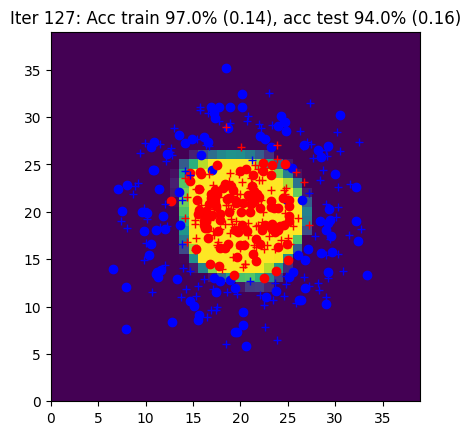

Iter 128: Acc train 97.0% (0.14), acc test 94.0% (0.16)


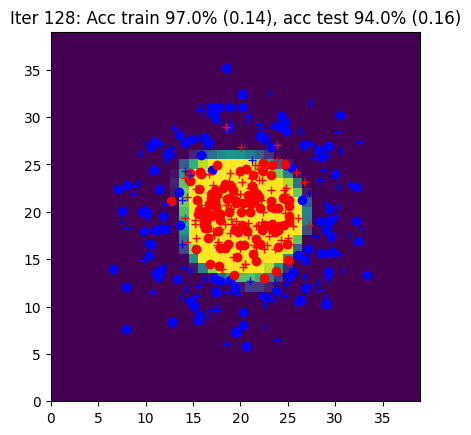

Iter 129: Acc train 97.0% (0.14), acc test 94.0% (0.16)


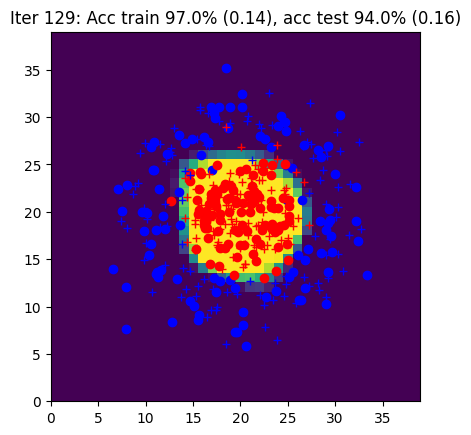

Iter 130: Acc train 96.5% (0.14), acc test 94.0% (0.16)


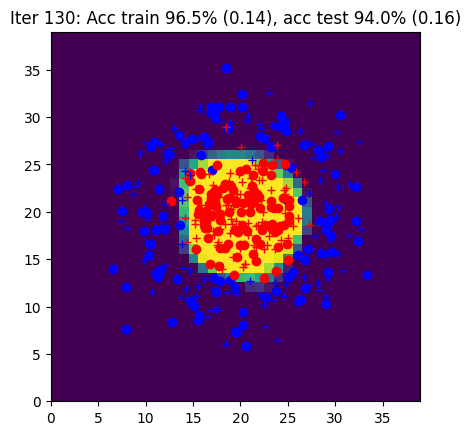

Iter 131: Acc train 97.0% (0.14), acc test 94.0% (0.16)


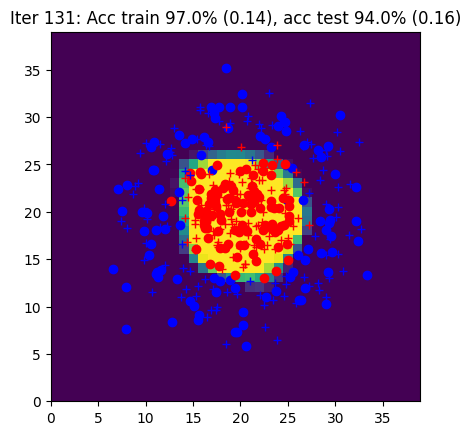

Iter 132: Acc train 96.5% (0.14), acc test 94.0% (0.16)


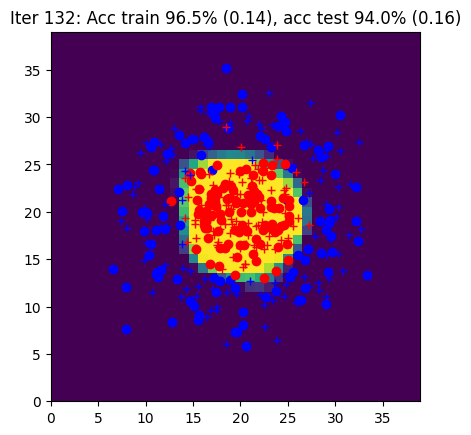

Iter 133: Acc train 97.0% (0.14), acc test 94.0% (0.16)


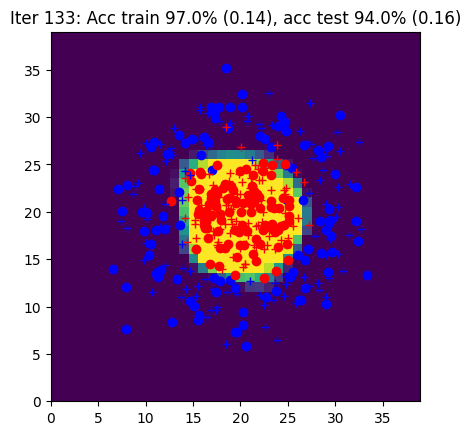

Iter 134: Acc train 96.0% (0.14), acc test 94.0% (0.16)


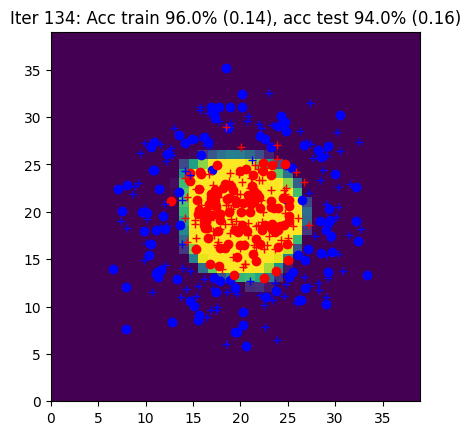

Iter 135: Acc train 96.5% (0.14), acc test 94.0% (0.16)


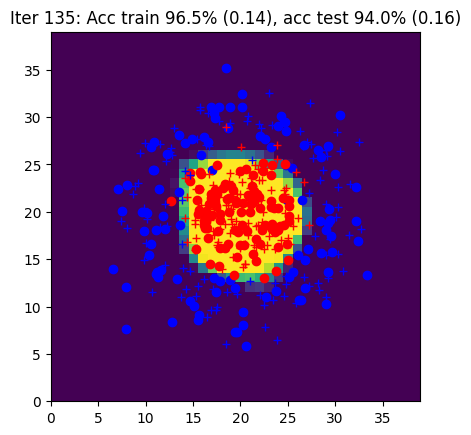

Iter 136: Acc train 97.0% (0.14), acc test 94.0% (0.16)


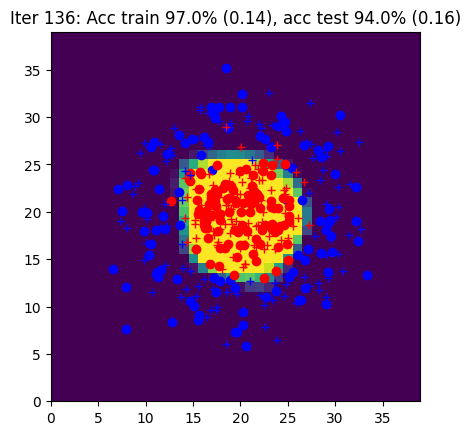

Iter 137: Acc train 96.5% (0.14), acc test 94.0% (0.16)


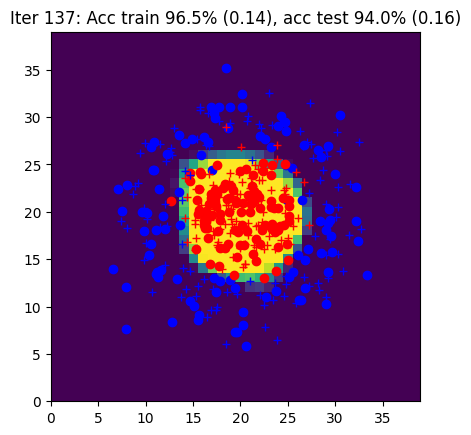

Iter 138: Acc train 96.5% (0.14), acc test 94.0% (0.16)


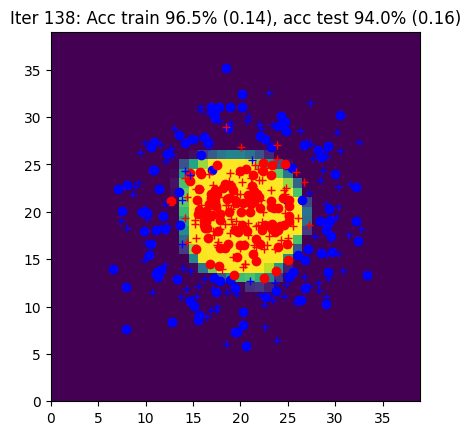

Iter 139: Acc train 96.5% (0.14), acc test 94.0% (0.16)


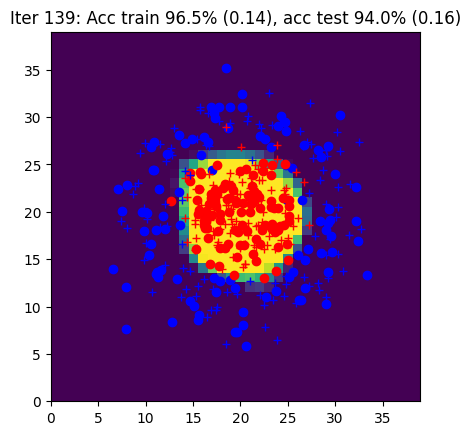

Iter 140: Acc train 96.5% (0.14), acc test 94.0% (0.16)


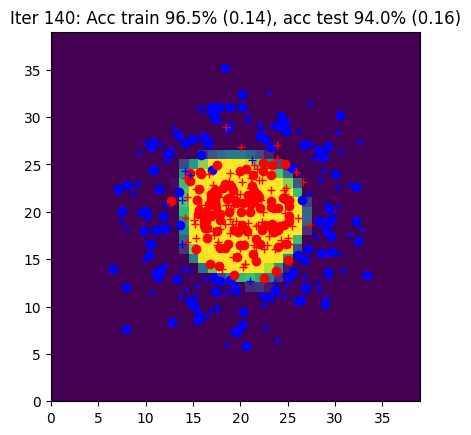

Iter 141: Acc train 96.5% (0.14), acc test 94.0% (0.16)


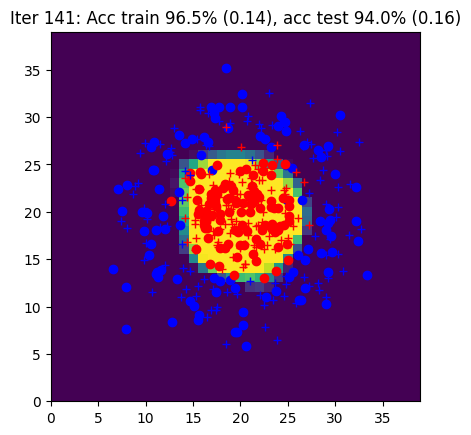

Iter 142: Acc train 97.0% (0.13), acc test 94.0% (0.16)


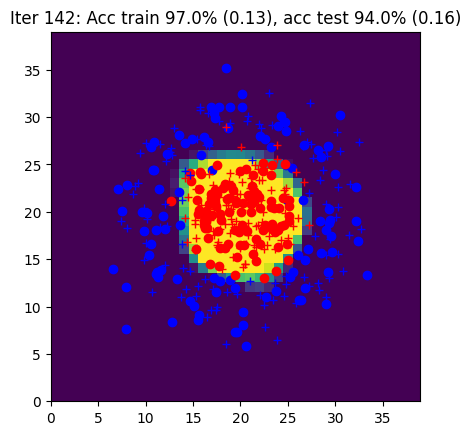

Iter 143: Acc train 97.0% (0.13), acc test 94.0% (0.16)


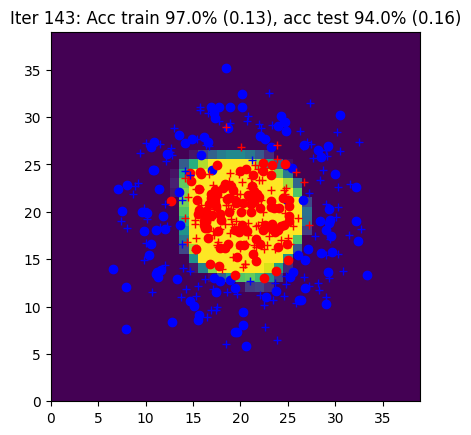

Iter 144: Acc train 96.5% (0.13), acc test 94.0% (0.16)


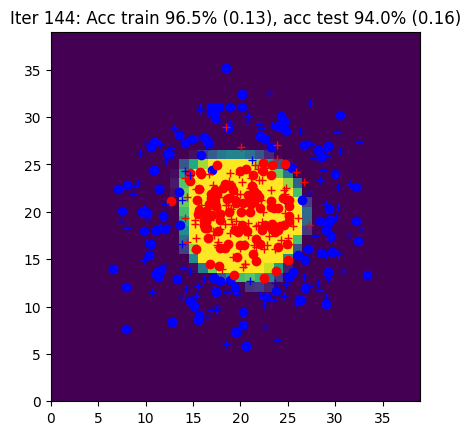

Iter 145: Acc train 97.0% (0.13), acc test 94.0% (0.16)


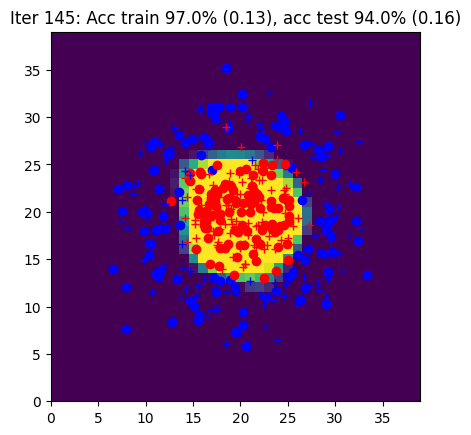

Iter 146: Acc train 97.0% (0.13), acc test 94.0% (0.16)


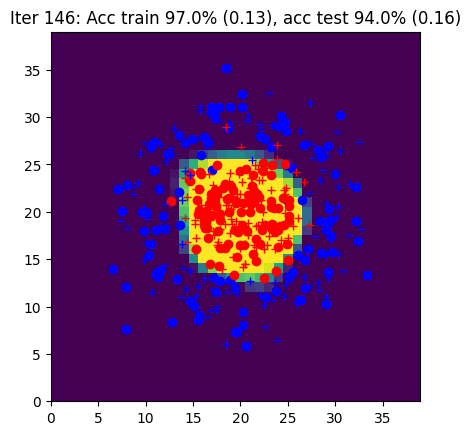

Iter 147: Acc train 97.0% (0.13), acc test 94.0% (0.16)


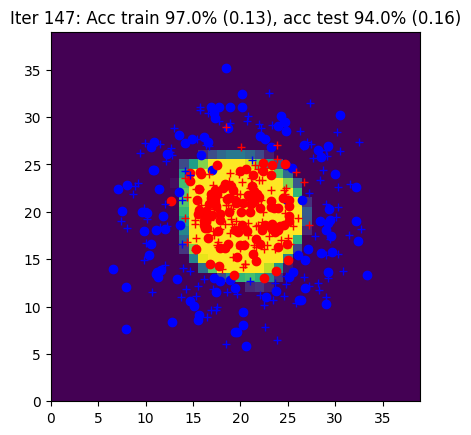

Iter 148: Acc train 97.0% (0.13), acc test 94.0% (0.16)


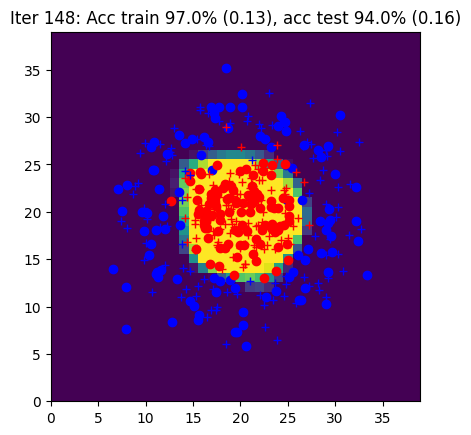

Iter 149: Acc train 97.0% (0.13), acc test 94.0% (0.16)


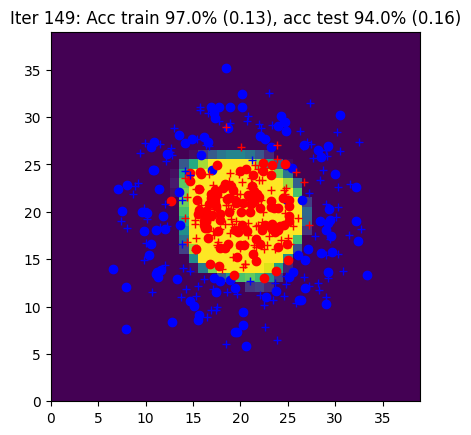

In [14]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

params = init_params(nx, nh, ny)
print(params)


curves = [[], [], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code here  ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j + 1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # write the optimization algorithm on the batch (X,Y)
        # using the functions: forward, loss_accuracy, sgd
        # and the backward function with autograd
        
        Yhat, outputs = forward(params, X)
        
        # calculate loss and accuracy
        L, acc = loss_accuracy(Yhat, Y)
        
        # backward propagation to compute gradients
        L.backward()

        # update parameters using SGD
        params = sgd(params, eta)

    ####################
    ##      END        #
    ####################

    Yhat_train, _ = forward(params, data.Xtrain)
    Yhat_test, _ = forward(params, data.Xtest)
    Ltrain, acctrain = loss_accuracy(Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(Yhat_test, data.Ytest)
    Ygrid, _ = forward(params, data.Xgrid)

    title = "Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})".format(
        iteration, acctrain, Ltrain, acctest, Ltest
    )
    print(title)
    # detach() is used to remove the predictions from the computational graph in autograd
    data.plot_data_with_grid(Ygrid.detach(), title)

    curves[0].append(acctrain.detach().item())
    curves[1].append(acctest.detach().item())
    curves[2].append(Ltrain.detach().item())
    curves[3].append(Ltest.detach().item())



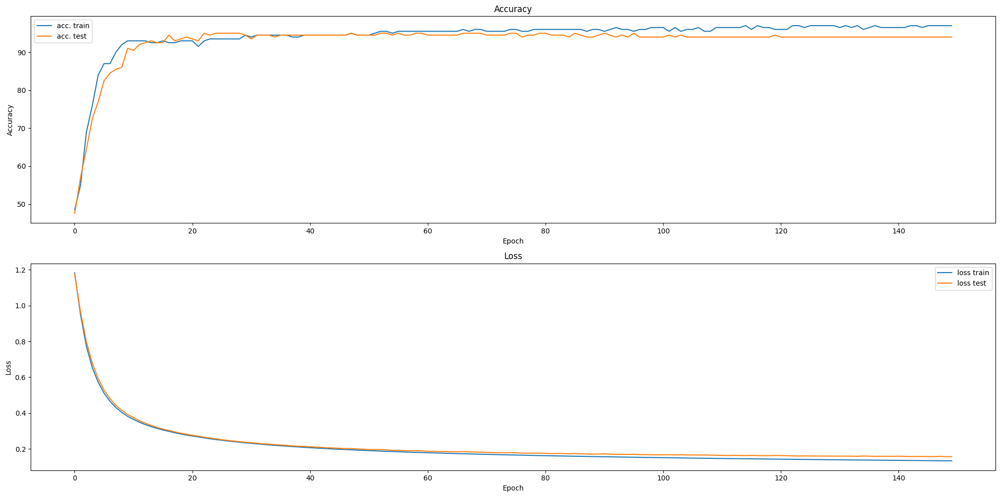

In [15]:
# Create subplots: 2 row, 1 columns
fig, axs = plt.subplots(2, 1, figsize=(20, 10))

# Plot accuracy curves on the first subplot
axs[0].plot(curves[0], label="acc. train")
axs[0].plot(curves[1], label="acc. test")
axs[0].set_title('Accuracy')
axs[0].set_xlabel('Epoch')
axs[0].set_ylabel('Accuracy')
axs[0].legend()

# Plot loss curves on the second subplot
axs[1].plot(curves[2], label="loss train")
axs[1].plot(curves[3], label="loss test")
axs[1].set_title('Loss')
axs[1].set_xlabel('Epoch')
axs[1].set_ylabel('Loss')
axs[1].legend()

# Show the plot
plt.tight_layout()
plt.show()

# Part 3 : Simplification of the forward pass with `torch.nn`

`init_params` and `forward` are replaced by the `init_model` function which defines the network architecture and the loss.

In [16]:
def init_model(nx, nh, ny):

    #####################
    ## Your code here  ##
    #####################

    model = torch.nn.Sequential(
        torch.nn.Linear(nx, nh),
        torch.nn.Tanh(),
        torch.nn.Linear(nh, ny)
    )

    loss = torch.nn.CrossEntropyLoss()

    ####################
    ##      END        #
    ####################

    return model, loss

In [17]:
def loss_accuracy(loss, Yhat, Y):

    #####################
    ## Your code here  ##
    #####################
    # call the loss function

    L = loss(Yhat, Y)
    acc = torch.mean((torch.argmax(torch.nn.Softmax()(Yhat), dim=1) == torch.argmax(Y, dim=1)).float())*100

    ####################
    ##      END        #
    ####################

    return L, acc

In [18]:
def sgd(model, eta):

    #####################
    ## Your code here  ##
    #####################
    # update the network weights
    # warning: use torch.no_grad()
    # and reset to zero the gradient accumulators
    
    with torch.no_grad():
        for param in model.parameters():
            param -= eta * param.grad
        model.zero_grad()

    ####################
    ##      END        #
    ####################
    return model

## Global learning procedure with autograd and `torch.nn`

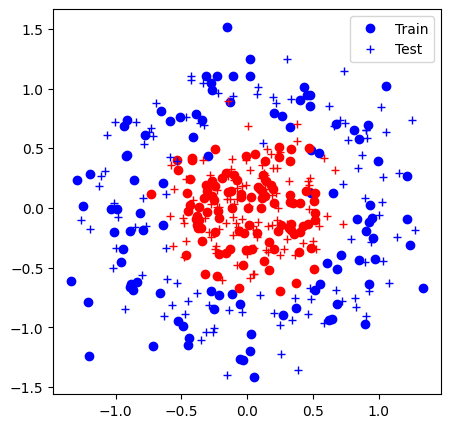

/home/hyraeth/.local/lib/python3.10/site-packages/torch/nn/modules/module.py:1553: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  return self._call_impl(*args, **kwargs)


Iter 0: Acc train 50.0% (0.72), acc test 50.0% (0.72)


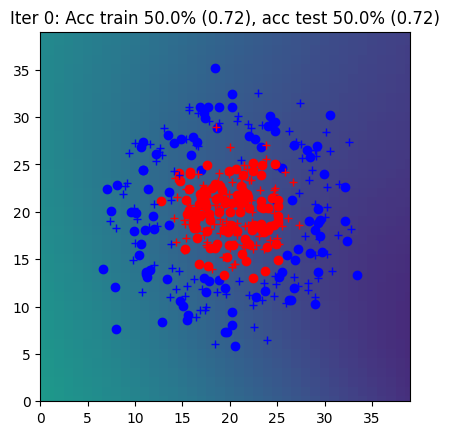

Iter 1: Acc train 47.0% (0.70), acc test 49.0% (0.70)


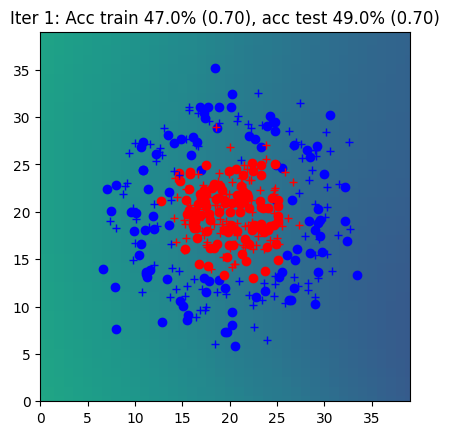

Iter 2: Acc train 36.5% (0.70), acc test 38.0% (0.69)


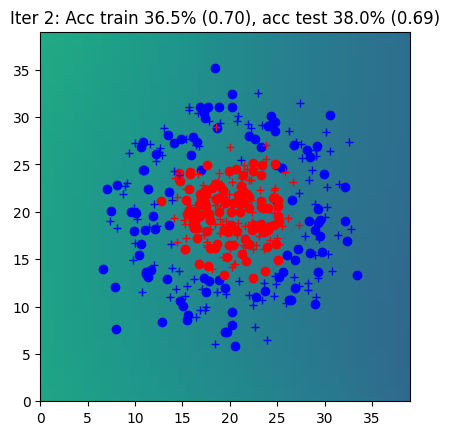

Iter 3: Acc train 41.5% (0.69), acc test 39.5% (0.69)


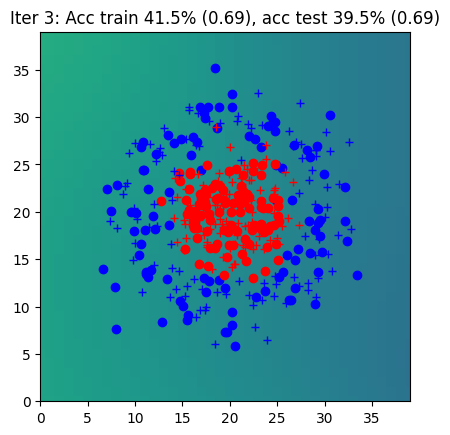

Iter 4: Acc train 63.0% (0.69), acc test 67.5% (0.69)


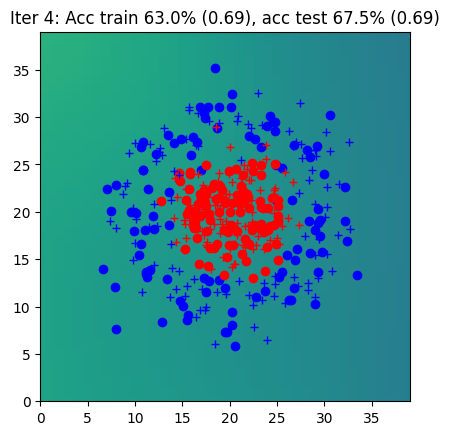

Iter 5: Acc train 52.5% (0.69), acc test 52.5% (0.69)


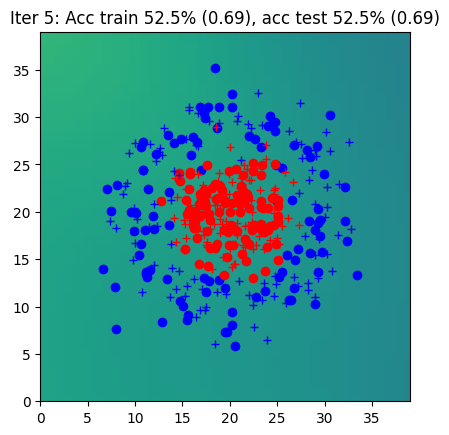

Iter 6: Acc train 55.0% (0.69), acc test 59.5% (0.69)


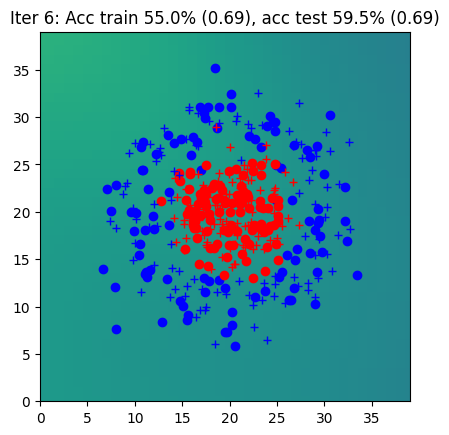

Iter 7: Acc train 54.5% (0.69), acc test 55.0% (0.69)


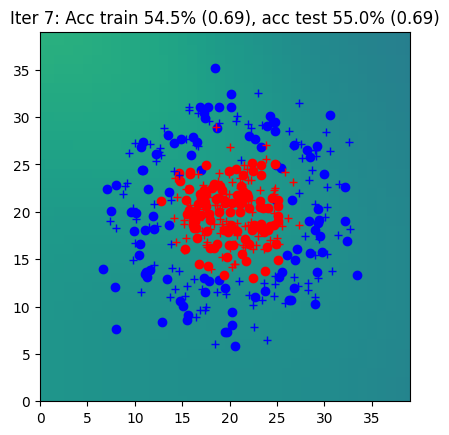

Iter 8: Acc train 74.0% (0.69), acc test 78.0% (0.69)


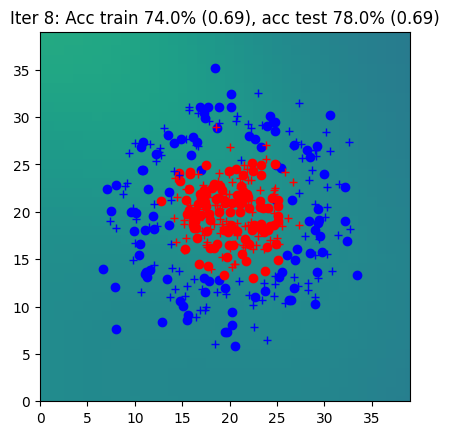

Iter 9: Acc train 73.5% (0.69), acc test 73.5% (0.69)


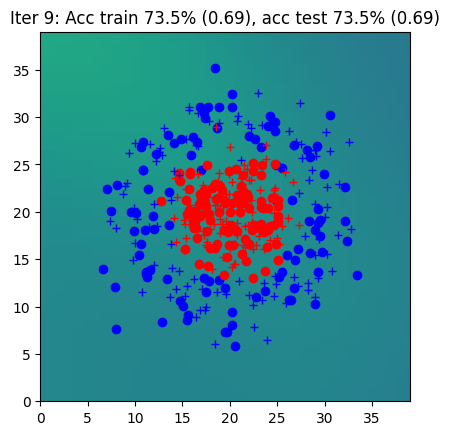

Iter 10: Acc train 68.0% (0.69), acc test 71.0% (0.69)


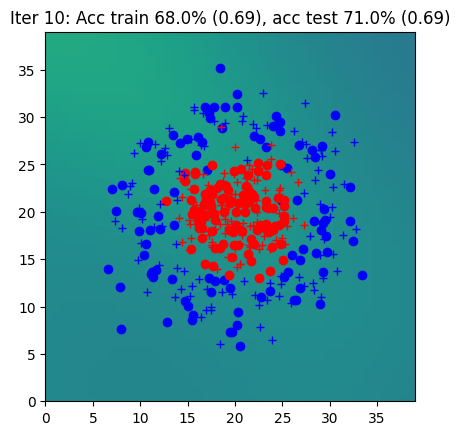

Iter 11: Acc train 69.0% (0.69), acc test 75.0% (0.69)


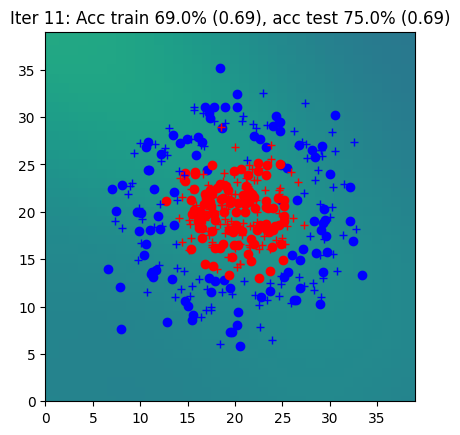

Iter 12: Acc train 74.0% (0.68), acc test 80.0% (0.68)


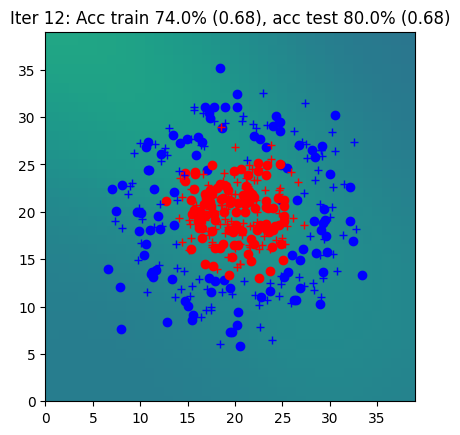

Iter 13: Acc train 62.0% (0.68), acc test 63.0% (0.68)


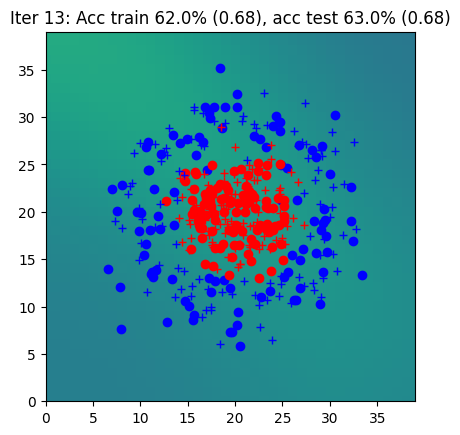

Iter 14: Acc train 59.0% (0.68), acc test 57.0% (0.68)


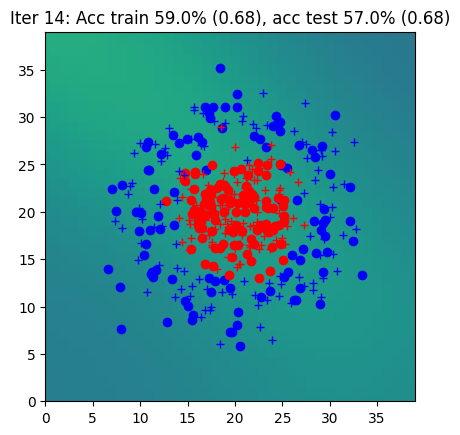

Iter 15: Acc train 61.5% (0.68), acc test 63.5% (0.68)


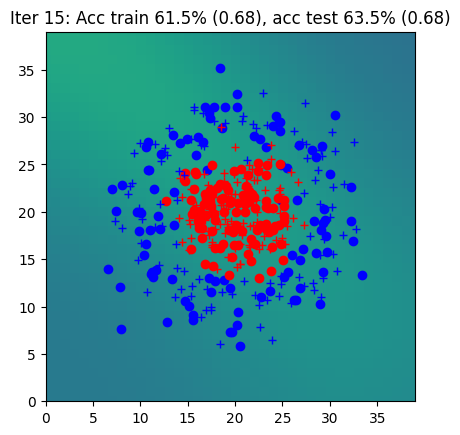

Iter 16: Acc train 63.0% (0.68), acc test 64.0% (0.68)


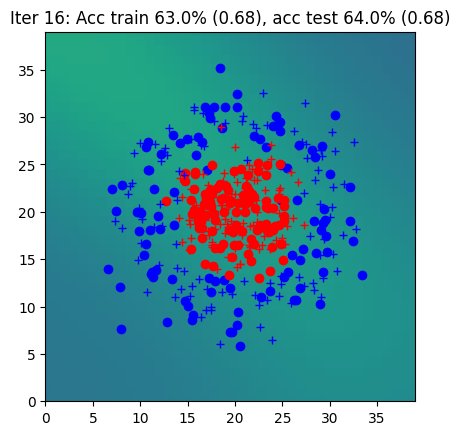

Iter 17: Acc train 64.5% (0.68), acc test 66.5% (0.68)


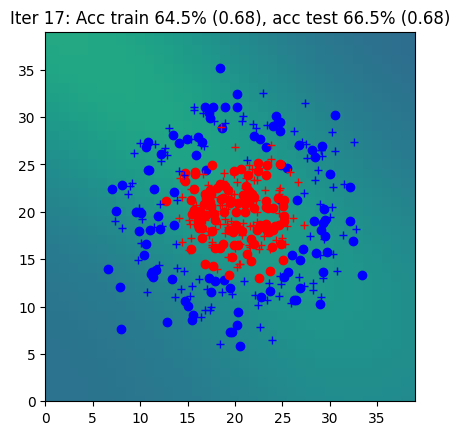

Iter 18: Acc train 71.5% (0.68), acc test 75.0% (0.68)


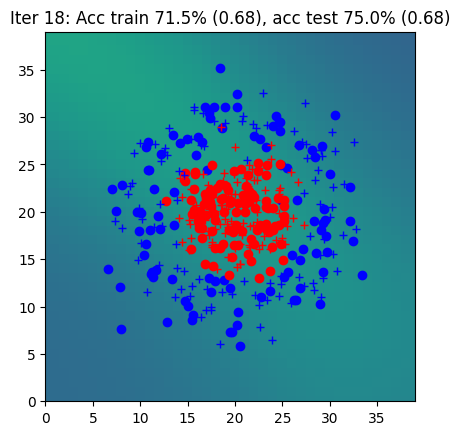

Iter 19: Acc train 74.5% (0.68), acc test 76.0% (0.68)


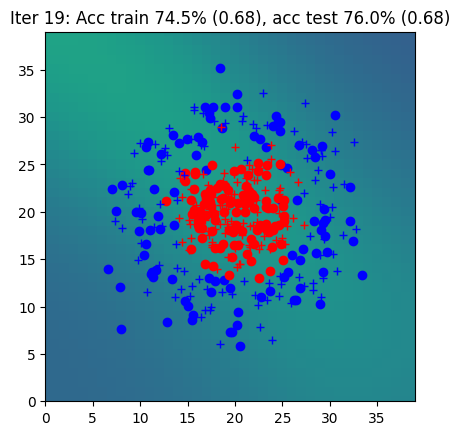

Iter 20: Acc train 63.5% (0.67), acc test 64.5% (0.68)


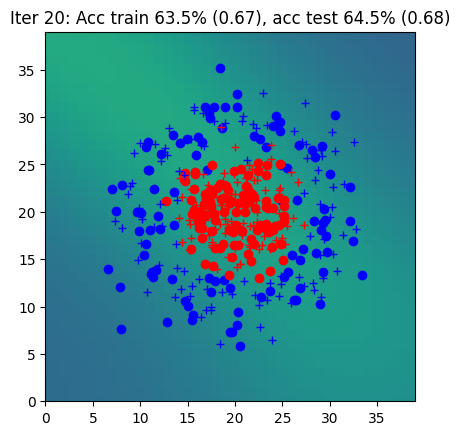

Iter 21: Acc train 70.0% (0.67), acc test 71.0% (0.67)


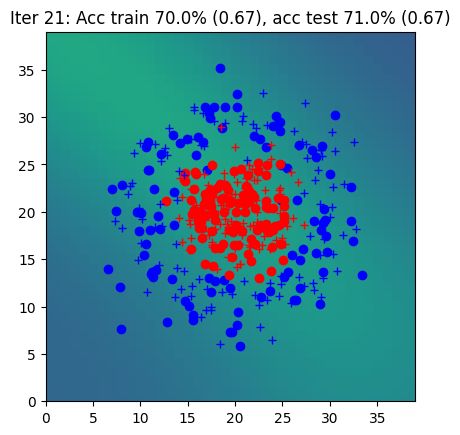

Iter 22: Acc train 72.0% (0.67), acc test 72.5% (0.67)


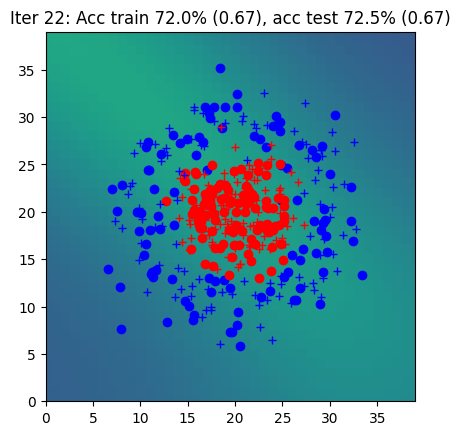

Iter 23: Acc train 69.0% (0.67), acc test 69.0% (0.67)


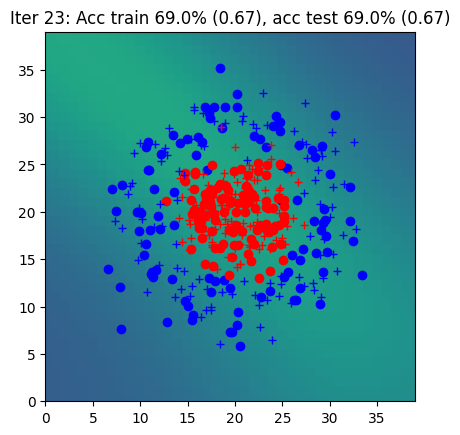

Iter 24: Acc train 72.5% (0.67), acc test 73.5% (0.67)


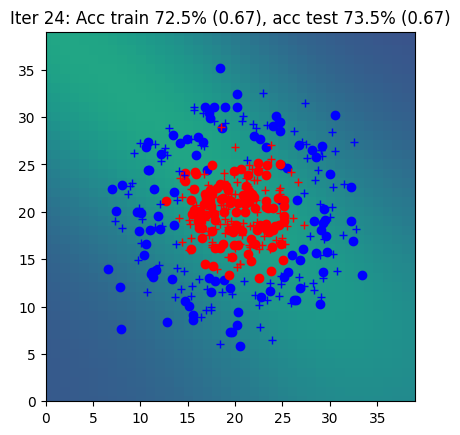

Iter 25: Acc train 72.5% (0.67), acc test 72.0% (0.67)


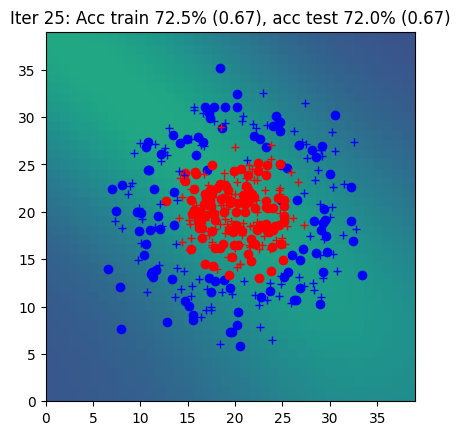

Iter 26: Acc train 72.5% (0.67), acc test 73.0% (0.67)


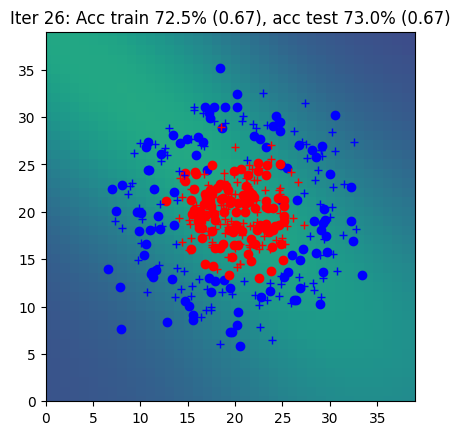

Iter 27: Acc train 76.0% (0.66), acc test 75.5% (0.67)


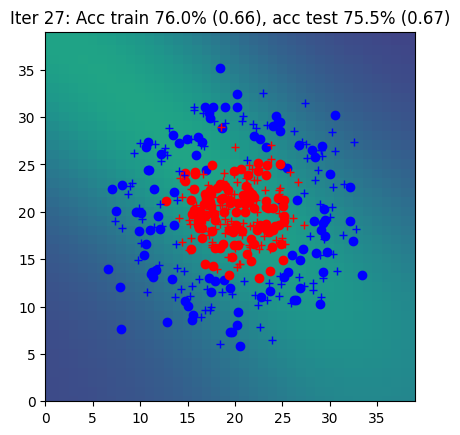

Iter 28: Acc train 75.0% (0.66), acc test 75.5% (0.66)


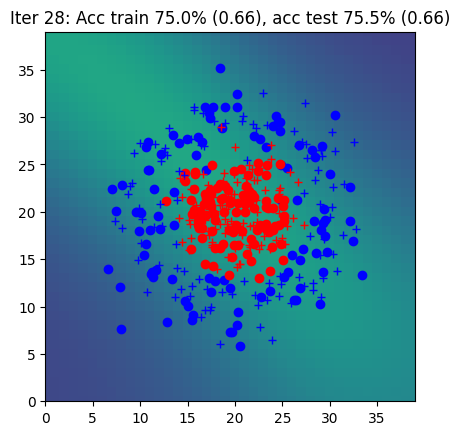

Iter 29: Acc train 77.0% (0.66), acc test 75.5% (0.66)


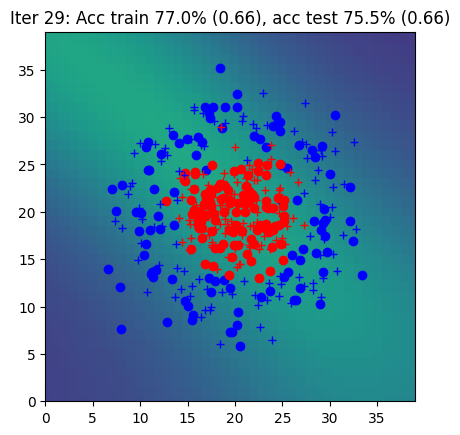

Iter 30: Acc train 77.5% (0.66), acc test 76.0% (0.66)


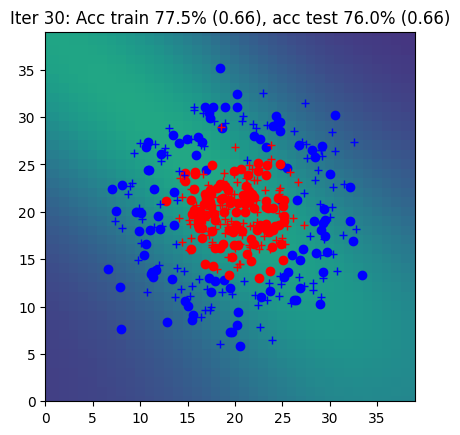

Iter 31: Acc train 80.0% (0.66), acc test 76.5% (0.66)


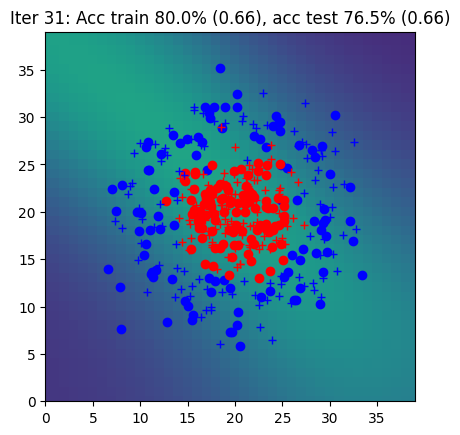

Iter 32: Acc train 74.5% (0.65), acc test 74.5% (0.66)


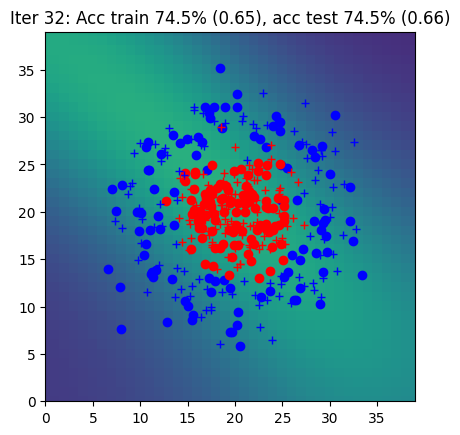

Iter 33: Acc train 77.0% (0.65), acc test 76.5% (0.65)


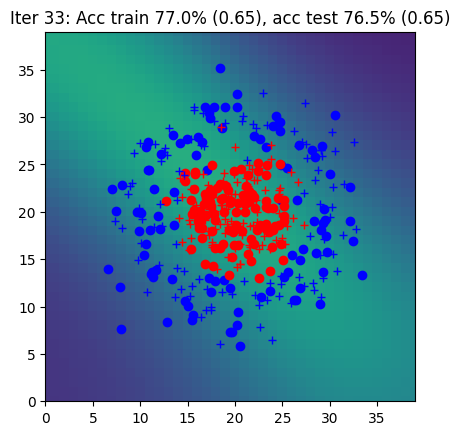

Iter 34: Acc train 76.5% (0.65), acc test 77.0% (0.65)


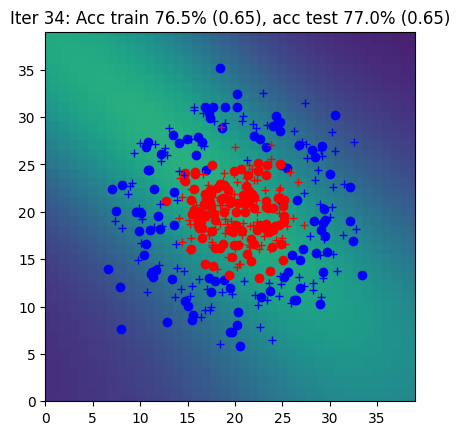

Iter 35: Acc train 72.0% (0.65), acc test 72.0% (0.65)


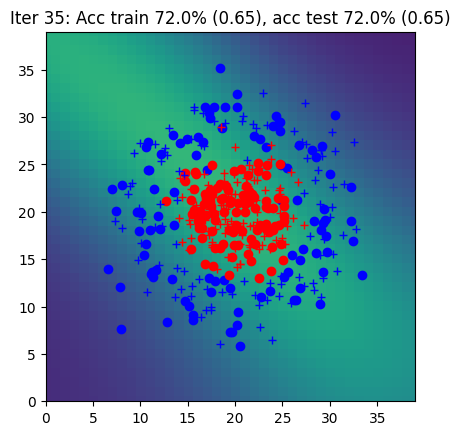

Iter 36: Acc train 76.5% (0.64), acc test 76.5% (0.65)


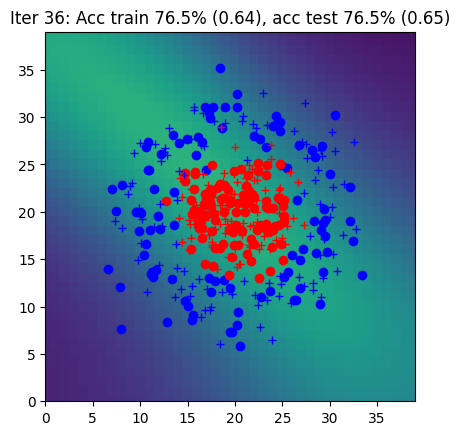

Iter 37: Acc train 79.0% (0.64), acc test 75.5% (0.65)


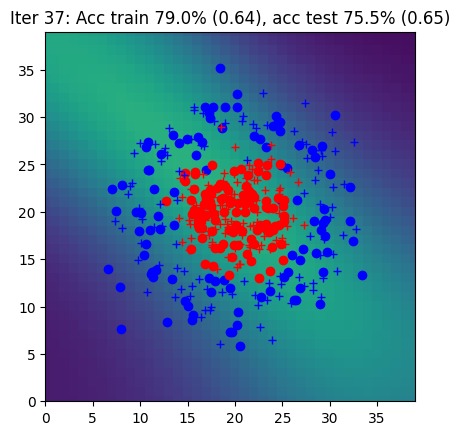

Iter 38: Acc train 78.0% (0.64), acc test 75.5% (0.64)


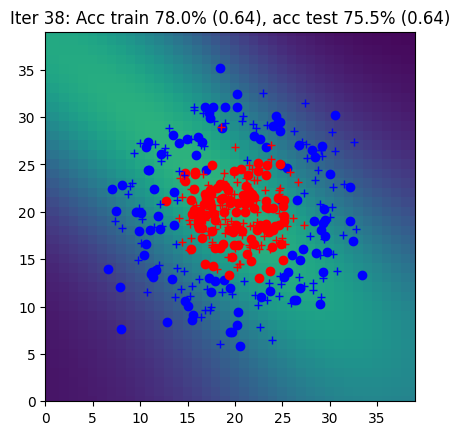

Iter 39: Acc train 79.0% (0.63), acc test 76.0% (0.64)


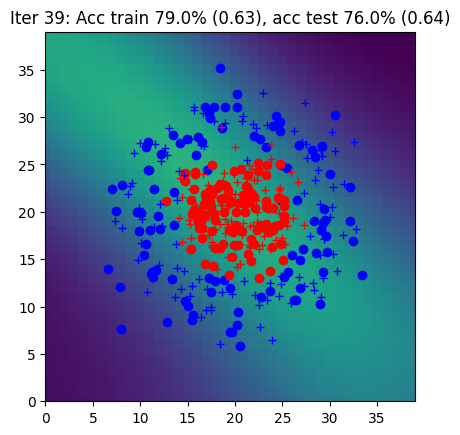

Iter 40: Acc train 79.0% (0.63), acc test 75.5% (0.64)


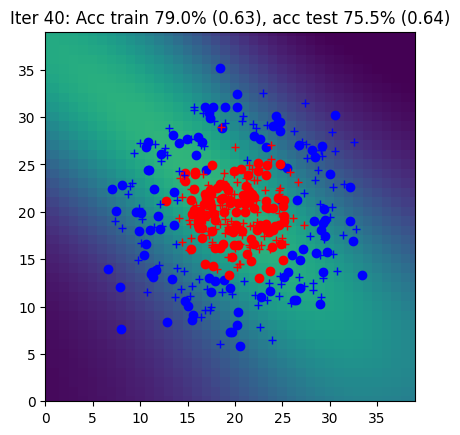

Iter 41: Acc train 78.5% (0.63), acc test 76.0% (0.63)


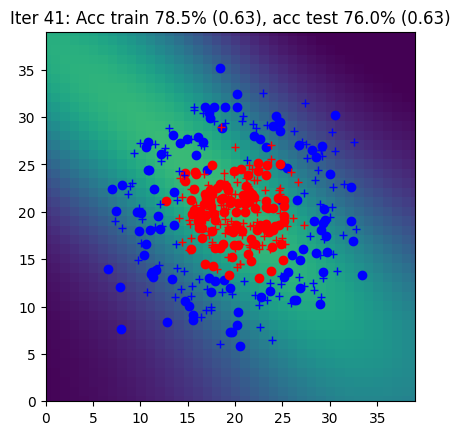

Iter 42: Acc train 77.0% (0.62), acc test 75.0% (0.63)


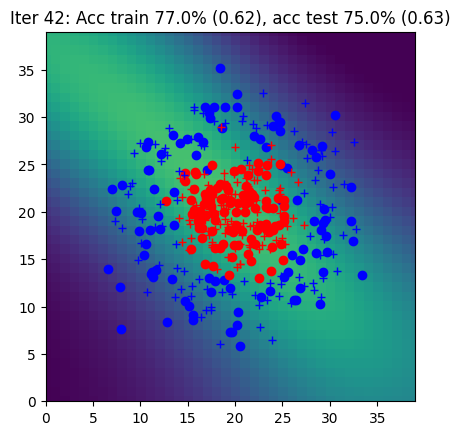

Iter 43: Acc train 78.5% (0.62), acc test 76.0% (0.63)


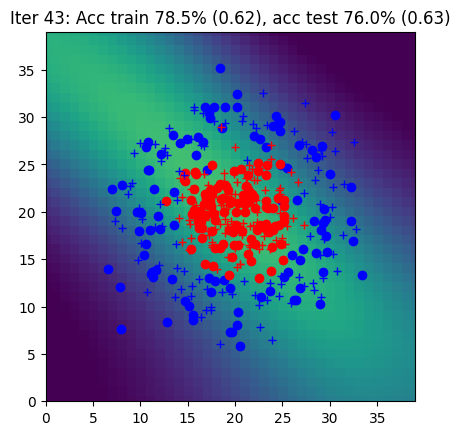

Iter 44: Acc train 78.0% (0.62), acc test 75.5% (0.63)


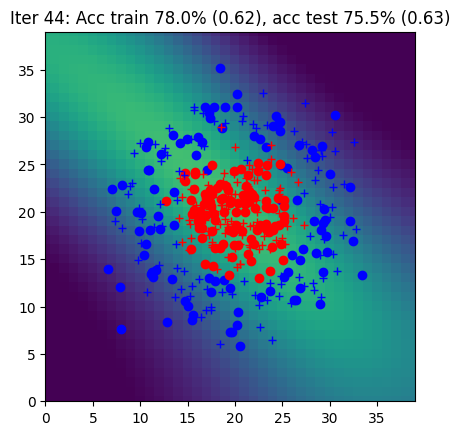

Iter 45: Acc train 77.5% (0.61), acc test 76.0% (0.62)


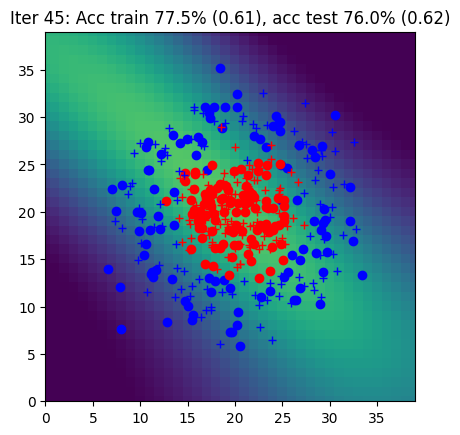

Iter 46: Acc train 77.0% (0.61), acc test 75.0% (0.62)


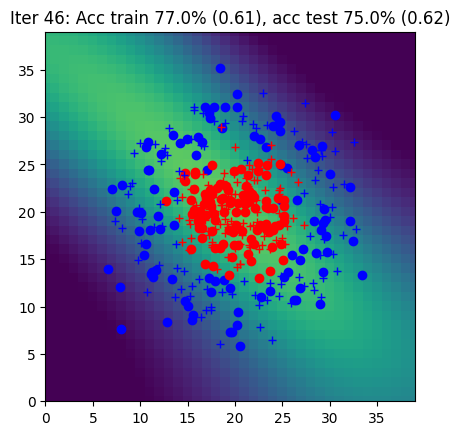

Iter 47: Acc train 77.5% (0.61), acc test 75.0% (0.62)


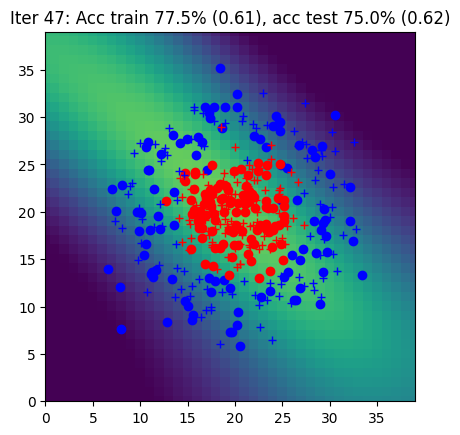

Iter 48: Acc train 78.0% (0.60), acc test 76.5% (0.61)


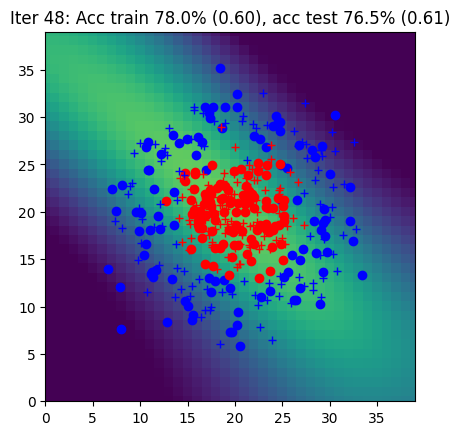

Iter 49: Acc train 77.5% (0.60), acc test 76.0% (0.61)


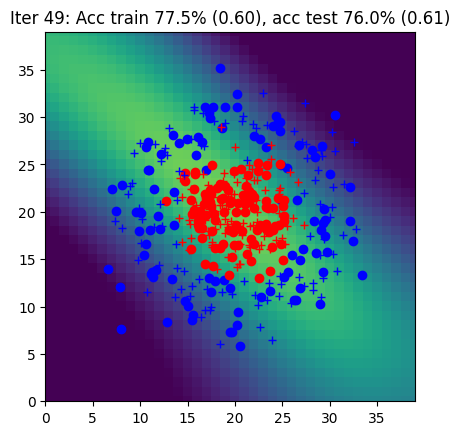

Iter 50: Acc train 82.0% (0.59), acc test 76.0% (0.61)


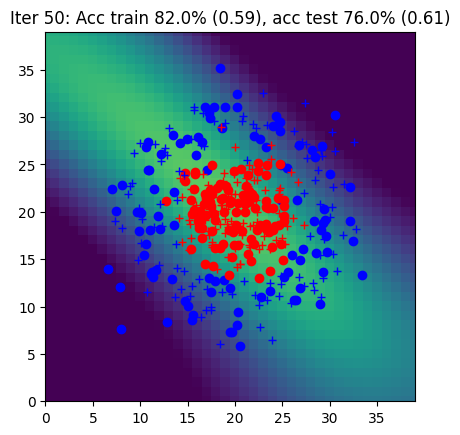

Iter 51: Acc train 82.0% (0.59), acc test 76.0% (0.60)


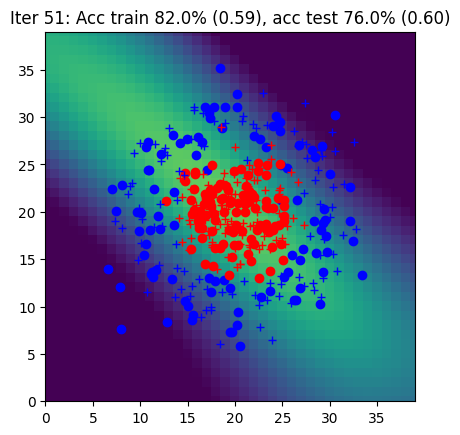

Iter 52: Acc train 79.0% (0.59), acc test 76.0% (0.60)


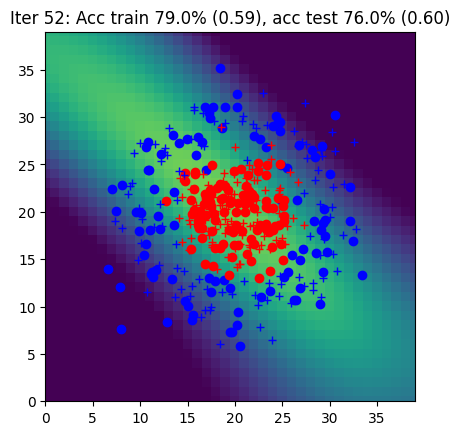

Iter 53: Acc train 81.0% (0.58), acc test 76.0% (0.59)


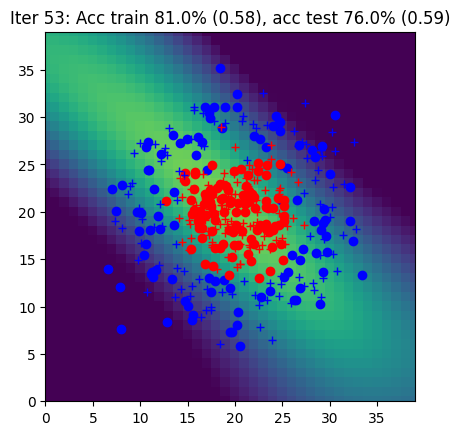

Iter 54: Acc train 82.0% (0.58), acc test 75.5% (0.59)


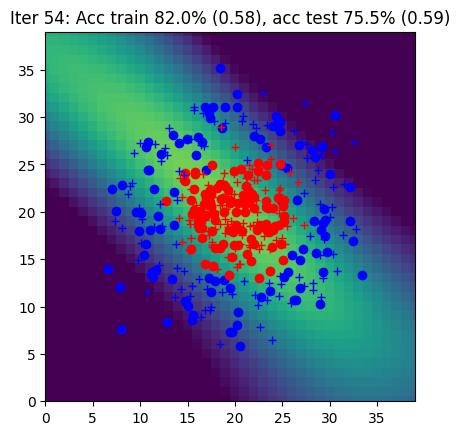

Iter 55: Acc train 81.5% (0.57), acc test 75.5% (0.59)


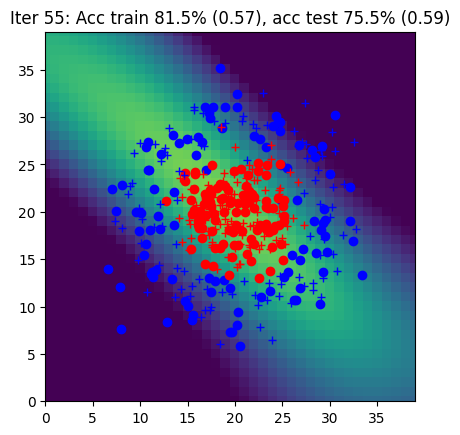

Iter 56: Acc train 81.5% (0.57), acc test 76.0% (0.58)


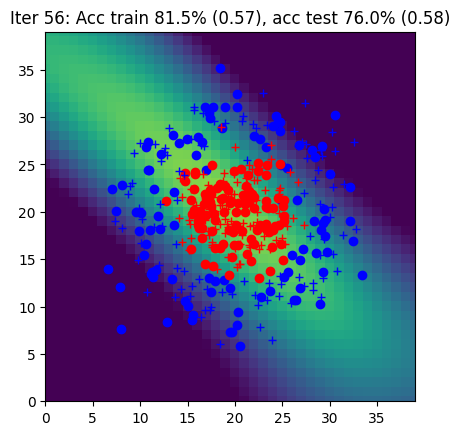

Iter 57: Acc train 81.5% (0.57), acc test 76.0% (0.58)


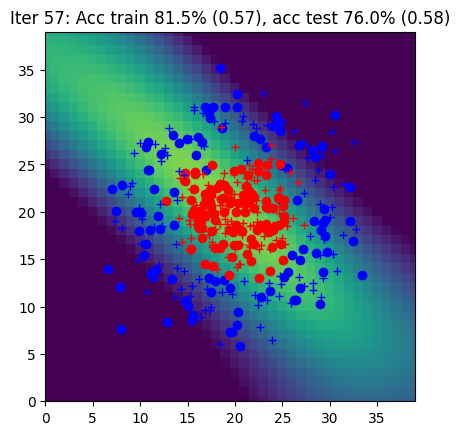

Iter 58: Acc train 80.5% (0.56), acc test 76.0% (0.58)


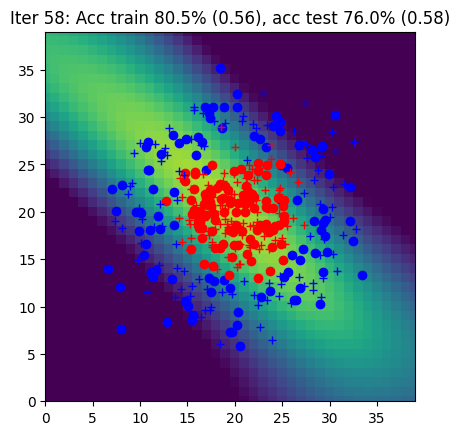

Iter 59: Acc train 81.5% (0.56), acc test 75.0% (0.57)


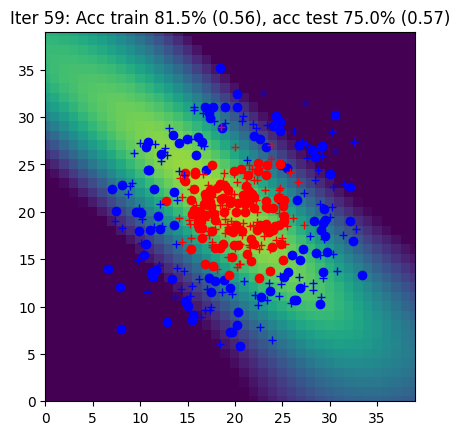

Iter 60: Acc train 81.5% (0.55), acc test 76.5% (0.57)


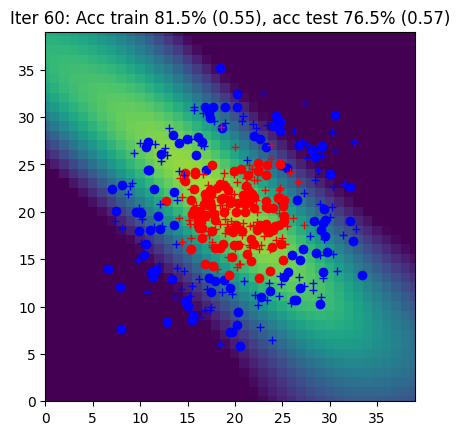

Iter 61: Acc train 81.5% (0.55), acc test 76.5% (0.57)


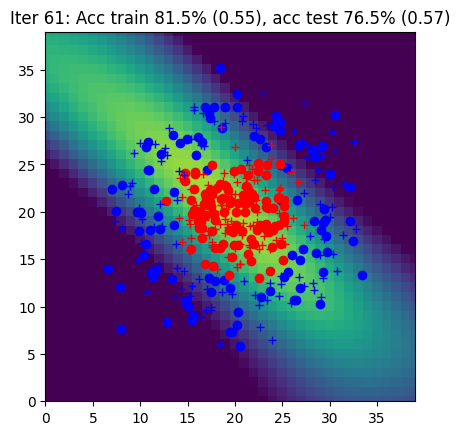

Iter 62: Acc train 82.0% (0.54), acc test 76.5% (0.56)


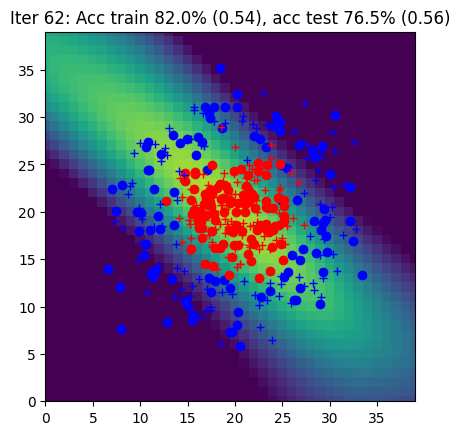

Iter 63: Acc train 81.5% (0.54), acc test 76.5% (0.56)


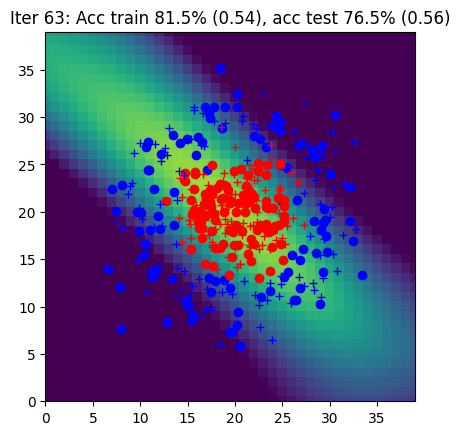

Iter 64: Acc train 82.0% (0.54), acc test 76.0% (0.55)


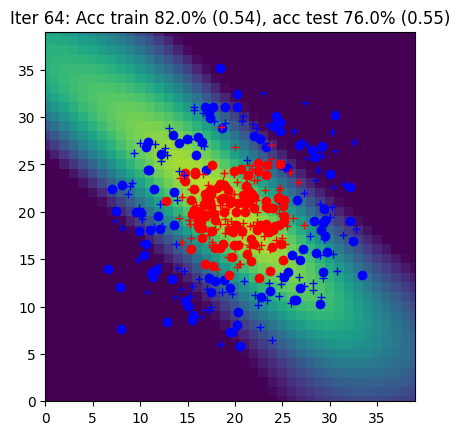

Iter 65: Acc train 81.0% (0.53), acc test 77.5% (0.55)


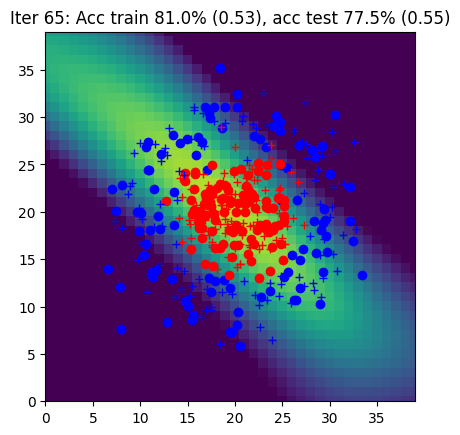

Iter 66: Acc train 81.5% (0.53), acc test 76.5% (0.55)


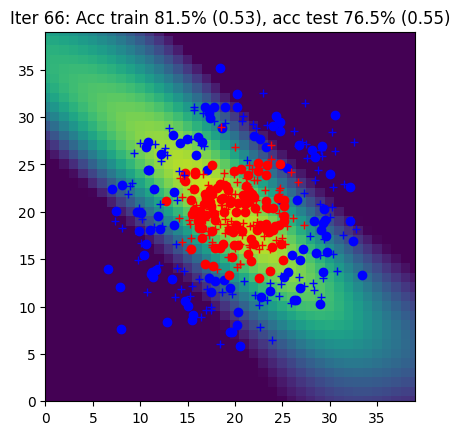

Iter 67: Acc train 82.0% (0.52), acc test 76.5% (0.54)


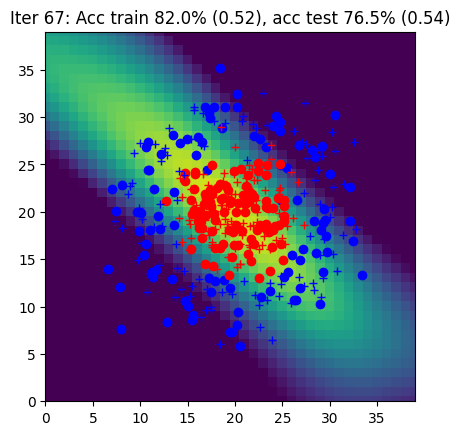

Iter 68: Acc train 82.0% (0.52), acc test 76.5% (0.54)


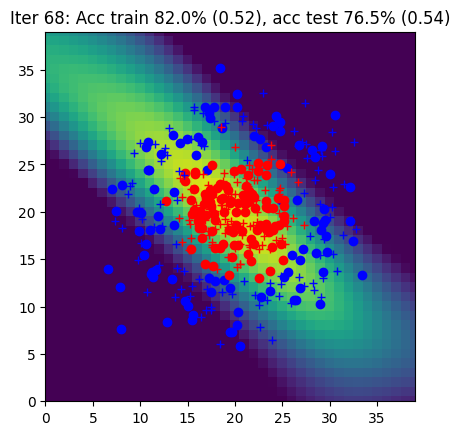

Iter 69: Acc train 82.0% (0.52), acc test 76.5% (0.54)


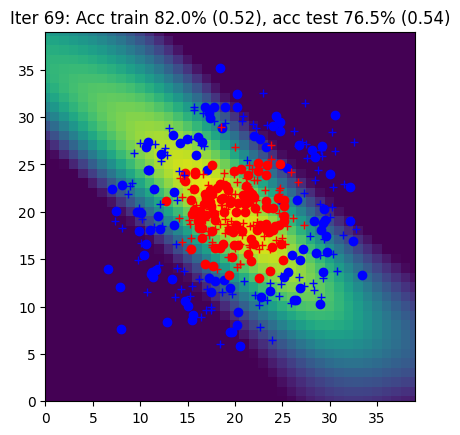

Iter 70: Acc train 80.5% (0.51), acc test 77.5% (0.54)


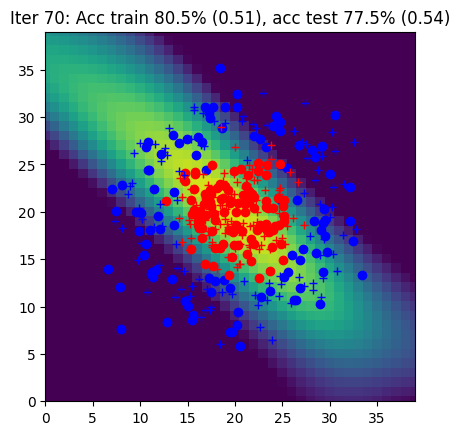

Iter 71: Acc train 81.5% (0.51), acc test 77.0% (0.53)


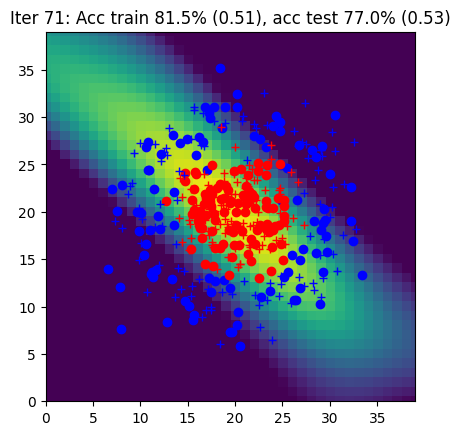

Iter 72: Acc train 82.0% (0.50), acc test 76.5% (0.53)


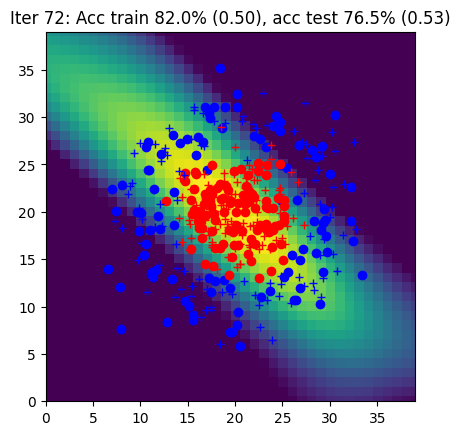

Iter 73: Acc train 82.0% (0.50), acc test 76.5% (0.53)


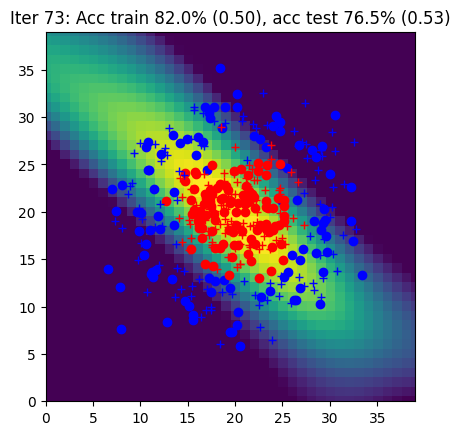

Iter 74: Acc train 81.5% (0.50), acc test 76.5% (0.52)


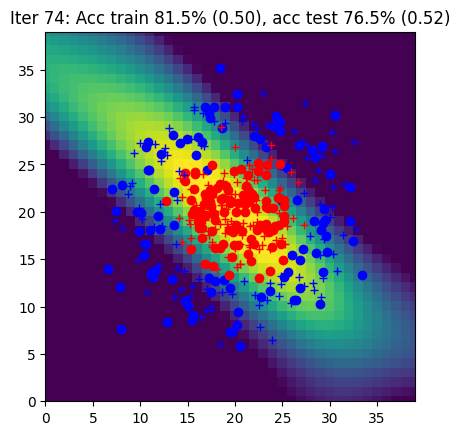

Iter 75: Acc train 81.0% (0.49), acc test 77.5% (0.52)


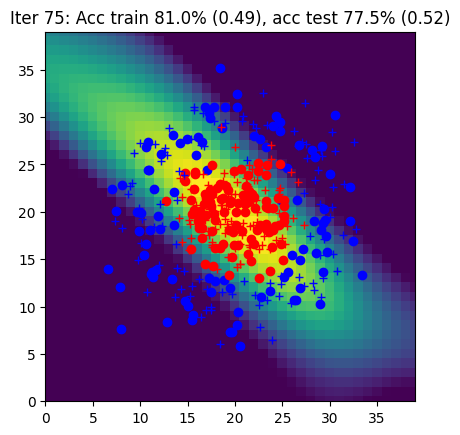

Iter 76: Acc train 81.5% (0.49), acc test 77.0% (0.52)


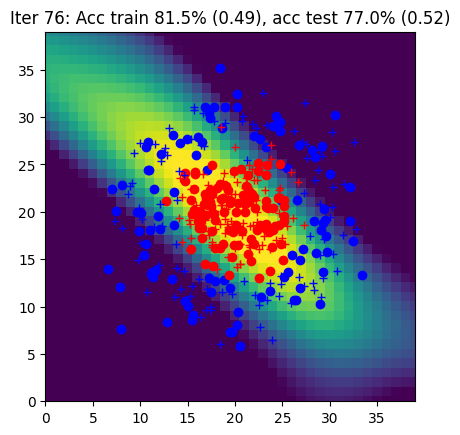

Iter 77: Acc train 82.0% (0.49), acc test 76.5% (0.51)


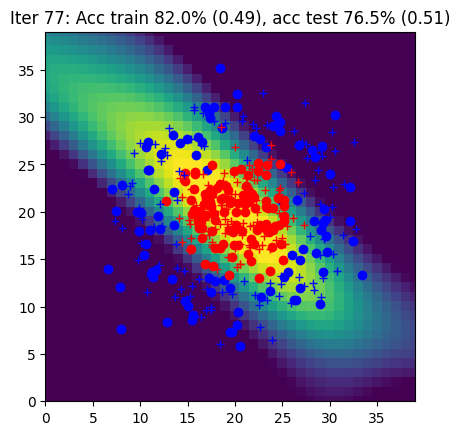

Iter 78: Acc train 81.0% (0.48), acc test 77.5% (0.51)


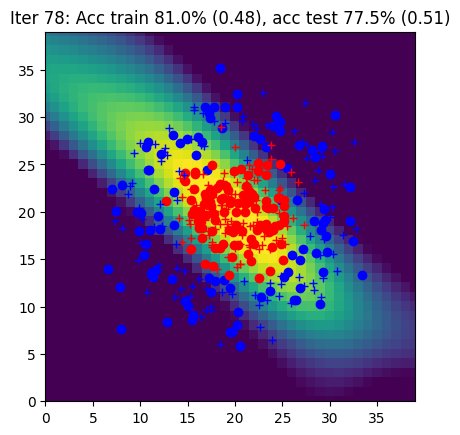

Iter 79: Acc train 81.0% (0.48), acc test 77.5% (0.51)


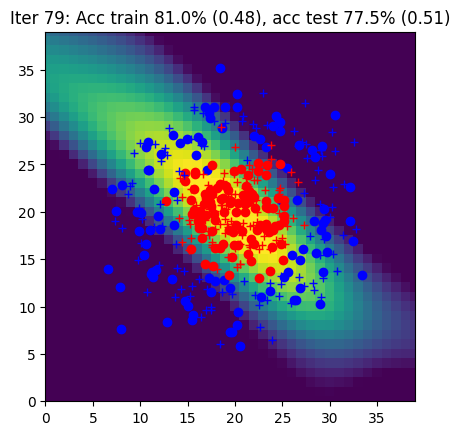

Iter 80: Acc train 81.5% (0.47), acc test 77.5% (0.50)


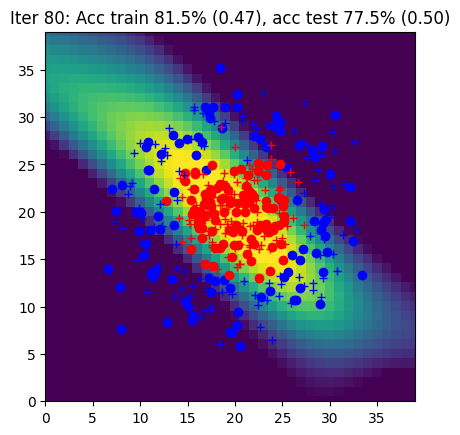

Iter 81: Acc train 81.5% (0.47), acc test 77.0% (0.50)


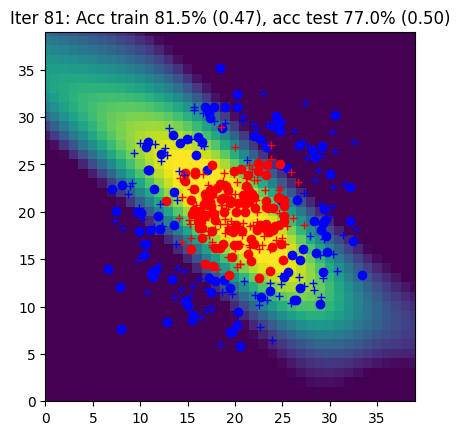

Iter 82: Acc train 81.5% (0.47), acc test 77.0% (0.50)


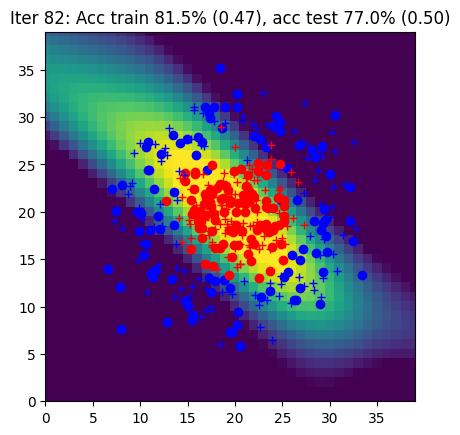

Iter 83: Acc train 82.0% (0.46), acc test 77.0% (0.49)


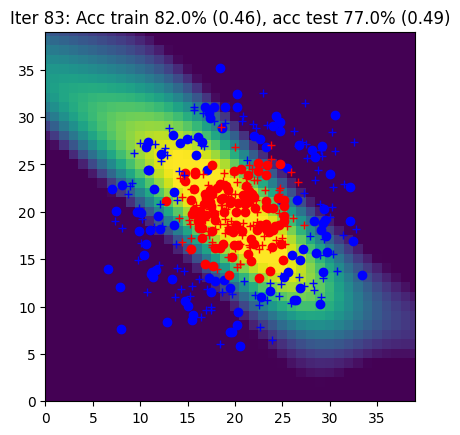

Iter 84: Acc train 82.0% (0.46), acc test 77.5% (0.49)


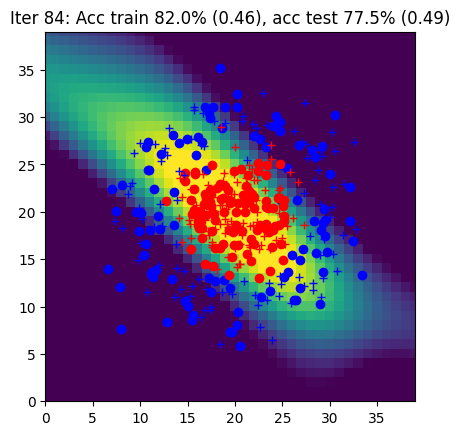

Iter 85: Acc train 81.0% (0.46), acc test 77.5% (0.49)


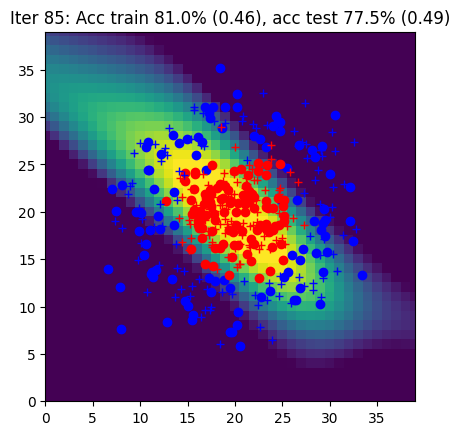

Iter 86: Acc train 81.0% (0.45), acc test 77.5% (0.48)


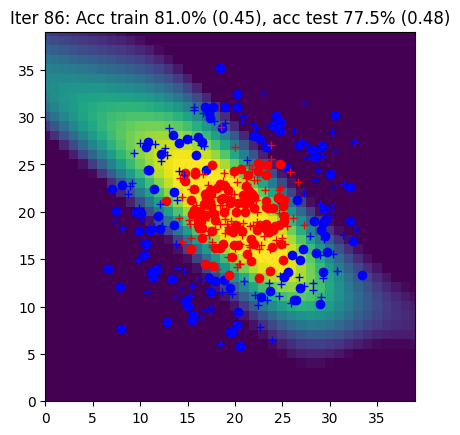

Iter 87: Acc train 81.5% (0.45), acc test 77.0% (0.48)


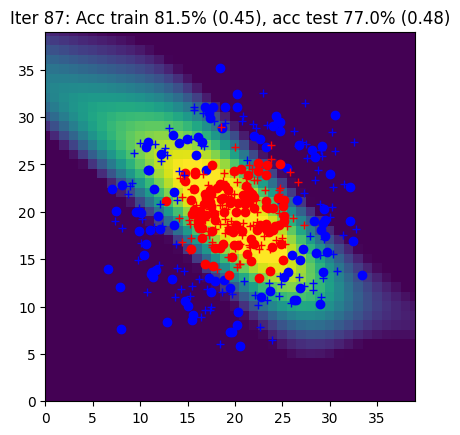

Iter 88: Acc train 81.0% (0.45), acc test 77.5% (0.48)


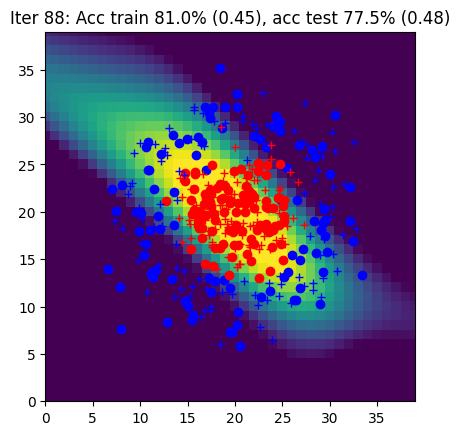

Iter 89: Acc train 81.0% (0.44), acc test 77.5% (0.47)


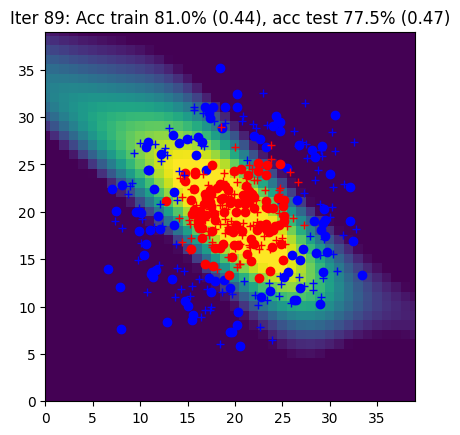

Iter 90: Acc train 81.5% (0.44), acc test 77.5% (0.47)


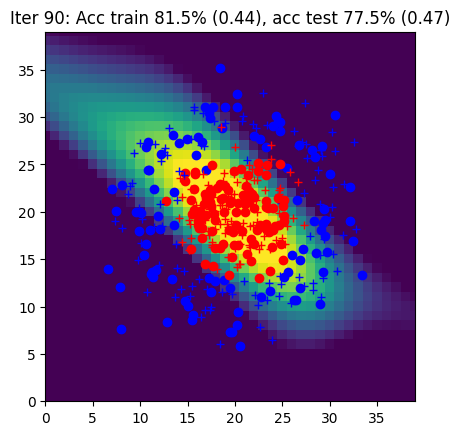

Iter 91: Acc train 81.5% (0.44), acc test 78.0% (0.47)


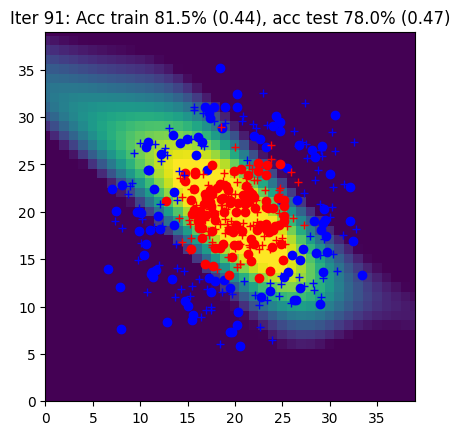

Iter 92: Acc train 82.0% (0.43), acc test 78.0% (0.46)


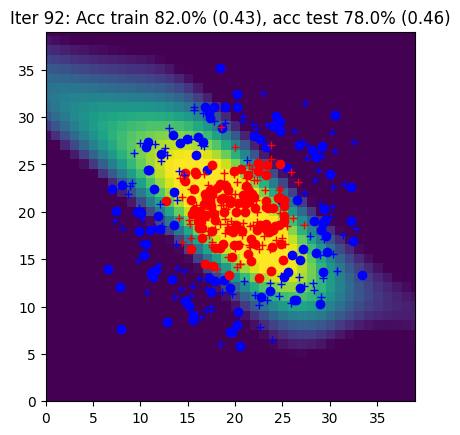

Iter 93: Acc train 82.0% (0.43), acc test 78.0% (0.46)


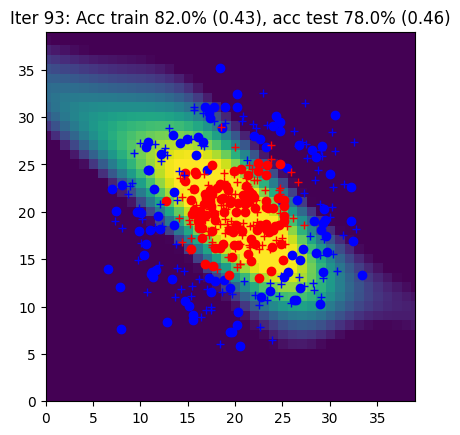

Iter 94: Acc train 82.5% (0.43), acc test 77.0% (0.46)


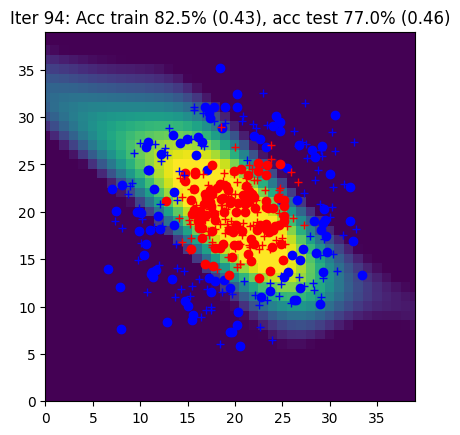

Iter 95: Acc train 82.5% (0.42), acc test 78.0% (0.45)


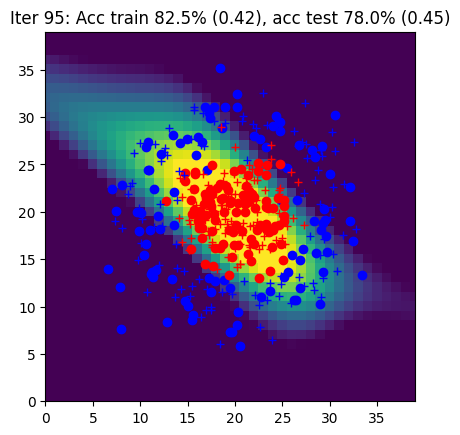

Iter 96: Acc train 82.0% (0.42), acc test 80.0% (0.45)


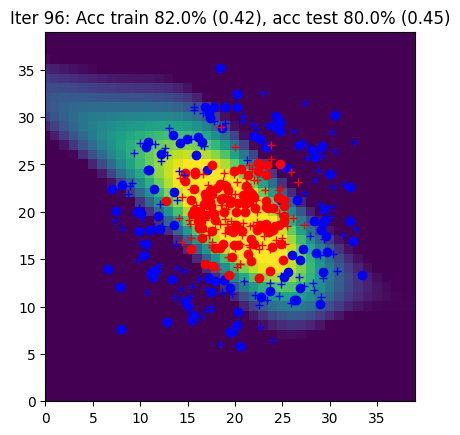

Iter 97: Acc train 84.0% (0.41), acc test 81.0% (0.44)


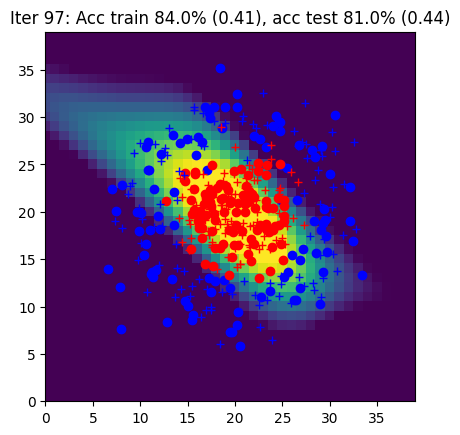

Iter 98: Acc train 83.0% (0.41), acc test 78.5% (0.44)


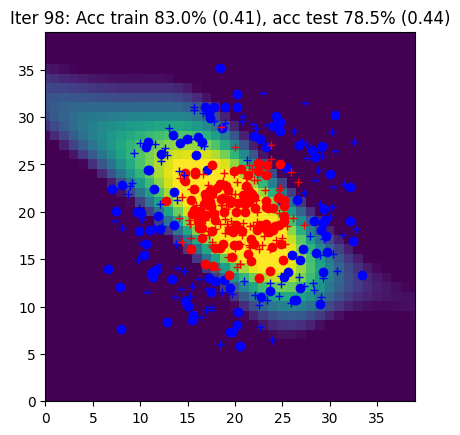

Iter 99: Acc train 83.0% (0.41), acc test 79.5% (0.43)


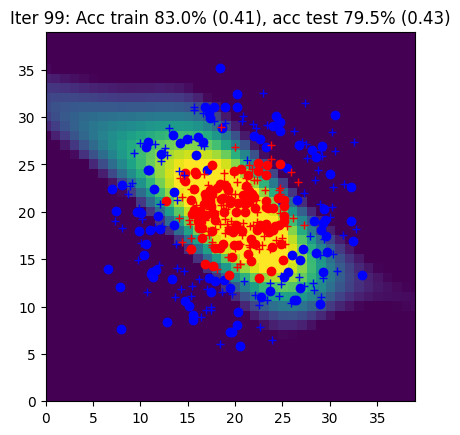

Iter 100: Acc train 84.0% (0.40), acc test 80.5% (0.43)


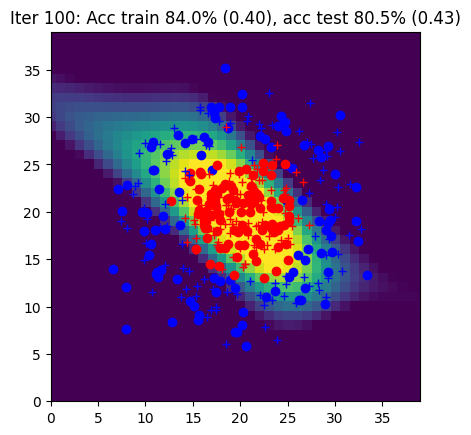

Iter 101: Acc train 84.5% (0.40), acc test 80.0% (0.43)


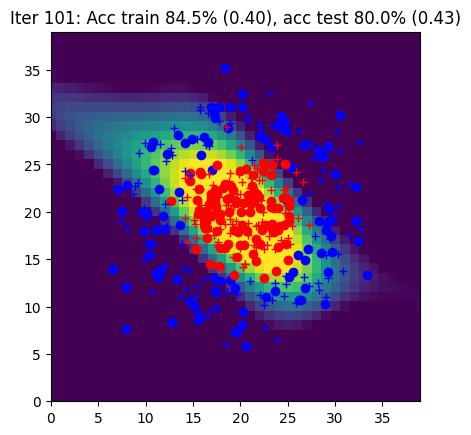

Iter 102: Acc train 84.5% (0.39), acc test 81.0% (0.42)


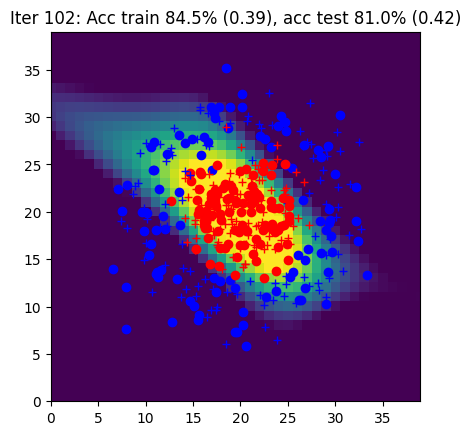

Iter 103: Acc train 84.0% (0.39), acc test 82.5% (0.42)


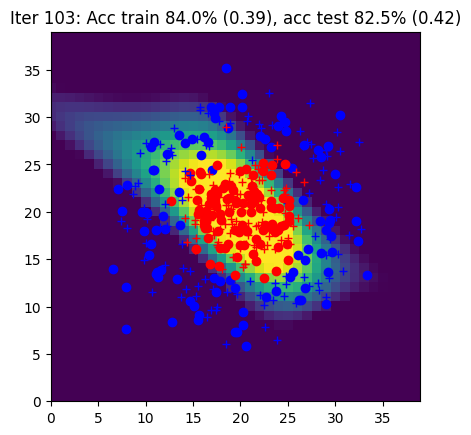

Iter 104: Acc train 84.5% (0.38), acc test 82.5% (0.41)


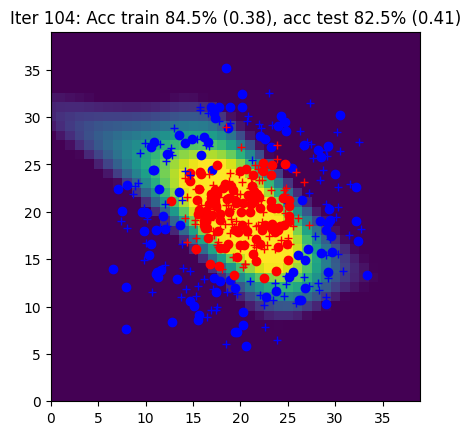

Iter 105: Acc train 85.0% (0.38), acc test 83.0% (0.41)


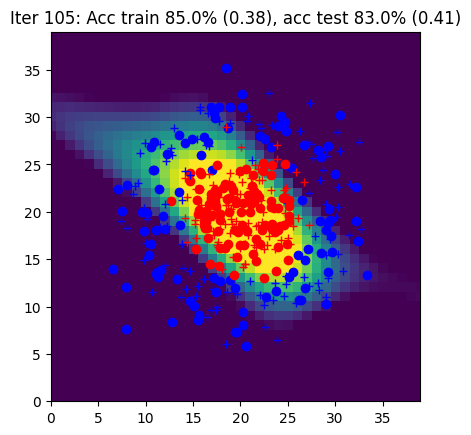

Iter 106: Acc train 84.5% (0.38), acc test 84.0% (0.40)


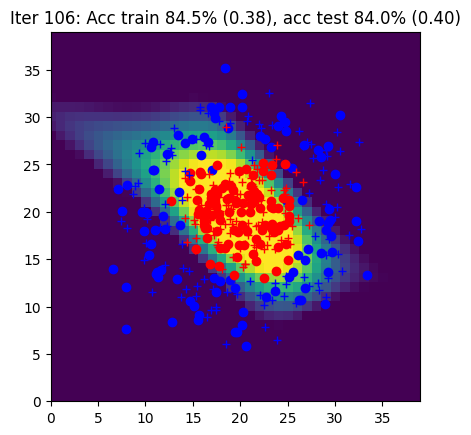

Iter 107: Acc train 87.0% (0.37), acc test 84.5% (0.40)


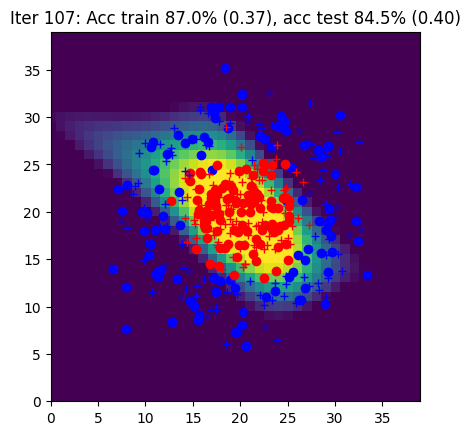

Iter 108: Acc train 87.0% (0.37), acc test 84.5% (0.39)


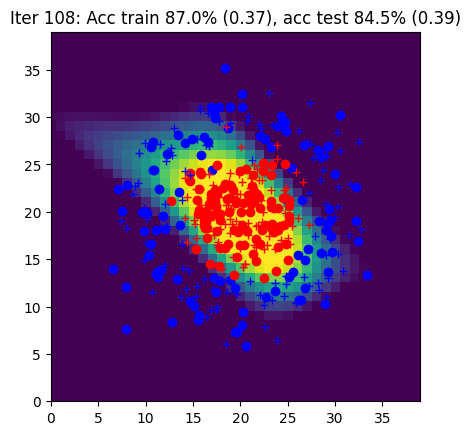

Iter 109: Acc train 87.0% (0.36), acc test 85.5% (0.39)


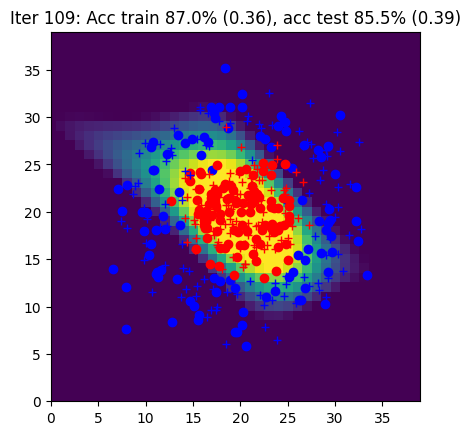

Iter 110: Acc train 89.0% (0.36), acc test 85.0% (0.38)


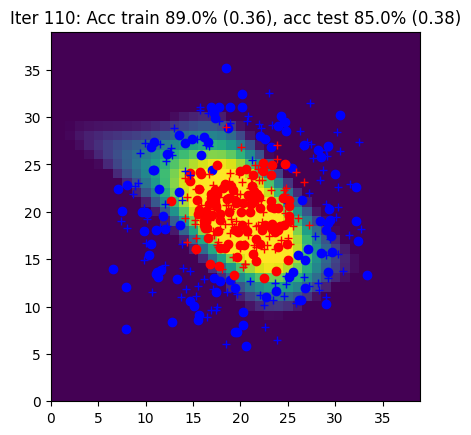

Iter 111: Acc train 88.0% (0.35), acc test 86.5% (0.38)


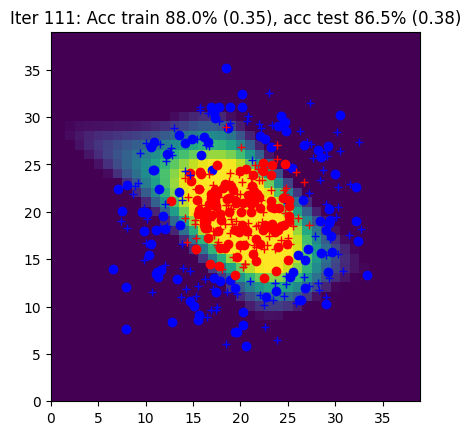

Iter 112: Acc train 89.0% (0.35), acc test 87.5% (0.37)


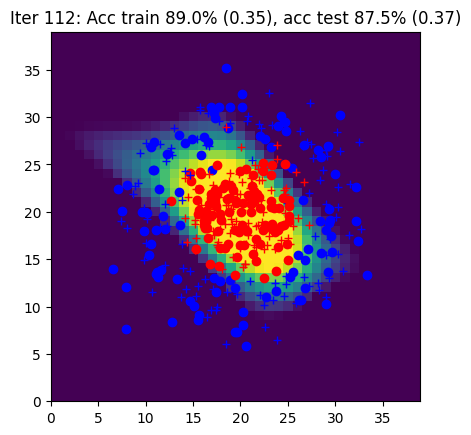

Iter 113: Acc train 89.0% (0.34), acc test 87.5% (0.37)


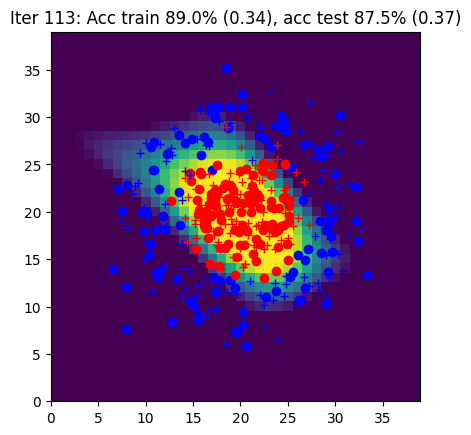

Iter 114: Acc train 90.0% (0.34), acc test 88.0% (0.36)


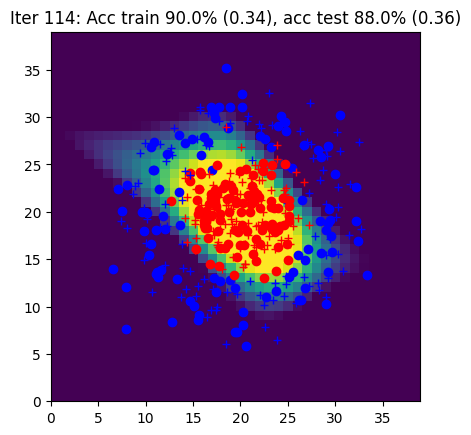

Iter 115: Acc train 90.5% (0.34), acc test 89.0% (0.36)


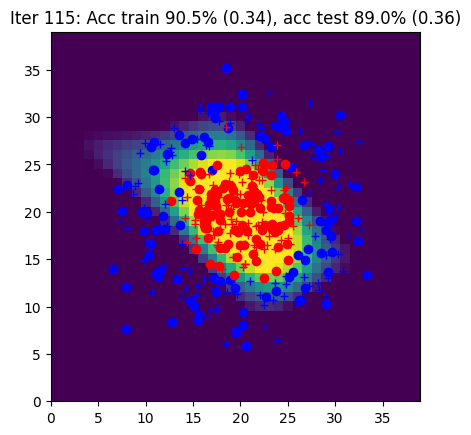

Iter 116: Acc train 91.5% (0.33), acc test 89.0% (0.35)


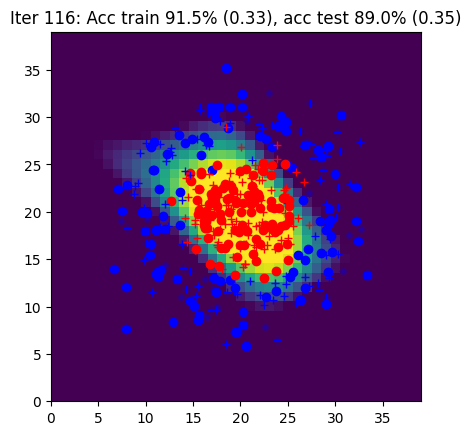

Iter 117: Acc train 91.5% (0.33), acc test 89.5% (0.35)


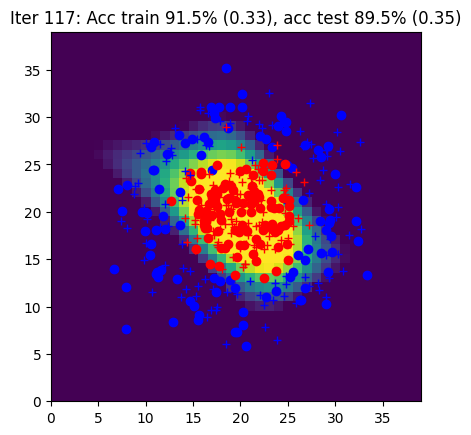

Iter 118: Acc train 91.5% (0.32), acc test 90.5% (0.34)


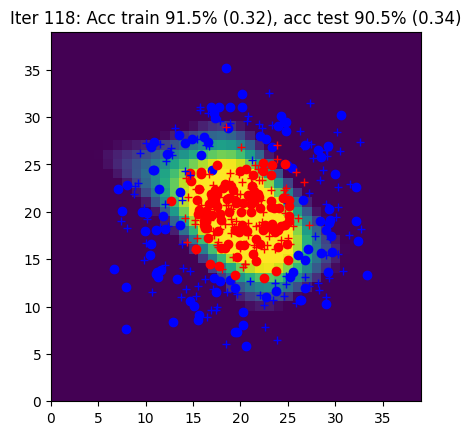

Iter 119: Acc train 92.0% (0.32), acc test 90.5% (0.34)


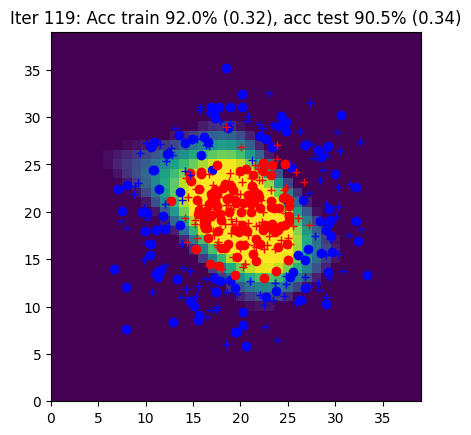

Iter 120: Acc train 92.5% (0.32), acc test 90.5% (0.33)


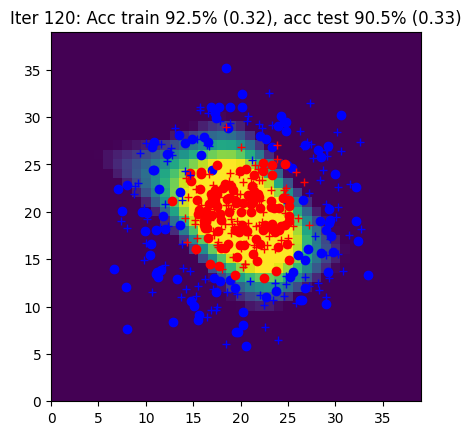

Iter 121: Acc train 92.5% (0.31), acc test 91.0% (0.33)


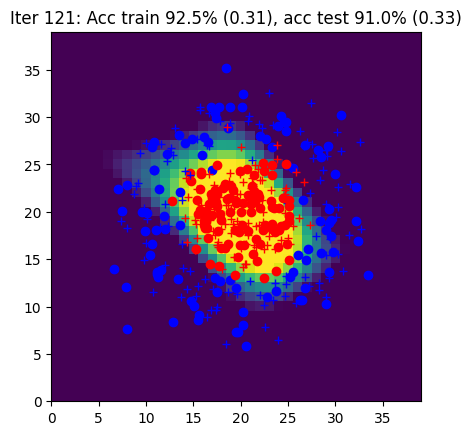

Iter 122: Acc train 93.0% (0.31), acc test 91.5% (0.33)


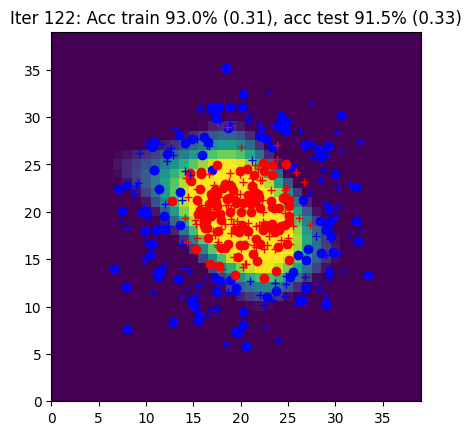

Iter 123: Acc train 93.0% (0.30), acc test 91.5% (0.32)


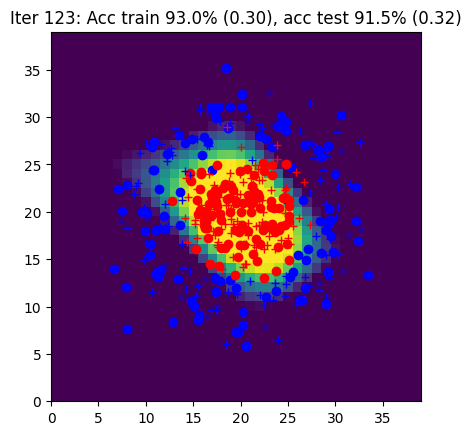

Iter 124: Acc train 93.0% (0.30), acc test 91.5% (0.32)


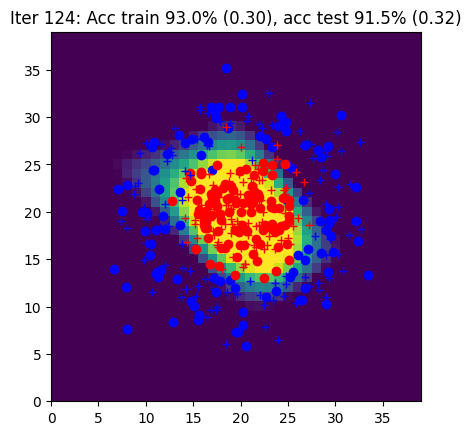

Iter 125: Acc train 93.0% (0.30), acc test 92.0% (0.31)


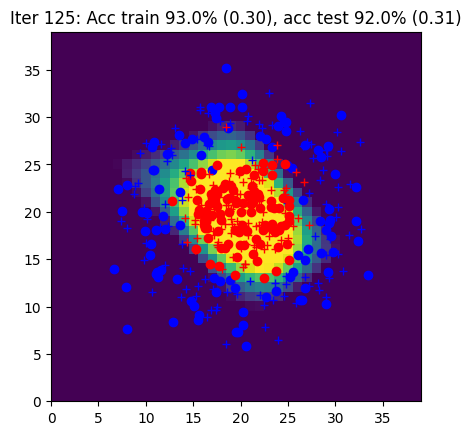

Iter 126: Acc train 93.5% (0.29), acc test 92.5% (0.31)


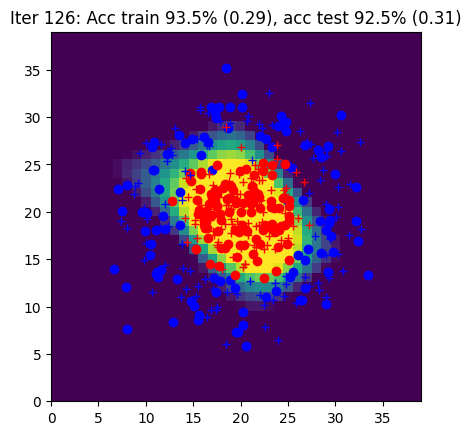

Iter 127: Acc train 94.0% (0.29), acc test 92.5% (0.30)


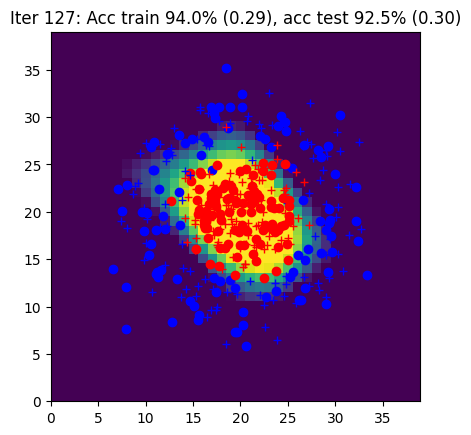

Iter 128: Acc train 94.5% (0.28), acc test 92.5% (0.30)


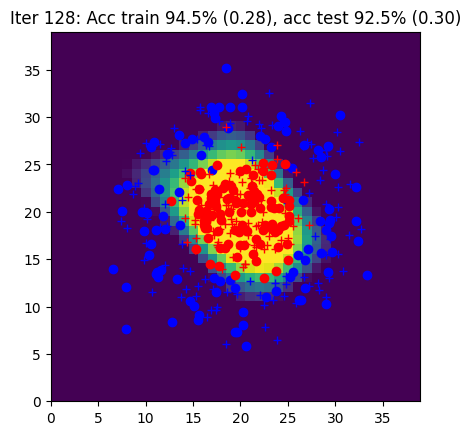

Iter 129: Acc train 94.5% (0.28), acc test 92.5% (0.30)


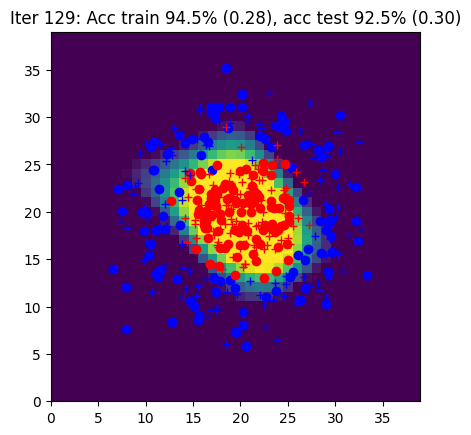

Iter 130: Acc train 95.0% (0.28), acc test 92.5% (0.29)


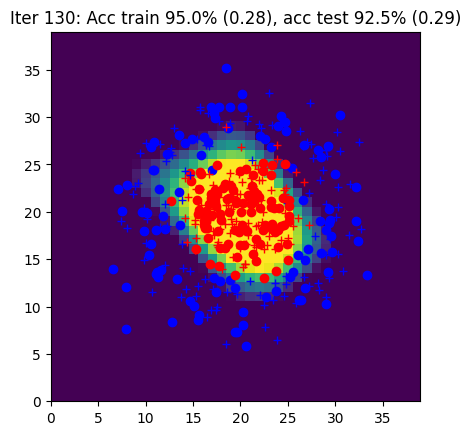

Iter 131: Acc train 95.0% (0.27), acc test 93.0% (0.29)


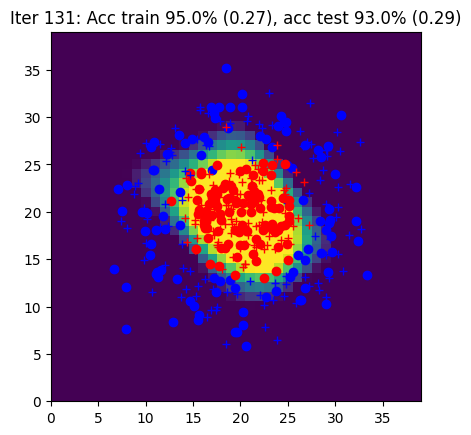

Iter 132: Acc train 95.0% (0.27), acc test 93.0% (0.29)


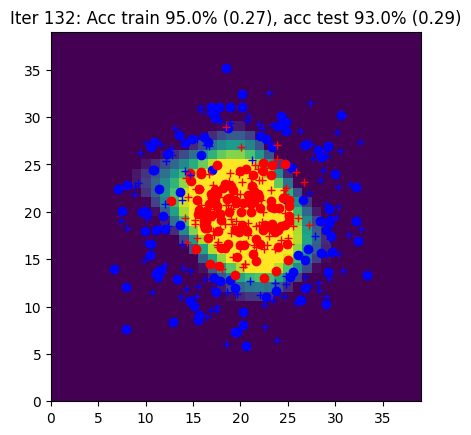

Iter 133: Acc train 95.5% (0.27), acc test 93.0% (0.28)


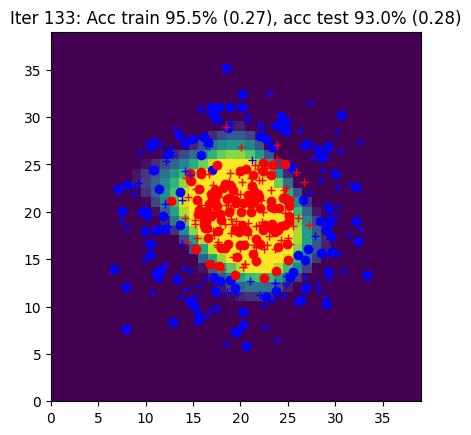

Iter 134: Acc train 96.0% (0.27), acc test 93.0% (0.28)


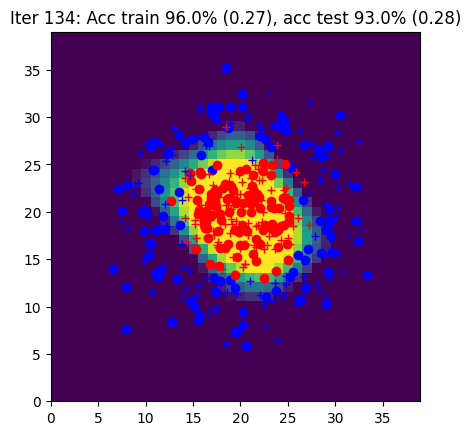

Iter 135: Acc train 96.0% (0.26), acc test 93.5% (0.28)


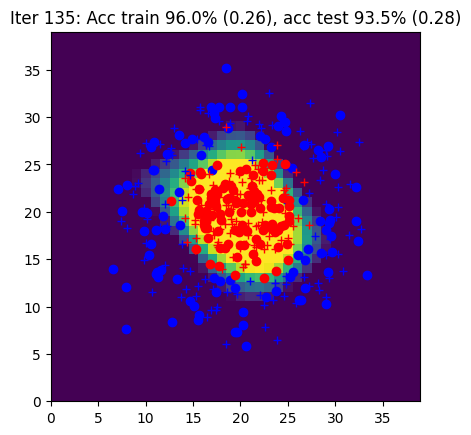

Iter 136: Acc train 96.0% (0.26), acc test 93.5% (0.27)


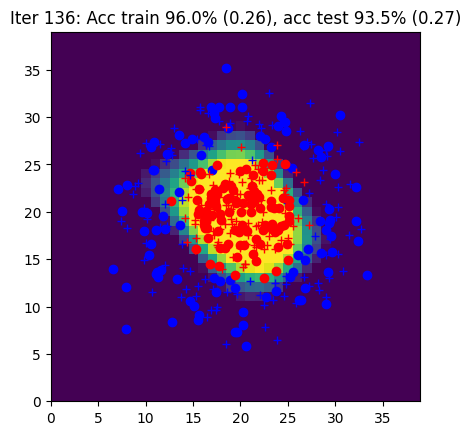

Iter 137: Acc train 95.5% (0.26), acc test 93.5% (0.27)


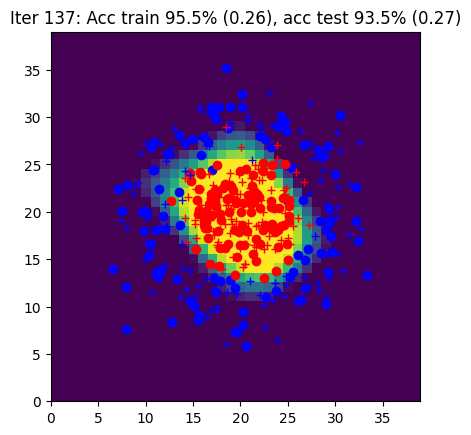

Iter 138: Acc train 96.0% (0.25), acc test 93.5% (0.27)


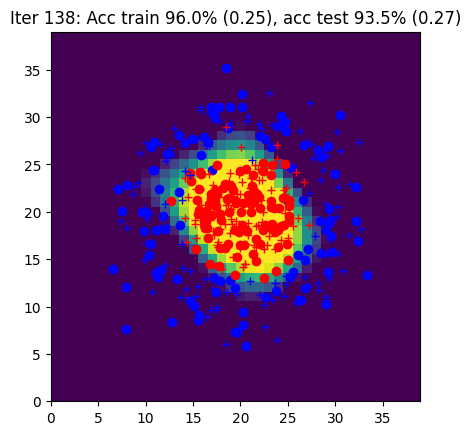

Iter 139: Acc train 96.0% (0.25), acc test 93.5% (0.27)


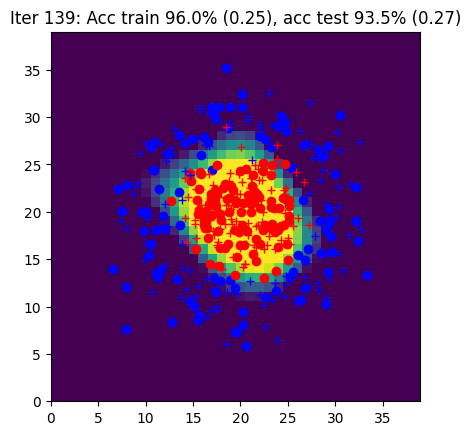

Iter 140: Acc train 96.0% (0.25), acc test 93.5% (0.26)


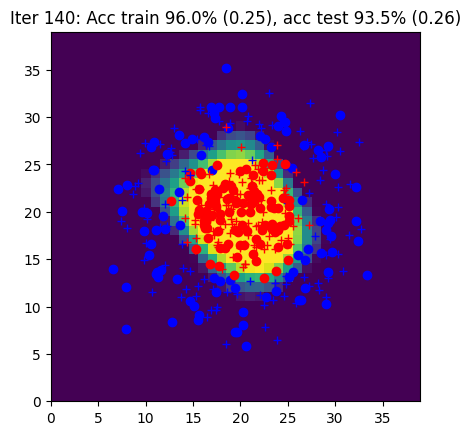

Iter 141: Acc train 96.0% (0.25), acc test 93.5% (0.26)


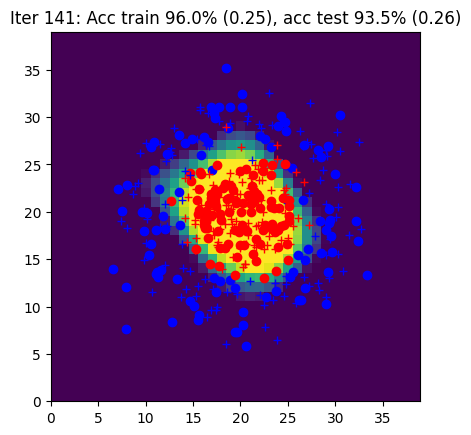

Iter 142: Acc train 96.0% (0.24), acc test 93.5% (0.26)


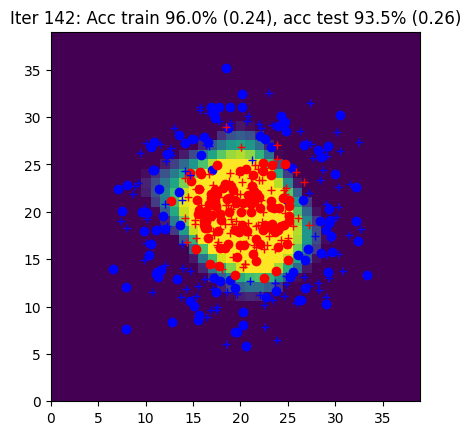

Iter 143: Acc train 96.0% (0.24), acc test 93.5% (0.25)


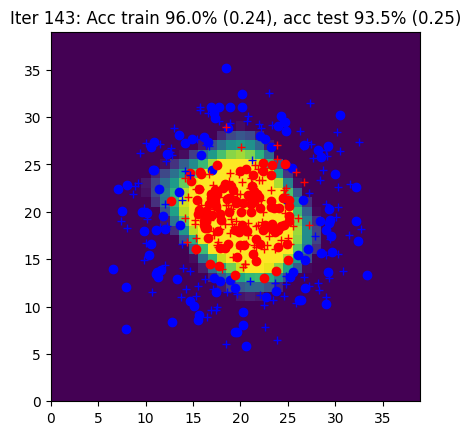

Iter 144: Acc train 96.0% (0.24), acc test 94.0% (0.25)


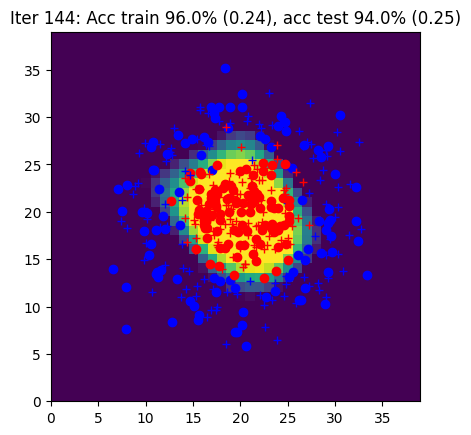

Iter 145: Acc train 96.5% (0.24), acc test 94.0% (0.25)


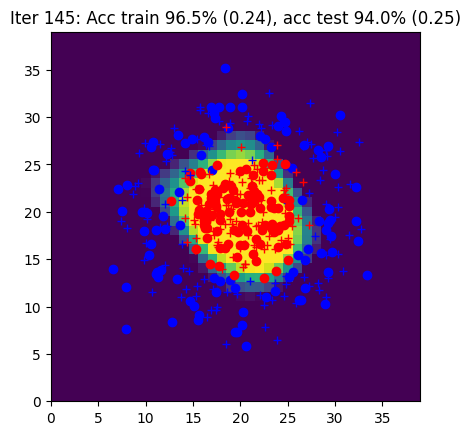

Iter 146: Acc train 96.5% (0.23), acc test 94.0% (0.25)


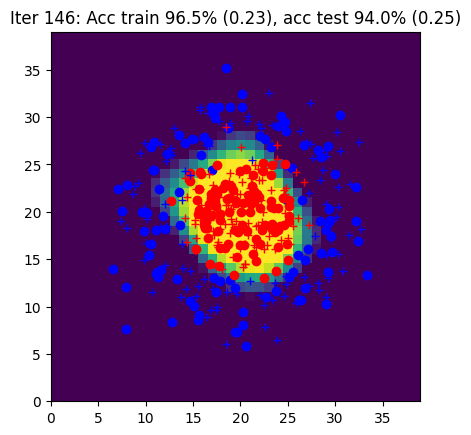

Iter 147: Acc train 96.5% (0.23), acc test 94.0% (0.25)


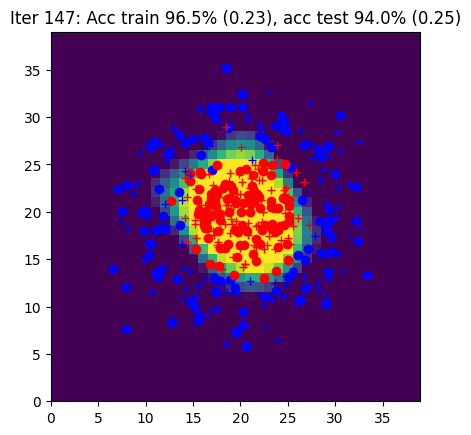

Iter 148: Acc train 96.5% (0.23), acc test 94.0% (0.24)


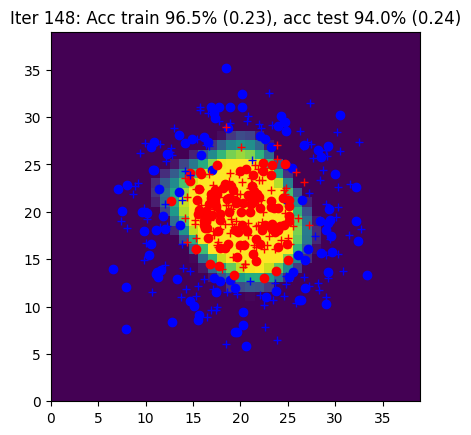

Iter 149: Acc train 96.0% (0.23), acc test 94.0% (0.24)


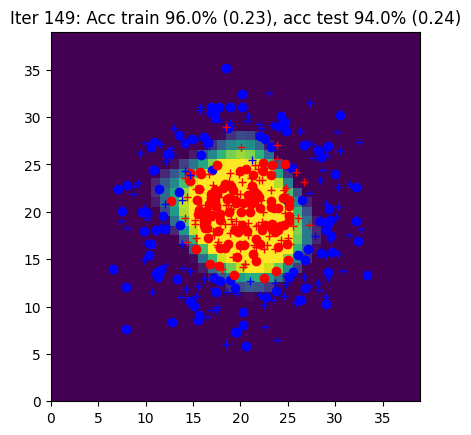

In [19]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

model, loss = init_model(nx, nh, ny)

curves = [[], [], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code here  ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j + 1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # write the optimization algorithm on the batch (X,Y)
        # using the functions: loss_accuracy, sgd
        # the forward with the predict method from the model
        # and the backward function with autograd
        
        yhat = model(X)
        
        # calculate loss and accuracy
        L, acc = loss_accuracy(loss, yhat, Y)
        
        # backward propagation to compute gradients
        L.backward()
        
        # update parameters using SGD
        model = sgd(model, eta)

    ####################
    ##      END        #
    ####################

    Yhat_train = model(data.Xtrain)
    Yhat_test = model(data.Xtest)
    Ltrain, acctrain = loss_accuracy(loss, Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(loss, Yhat_test, data.Ytest)
    Ygrid = model(data.Xgrid)

    title = "Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})".format(
        iteration, acctrain, Ltrain, acctest, Ltest
    )
    print(title)
    data.plot_data_with_grid(torch.nn.Softmax(dim=1)(Ygrid.detach()), title)

    curves[0].append(acctrain.detach().item())
    curves[1].append(acctest.detach().item())
    curves[2].append(Ltrain.detach().item())
    curves[3].append(Ltest.detach().item())


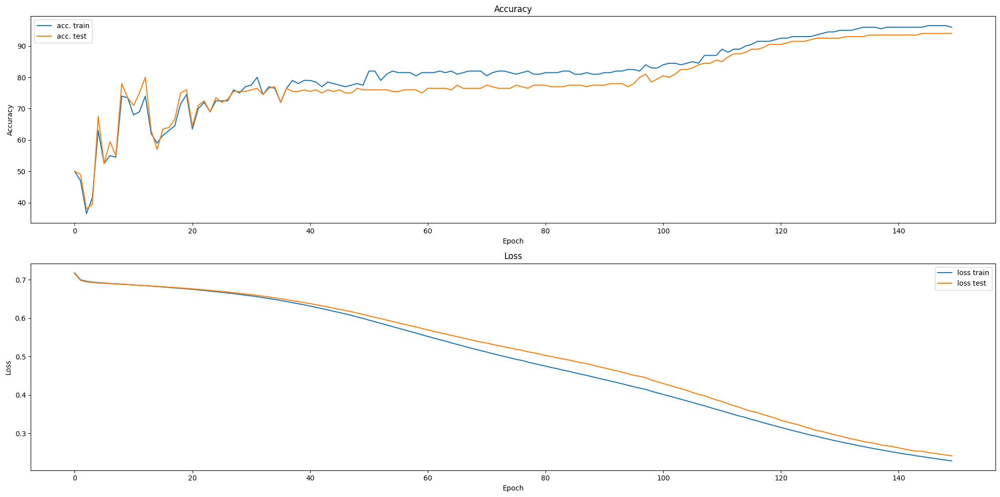

In [20]:
# Create subplots: 2 row, 1 columns
fig, axs = plt.subplots(2, 1, figsize=(20, 10))

# Plot accuracy curves on the first subplot
axs[0].plot(curves[0], label="acc. train")
axs[0].plot(curves[1], label="acc. test")
axs[0].set_title('Accuracy')
axs[0].set_xlabel('Epoch')
axs[0].set_ylabel('Accuracy')
axs[0].legend()

# Plot loss curves on the second subplot
axs[1].plot(curves[2], label="loss train")
axs[1].plot(curves[3], label="loss test")
axs[1].set_title('Loss')
axs[1].set_xlabel('Epoch')
axs[1].set_ylabel('Loss')
axs[1].legend()

# Show the plot
plt.tight_layout()
plt.show()

# Part 4 : Simplification of the SGD with `torch.optim`

In [21]:
def init_model(nx, nh, ny, eta):

    #####################
    ## Your code here  ##
    #####################

    model = torch.nn.Sequential(
        torch.nn.Linear(nx, nh),
        torch.nn.Tanh(),
        torch.nn.Linear(nh, ny)
    )

    loss = torch.nn.CrossEntropyLoss()
    optim = torch.optim.SGD(model.parameters(), lr=eta)

    ####################
    ##      END        #
    ####################

    return model, loss, optim

The `sgd` function is replaced by calling the `optim.zero_grad()` before the backward and `optim.step()` after.

## Algorithme global d'apprentissage (avec autograd, les couches `torch.nn` et `torch.optim`)

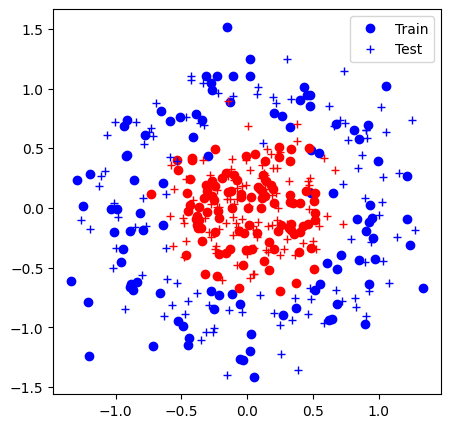

Iter 0: Acc train 50.0% (0.71), acc test 50.0% (0.71)


/home/hyraeth/.local/lib/python3.10/site-packages/torch/nn/modules/module.py:1553: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  return self._call_impl(*args, **kwargs)


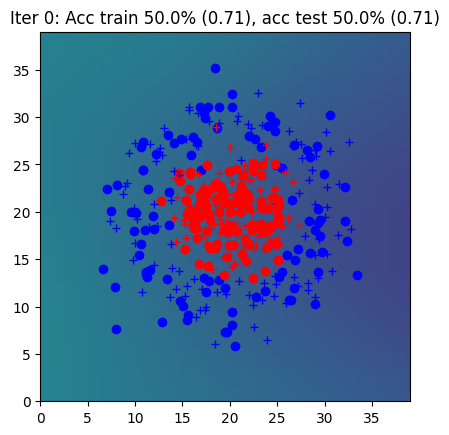

Iter 1: Acc train 48.0% (0.70), acc test 49.5% (0.70)


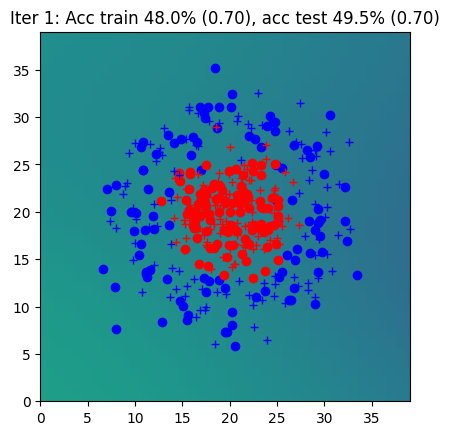

Iter 2: Acc train 64.5% (0.69), acc test 61.5% (0.69)


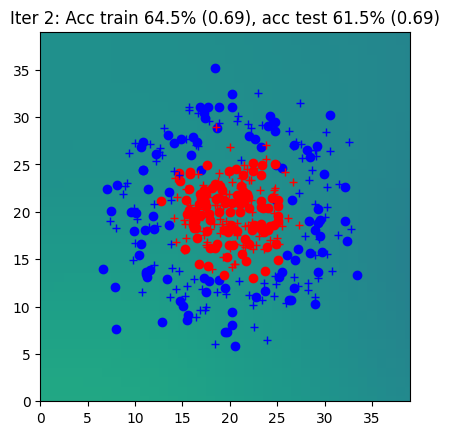

Iter 3: Acc train 52.0% (0.69), acc test 51.0% (0.69)


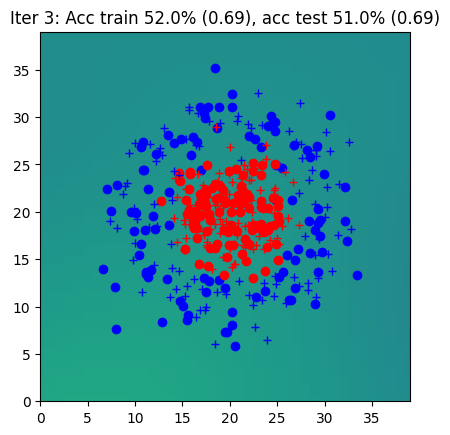

Iter 4: Acc train 59.0% (0.69), acc test 58.0% (0.69)


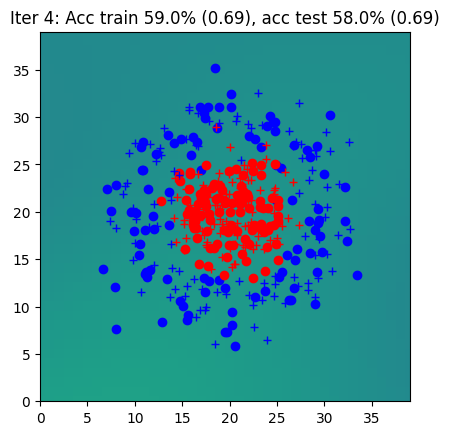

Iter 5: Acc train 62.5% (0.69), acc test 63.5% (0.69)


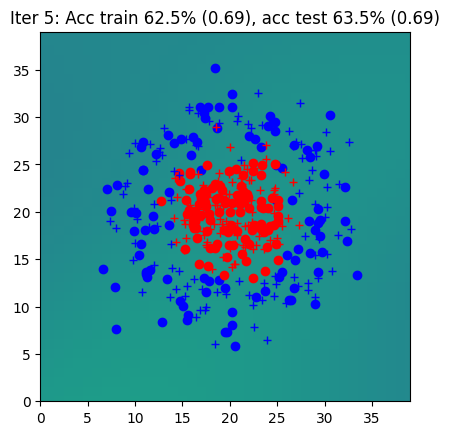

Iter 6: Acc train 52.0% (0.69), acc test 51.0% (0.69)


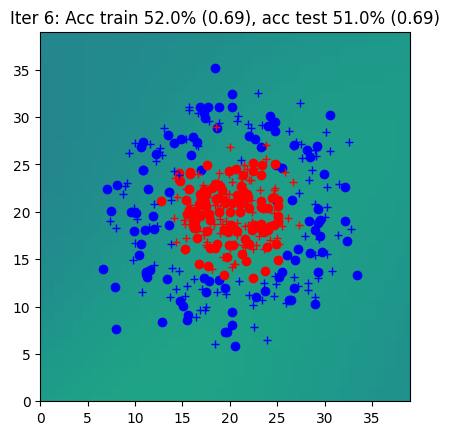

Iter 7: Acc train 55.5% (0.69), acc test 58.0% (0.69)


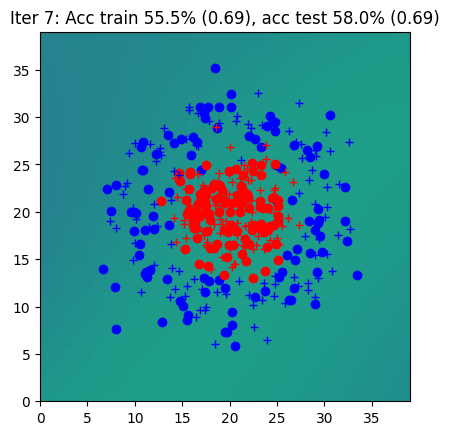

Iter 8: Acc train 58.0% (0.69), acc test 58.5% (0.69)


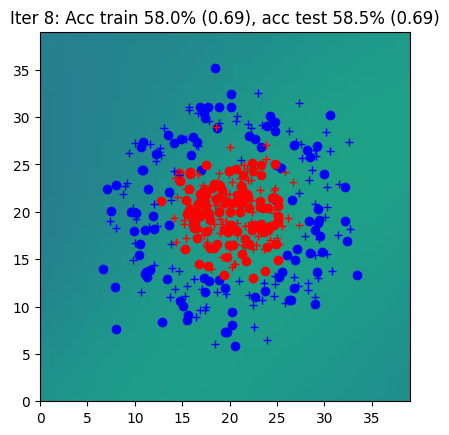

Iter 9: Acc train 60.0% (0.69), acc test 61.0% (0.69)


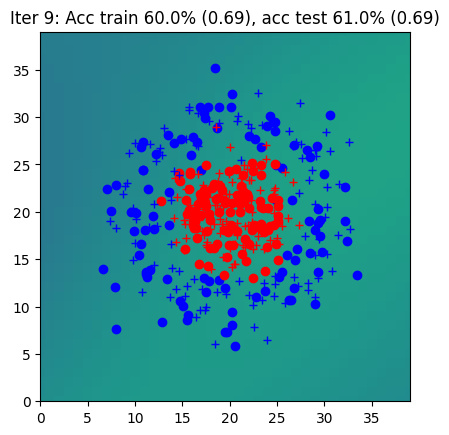

Iter 10: Acc train 58.5% (0.69), acc test 59.0% (0.69)


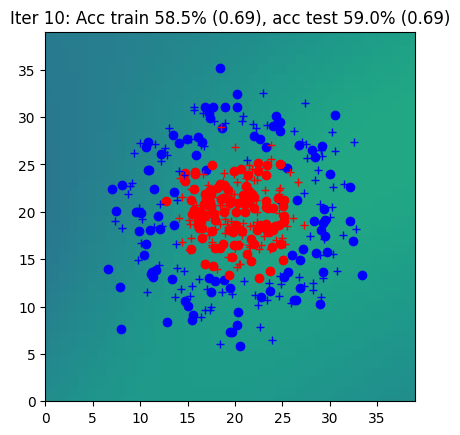

Iter 11: Acc train 62.0% (0.69), acc test 61.5% (0.69)


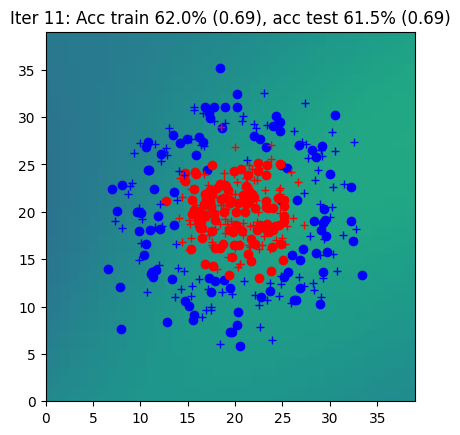

Iter 12: Acc train 63.0% (0.69), acc test 62.5% (0.69)


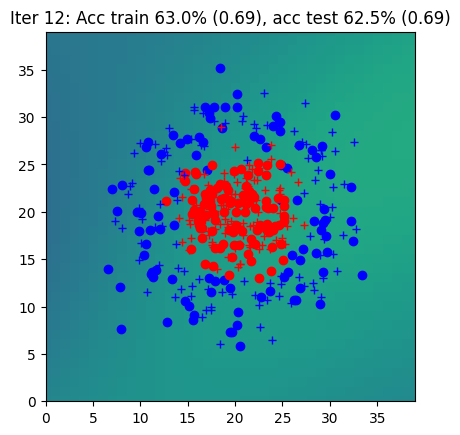

Iter 13: Acc train 61.5% (0.68), acc test 61.0% (0.69)


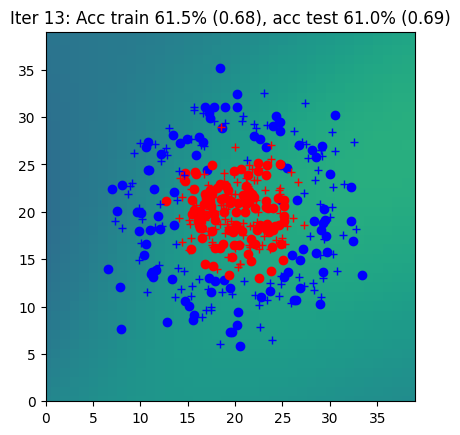

Iter 14: Acc train 62.0% (0.68), acc test 62.0% (0.69)


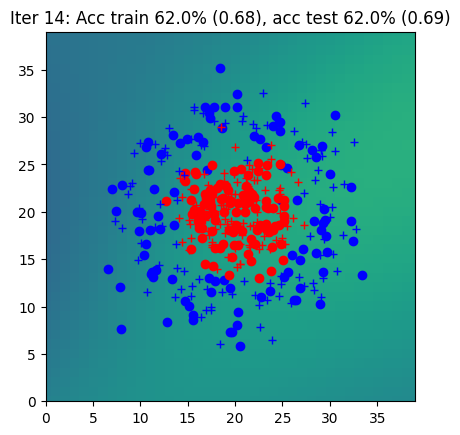

Iter 15: Acc train 66.0% (0.68), acc test 63.5% (0.68)


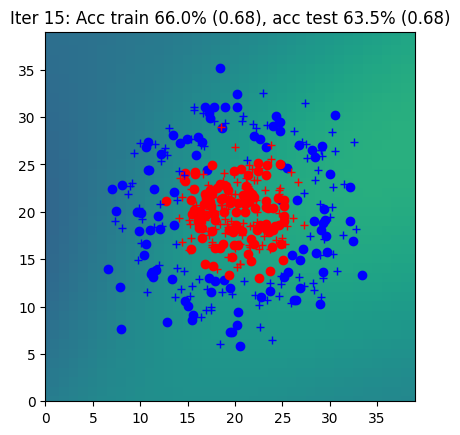

Iter 16: Acc train 69.0% (0.68), acc test 65.5% (0.68)


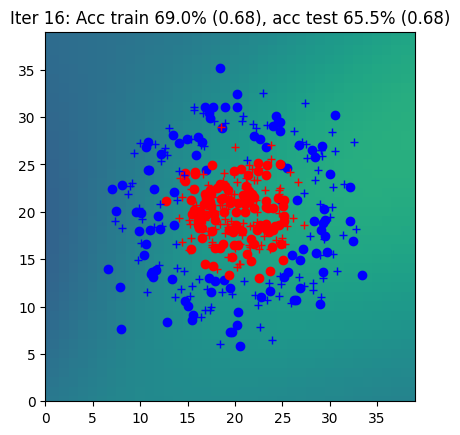

Iter 17: Acc train 70.5% (0.68), acc test 66.5% (0.68)


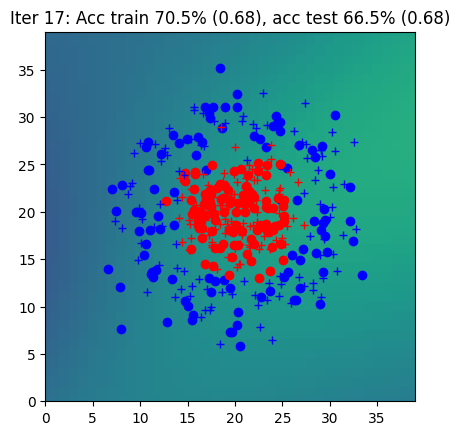

Iter 18: Acc train 69.0% (0.68), acc test 66.5% (0.68)


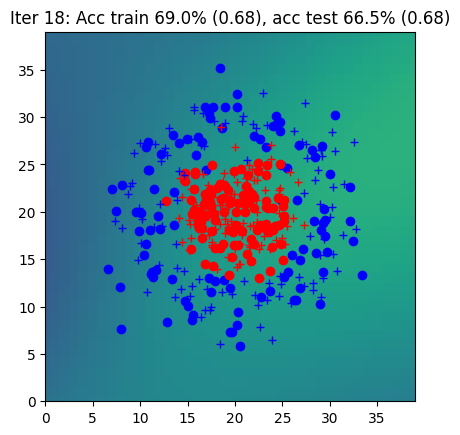

Iter 19: Acc train 69.5% (0.68), acc test 66.5% (0.68)


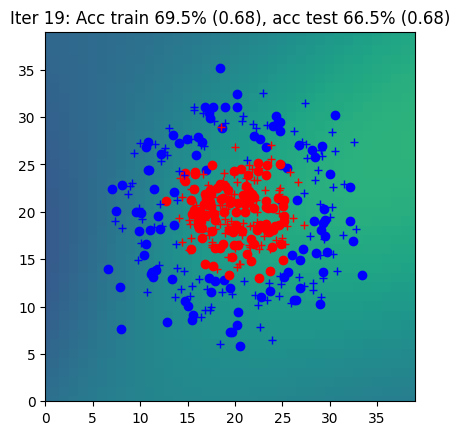

Iter 20: Acc train 71.0% (0.68), acc test 67.0% (0.68)


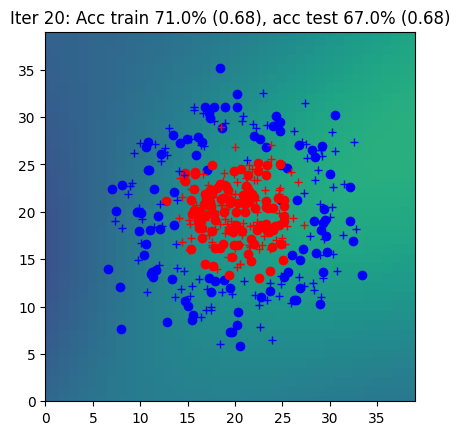

Iter 21: Acc train 70.5% (0.68), acc test 68.0% (0.68)


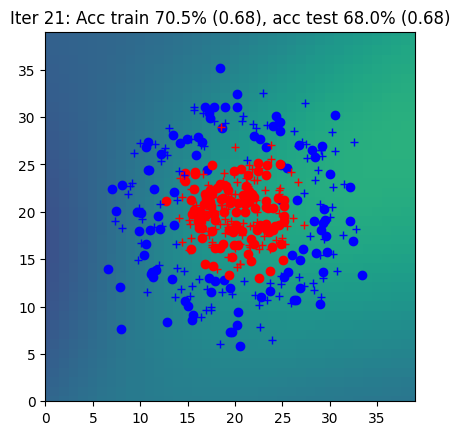

Iter 22: Acc train 71.5% (0.68), acc test 67.0% (0.68)


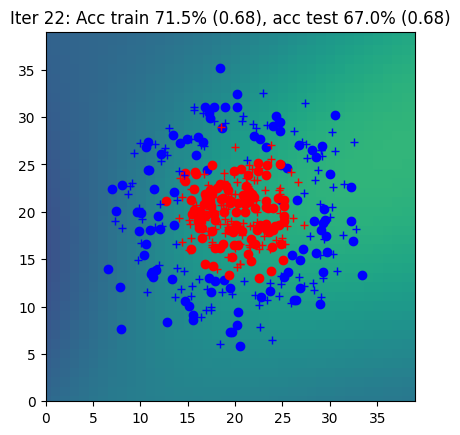

Iter 23: Acc train 72.5% (0.68), acc test 69.5% (0.68)


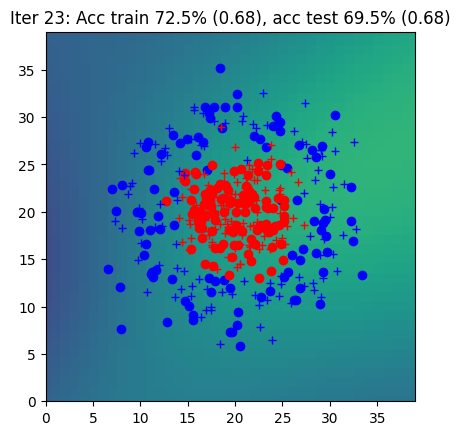

Iter 24: Acc train 73.0% (0.68), acc test 71.0% (0.68)


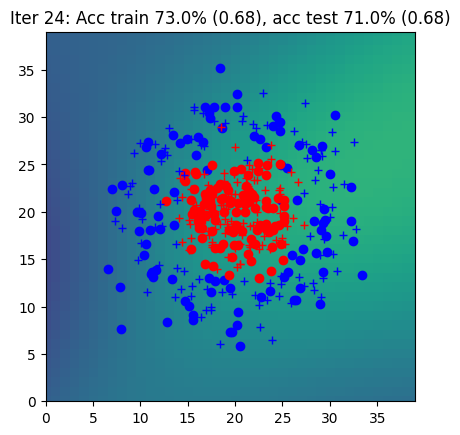

Iter 25: Acc train 72.5% (0.67), acc test 71.0% (0.68)


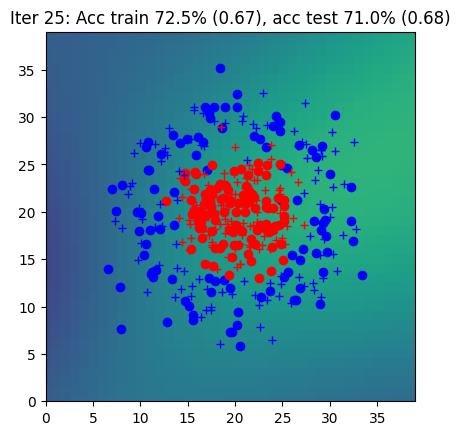

Iter 26: Acc train 73.0% (0.67), acc test 71.0% (0.68)


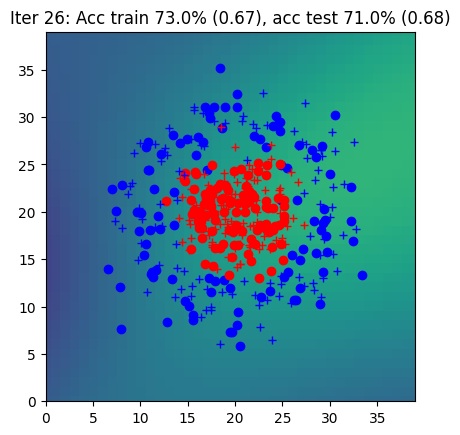

Iter 27: Acc train 72.5% (0.67), acc test 70.5% (0.67)


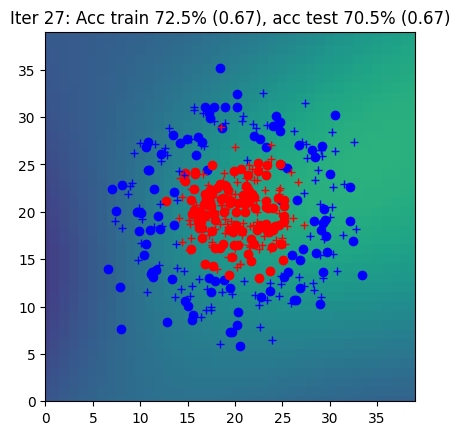

Iter 28: Acc train 74.0% (0.67), acc test 71.5% (0.67)


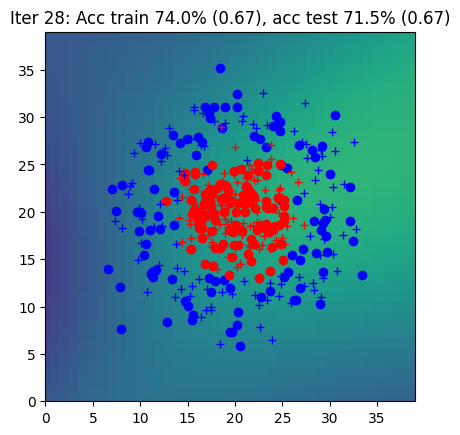

Iter 29: Acc train 74.5% (0.67), acc test 72.0% (0.67)


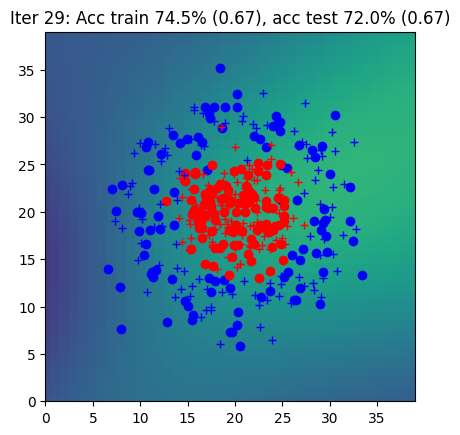

Iter 30: Acc train 75.0% (0.67), acc test 72.0% (0.67)


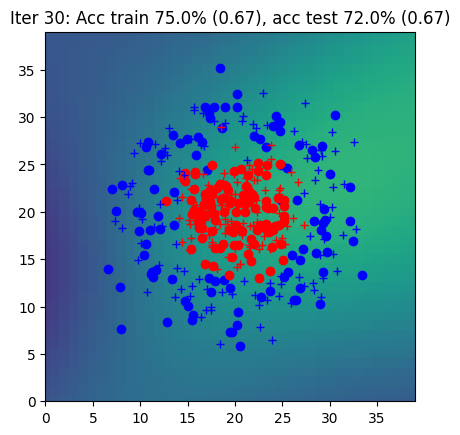

Iter 31: Acc train 74.0% (0.67), acc test 72.0% (0.67)


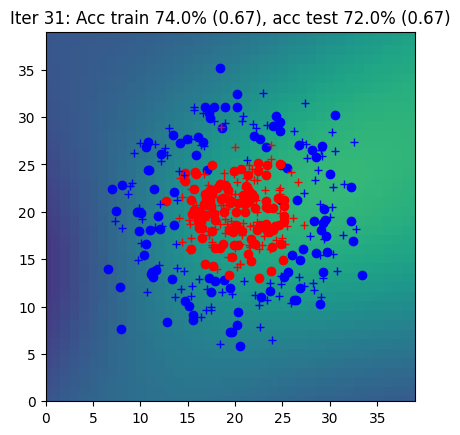

Iter 32: Acc train 74.5% (0.67), acc test 74.0% (0.67)


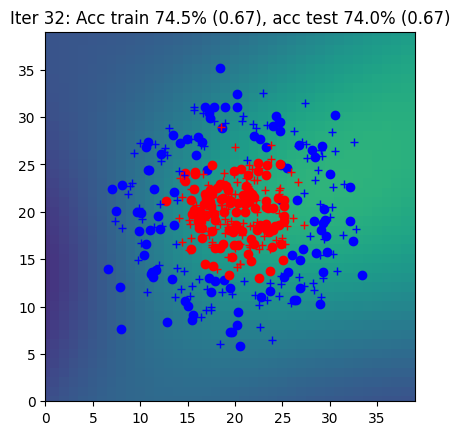

Iter 33: Acc train 75.0% (0.66), acc test 72.0% (0.67)


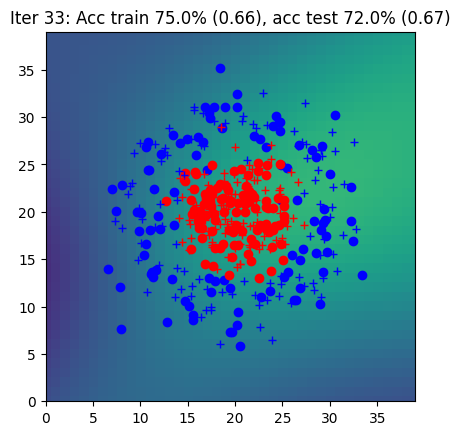

Iter 34: Acc train 76.5% (0.66), acc test 75.0% (0.67)


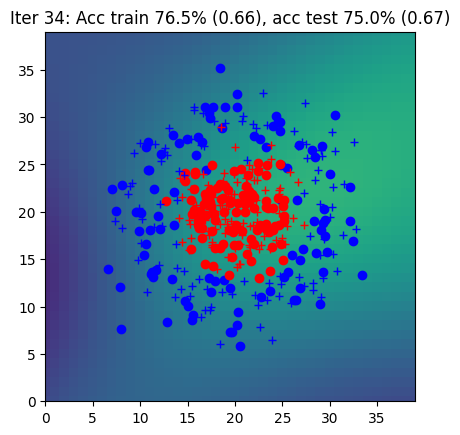

Iter 35: Acc train 78.0% (0.66), acc test 75.0% (0.66)


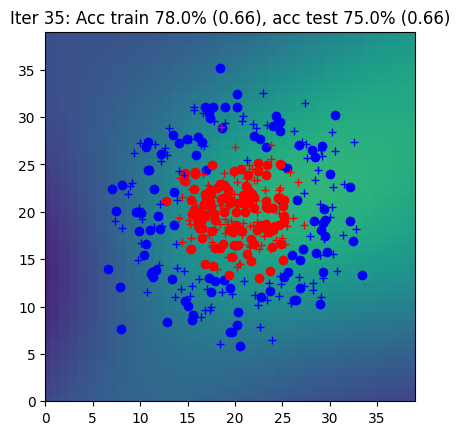

Iter 36: Acc train 75.5% (0.66), acc test 72.0% (0.66)


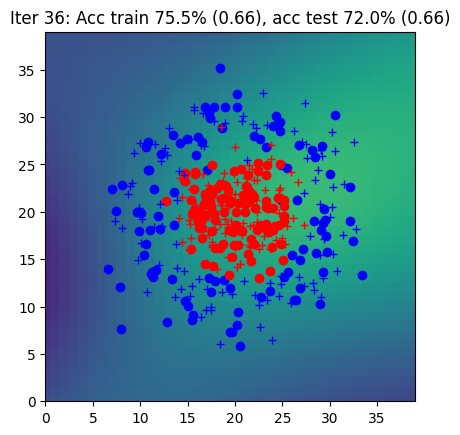

Iter 37: Acc train 75.5% (0.66), acc test 73.0% (0.66)


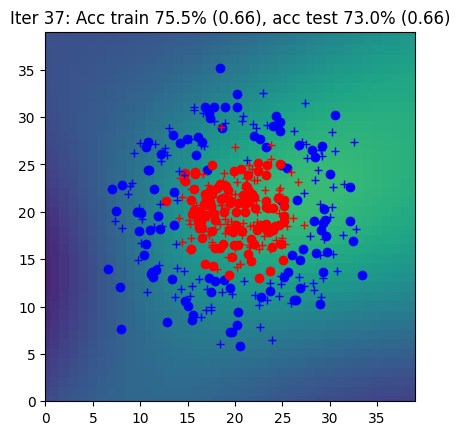

Iter 38: Acc train 75.0% (0.66), acc test 72.5% (0.66)


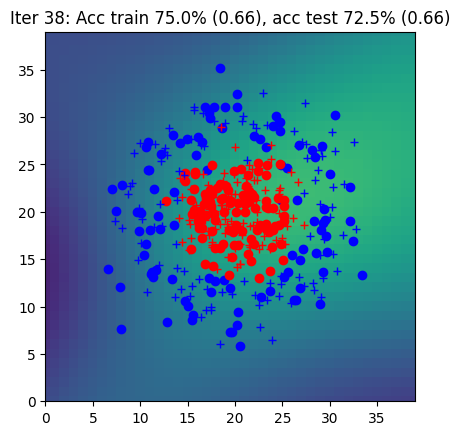

Iter 39: Acc train 75.0% (0.66), acc test 73.0% (0.66)


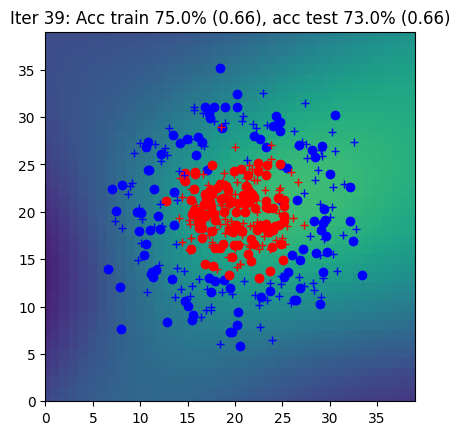

Iter 40: Acc train 75.0% (0.65), acc test 72.5% (0.66)


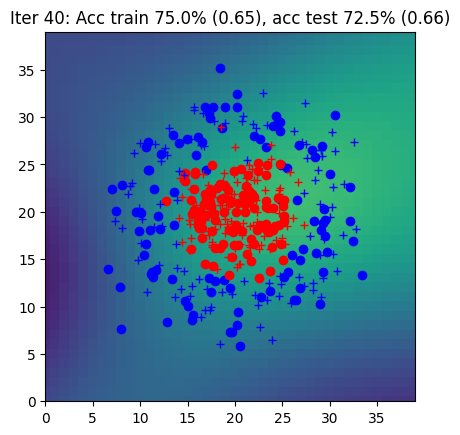

Iter 41: Acc train 76.5% (0.65), acc test 77.0% (0.65)


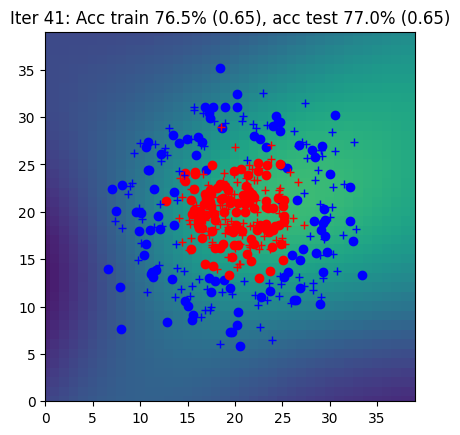

Iter 42: Acc train 77.0% (0.65), acc test 77.5% (0.65)


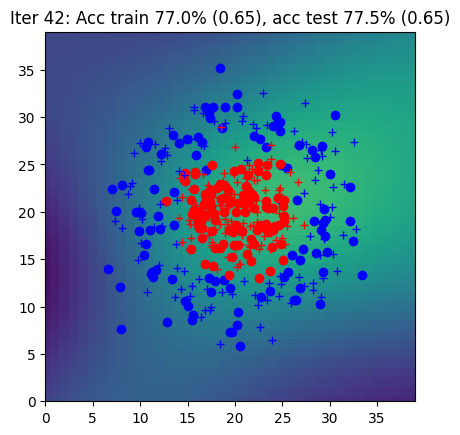

Iter 43: Acc train 75.5% (0.65), acc test 75.0% (0.65)


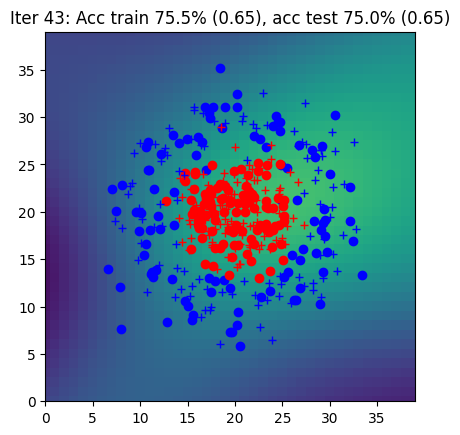

Iter 44: Acc train 80.5% (0.65), acc test 81.0% (0.65)


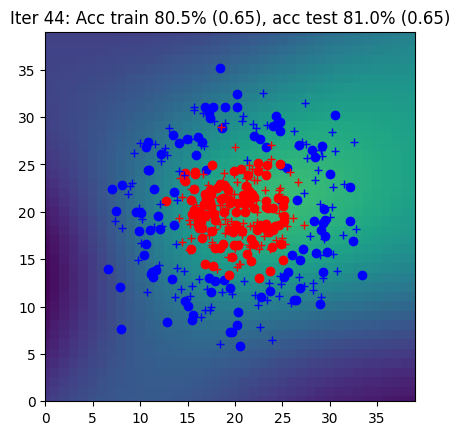

Iter 45: Acc train 78.0% (0.64), acc test 78.0% (0.65)


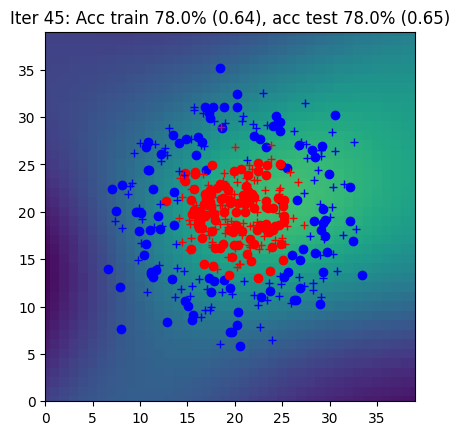

Iter 46: Acc train 80.0% (0.64), acc test 81.0% (0.64)


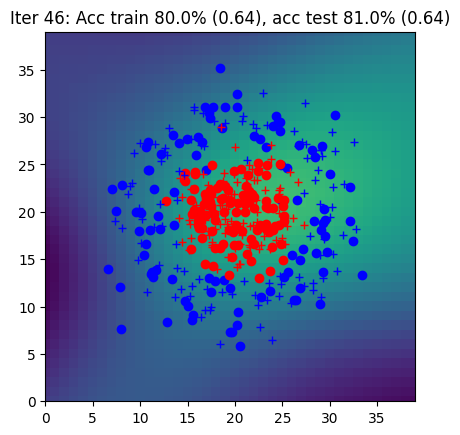

Iter 47: Acc train 80.5% (0.64), acc test 82.0% (0.64)


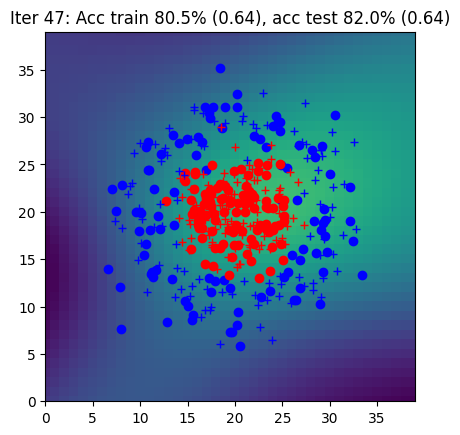

Iter 48: Acc train 79.5% (0.64), acc test 81.5% (0.64)


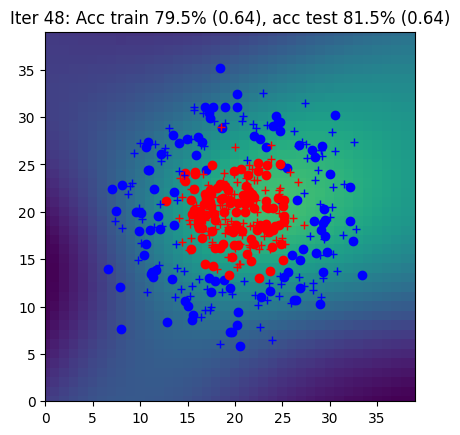

Iter 49: Acc train 78.5% (0.63), acc test 79.0% (0.64)


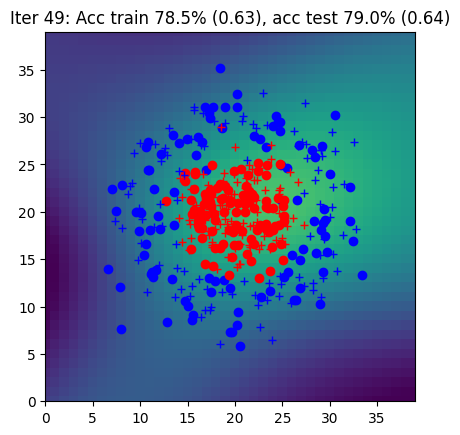

Iter 50: Acc train 78.5% (0.63), acc test 81.0% (0.63)


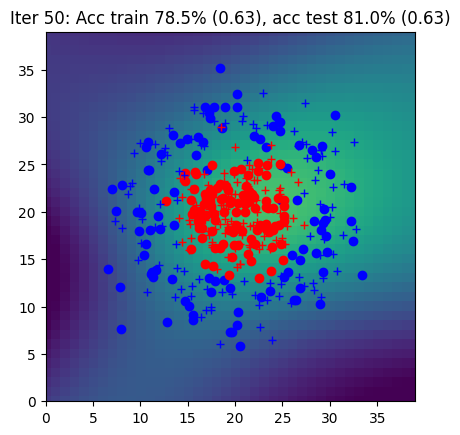

Iter 51: Acc train 79.5% (0.63), acc test 81.0% (0.63)


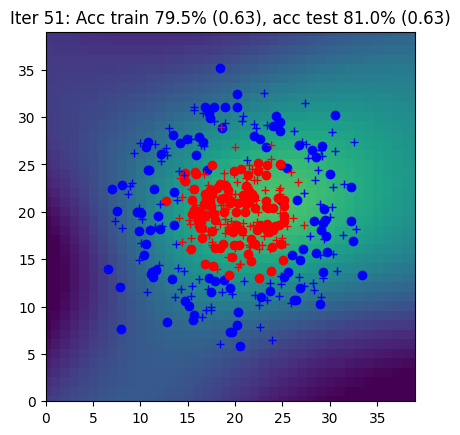

Iter 52: Acc train 79.0% (0.62), acc test 80.5% (0.63)


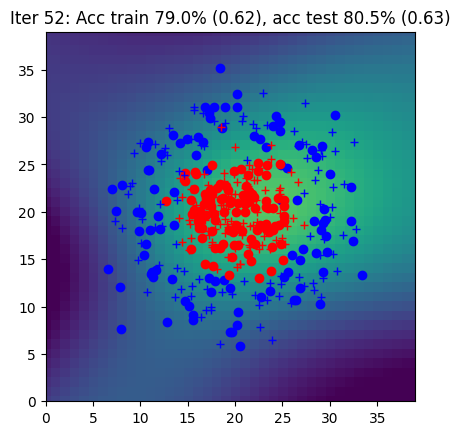

Iter 53: Acc train 79.5% (0.62), acc test 78.5% (0.62)


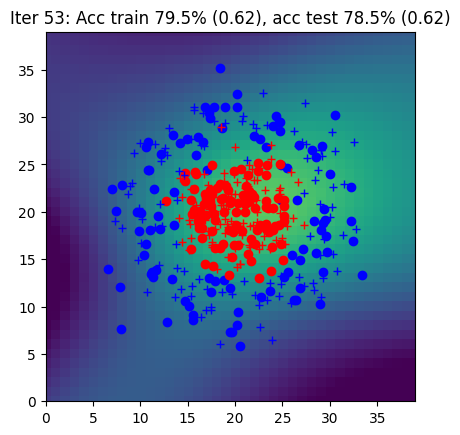

Iter 54: Acc train 81.0% (0.62), acc test 81.5% (0.62)


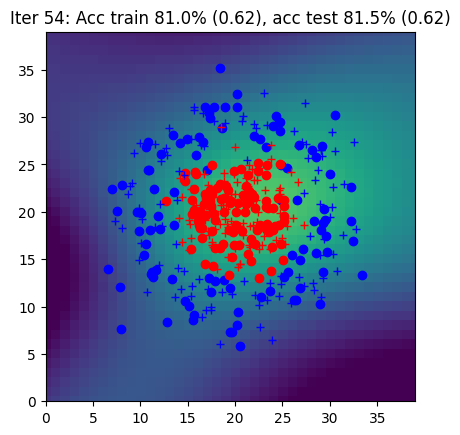

Iter 55: Acc train 80.5% (0.62), acc test 80.5% (0.62)


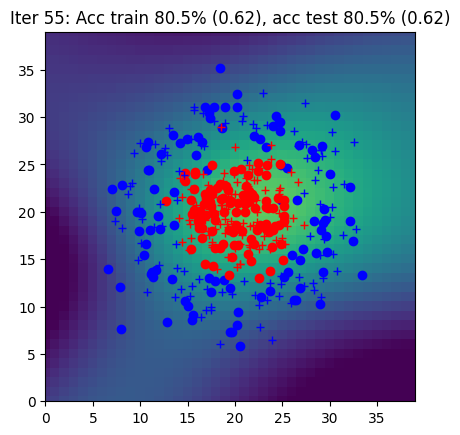

Iter 56: Acc train 79.5% (0.61), acc test 80.0% (0.61)


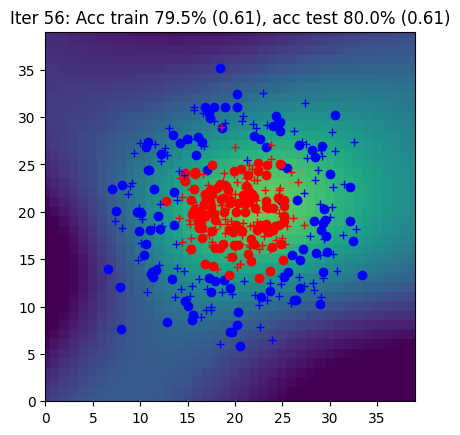

Iter 57: Acc train 82.0% (0.61), acc test 81.5% (0.61)


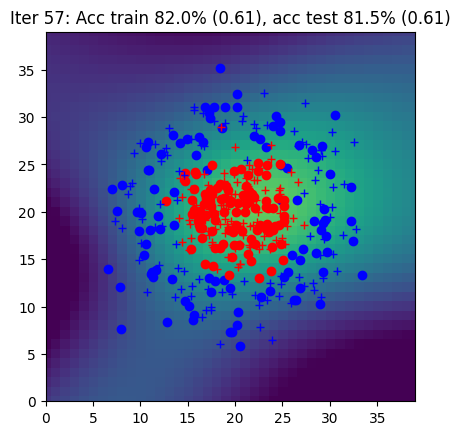

Iter 58: Acc train 82.5% (0.60), acc test 83.0% (0.61)


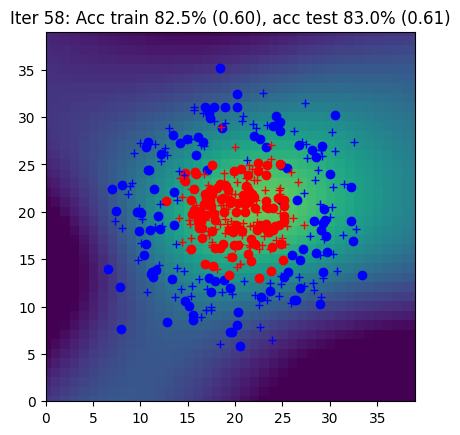

Iter 59: Acc train 83.5% (0.60), acc test 84.0% (0.60)


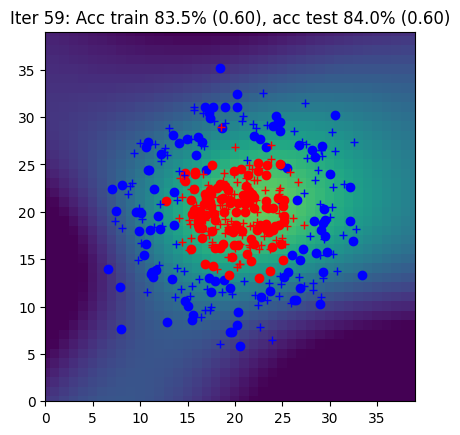

Iter 60: Acc train 81.0% (0.60), acc test 80.0% (0.60)


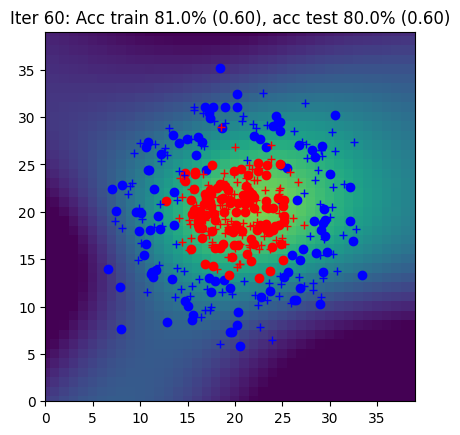

Iter 61: Acc train 81.0% (0.59), acc test 82.0% (0.59)


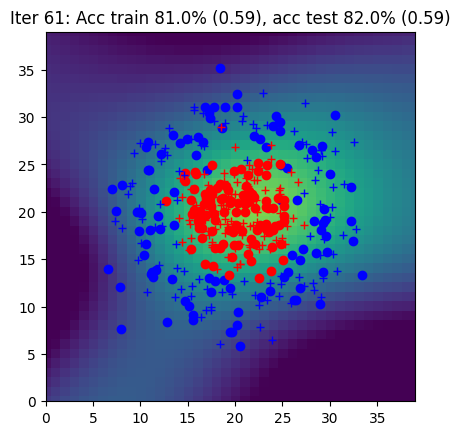

Iter 62: Acc train 82.5% (0.59), acc test 85.0% (0.59)


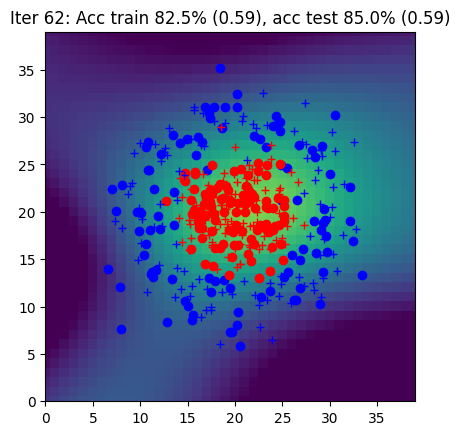

Iter 63: Acc train 84.5% (0.59), acc test 85.5% (0.59)


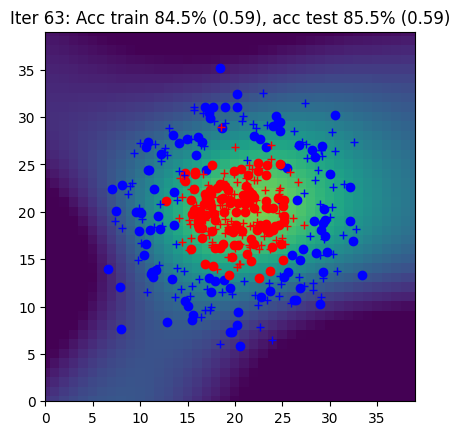

Iter 64: Acc train 82.5% (0.58), acc test 85.0% (0.58)


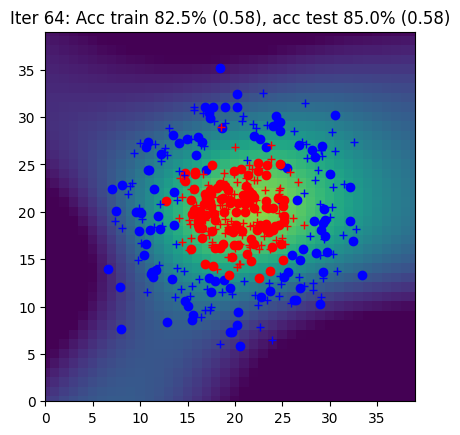

Iter 65: Acc train 83.0% (0.58), acc test 85.5% (0.58)


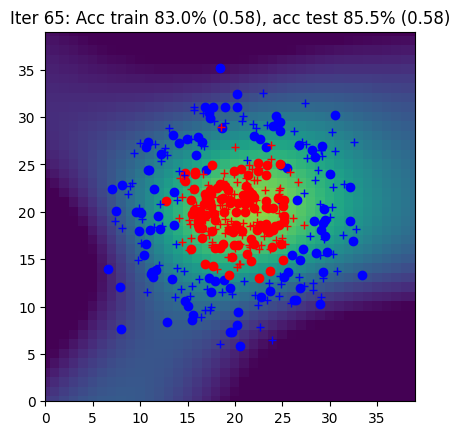

Iter 66: Acc train 85.0% (0.57), acc test 87.0% (0.57)


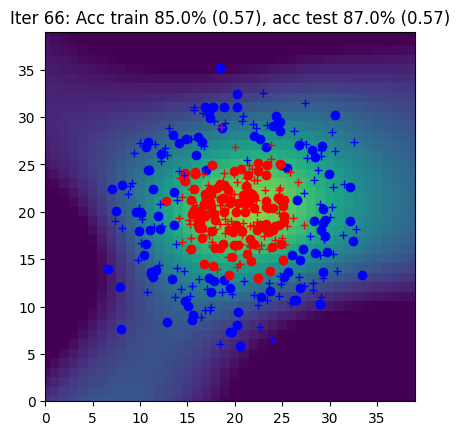

Iter 67: Acc train 85.0% (0.57), acc test 87.5% (0.57)


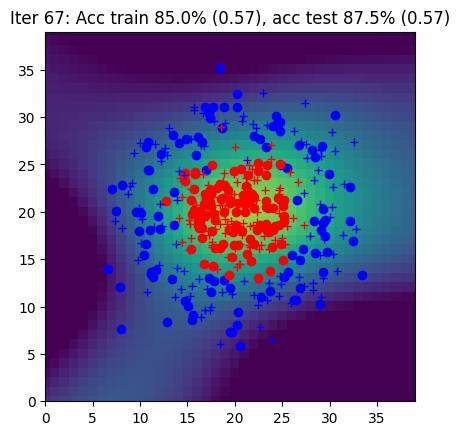

Iter 68: Acc train 86.5% (0.56), acc test 89.0% (0.56)


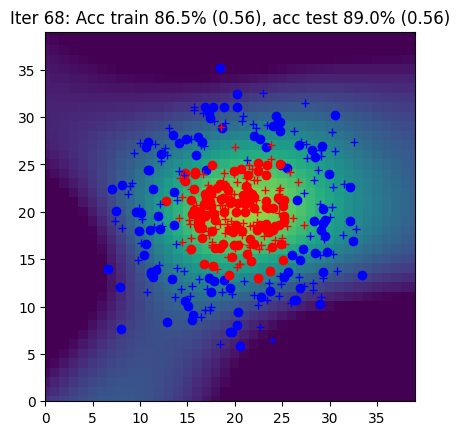

Iter 69: Acc train 87.0% (0.56), acc test 89.5% (0.56)


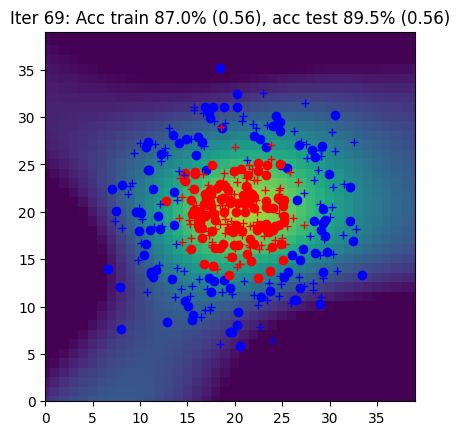

Iter 70: Acc train 89.0% (0.55), acc test 90.5% (0.55)


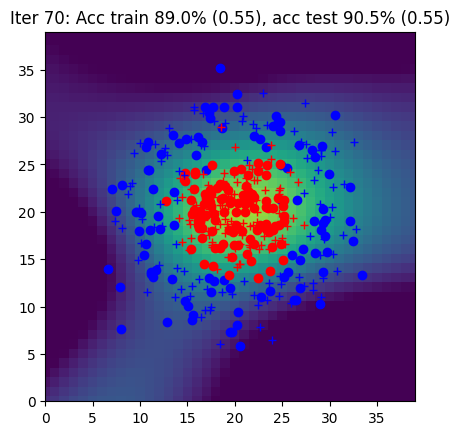

Iter 71: Acc train 84.0% (0.55), acc test 87.5% (0.55)


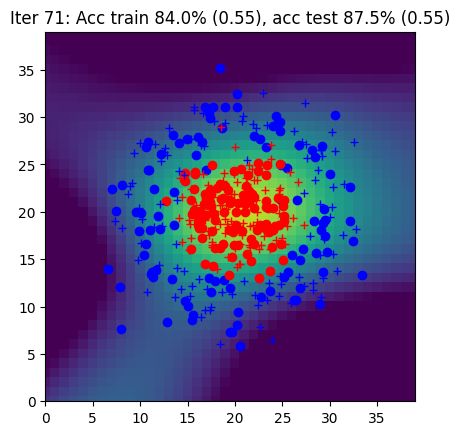

Iter 72: Acc train 86.0% (0.54), acc test 89.0% (0.54)


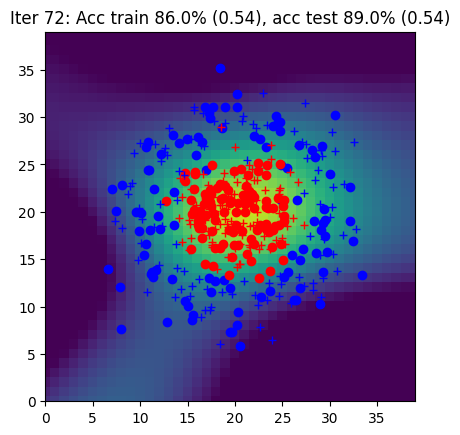

Iter 73: Acc train 88.5% (0.54), acc test 91.0% (0.54)


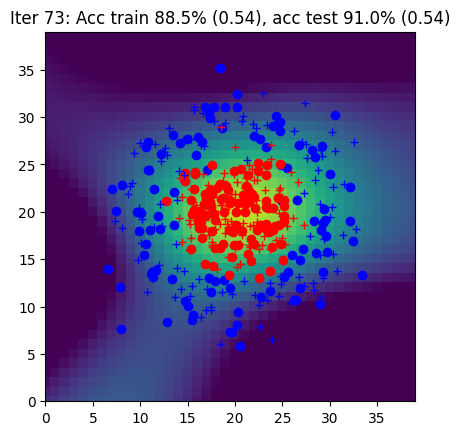

Iter 74: Acc train 90.0% (0.53), acc test 91.0% (0.53)


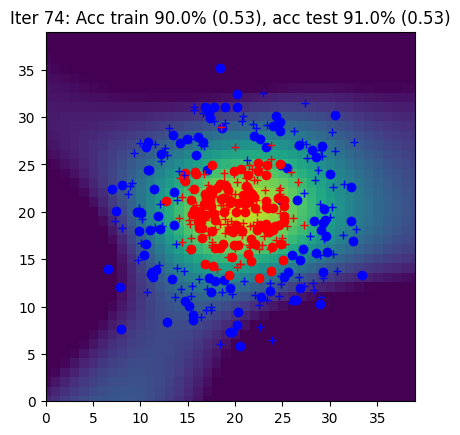

Iter 75: Acc train 90.0% (0.53), acc test 91.0% (0.53)


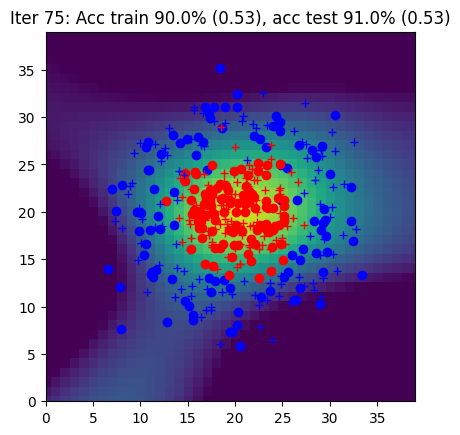

Iter 76: Acc train 89.0% (0.52), acc test 91.0% (0.52)


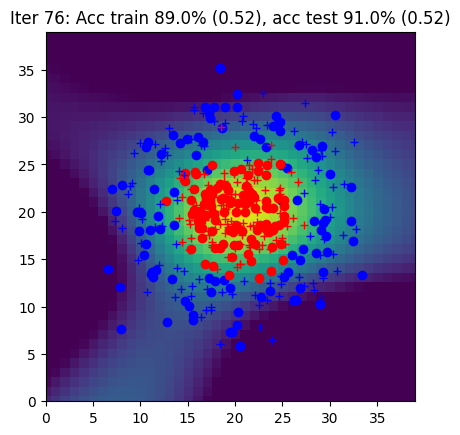

Iter 77: Acc train 89.5% (0.52), acc test 91.0% (0.52)


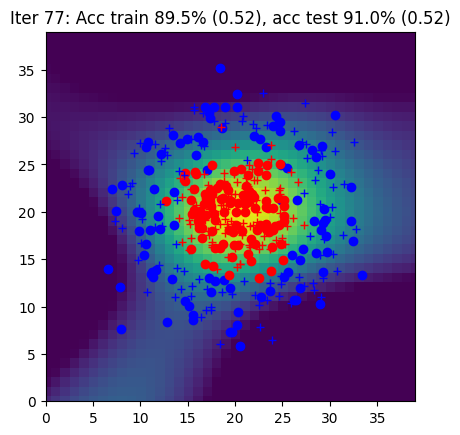

Iter 78: Acc train 87.5% (0.51), acc test 90.5% (0.51)


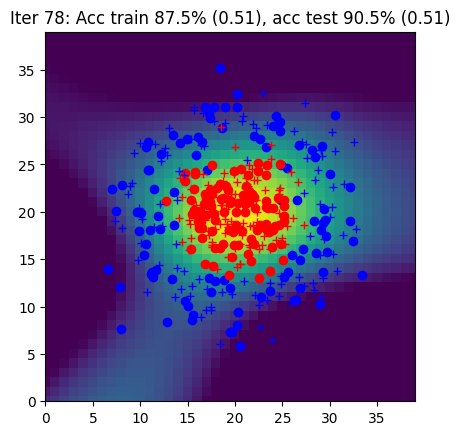

Iter 79: Acc train 86.5% (0.51), acc test 89.5% (0.51)


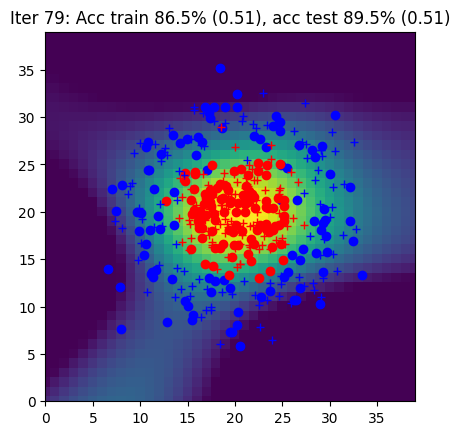

Iter 80: Acc train 89.5% (0.50), acc test 91.5% (0.50)


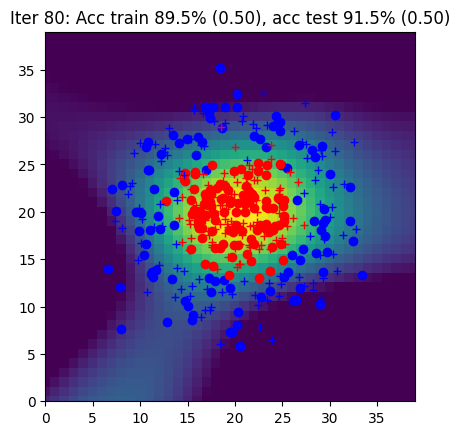

Iter 81: Acc train 90.0% (0.50), acc test 91.5% (0.50)


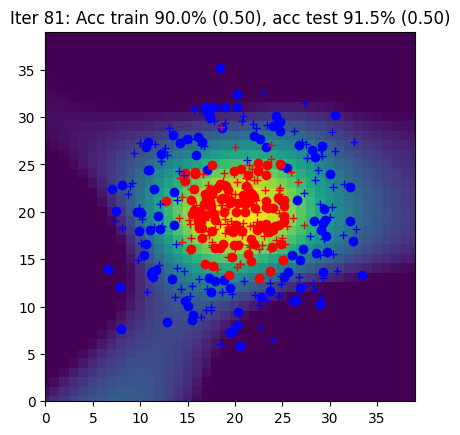

Iter 82: Acc train 91.0% (0.49), acc test 92.5% (0.49)


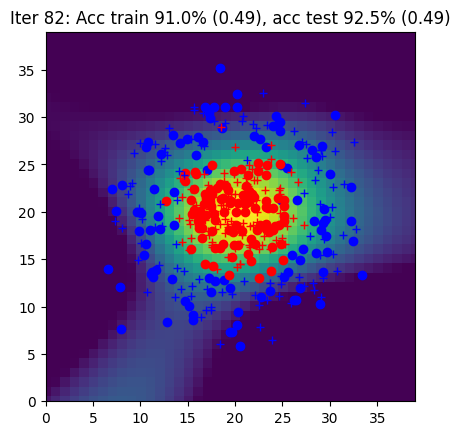

Iter 83: Acc train 91.0% (0.49), acc test 93.0% (0.49)


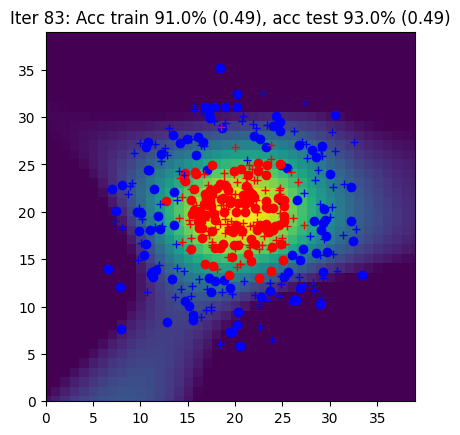

Iter 84: Acc train 91.0% (0.48), acc test 93.0% (0.48)


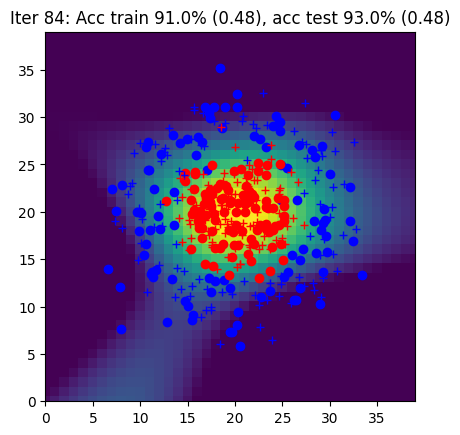

Iter 85: Acc train 91.5% (0.48), acc test 93.0% (0.48)


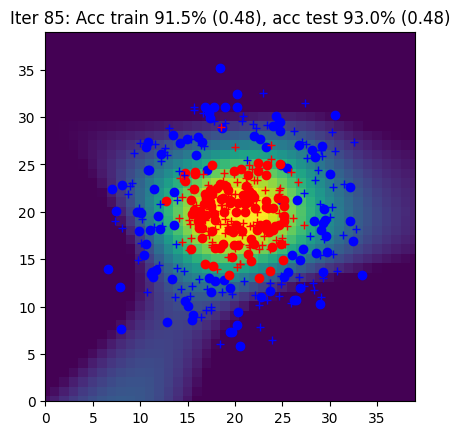

Iter 86: Acc train 91.0% (0.47), acc test 93.0% (0.47)


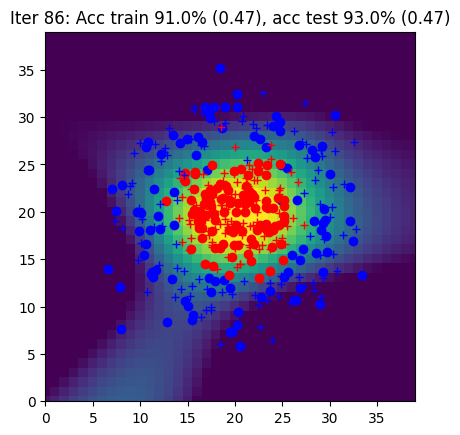

Iter 87: Acc train 90.5% (0.47), acc test 93.0% (0.47)


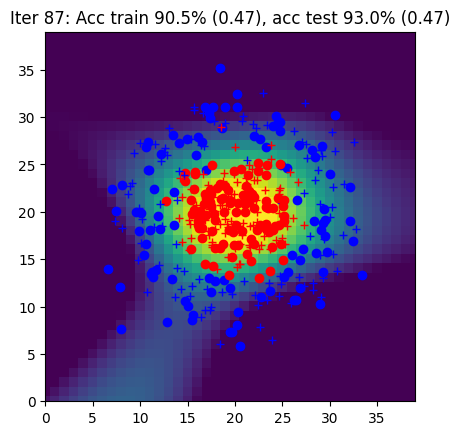

Iter 88: Acc train 91.0% (0.46), acc test 93.0% (0.46)


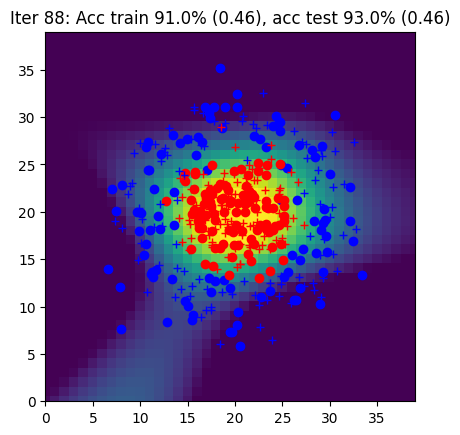

Iter 89: Acc train 93.0% (0.46), acc test 93.5% (0.46)


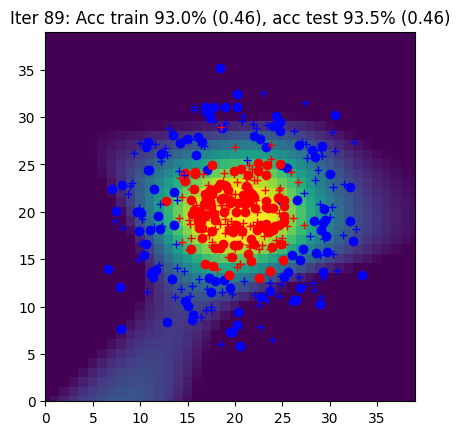

Iter 90: Acc train 93.5% (0.45), acc test 93.5% (0.45)


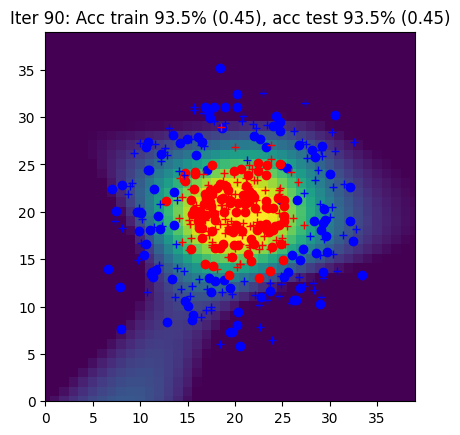

Iter 91: Acc train 93.5% (0.45), acc test 93.5% (0.44)


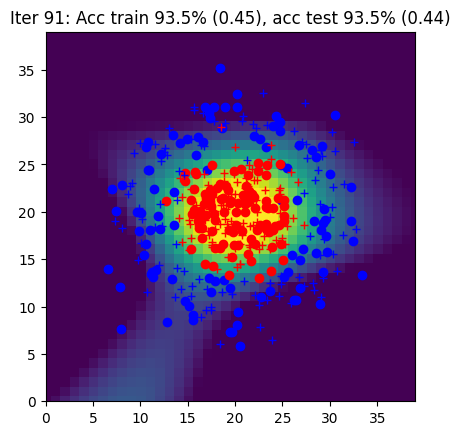

Iter 92: Acc train 93.5% (0.44), acc test 94.0% (0.44)


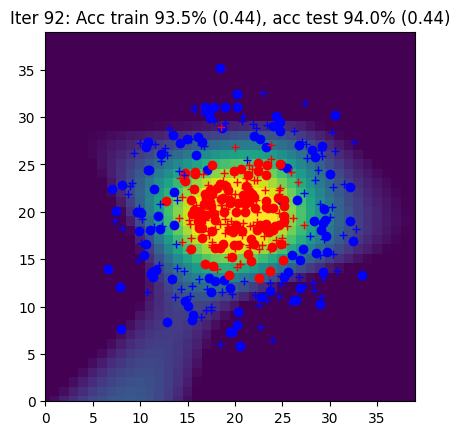

Iter 93: Acc train 93.0% (0.44), acc test 94.0% (0.43)


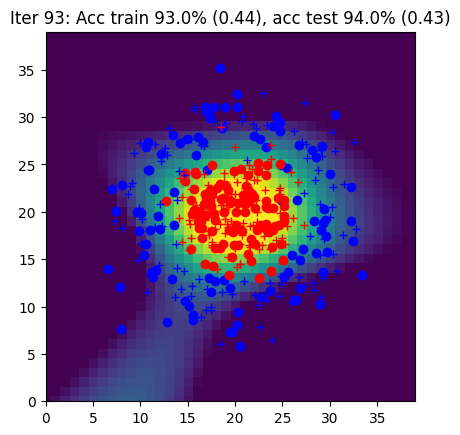

Iter 94: Acc train 93.5% (0.43), acc test 94.0% (0.43)


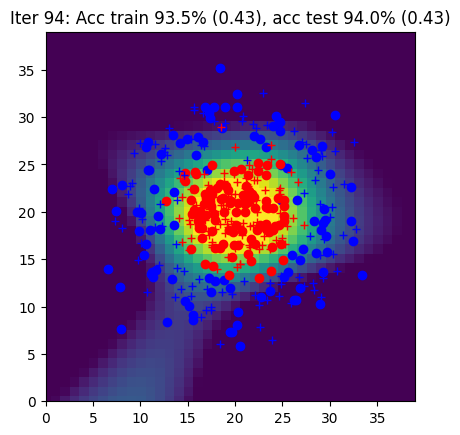

Iter 95: Acc train 93.5% (0.43), acc test 94.0% (0.42)


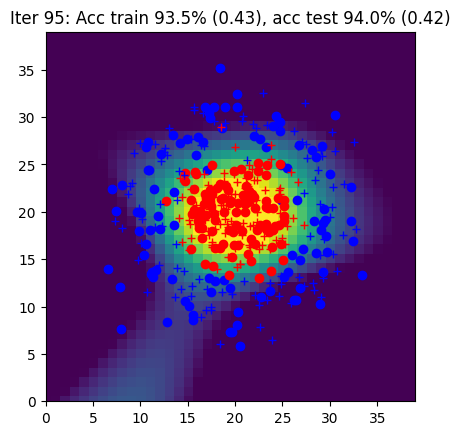

Iter 96: Acc train 93.5% (0.42), acc test 94.0% (0.42)


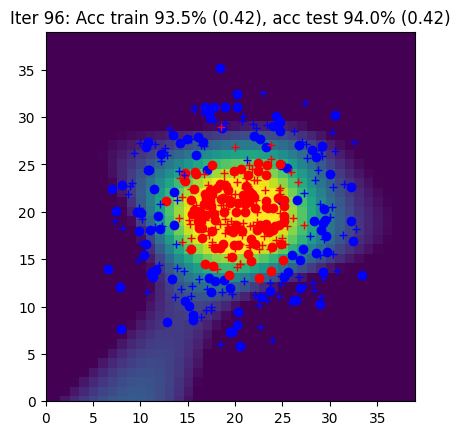

Iter 97: Acc train 93.5% (0.42), acc test 94.0% (0.41)


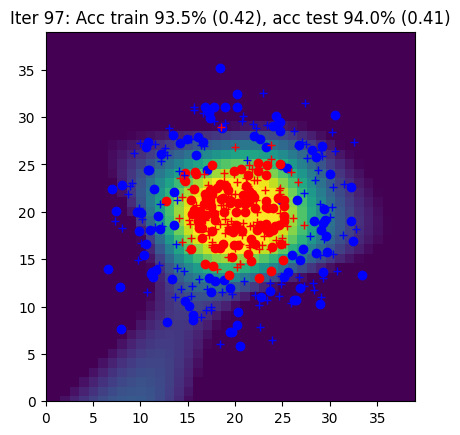

Iter 98: Acc train 93.5% (0.41), acc test 94.0% (0.41)


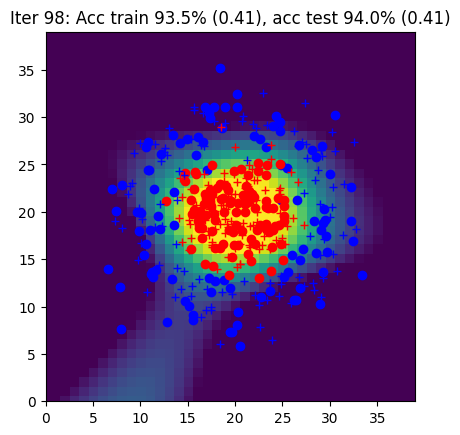

Iter 99: Acc train 94.0% (0.41), acc test 94.0% (0.40)


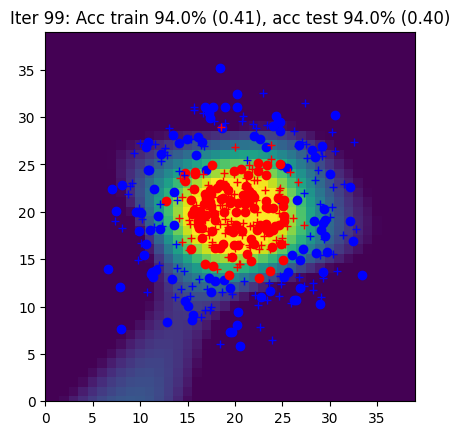

Iter 100: Acc train 94.0% (0.40), acc test 94.0% (0.40)


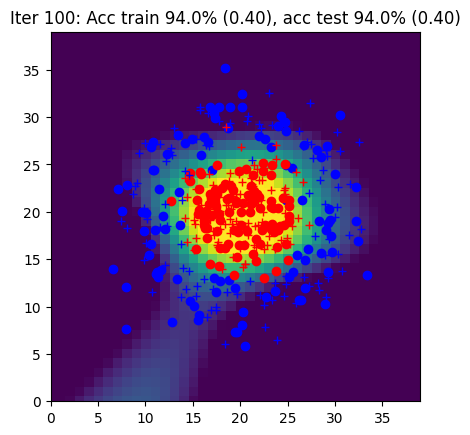

Iter 101: Acc train 94.0% (0.40), acc test 94.0% (0.39)


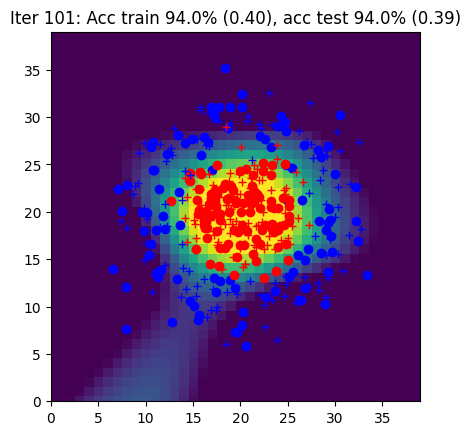

Iter 102: Acc train 94.0% (0.39), acc test 94.0% (0.39)


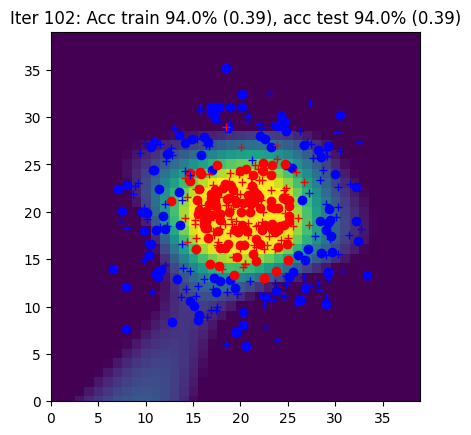

Iter 103: Acc train 95.0% (0.39), acc test 94.5% (0.39)


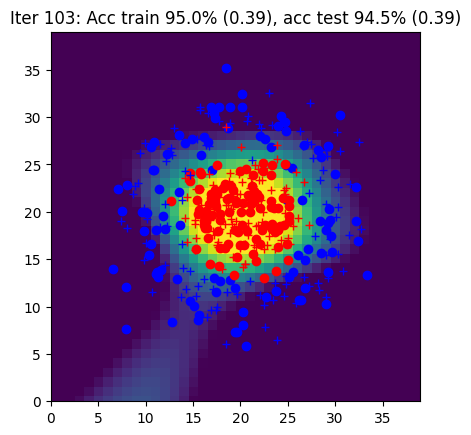

Iter 104: Acc train 94.5% (0.38), acc test 94.5% (0.38)


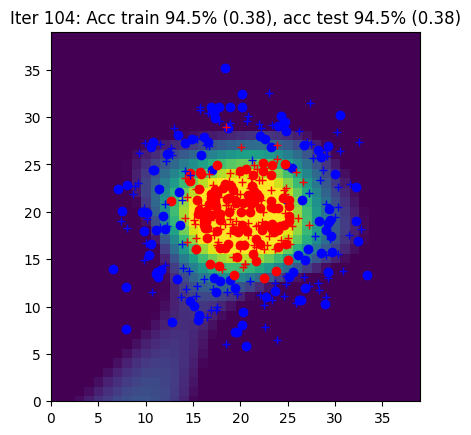

Iter 105: Acc train 94.5% (0.38), acc test 94.5% (0.38)


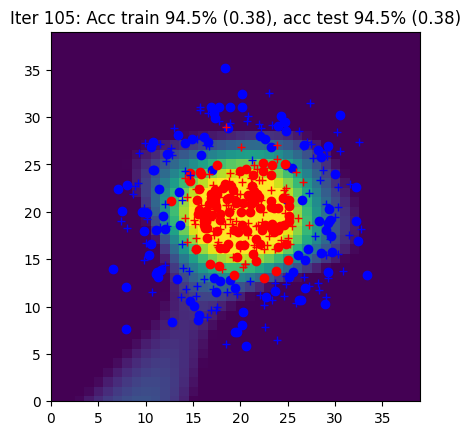

Iter 106: Acc train 95.0% (0.37), acc test 94.5% (0.37)


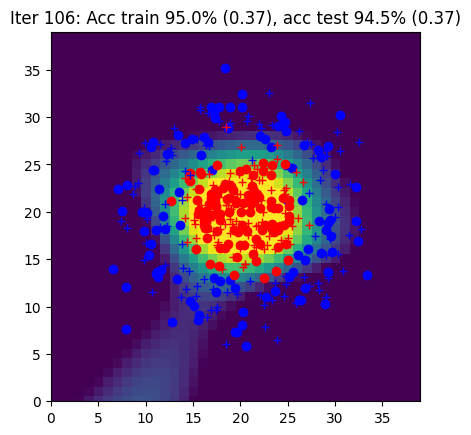

Iter 107: Acc train 95.0% (0.37), acc test 95.0% (0.37)


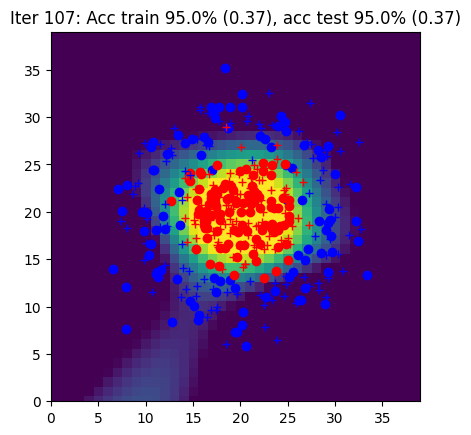

Iter 108: Acc train 95.0% (0.36), acc test 95.5% (0.36)


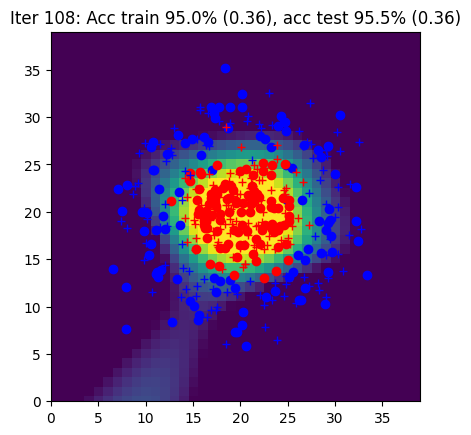

Iter 109: Acc train 95.0% (0.36), acc test 95.5% (0.36)


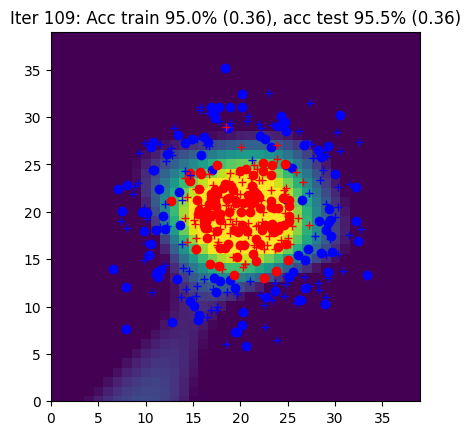

Iter 110: Acc train 95.0% (0.36), acc test 96.0% (0.35)


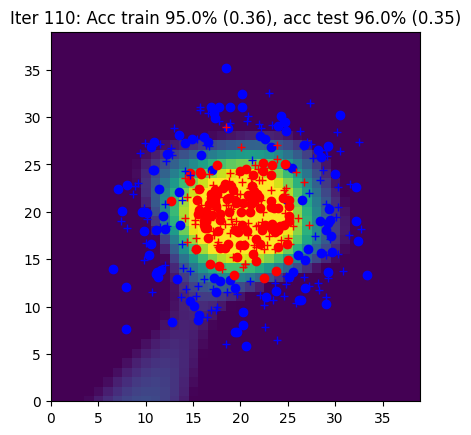

Iter 111: Acc train 95.0% (0.35), acc test 95.5% (0.35)


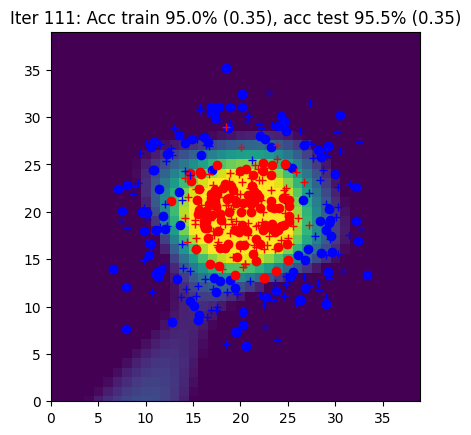

Iter 112: Acc train 95.0% (0.35), acc test 95.5% (0.35)


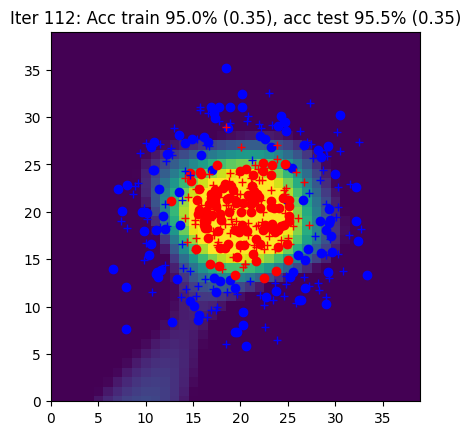

Iter 113: Acc train 96.0% (0.34), acc test 95.5% (0.34)


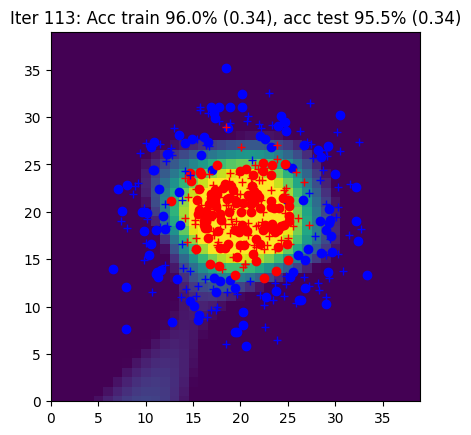

Iter 114: Acc train 95.0% (0.34), acc test 95.5% (0.34)


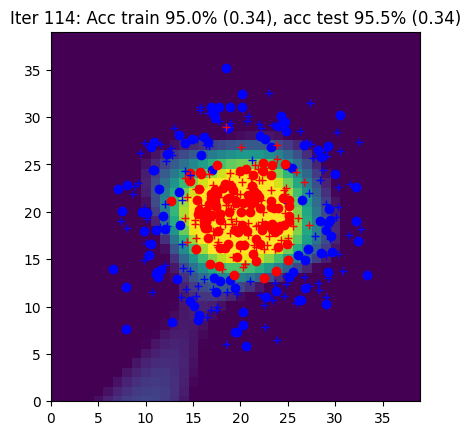

Iter 115: Acc train 95.0% (0.33), acc test 96.0% (0.34)


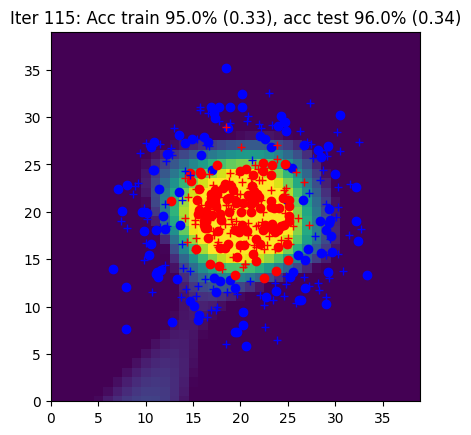

Iter 116: Acc train 95.5% (0.33), acc test 95.5% (0.33)


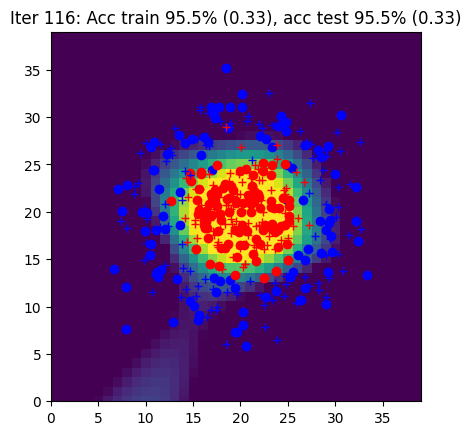

Iter 117: Acc train 95.5% (0.33), acc test 95.5% (0.33)


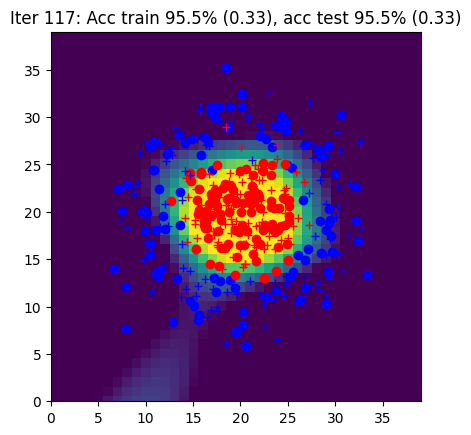

Iter 118: Acc train 95.0% (0.32), acc test 95.5% (0.32)


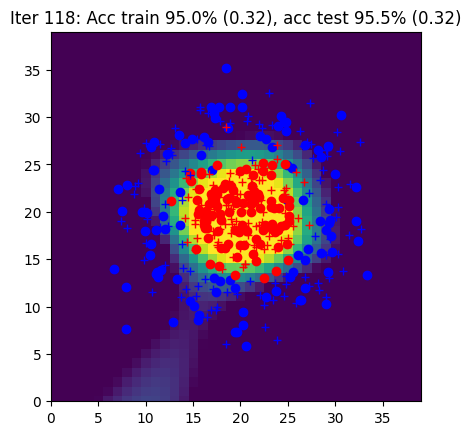

Iter 119: Acc train 95.5% (0.32), acc test 95.0% (0.32)


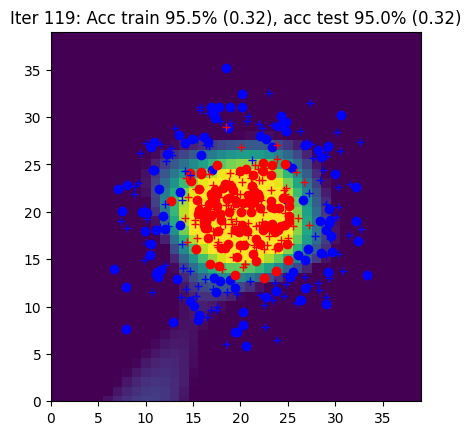

Iter 120: Acc train 95.0% (0.32), acc test 95.5% (0.32)


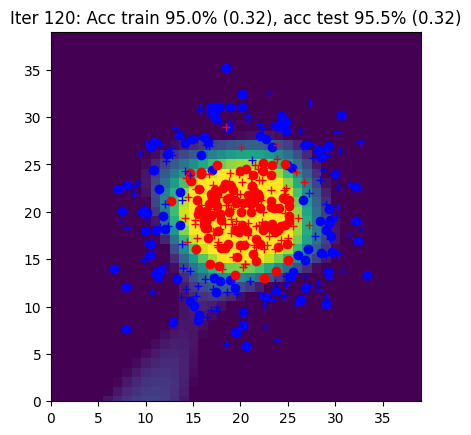

Iter 121: Acc train 95.5% (0.31), acc test 95.0% (0.31)


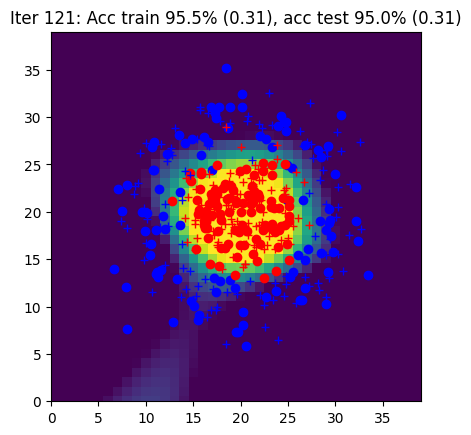

Iter 122: Acc train 95.5% (0.31), acc test 95.5% (0.31)


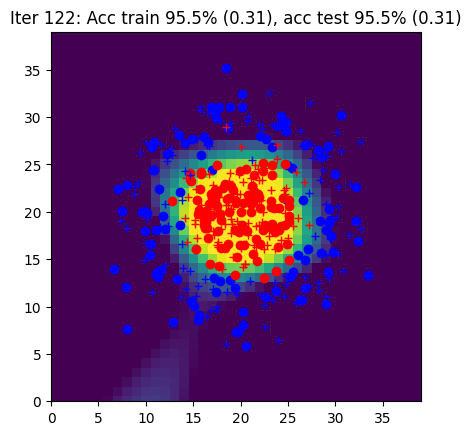

Iter 123: Acc train 95.5% (0.31), acc test 96.0% (0.31)


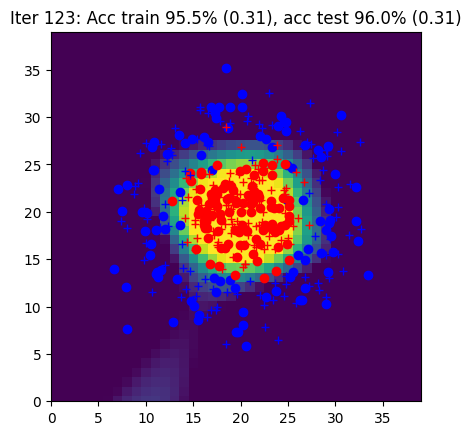

Iter 124: Acc train 95.5% (0.30), acc test 95.5% (0.30)


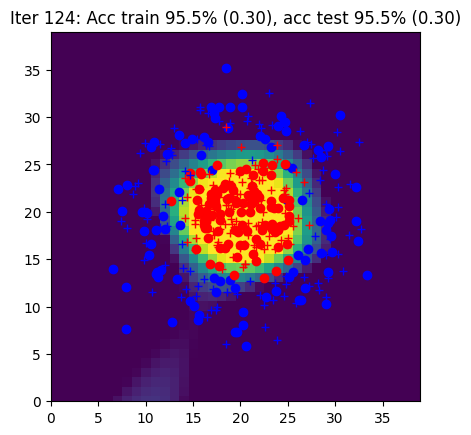

Iter 125: Acc train 95.5% (0.30), acc test 95.0% (0.30)


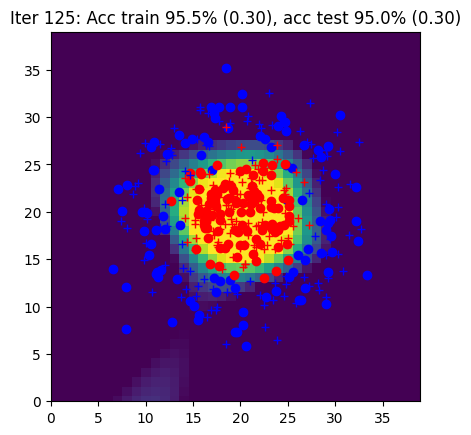

Iter 126: Acc train 95.0% (0.30), acc test 95.5% (0.30)


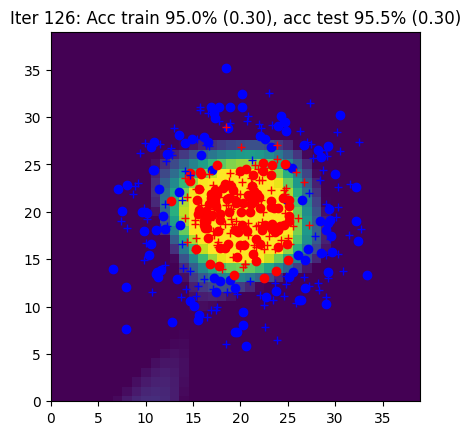

Iter 127: Acc train 95.5% (0.29), acc test 95.5% (0.30)


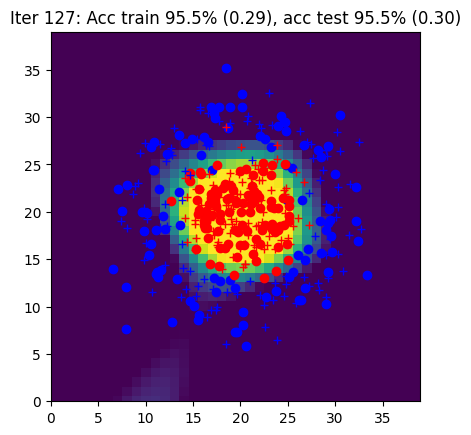

Iter 128: Acc train 95.5% (0.29), acc test 95.5% (0.29)


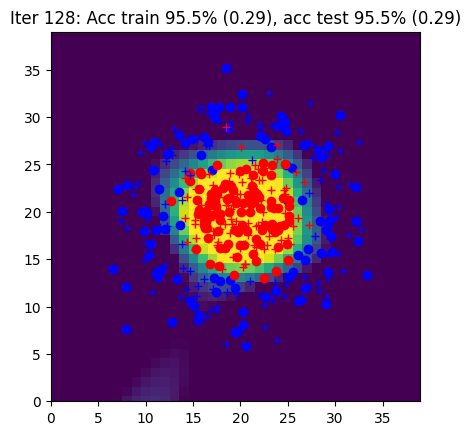

Iter 129: Acc train 95.5% (0.29), acc test 95.5% (0.29)


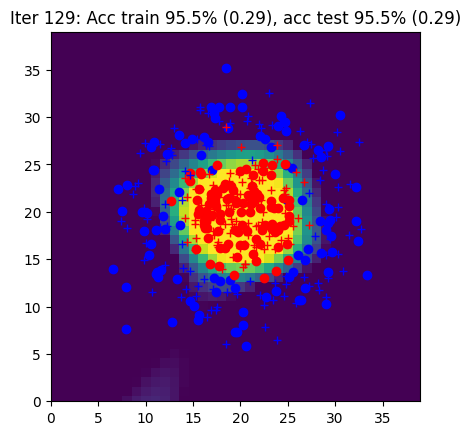

Iter 130: Acc train 95.5% (0.28), acc test 95.5% (0.29)


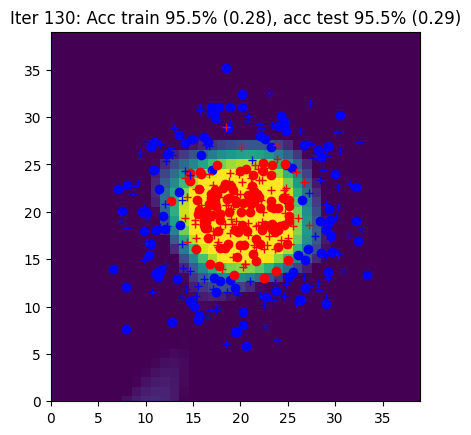

Iter 131: Acc train 95.0% (0.28), acc test 95.5% (0.28)


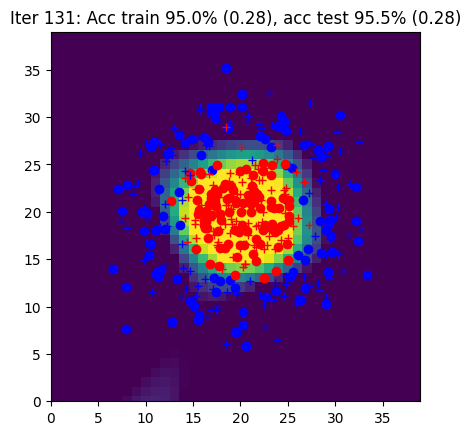

Iter 132: Acc train 96.5% (0.28), acc test 95.0% (0.28)


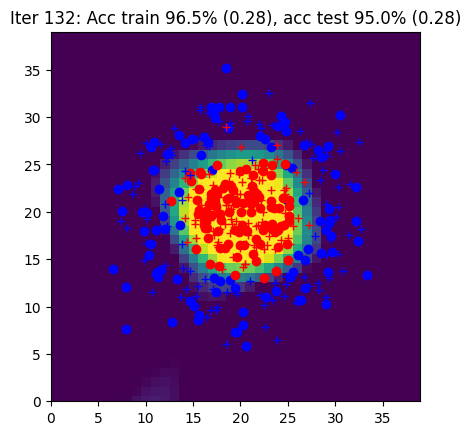

Iter 133: Acc train 95.5% (0.28), acc test 95.5% (0.28)


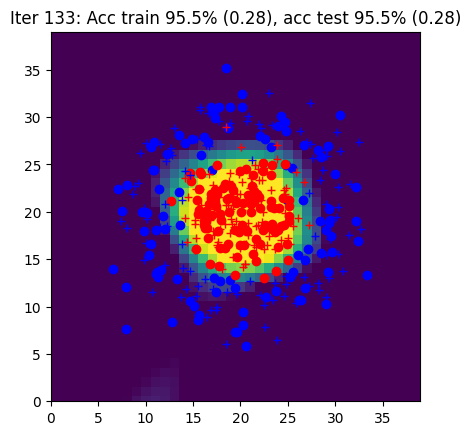

Iter 134: Acc train 95.5% (0.27), acc test 95.5% (0.28)


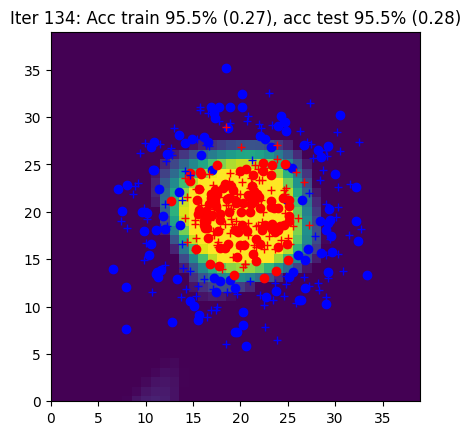

Iter 135: Acc train 96.0% (0.27), acc test 95.5% (0.27)


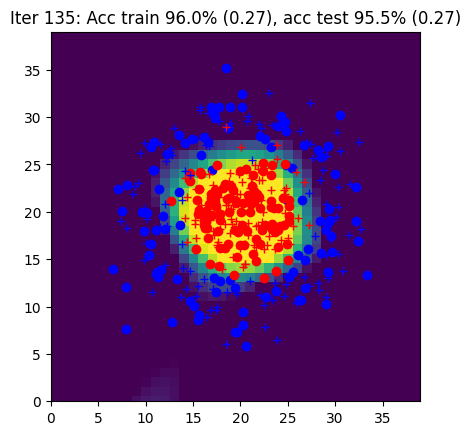

Iter 136: Acc train 95.5% (0.27), acc test 95.5% (0.27)


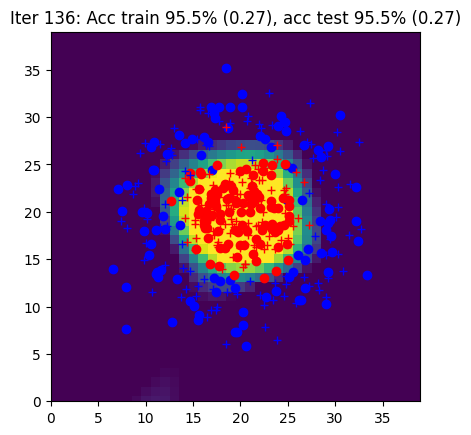

Iter 137: Acc train 96.0% (0.27), acc test 95.5% (0.27)


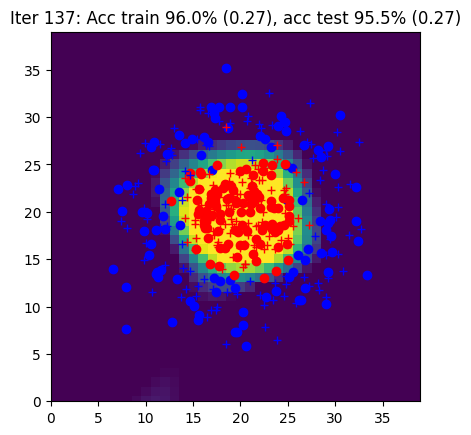

Iter 138: Acc train 96.0% (0.26), acc test 95.5% (0.27)


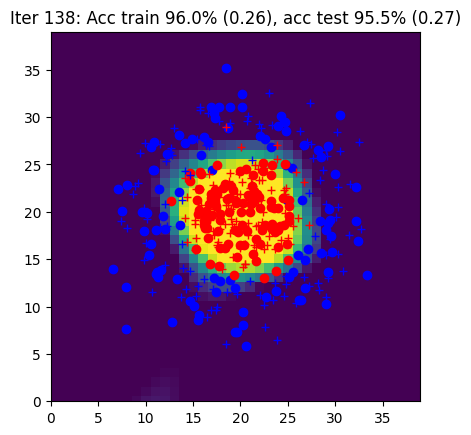

Iter 139: Acc train 96.0% (0.26), acc test 95.5% (0.26)


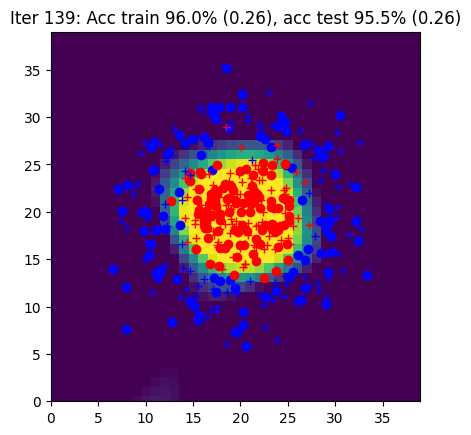

Iter 140: Acc train 96.0% (0.26), acc test 95.5% (0.26)


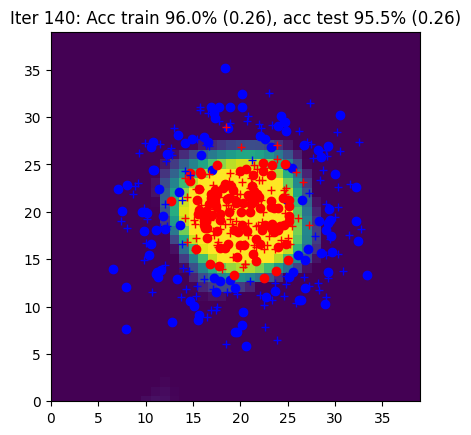

Iter 141: Acc train 96.0% (0.26), acc test 95.5% (0.26)


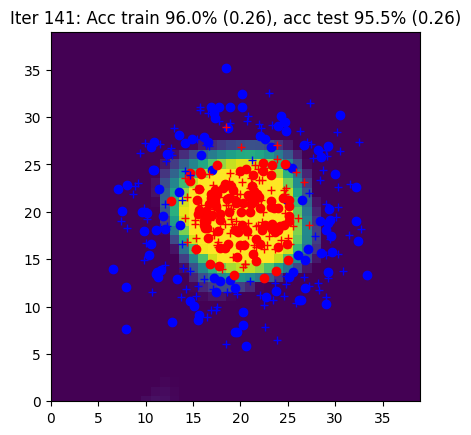

Iter 142: Acc train 96.0% (0.25), acc test 95.5% (0.26)


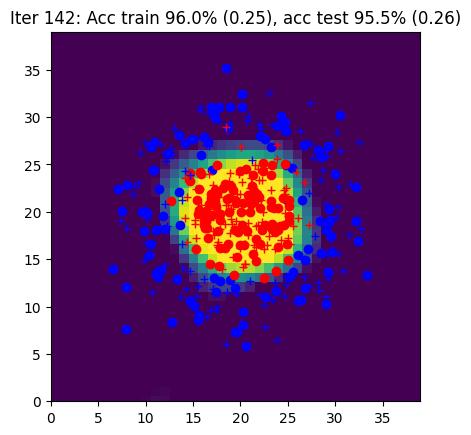

Iter 143: Acc train 96.0% (0.25), acc test 95.0% (0.26)


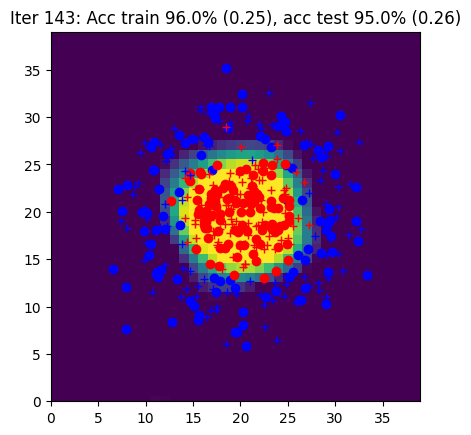

Iter 144: Acc train 95.5% (0.25), acc test 95.0% (0.25)


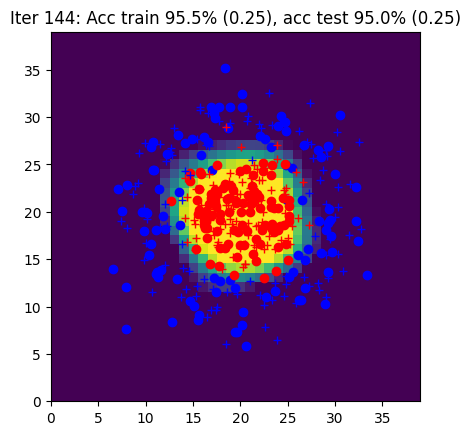

Iter 145: Acc train 96.0% (0.25), acc test 95.5% (0.25)


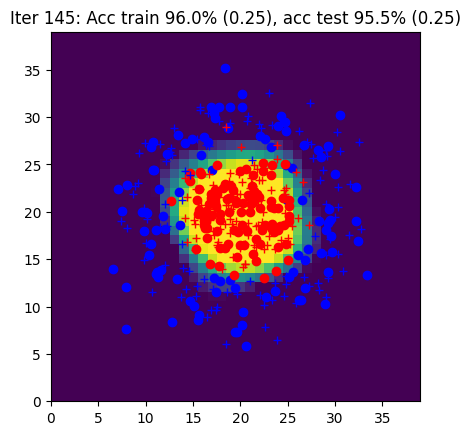

Iter 146: Acc train 96.0% (0.24), acc test 95.5% (0.25)


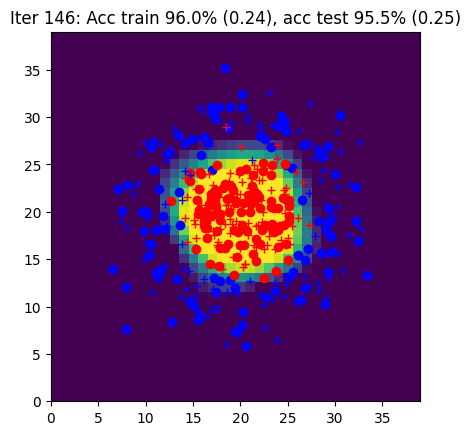

Iter 147: Acc train 96.0% (0.24), acc test 95.5% (0.25)


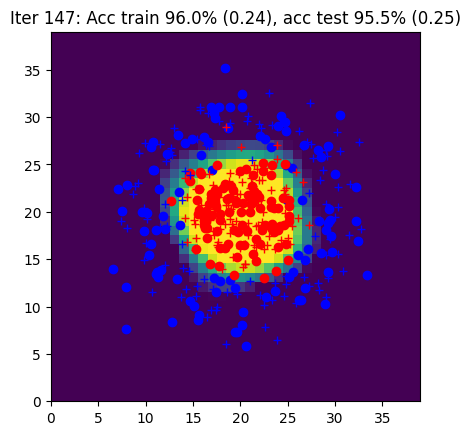

Iter 148: Acc train 95.5% (0.24), acc test 95.0% (0.25)


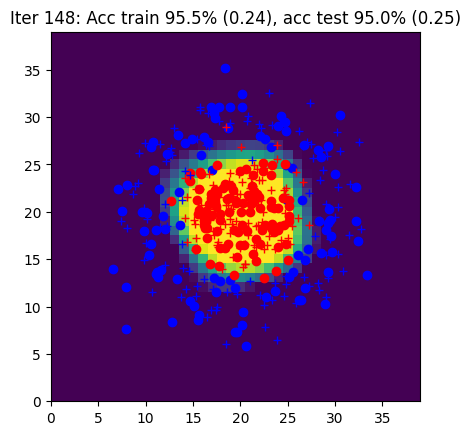

Iter 149: Acc train 95.5% (0.24), acc test 95.5% (0.24)


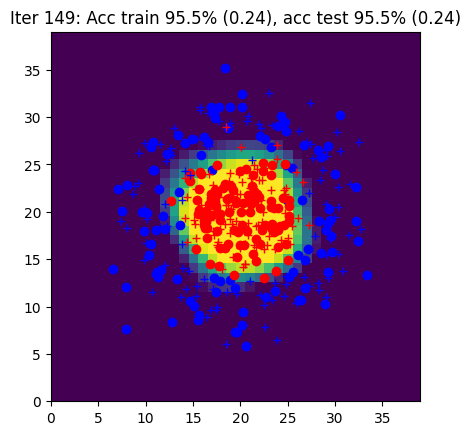

In [22]:
# init
data = CirclesData()
data.plot_data()
N = data.Xtrain.shape[0]
Nbatch = 10
nx = data.Xtrain.shape[1]
nh = 10
ny = data.Ytrain.shape[1]
eta = 0.03

model, loss, optim = init_model(nx, nh, ny, eta)

curves = [[], [], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code  here ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j + 1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # write the optimization algorithm on the batch (X,Y)
        # using the functions: loss_accuracy
        # the forward with the predict method from the model
        # the backward function with autograd
        # and then an optimization step
        
        # forward propagation
        yhat = model(X)
        
        # calculate loss and accuracy
        L, acc = loss_accuracy(loss, yhat, Y)
        
        # backward propagation to compute gradients
        optim.zero_grad()
        L.backward()
        optim.step()

    ####################
    ##      FIN        #
    ####################

    Yhat_train = model(data.Xtrain)
    Yhat_test = model(data.Xtest)
    Ltrain, acctrain = loss_accuracy(loss, Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(loss, Yhat_test, data.Ytest)
    Ygrid = model(data.Xgrid)

    title = "Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})".format(
        iteration, acctrain, Ltrain, acctest, Ltest
    )
    print(title)
    data.plot_data_with_grid(torch.nn.Softmax(dim=1)(Ygrid.detach()), title)

    curves[0].append(acctrain.detach().item())
    curves[1].append(acctest.detach().item())
    curves[2].append(Ltrain.detach().item())
    curves[3].append(Ltest.detach().item())



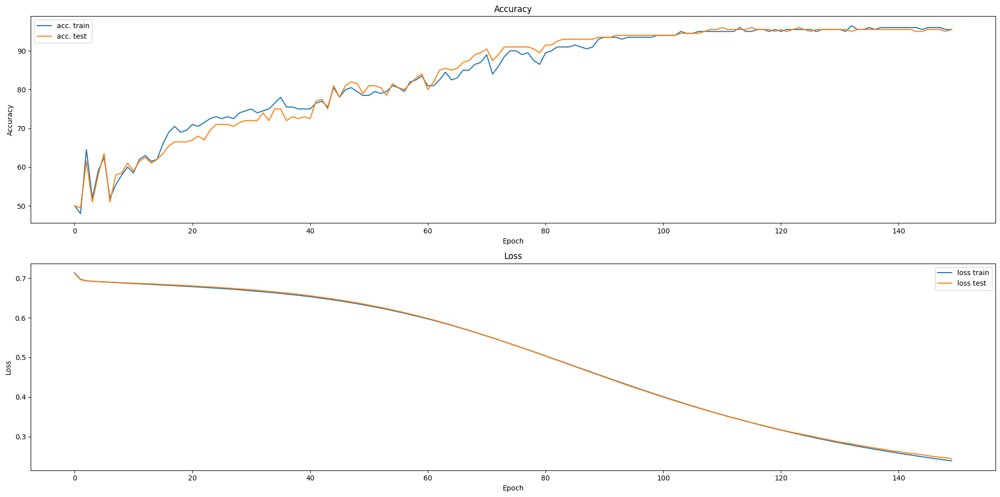

In [23]:
# Create subplots: 2 row, 1 columns
fig, axs = plt.subplots(2, 1, figsize=(20, 10))

# Plot accuracy curves on the first subplot
axs[0].plot(curves[0], label="acc. train")
axs[0].plot(curves[1], label="acc. test")
axs[0].set_title('Accuracy')
axs[0].set_xlabel('Epoch')
axs[0].set_ylabel('Accuracy')
axs[0].legend()

# Plot loss curves on the second subplot
axs[1].plot(curves[2], label="loss train")
axs[1].plot(curves[3], label="loss test")
axs[1].set_title('Loss')
axs[1].set_xlabel('Epoch')
axs[1].set_ylabel('Loss')
axs[1].legend()

# Show the plot
plt.tight_layout()
plt.show()

# Part 5 : MNIST

Apply the code from previous part code to the MNIST dataset.

In [24]:
# init
data = MNISTData()
N = data.Xtrain.shape[0]
Nbatch = 100
nx = data.Xtrain.shape[1]
nh = 100
ny = data.Ytrain.shape[1]
eta = 0.03

model, loss, optim = init_model(nx, nh, ny, eta)

curves = [[], [], [], []]

# epoch
for iteration in range(150):

    # permute
    perm = np.random.permutation(N)
    Xtrain = data.Xtrain[perm, :]
    Ytrain = data.Ytrain[perm, :]

    #####################
    ## Your code  here ##
    #####################
    # batches
    for j in range(N // Nbatch):

        indsBatch = range(j * Nbatch, (j + 1) * Nbatch)
        X = Xtrain[indsBatch, :]
        Y = Ytrain[indsBatch, :]

        # write the optimization algorithm on the batch (X,Y)
        # using the functions: loss_accuracy
        # the forward with the predict method from the model
        # the backward function with autograd
        # and then an optimization step

        # forward propagation
        yhat = model(X)

        # calculate loss and accuracy
        L, acc = loss_accuracy(loss, yhat, Y)

        # backward propagation to compute gradients
        optim.zero_grad()
        L.backward()
        optim.step()

    ####################
    ##      FIN        #
    ####################

    Yhat_train = model(data.Xtrain)
    Yhat_test = model(data.Xtest)
    Ltrain, acctrain = loss_accuracy(loss, Yhat_train, data.Ytrain)
    Ltest, acctest = loss_accuracy(loss, Yhat_test, data.Ytest)

    title = "Iter {}: Acc train {:.1f}% ({:.2f}), acc test {:.1f}% ({:.2f})".format(
        iteration, acctrain, Ltrain, acctest, Ltest
    )
    print(title)

    curves[0].append(acctrain.detach().item())
    curves[1].append(acctest.detach().item())
    curves[2].append(Ltrain.detach().item())
    curves[3].append(Ltest.detach().item())



Iter 0: Acc train 85.4% (0.53), acc test 86.0% (0.52)
Iter 1: Acc train 87.6% (0.42), acc test 88.2% (0.41)
Iter 2: Acc train 87.3% (0.43), acc test 88.0% (0.42)
Iter 3: Acc train 86.9% (0.44), acc test 87.5% (0.43)
Iter 4: Acc train 88.7% (0.38), acc test 89.3% (0.37)
Iter 5: Acc train 88.7% (0.39), acc test 88.9% (0.38)
Iter 6: Acc train 87.6% (0.42), acc test 88.2% (0.40)
Iter 7: Acc train 89.0% (0.37), acc test 89.1% (0.36)
Iter 8: Acc train 88.2% (0.39), acc test 88.4% (0.39)
Iter 9: Acc train 88.6% (0.38), acc test 89.2% (0.37)
Iter 10: Acc train 88.5% (0.38), acc test 88.8% (0.37)
Iter 11: Acc train 87.6% (0.41), acc test 87.7% (0.40)
Iter 12: Acc train 89.0% (0.37), acc test 89.1% (0.36)
Iter 13: Acc train 89.9% (0.34), acc test 90.5% (0.33)
Iter 14: Acc train 88.9% (0.36), acc test 89.3% (0.36)
Iter 15: Acc train 88.8% (0.36), acc test 89.4% (0.35)
Iter 16: Acc train 89.3% (0.35), acc test 89.3% (0.34)
Iter 17: Acc train 90.1% (0.33), acc test 90.3% (0.32)
Iter 18: Acc train 8

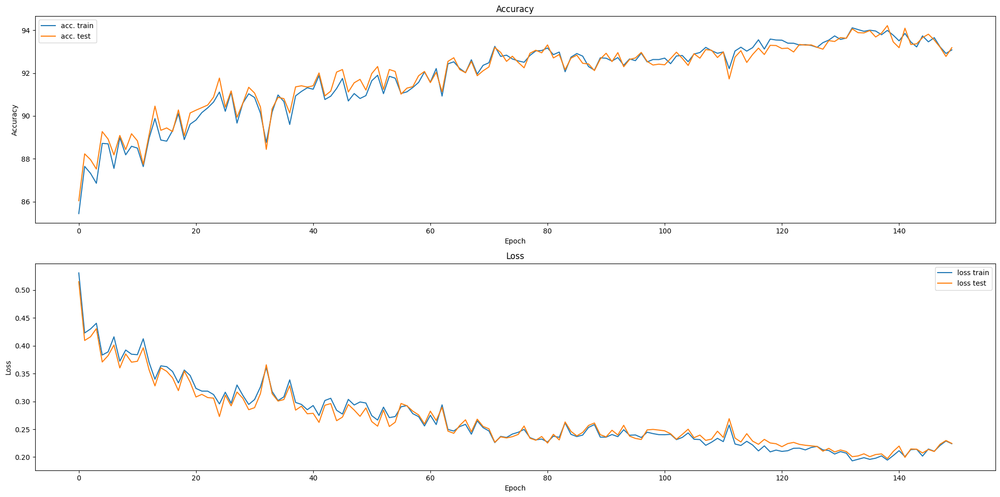

In [25]:
# Create subplots: 2 row, 1 columns
fig, axs = plt.subplots(2, 1, figsize=(20, 10))

# Plot accuracy curves on the first subplot
axs[0].plot(curves[0], label="acc. train")
axs[0].plot(curves[1], label="acc. test")
axs[0].set_title('Accuracy')
axs[0].set_xlabel('Epoch')
axs[0].set_ylabel('Accuracy')
axs[0].legend()

# Plot loss curves on the second subplot
axs[1].plot(curves[2], label="loss train")
axs[1].plot(curves[3], label="loss test")
axs[1].set_title('Loss')
axs[1].set_xlabel('Epoch')
axs[1].set_ylabel('Loss')
axs[1].legend()

# Show the plot
plt.tight_layout()
plt.show()

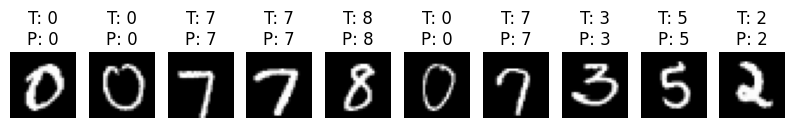

In [26]:
def plot_mnist_examples(X, Y_true, Y_pred, num_samples=10):
    plt.figure(figsize=(10, 2))
    
    for i in range(num_samples):
        plt.subplot(1, num_samples, i + 1)
        plt.imshow(X[i].reshape(28, 28), cmap="gray")  # Reshaping each sample to 28x28 pixels
        plt.title(f"T: {Y_true[i]}\nP: {Y_pred[i]}")
        plt.axis("off")
    
    plt.show()

# Number of samples to plot
num_samples_to_plot = 10

# Get the total number of samples in the test set
num_test_samples = data.Xtest.shape[0]

# Randomly select indices for the samples to plot
random_indices = np.random.choice(num_test_samples, num_samples_to_plot, replace=False)

# Extract the random samples and corresponding true labels
Xtest_samples = data.Xtest[random_indices]
Ytest_samples = data.Ytest[random_indices]

# Get the model's predictions for the random samples
Yhat_samples = model(Xtest_samples)
Y_pred_samples = torch.argmax(Yhat_samples, dim=1).detach().numpy()
Y_true_samples = torch.argmax(Ytest_samples, dim=1).detach().numpy()

# Plot the randomly selected MNIST examples with true and predicted labels
plot_mnist_examples(Xtest_samples, Y_true_samples, Y_pred_samples)


# Part 6: Bonus: SVM


Train a SVM model on the Circles dataset.

Ideas :
- First try a linear SVM (sklearn.svm.LinearSVC dans scikit-learn). Does it work well ? Why ?
- Then try more complex kernels (sklearn.svm.SVC). Which one is the best ? why ?
- Does the parameter C of regularization have an impact? Why ?

In [27]:
# data
data = CirclesData()
Xtrain = data.Xtrain.numpy()
Ytrain = data.Ytrain[:, 0].numpy()

Xgrid = data.Xgrid.numpy()

Xtest = data.Xtest.numpy()
Ytest = data.Ytest[:, 0].numpy()

def plot_svm_predictions(data, predictions):
      plt.figure(2)
      plt.clf()
      plt.imshow(np.reshape(predictions, (40,40)))
      plt.plot(data._Xtrain[data._Ytrain[:,0] == 1,0]*10+20, data._Xtrain[data._Ytrain[:,0] == 1,1]*10+20, 'bo', label="Train")
      plt.plot(data._Xtrain[data._Ytrain[:,1] == 1,0]*10+20, data._Xtrain[data._Ytrain[:,1] == 1,1]*10+20, 'ro')
      plt.plot(data._Xtest[data._Ytest[:,0] == 1,0]*10+20, data._Xtest[data._Ytest[:,0] == 1,1]*10+20, 'b+', label="Test")
      plt.plot(data._Xtest[data._Ytest[:,1] == 1,0]*10+20, data._Xtest[data._Ytest[:,1] == 1,1]*10+20, 'r+')
      plt.xlim(0,39)
      plt.ylim(0,39)
      plt.clim(0.3,0.7)
      plt.draw()
      plt.pause(1e-3)

In [28]:
import sklearn.svm

############################
### Your code here   #######
### Train the SVM    #######
## See https://scikit-learn.org/stable/modules/generated/sklearn.svm.LinearSVC.html
## and https://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html
############################

# Initialize the SVM with RBF kernel
svm = sklearn.svm.SVC(kernel='rbf', C=1.0, gamma='scale')

# Train the SVM model on the training data
svm.fit(Xtrain, Ytrain)

###########################

SVC()

Accuracy : 94.00


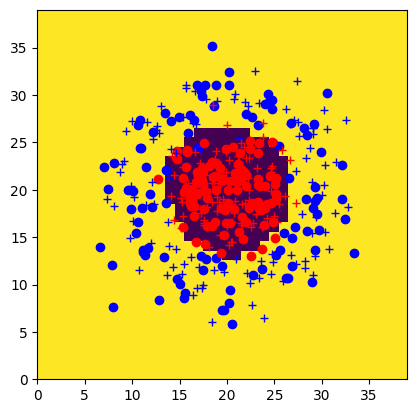

In [29]:
## Print results

Ytest_pred = svm.predict(Xtest)
accuracy = np.sum(Ytest == Ytest_pred) / len(Ytest)
print(f"Accuracy : {100 * accuracy:.2f}")
Ygrid_pred = svm.predict(Xgrid)
plot_svm_predictions(data, Ygrid_pred)